In [3]:
from IPython import get_ipython
get_ipython().run_line_magic('reset','-sf')

In [4]:
import geojson
import geopandas as gpd
from fiona.crs import from_epsg
import os, json
from shapely.geometry import shape, Point, Polygon, MultiPoint
from geopandas.tools import sjoin
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()

from IPython.display import Image

import folium

from branca.colormap import  linear
import json
import branca.colormap as cm

In [5]:
import numpy as np 
import os
import pandas as pd

from math import sqrt

import gc
import time

from sklearn.preprocessing import MinMaxScaler

import tensorflow as tf
from tensorflow import keras

In [6]:
from numpy.random import seed

# Reproducability
def set_seed(seed=31415):
    
    np.random.seed(seed)
    tf.random.set_seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    os.environ['TF_DETERMINISTIC_OPS'] = '1'
    
set_seed(31415)

In [7]:
df_belgium = gpd.read_file('Belgium_streets.json')

m = folium.Map([50.85045, 4.34878], zoom_start=9, tiles='cartodbpositron')
folium.GeoJson(df_belgium).add_to(m)

In [9]:
new_table = pd.read_csv('Flow_BEL_street_30min.csv')
nRow, nCol = new_table.shape
print(f'There are {nRow} rows and {nCol} columns')

There are 2832 rows and 5174 columns


In [10]:
mean_value = 10

In [11]:
table_index = new_table.iloc[:,1:]
ALL_STREETS = list(table_index.columns.values)

mean_flow =[]
new_street=[]


for street in ALL_STREETS:
    single_street=table_index[street]
    mean = np.mean(single_street)
    mean_flow.append(mean)
    new_street.append(street)
    
    
df_mean_flow = pd.DataFrame({'street_index':new_street, 'mean_flow': mean_flow})
print('')
print(df_mean_flow.head())
print('')

STREETS = df_mean_flow[(df_mean_flow['mean_flow']>= mean_value)] 
STREETS = STREETS.sort_values(by=['street_index'])
STREETS = list(STREETS.street_index)

print('considering a average traffic flow of ' + str(mean_value)+' per street')
print('')
print('mean traffic flow '+str(mean_value)+ ' ---> number of street segments: ' + str(len(STREETS)))


  street_index  mean_flow
0          0.0   4.048023
1          1.0  16.350282
2          2.0   6.511299
3          3.0   7.681850
4          4.0   9.484463

considering a average traffic flow of 10 per street

mean traffic flow 10 ---> number of street segments: 2293


In [12]:
new_table['Datetime'] = pd.to_datetime(new_table['datetime'])

DATAFRAME = new_table
DATAFRAME = DATAFRAME.drop(['datetime'],axis=1) 
DATAFRAME = DATAFRAME[DATAFRAME.columns.intersection(STREETS)]

# Auxiliary

DATAFRAME['minutes'] = new_table['Datetime'].dt.minute
DATAFRAME['hour'] = new_table['Datetime'].dt.hour

DATAFRAME['hour_x']=np.sin(DATAFRAME.hour*(2.*np.pi/23))
DATAFRAME['hour_y']=np.cos(DATAFRAME.hour*(2.*np.pi/23))

DATAFRAME['day'] = new_table['Datetime'].dt.day

DATAFRAME['DayOfWeek'] = new_table['Datetime'].dt.dayofweek
DATAFRAME['WorkingDays'] = DATAFRAME['DayOfWeek'].apply(lambda y: 2 if y < 5 else y)
DATAFRAME['WorkingDays'] = DATAFRAME['WorkingDays'].apply(lambda y: 1 if y == 5 else y)
DATAFRAME['WorkingDays'] = DATAFRAME['WorkingDays'].apply(lambda y: 0 if y == 6 else y)

DATAFRAME = DATAFRAME.drop(['minutes','hour','day'],axis=1)

feat_time = 4

DATAFRAME.head()

,1.0,8.0,12.0,18.0,19.0,20.0,22.0,23.0,27.0,33.0,...,5183.0,5185.0,5186.0,5187.0,5188.0,5190.0,hour_x,hour_y,DayOfWeek,WorkingDays
0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,...,0.0,2.0,1.0,0.0,0.0,1.0,0.000000,1.000000,1,2
1,0.0,0.0,0.0,0.0,3.0,0.0,1.0,0.0,0.0,2.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,1.000000,1,2
2,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,...,0.0,1.0,0.0,1.0,1.0,0.0,0.269797,0.962917,1,2
3,1.0,1.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,1.0,...,0.0,2.0,0.0,1.0,0.0,0.0,0.269797,0.962917,1,2
4,1.0,1.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,1.0,...,0.0,2.0,0.0,2.0,0.0,0.0,0.519584,0.854419,1,2


In [13]:
STREETS = [int(float(s)) for s in STREETS]


df_belgium = df_belgium[df_belgium.index.isin(STREETS)]
df_belgium['Trucks_Flow'] =  DATAFRAME.iloc[2182,:-4].astype(float).values

nbh_count_colormap = linear.YlOrRd_09.scale(0,200)

colormap_dept = cm.StepColormap(
    colors=['#00ae53', '#86dc76', '#daf8aa',
            '#ffe6a4', '#ff9a61', '#ee0028'],
    vmin = 0,
    vmax = 200,
    index=[0, 20, 50, 80, 110, 150, 180])

polygons = df_belgium
m = folium.Map([50.85045, 4.34878], zoom_start= 9, tiles='cartodbpositron')

style_function = lambda x: {
    'fillColor': colormap_dept(x['properties']['Trucks_Flow']),
    'color': colormap_dept(x['properties']['Trucks_Flow']),
    'weight': 1.5,
    'fillOpacity': 1
}
folium.GeoJson(polygons,
    style_function=style_function).add_to(m)


colormap_dept.caption = 'Traffic Flow (N#Trucks/30min) at (not real) 12:00 a.m.'
colormap_dept.add_to(m)

In [15]:
test_step = 168*2*2 # 2 WEEKS

scaler = MinMaxScaler(feature_range=(0, 1))
scaler_aux = MinMaxScaler(feature_range=(0, 1))

# TRAINING --- (scaler/scaler_aux).fit_transform()
# TESTING --- (scaler/scaler_aux).transform()

# TRAINING SET
TRAIN = DATAFRAME[: -test_step ]
train_feat = scaler.fit_transform(TRAIN.values[:,:-feat_time])


# TESTING SET
TEST = DATAFRAME[-test_step:]
test_feat = scaler.transform(TEST.values[:,:-feat_time])


# AUX are known in advance
AUX = scaler_aux.fit_transform(DATAFRAME.values[:,-feat_time:])
train_aux = AUX[: -test_step ]
test_aux = AUX[-test_step:]


# concate final results
train_feat = np.hstack([train_feat, train_aux])
test_feat = np.hstack([test_feat, test_aux])

In [16]:
def inverse_transform(forecasts, scaler):
    # invert scaling
    inv_pred = scaler.inverse_transform(forecasts)
    return inv_pred

In [19]:
nRow, nCol = DATAFRAME.shape

#plt.figure(figsize=(20,10))
#plt.plot(np.mean(TEST.iloc[:,:-feat_time],axis=1))
#plt.title('TESTING SET')
#plt.show()

print(f'Consider {nRow} instances (rows) and {nCol} streets segments (columns)')
print('')
print('TRAIN SIZE: '+ str(TRAIN.shape))
print('')
print('TEST SIZE: '+ str(TEST.shape))

Consider 2832 instances (rows) and 2297 streets segments (columns)

TRAIN SIZE: (2160, 2297)

TEST SIZE: (672, 2297)


In [17]:
def prep_data(dataframe, INPUT, BATCH):
    
    OUTPUT = INPUT
    TOTAL = INPUT + OUTPUT
    
    dataset = tf.data.Dataset.from_tensor_slices(dataframe)

    # features
    feat = dataset.window(INPUT,  shift=1,  stride=1,  drop_remainder=True)
    feat = feat.flat_map(lambda window: window.batch(INPUT))

    # targets
    label = dataset.window(OUTPUT, shift=1,  stride=1,  drop_remainder=True).skip(INPUT)
    label = label.flat_map(lambda window: window.batch(OUTPUT))
    
    dataset = tf.data.Dataset.zip((feat, label))
    dataset = dataset.batch(BATCH).cache().prefetch(tf.data.experimental.AUTOTUNE) #,  drop_remainder=True

    return dataset

In [18]:
total_features = len(DATAFRAME.columns) 

size_input = 12
batch_size = 128
batch_train = batch_size
batch_test = 1


windowed_train = prep_data(train_feat, size_input, batch_train)
windowed_test = prep_data(test_feat, size_input, batch_test)

latent_dim = 100 #356

In [19]:
# stateless both for training and testing

stateful_train = False
stateful_test = False

In [20]:
from tensorflow.keras import regularizers

class LSTM(tf.keras.Model):
    
    def __init__(self, units, sz_input, tot_feat, state):
        
        super(LSTM, self).__init__()
        self.tot_feat = tot_feat
        self.units = units
        self.state = state
        self.inp = sz_input
        
        
        self.cell = tf.keras.layers.LSTMCell(self.units, 
                                        kernel_initializer='glorot_uniform',
                                        recurrent_initializer='glorot_uniform',
                                        kernel_regularizer=regularizers.l2(0.001),
                                        bias_initializer='zeros')
        
        
        self.lstm = tf.keras.layers.RNN(self.cell, return_sequences = False, stateful= self.state)
        

        
        self.dense_0 = tf.keras.layers.Dense(150,
                                             activation='relu',
                                             kernel_regularizer=regularizers.l2(0.001))
        
        self.drop = tf.keras.layers.Dropout(0.0)
        
        
        self.dense = tf.keras.layers.Dense(self.tot_feat * self.inp,
                                           kernel_regularizer=regularizers.l2(0.001))
        
        self.reshape = tf.keras.layers.Reshape([self.inp, self.tot_feat])
        
        
    def call(self, x):
        
        output_lstm = self.lstm(x)
        
        output_dense_0 = self.dense_0(output_lstm)
        
        dropout_0 = self.drop(output_dense_0)
        
        output_dense = self.dense(dropout_0)
        
        output = self.reshape(output_dense)
        
                
        return output

In [21]:
# input for LSTM
inputs = tf.keras.Input(batch_shape=(batch_size, size_input, total_features), name='inputs')
print(' INPUT SHAPE for LSTM: { batch size, input sequence, features size}')
inputs

 INPUT SHAPE for LSTM: { batch size, input sequence, features size}


<KerasTensor: shape=(128, 12, 2297) dtype=float32 (created by layer 'inputs')>

In [22]:
lstm = LSTM(latent_dim, size_input, total_features, stateful_train)
output = lstm(inputs)
print('-----------')
print('Model Summary')
print('-----------')
lstm.summary()


print(' OUTPUT SHAPE for LSTM: { batch size, output sequence, features size}')
output
print('----')

-----------
Model Summary
-----------
Model: "lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_cell (LSTMCell)        multiple                  959200    
                                                                 
 rnn (RNN)                   multiple                  959200    
                                                                 
 dense (Dense)               multiple                  15150     
                                                                 
 dropout (Dropout)           multiple                  0         
                                                                 
 dense_1 (Dense)             multiple                  4162164   
                                                                 
 reshape (Reshape)           multiple                  0         
                                                                 
Total params: 5,136,514


In [23]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.0001) 

In [24]:
loss_object = tf.keras.losses.MeanAbsoluteError()


def loss_function(real, pred):

    
    loss_ = loss_object(real, pred)


    return tf.reduce_mean(loss_)

In [25]:
@tf.function
def train_step(inp, targ):

    loss = 0

    with tf.GradientTape() as tape:
        
        predictions = lstm(inp, training=True)

        loss += loss_function(targ, predictions)
   
    batch_loss = loss 
    
    variables = lstm.trainable_variables 

    gradients = tape.gradient(loss, variables)

    optimizer.apply_gradients(zip(gradients, variables))
    
    return batch_loss

In [26]:
EPOCHS = 200

steps_per_epoch = len(TRAIN) // batch_size

# Keep results for plotting
train_loss_results = []
train_rmse_accuracy_results = []

print('')
print('TRAINING')
print('')

for epoch in range(EPOCHS):
    
    start = time.time()
    
    epoch_loss_avg = tf.keras.metrics.Mean()
    epoch_rmse = tf.keras.metrics.MeanSquaredError()

    total_loss = 0

    for (batch, (inp, targ)) in enumerate(windowed_train.take(steps_per_epoch)):
        

        batch_loss = train_step(inp, targ)

        # Track progress
        epoch_loss_avg.update_state(batch_loss)  # Add current batch loss
        epoch_rmse.update_state(targ, lstm(inp))
        
    # End epoch
    train_loss_results.append(epoch_loss_avg.result())
    train_rmse_accuracy_results.append(epoch_rmse.result())
    
    

    if epoch % 10 == 0:
        print("Epoch {}: Loss MAE: {:.3f}, Accuracy RMSE: {:.3f}".format(epoch,
                                                                epoch_loss_avg.result(),
                                                                epoch_rmse.result()))

          
          
print('Time taken for 1 epoch {} sec\n'.format(time.time() - start))


TRAINING

Epoch 0: Loss MAE: 0.239, Accuracy RMSE: 0.109
Epoch 10: Loss MAE: 0.066, Accuracy RMSE: 0.011
Epoch 20: Loss MAE: 0.054, Accuracy RMSE: 0.007
Epoch 30: Loss MAE: 0.048, Accuracy RMSE: 0.006
Epoch 40: Loss MAE: 0.048, Accuracy RMSE: 0.005
Epoch 50: Loss MAE: 0.044, Accuracy RMSE: 0.005
Epoch 60: Loss MAE: 0.044, Accuracy RMSE: 0.005
Epoch 70: Loss MAE: 0.042, Accuracy RMSE: 0.004
Epoch 80: Loss MAE: 0.041, Accuracy RMSE: 0.004
Epoch 90: Loss MAE: 0.041, Accuracy RMSE: 0.004
Epoch 100: Loss MAE: 0.040, Accuracy RMSE: 0.004
Epoch 110: Loss MAE: 0.039, Accuracy RMSE: 0.004
Epoch 120: Loss MAE: 0.039, Accuracy RMSE: 0.004
Epoch 130: Loss MAE: 0.039, Accuracy RMSE: 0.004
Epoch 140: Loss MAE: 0.039, Accuracy RMSE: 0.004
Epoch 150: Loss MAE: 0.039, Accuracy RMSE: 0.004
Epoch 160: Loss MAE: 0.039, Accuracy RMSE: 0.004
Epoch 170: Loss MAE: 0.038, Accuracy RMSE: 0.004
Epoch 180: Loss MAE: 0.038, Accuracy RMSE: 0.003
Epoch 190: Loss MAE: 0.038, Accuracy RMSE: 0.004
Time taken for 1 epo

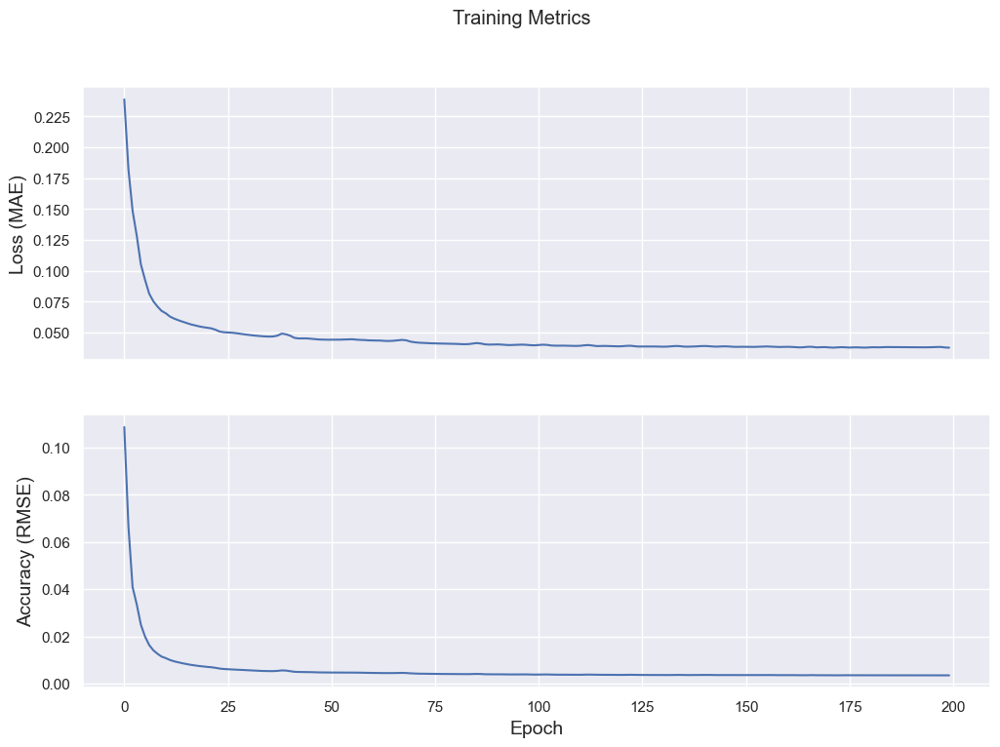

In [27]:
fig, axes = plt.subplots(2, sharex=True, figsize=(12, 8))
fig.suptitle('Training Metrics')

axes[0].set_ylabel("Loss (MAE)", fontsize=14)
axes[0].plot(train_loss_results)

axes[1].set_ylabel("Accuracy (RMSE)", fontsize=14)
axes[1].set_xlabel("Epoch", fontsize=14)
axes[1].plot(train_rmse_accuracy_results)
plt.show()

In [28]:
# input for LSTM
inputs_test = tf.keras.Input(batch_shape=(batch_test, size_input, total_features), name='inputs')
print(' INPUT SHAPE for LSTM: { batch size, input sequence, features size}')
inputs_test

 INPUT SHAPE for LSTM: { batch size, input sequence, features size}


<KerasTensor: shape=(1, 12, 2297) dtype=float32 (created by layer 'inputs')>

In [29]:
lstm_pred = LSTM(latent_dim, size_input, total_features, stateful_test)
output_test = lstm_pred(inputs_test)
lstm_pred.summary()

Model: "lstm_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_cell_1 (LSTMCell)      multiple                  959200    
                                                                 
 rnn_1 (RNN)                 multiple                  959200    
                                                                 
 dense_2 (Dense)             multiple                  15150     
                                                                 
 dropout_1 (Dropout)         multiple                  0         
                                                                 
 dense_3 (Dense)             multiple                  4162164   
                                                                 
 reshape_1 (Reshape)         multiple                  0         
                                                                 
Total params: 5,136,514
Trainable params: 5,136,514
Non-trai

In [30]:
for a, b in zip(lstm_pred.variables, lstm.variables):
    a.assign(b)  # copies the variables of model_b into model_a

In [31]:
def evaluate_forecasts(targets, forecasts, n_seq):
    
    list_rmse = []
    list_mae = []
    
    for i in range(n_seq):
        true = np.vstack([target[i] for target in targets])
        predicted = np.vstack([forecast[i] for forecast in forecasts])
        
        rmse = np.sqrt((np.square(true - predicted)).mean(axis=0))
        mae = np.absolute(true - predicted).mean(axis=0)
        
        list_rmse.append(rmse)
        list_mae.append(mae)
        
    list_rmse = np.vstack(list_rmse)
    list_mae = np.vstack(list_mae)
    
    return list_rmse, list_mae

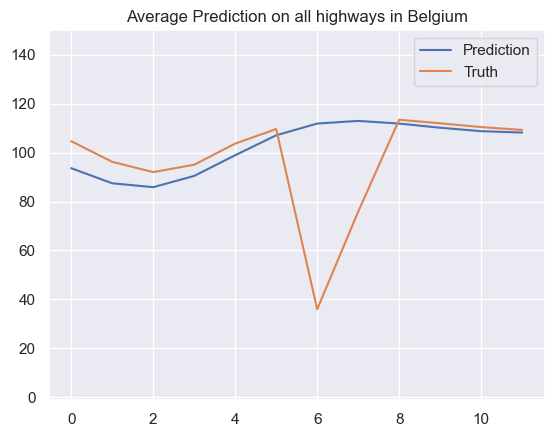

* Time step 0
* Prediction Accuracy (MAE) 18.82113868030291
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


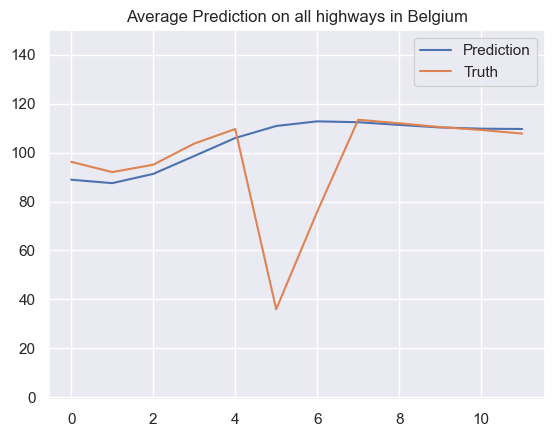

* Time step 1
* Prediction Accuracy (MAE) 18.369843512319697
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


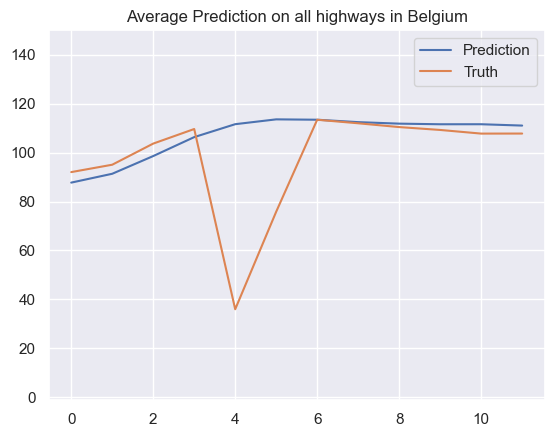

* Time step 2
* Prediction Accuracy (MAE) 18.666597235300973
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


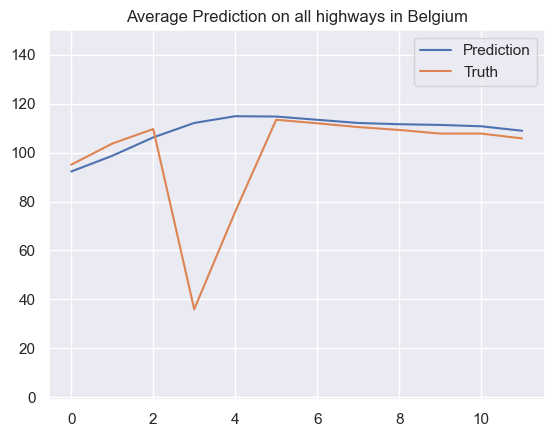

* Time step 3
* Prediction Accuracy (MAE) 18.816620511648495
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


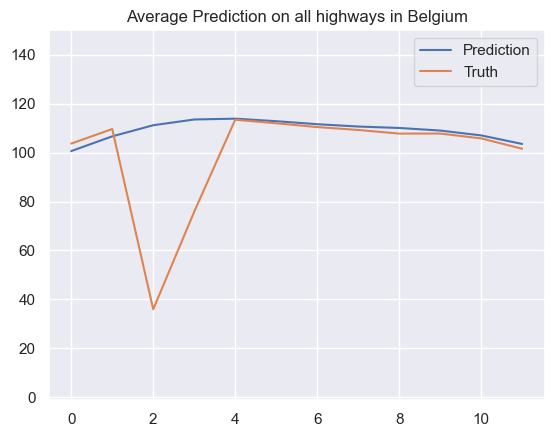

* Time step 4
* Prediction Accuracy (MAE) 18.454846002404114
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


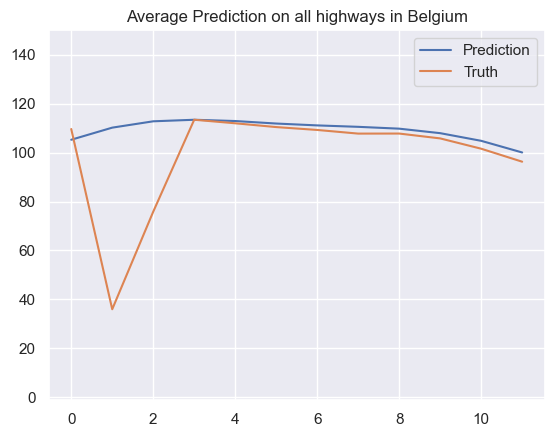

* Time step 5
* Prediction Accuracy (MAE) 18.39663652541271
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


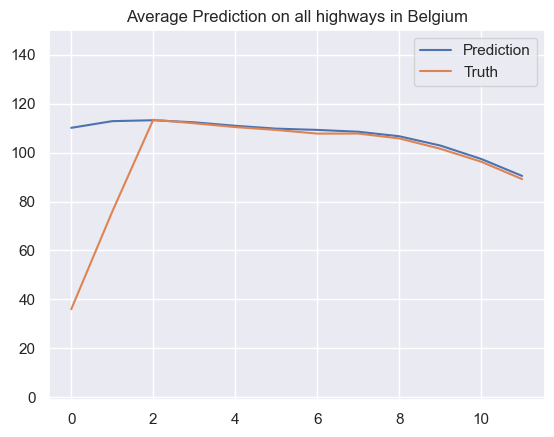

* Time step 6
* Prediction Accuracy (MAE) 18.13510764519849
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


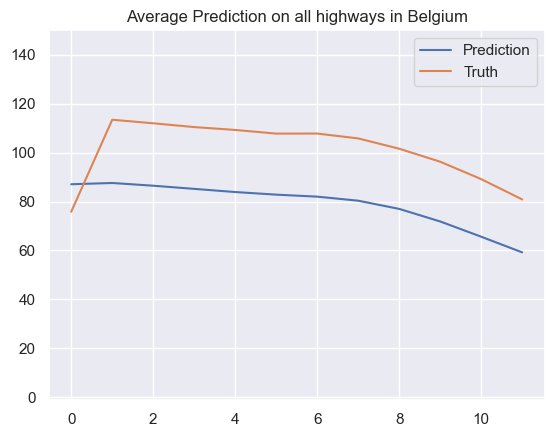

* Time step 7
* Prediction Accuracy (MAE) 24.339560749726527
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


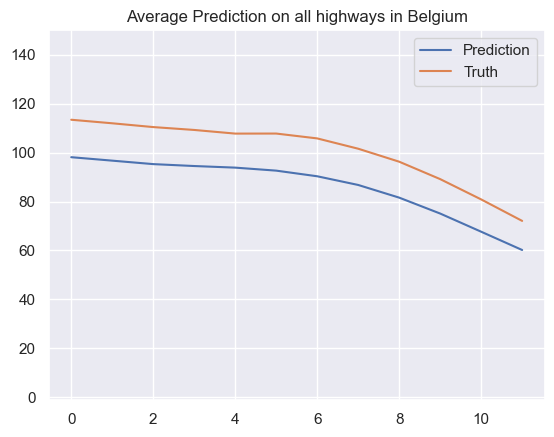

* Time step 8
* Prediction Accuracy (MAE) 16.36020641564334
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


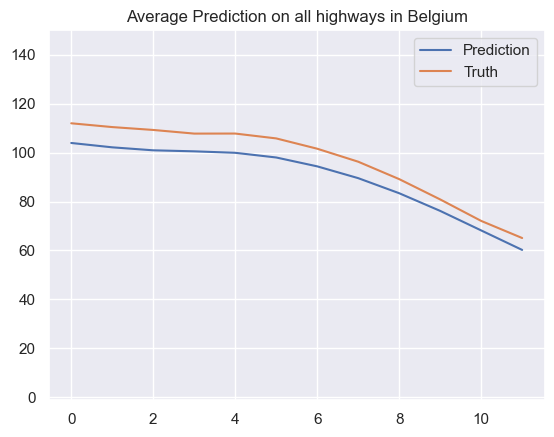

* Time step 9
* Prediction Accuracy (MAE) 11.259542804223699
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


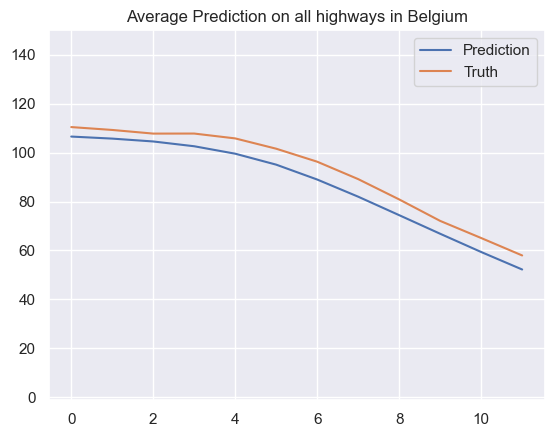

* Time step 10
* Prediction Accuracy (MAE) 10.71967836715287
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


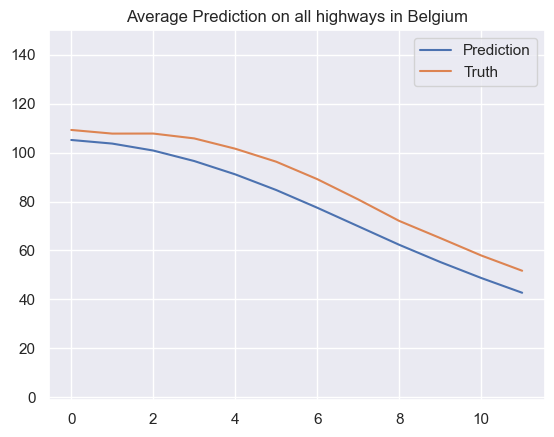

* Time step 11
* Prediction Accuracy (MAE) 12.156605184149566
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


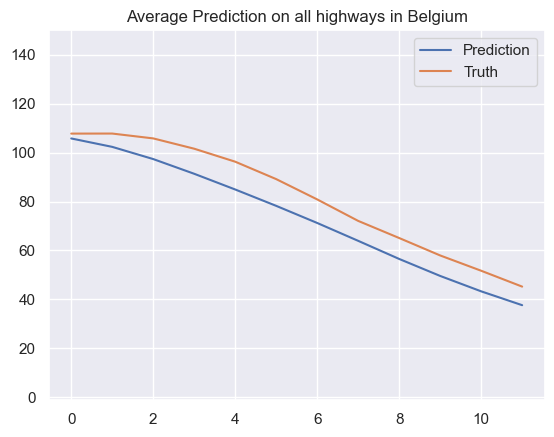

* Time step 12
* Prediction Accuracy (MAE) 11.621368077179923
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


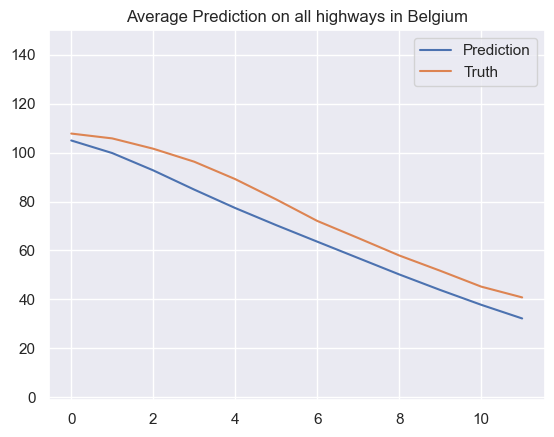

* Time step 13
* Prediction Accuracy (MAE) 11.524115526288412
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


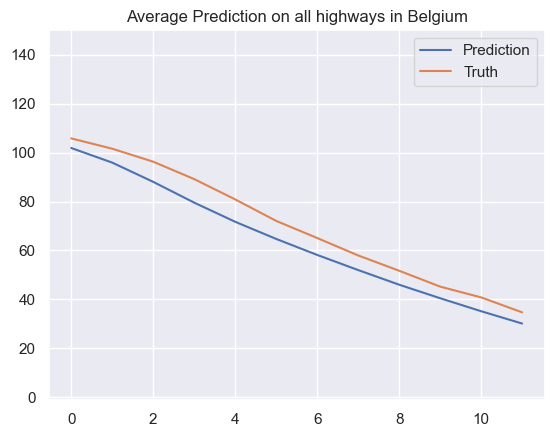

* Time step 14
* Prediction Accuracy (MAE) 10.157707584752435
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


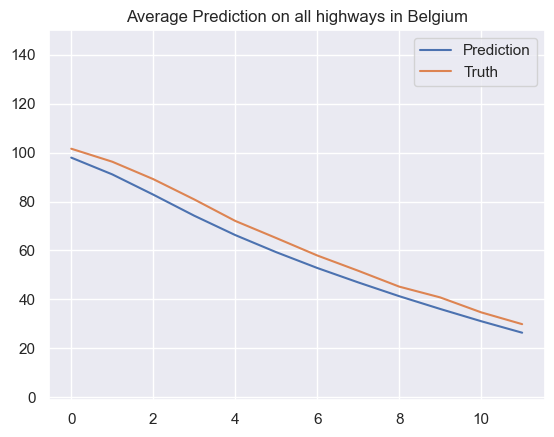

* Time step 15
* Prediction Accuracy (MAE) 9.12971509075658
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


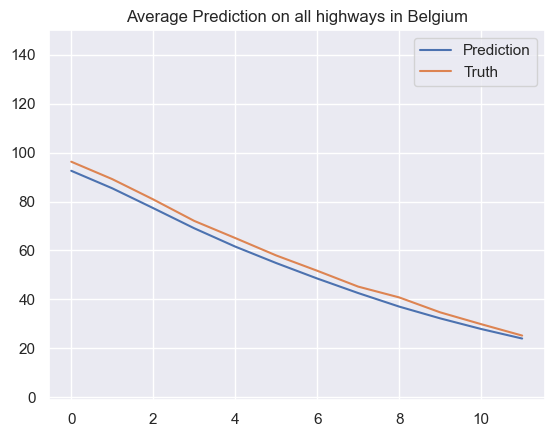

* Time step 16
* Prediction Accuracy (MAE) 8.100872868624696
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


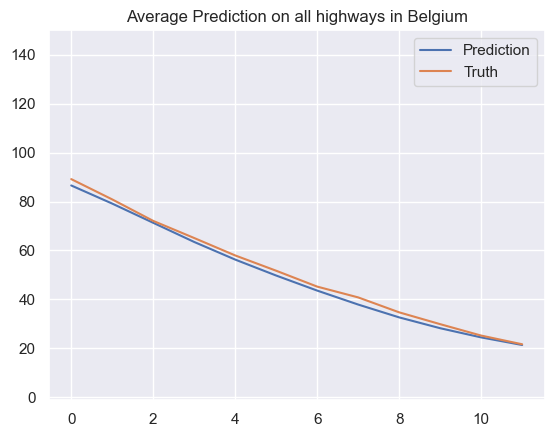

* Time step 17
* Prediction Accuracy (MAE) 7.444403056493333
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


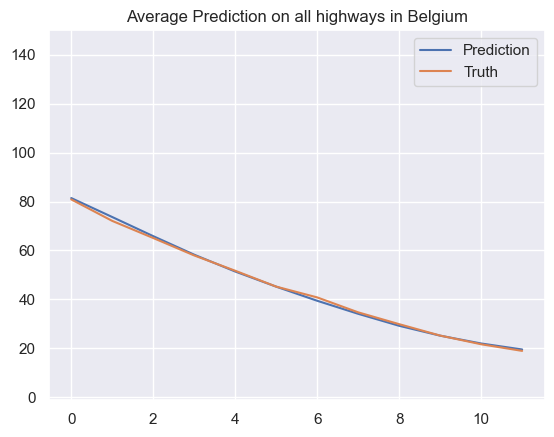

* Time step 18
* Prediction Accuracy (MAE) 7.073784040281958
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


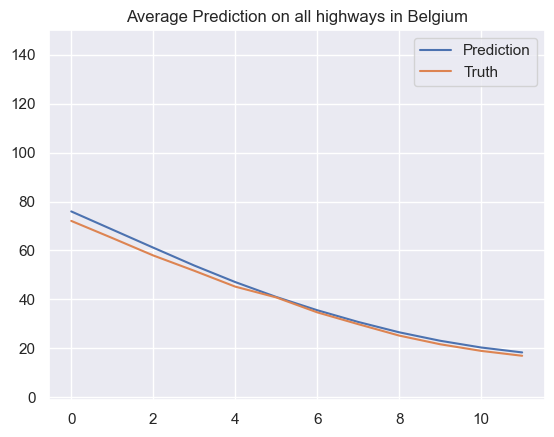

* Time step 19
* Prediction Accuracy (MAE) 6.7863759051549835
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


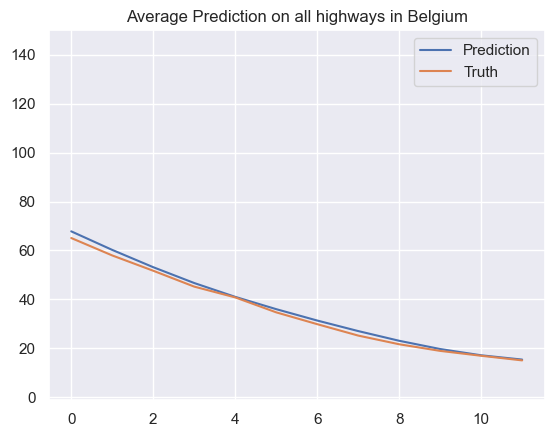

* Time step 20
* Prediction Accuracy (MAE) 6.0837065466478215
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


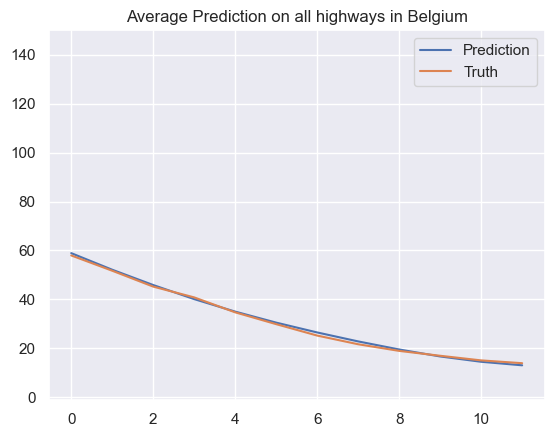

* Time step 21
* Prediction Accuracy (MAE) 5.3896750880070465
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


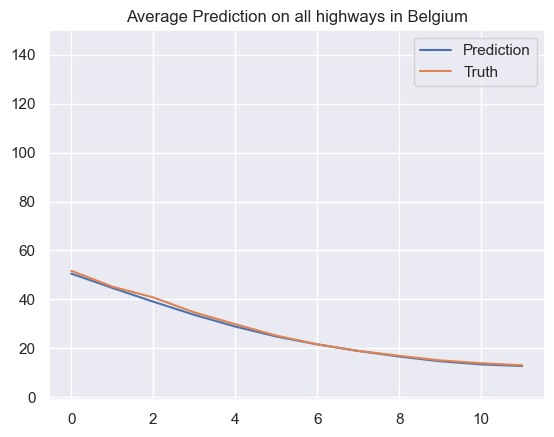

* Time step 22
* Prediction Accuracy (MAE) 4.800656604400966
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


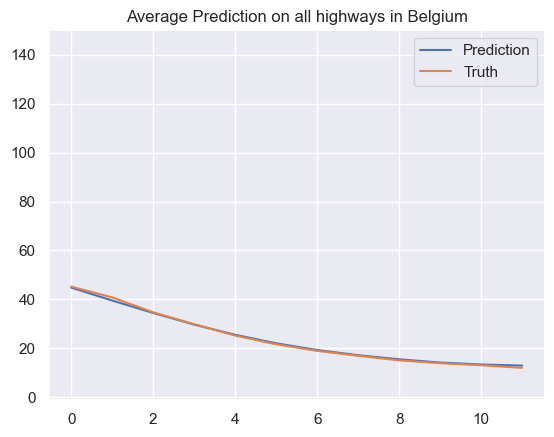

* Time step 23
* Prediction Accuracy (MAE) 4.370006830635188
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


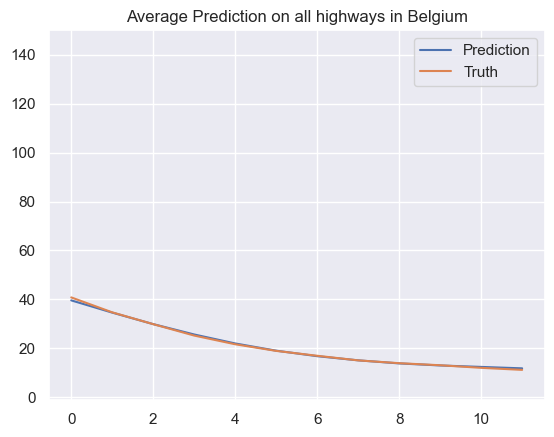

* Time step 24
* Prediction Accuracy (MAE) 3.9849064965515235
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


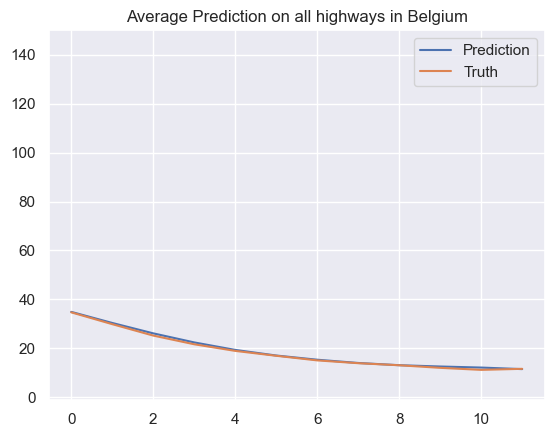

* Time step 25
* Prediction Accuracy (MAE) 3.7065025211053984
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


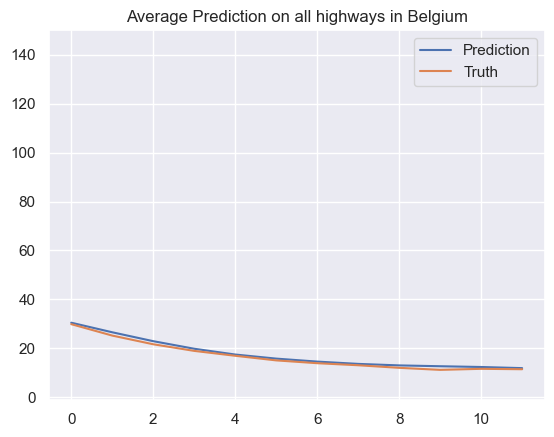

* Time step 26
* Prediction Accuracy (MAE) 3.5106941942776606
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


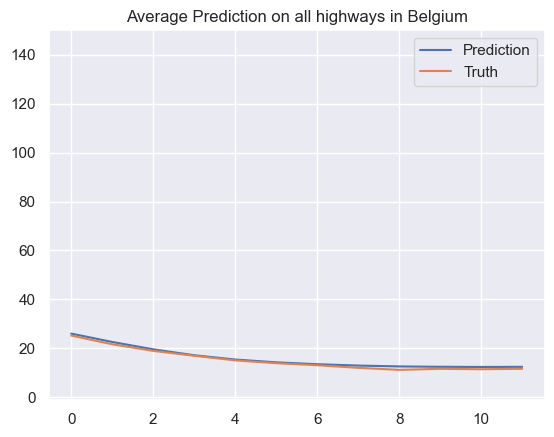

* Time step 27
* Prediction Accuracy (MAE) 3.3130864408047596
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


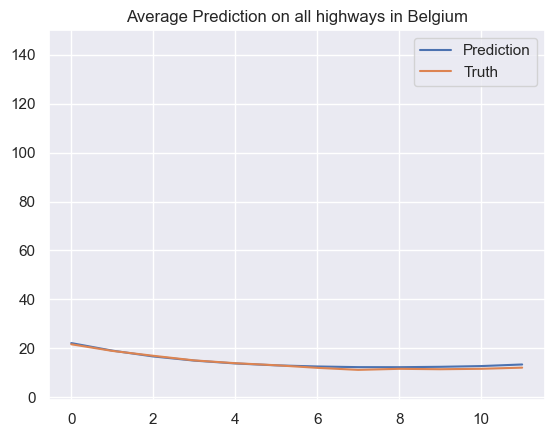

* Time step 28
* Prediction Accuracy (MAE) 3.151831275436391
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


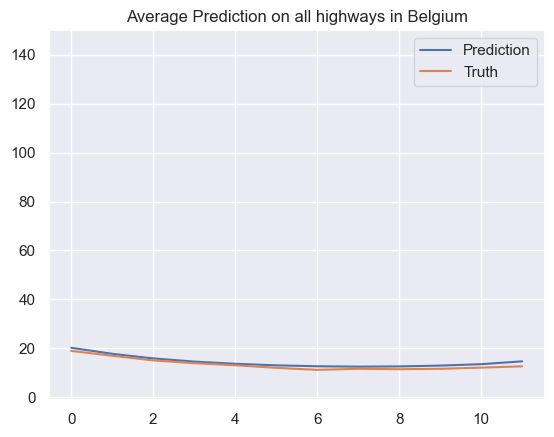

* Time step 29
* Prediction Accuracy (MAE) 3.1588235301775507
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


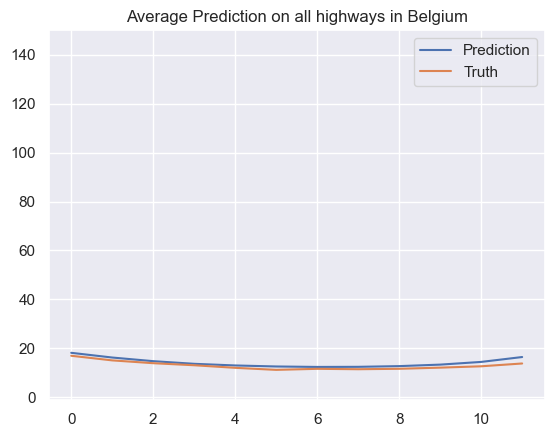

* Time step 30
* Prediction Accuracy (MAE) 3.180650094228558
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


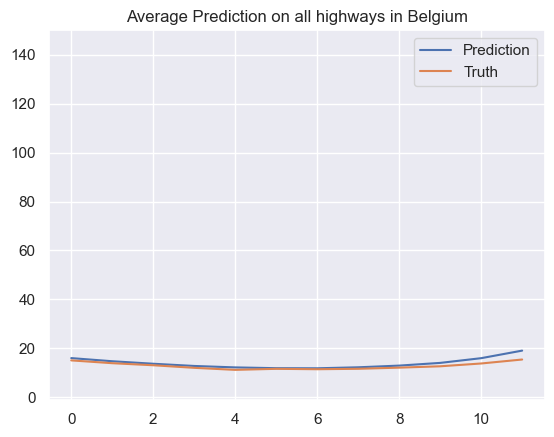

* Time step 31
* Prediction Accuracy (MAE) 3.1901905572915688
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


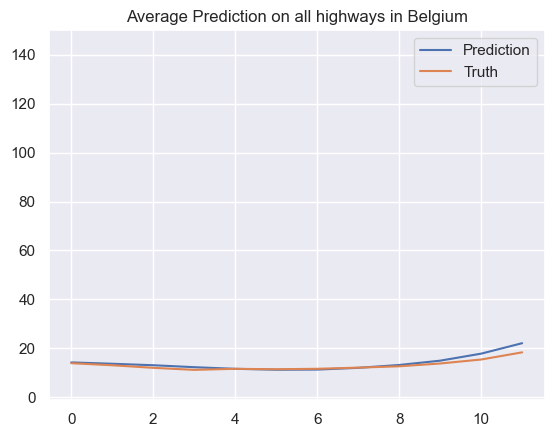

* Time step 32
* Prediction Accuracy (MAE) 3.212646737055116
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


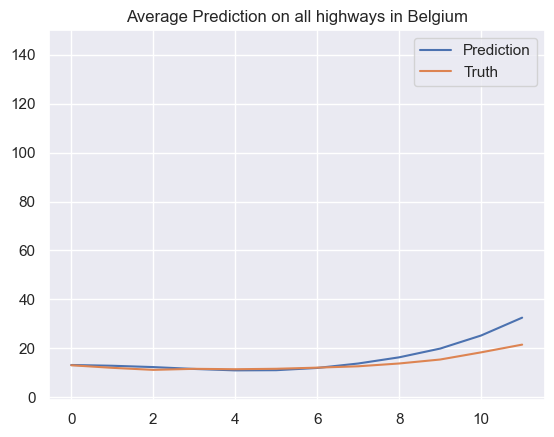

* Time step 33
* Prediction Accuracy (MAE) 4.312930870755209
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


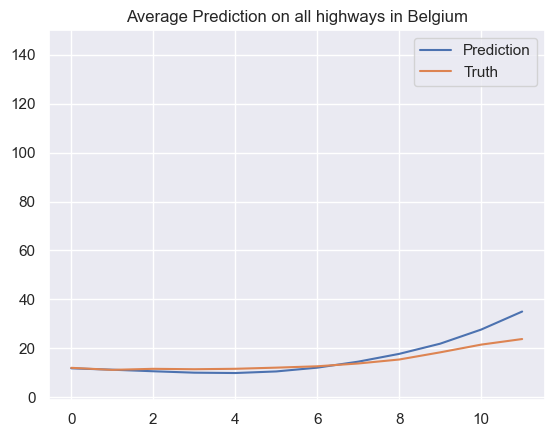

* Time step 34
* Prediction Accuracy (MAE) 4.396524360499403
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


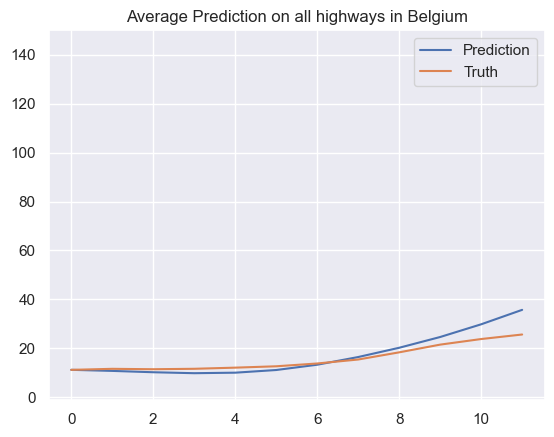

* Time step 35
* Prediction Accuracy (MAE) 4.41679004424118
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


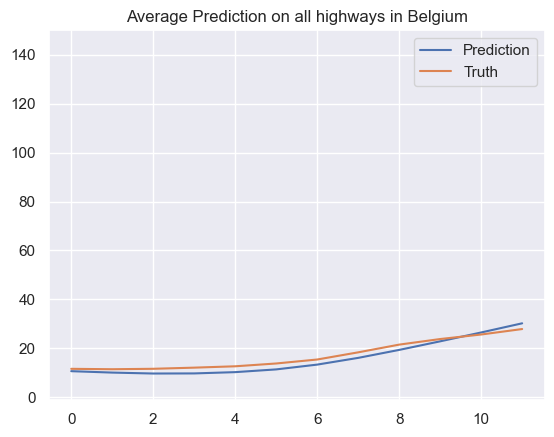

* Time step 36
* Prediction Accuracy (MAE) 3.891550874192955
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


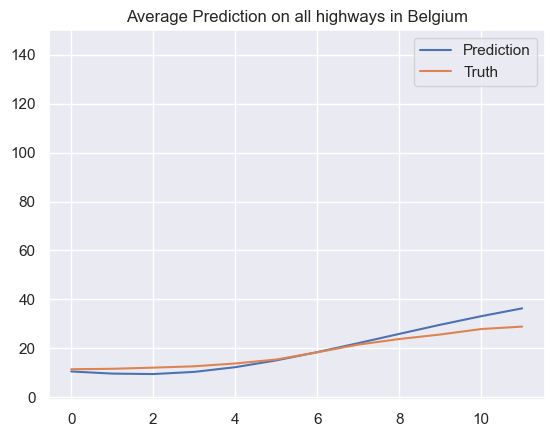

* Time step 37
* Prediction Accuracy (MAE) 4.543253711918258
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


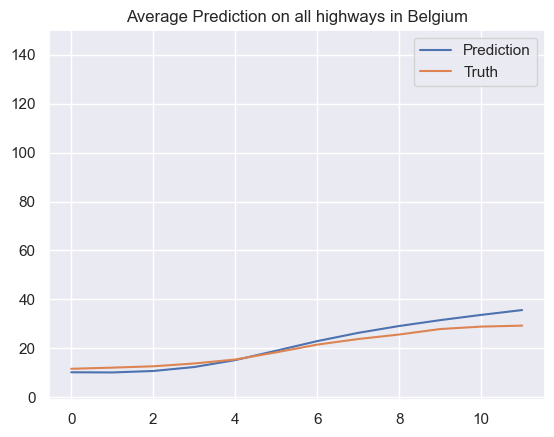

* Time step 38
* Prediction Accuracy (MAE) 4.664370107290593
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


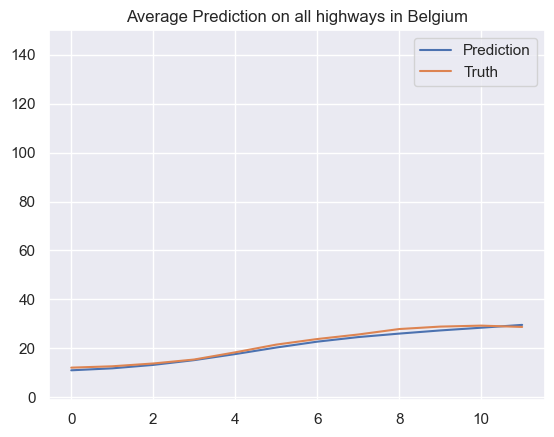

* Time step 39
* Prediction Accuracy (MAE) 3.873531121530583
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


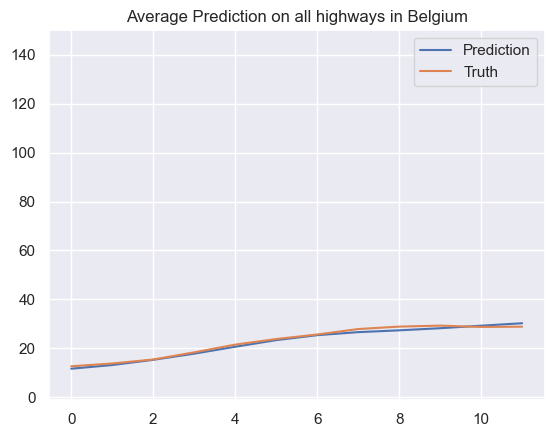

* Time step 40
* Prediction Accuracy (MAE) 3.9924057523844962
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


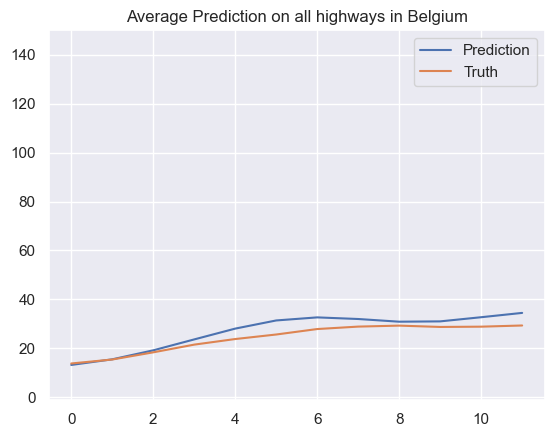

* Time step 41
* Prediction Accuracy (MAE) 5.26015895154629
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


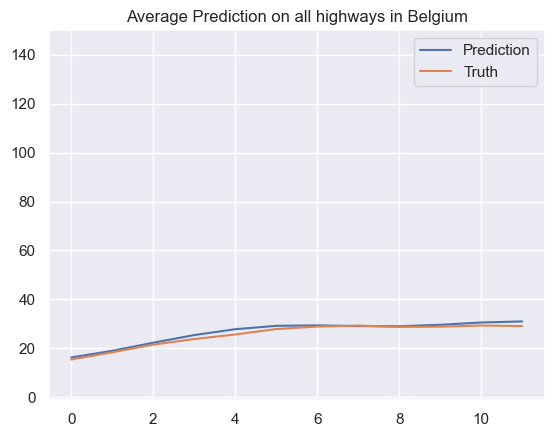

* Time step 42
* Prediction Accuracy (MAE) 4.3182396393626234
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


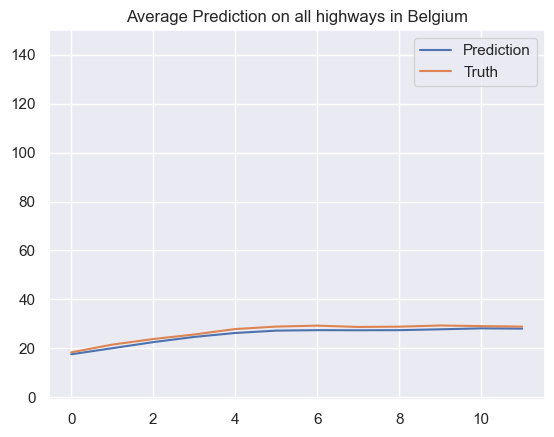

* Time step 43
* Prediction Accuracy (MAE) 4.3099988261398
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


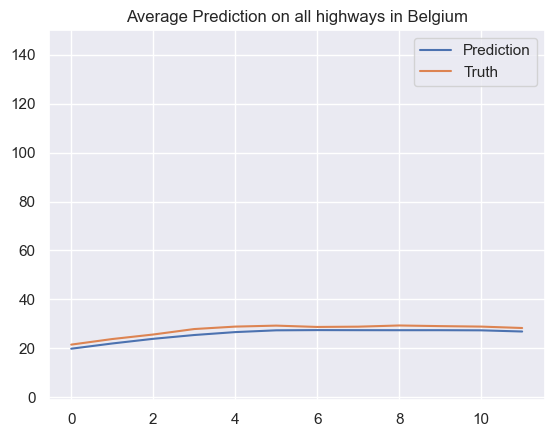

* Time step 44
* Prediction Accuracy (MAE) 4.49486634887446
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


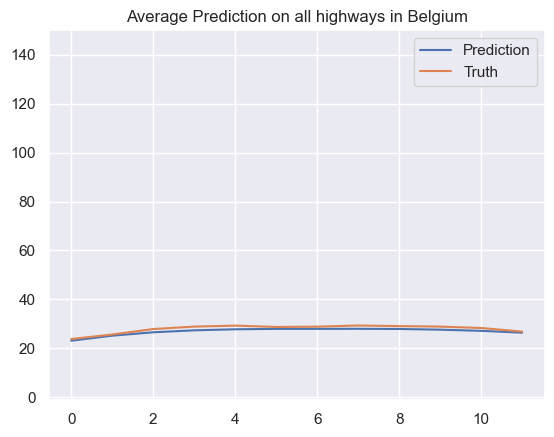

* Time step 45
* Prediction Accuracy (MAE) 4.489667429179394
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


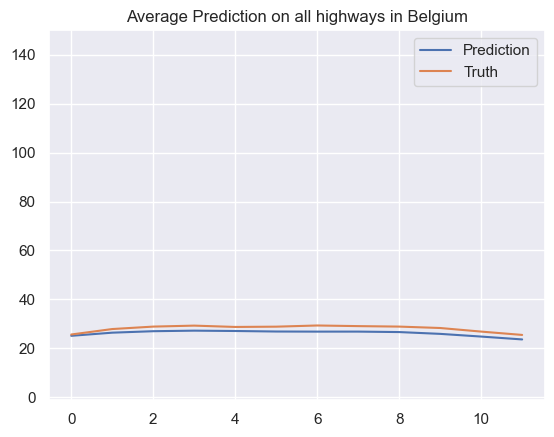

* Time step 46
* Prediction Accuracy (MAE) 4.7944345311722705
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


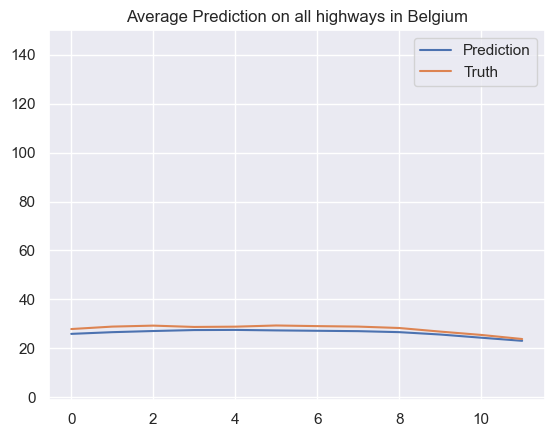

* Time step 47
* Prediction Accuracy (MAE) 4.725405859221189
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


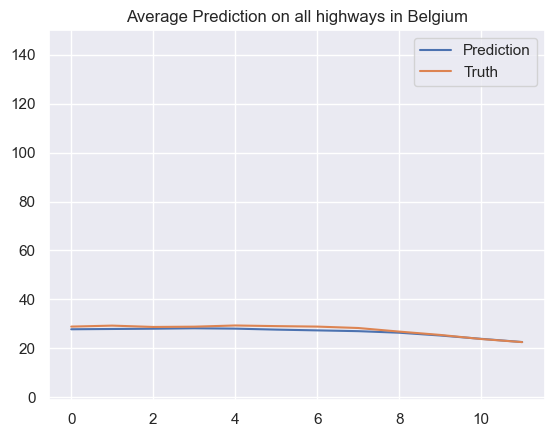

* Time step 48
* Prediction Accuracy (MAE) 4.5805132890067926
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


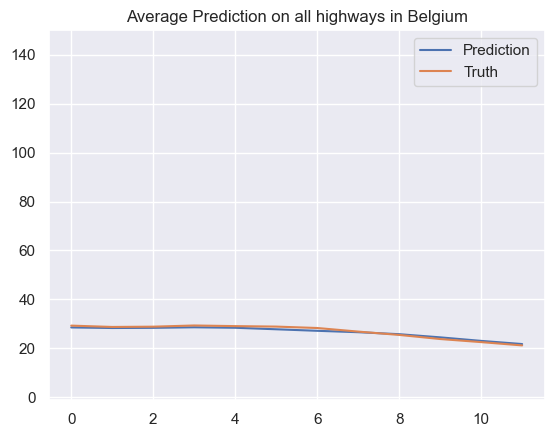

* Time step 49
* Prediction Accuracy (MAE) 4.500303227383633
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


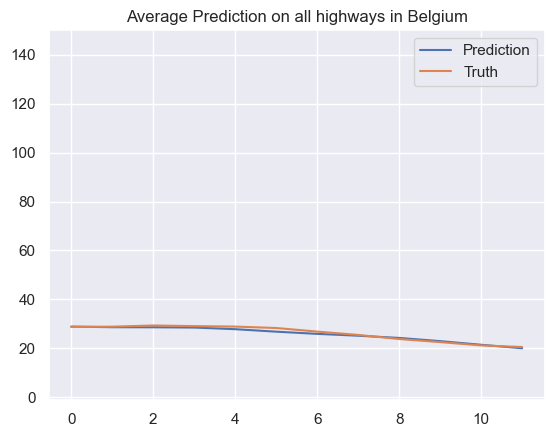

* Time step 50
* Prediction Accuracy (MAE) 4.416867225167647
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


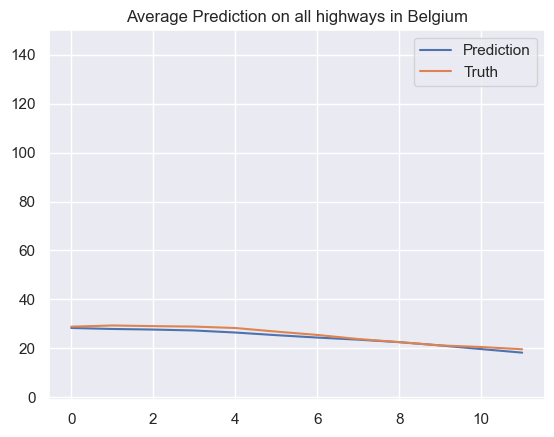

* Time step 51
* Prediction Accuracy (MAE) 4.364993529104474
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


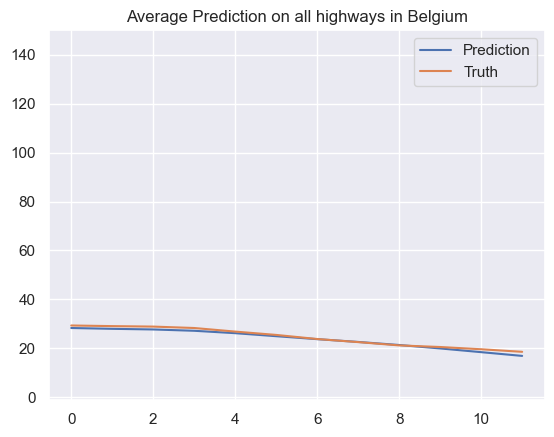

* Time step 52
* Prediction Accuracy (MAE) 4.268606755628942
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


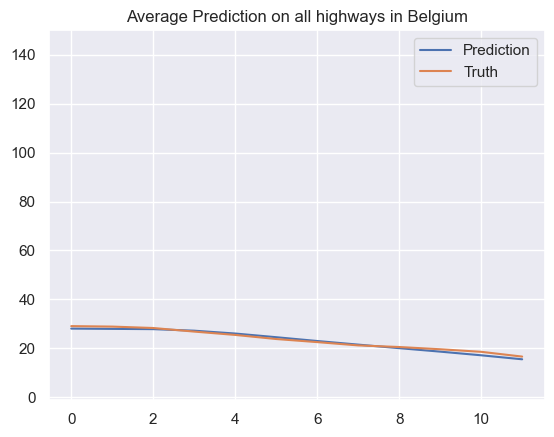

* Time step 53
* Prediction Accuracy (MAE) 4.194568430535522
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


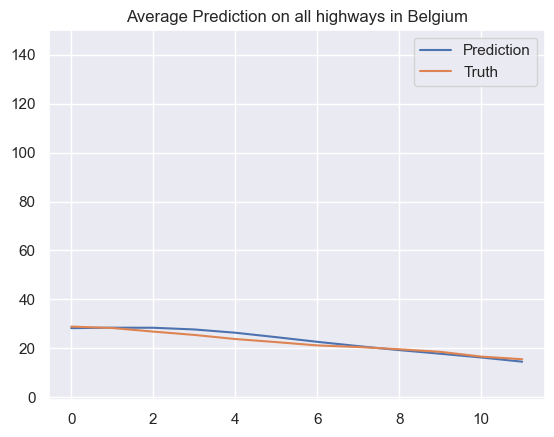

* Time step 54
* Prediction Accuracy (MAE) 4.207602243047325
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


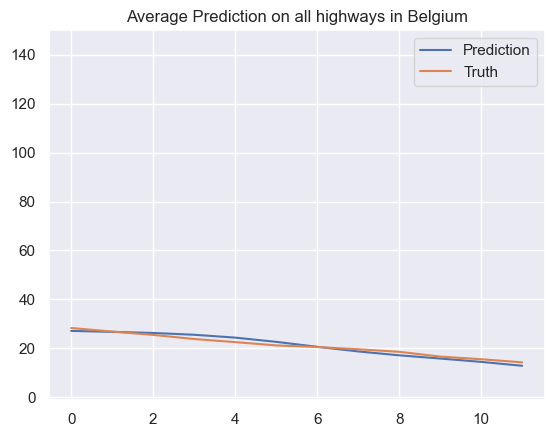

* Time step 55
* Prediction Accuracy (MAE) 4.055113377818629
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


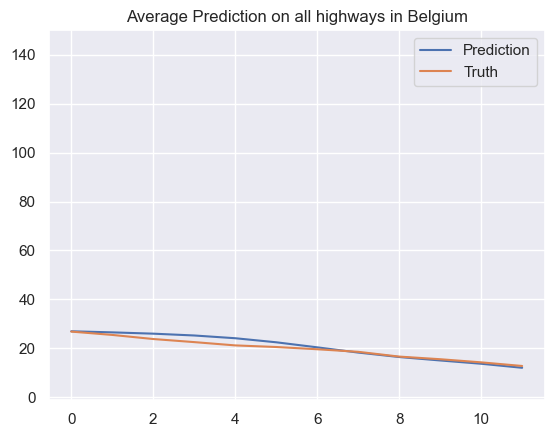

* Time step 56
* Prediction Accuracy (MAE) 4.10680227215505
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


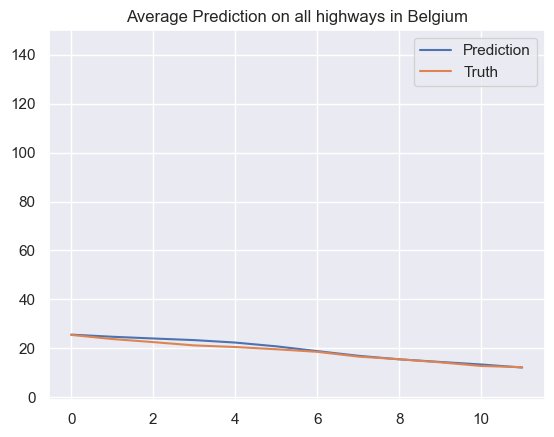

* Time step 57
* Prediction Accuracy (MAE) 3.8375055001927856
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


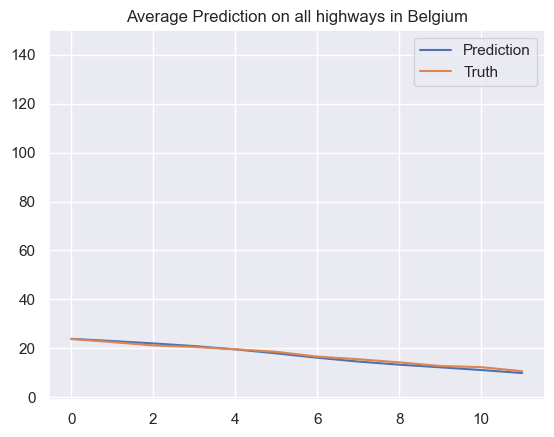

* Time step 58
* Prediction Accuracy (MAE) 3.49848848773789
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


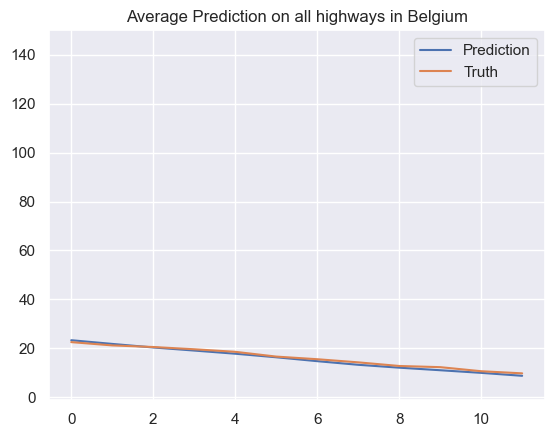

* Time step 59
* Prediction Accuracy (MAE) 3.347405279479627
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


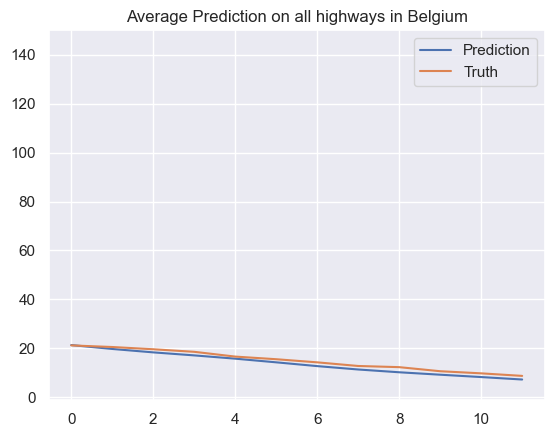

* Time step 60
* Prediction Accuracy (MAE) 3.2763527451425842
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


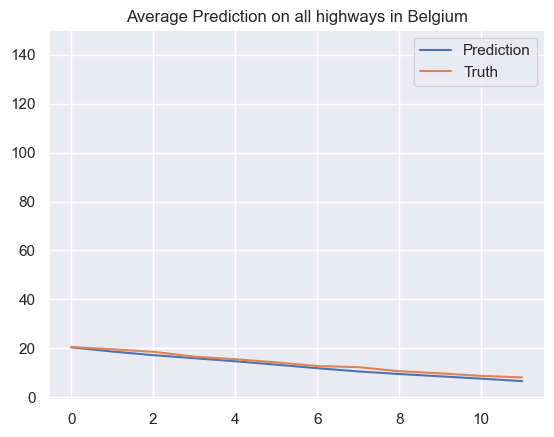

* Time step 61
* Prediction Accuracy (MAE) 3.1178015118292945
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


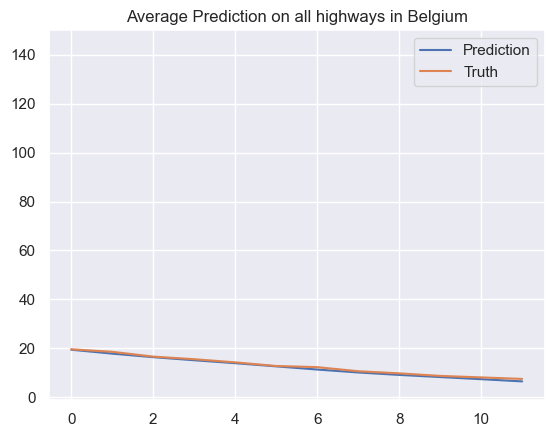

* Time step 62
* Prediction Accuracy (MAE) 2.907757013264158
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


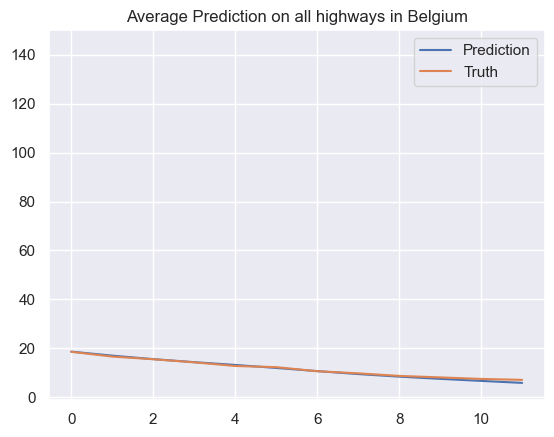

* Time step 63
* Prediction Accuracy (MAE) 2.7909702069734417
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


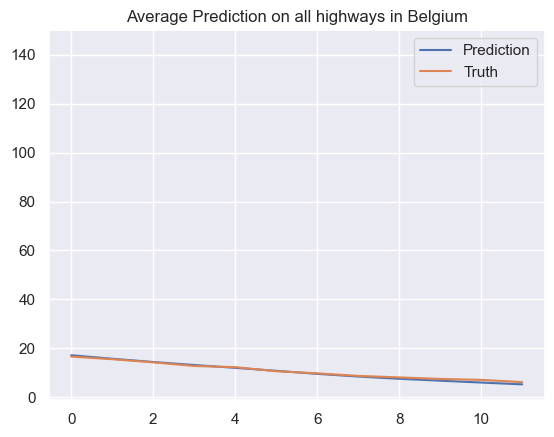

* Time step 64
* Prediction Accuracy (MAE) 2.679445076183606
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


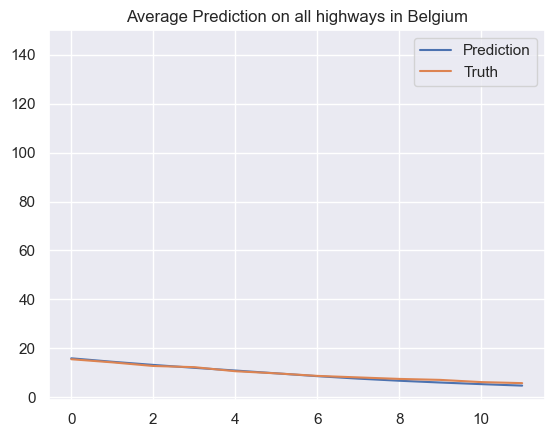

* Time step 65
* Prediction Accuracy (MAE) 2.5563171354896643
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


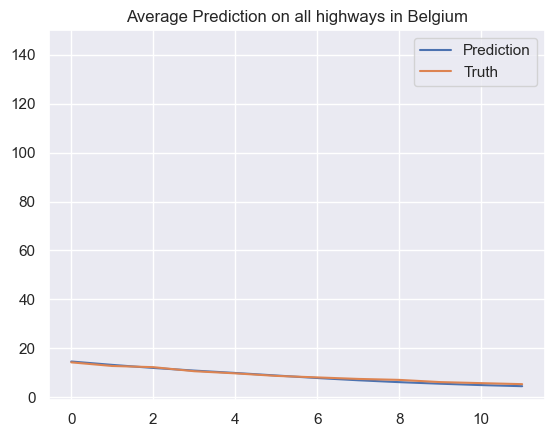

* Time step 66
* Prediction Accuracy (MAE) 2.455420727721586
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


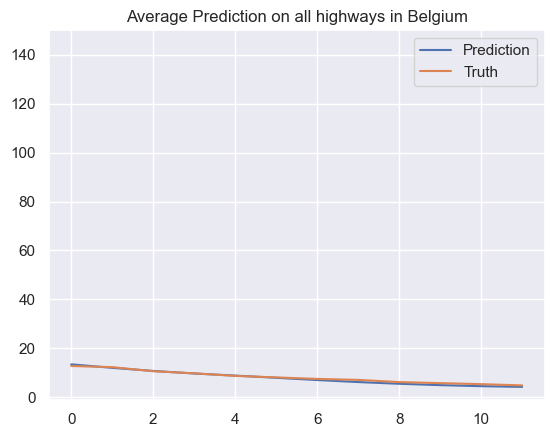

* Time step 67
* Prediction Accuracy (MAE) 2.337304310549718
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


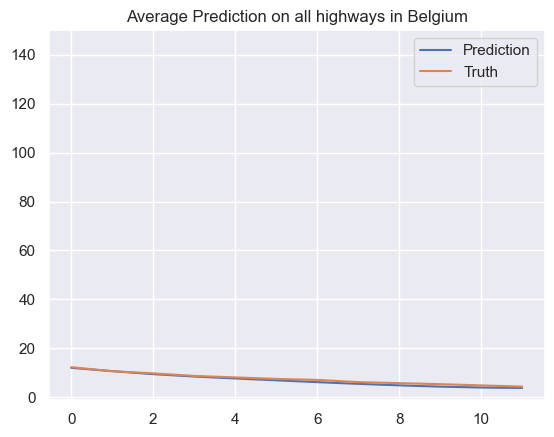

* Time step 68
* Prediction Accuracy (MAE) 2.220249696189447
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


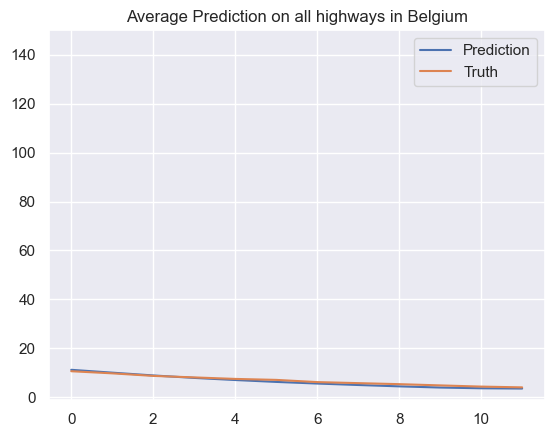

* Time step 69
* Prediction Accuracy (MAE) 2.115220362203777
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


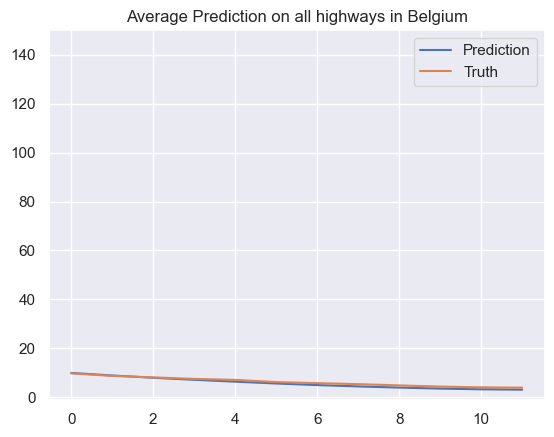

* Time step 70
* Prediction Accuracy (MAE) 2.0485540540419227
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


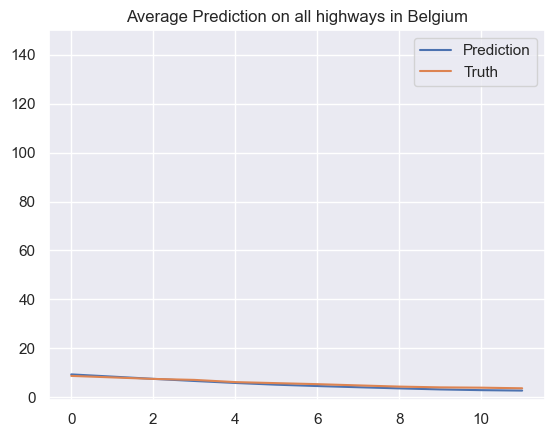

* Time step 71
* Prediction Accuracy (MAE) 1.9824636291280262
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


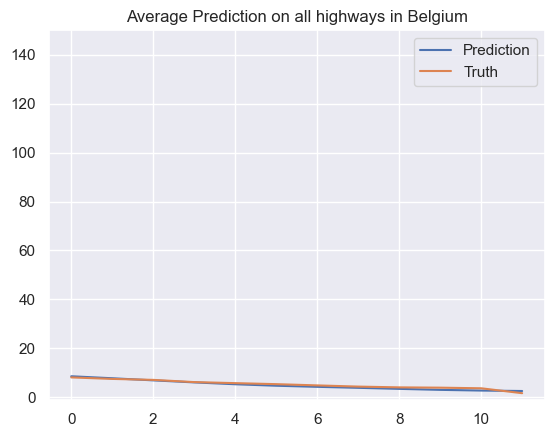

* Time step 72
* Prediction Accuracy (MAE) 1.894041496369604
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


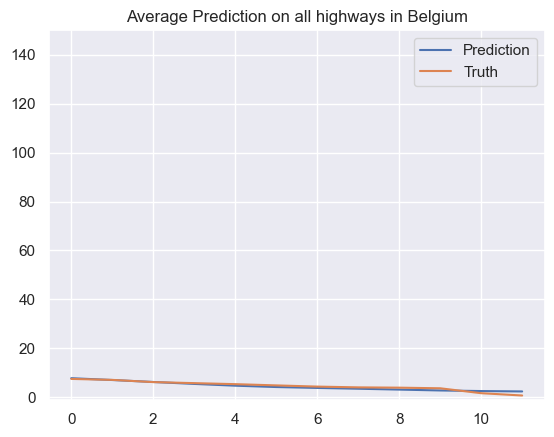

* Time step 73
* Prediction Accuracy (MAE) 1.8201999402974218
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


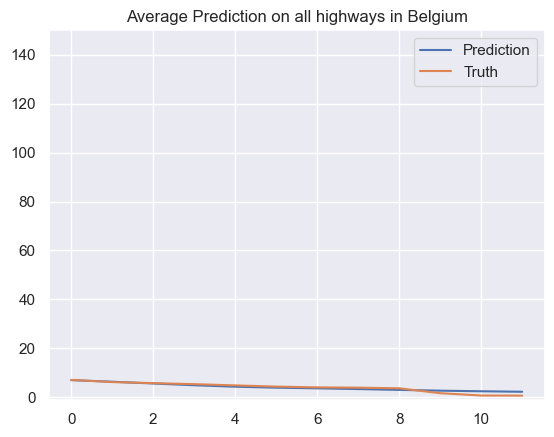

* Time step 74
* Prediction Accuracy (MAE) 1.7837712307920879
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


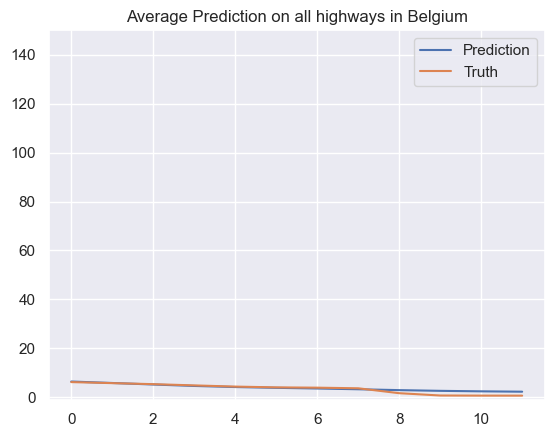

* Time step 75
* Prediction Accuracy (MAE) 1.7611683635701803
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


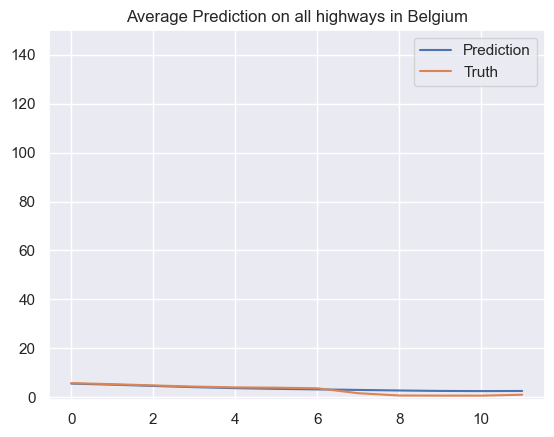

* Time step 76
* Prediction Accuracy (MAE) 1.7876659130825365
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


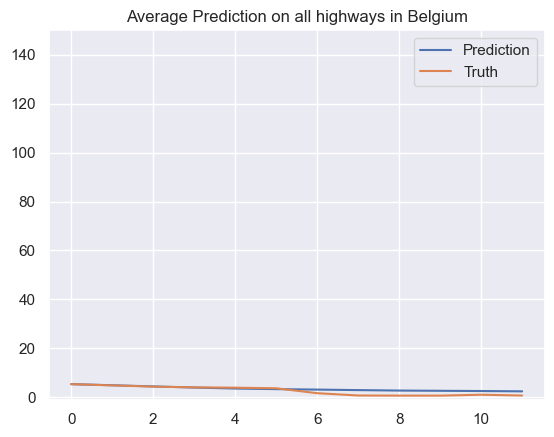

* Time step 77
* Prediction Accuracy (MAE) 1.8268860261720692
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


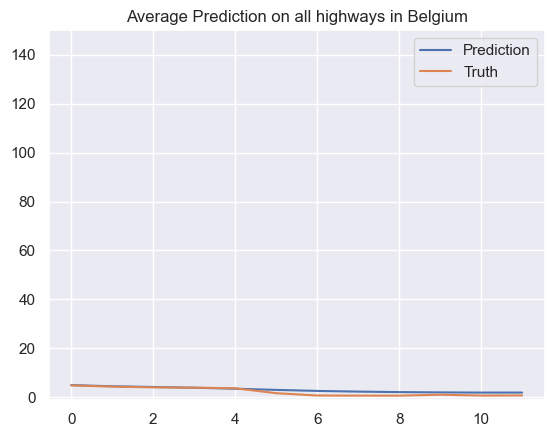

* Time step 78
* Prediction Accuracy (MAE) 1.6495212644024455
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


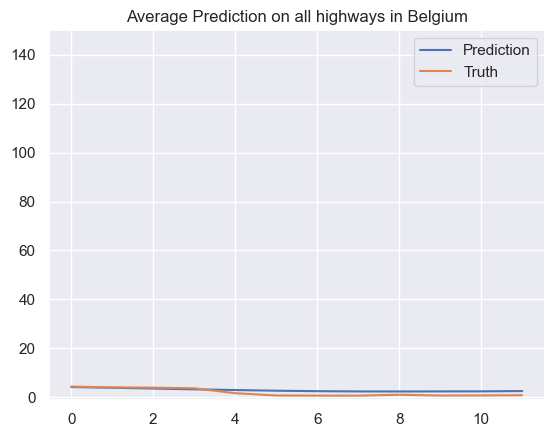

* Time step 79
* Prediction Accuracy (MAE) 1.7604458409749248
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


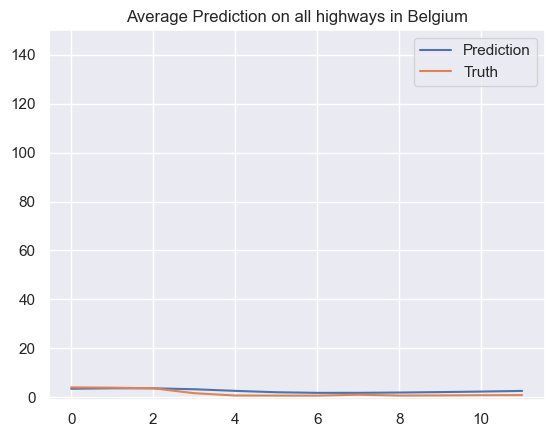

* Time step 80
* Prediction Accuracy (MAE) 1.7027433554728777
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


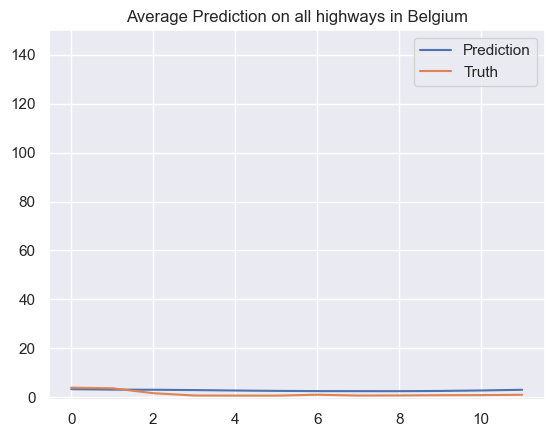

* Time step 81
* Prediction Accuracy (MAE) 1.967978598373407
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


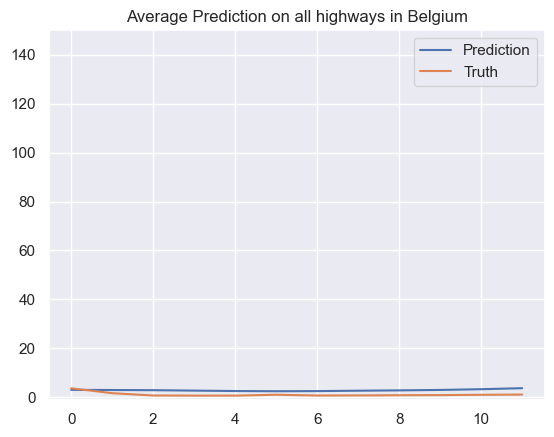

* Time step 82
* Prediction Accuracy (MAE) 2.0857257465299415
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


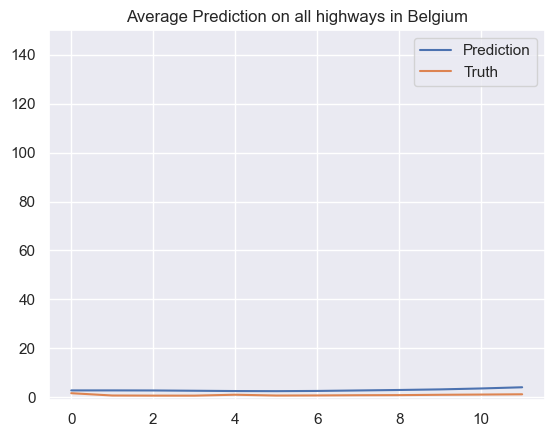

* Time step 83
* Prediction Accuracy (MAE) 2.1554162623160034
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


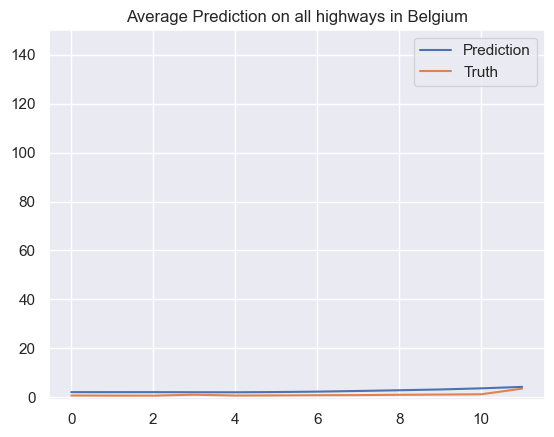

* Time step 84
* Prediction Accuracy (MAE) 1.7734588883077633
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


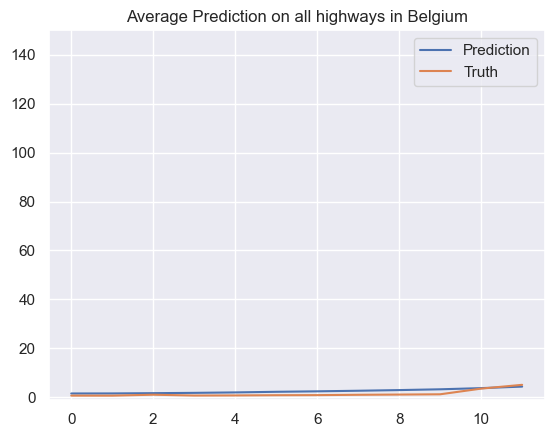

* Time step 85
* Prediction Accuracy (MAE) 1.6053474503877319
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


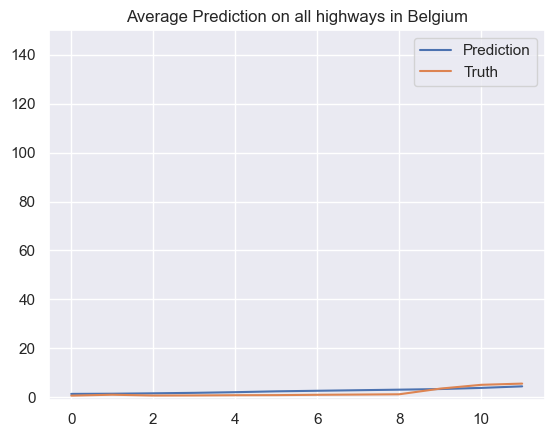

* Time step 86
* Prediction Accuracy (MAE) 1.6230039809255894
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


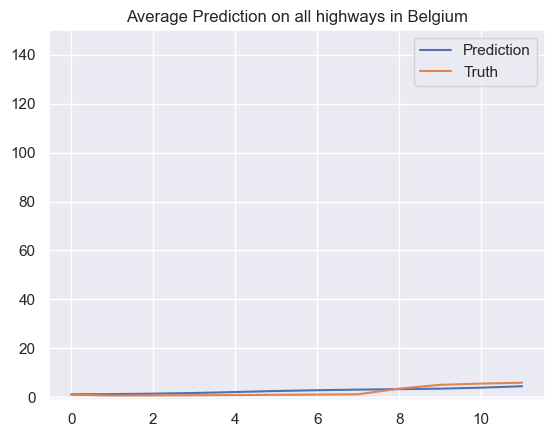

* Time step 87
* Prediction Accuracy (MAE) 1.6637193059539197
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


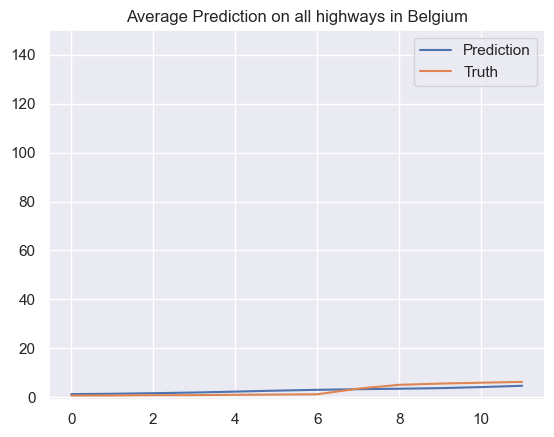

* Time step 88
* Prediction Accuracy (MAE) 1.7618956497294425
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


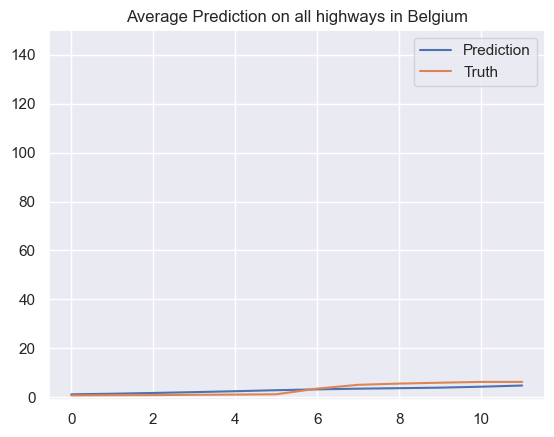

* Time step 89
* Prediction Accuracy (MAE) 1.843208507521965
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


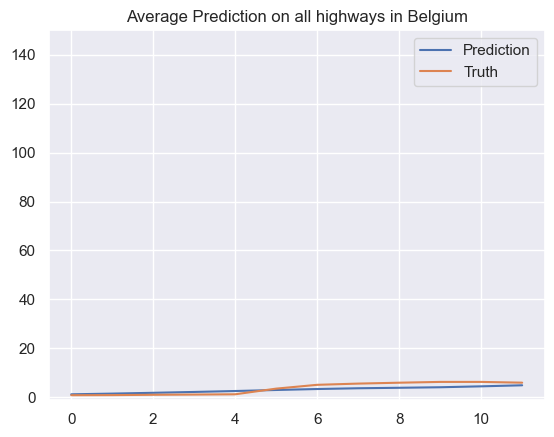

* Time step 90
* Prediction Accuracy (MAE) 1.8964814821821219
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


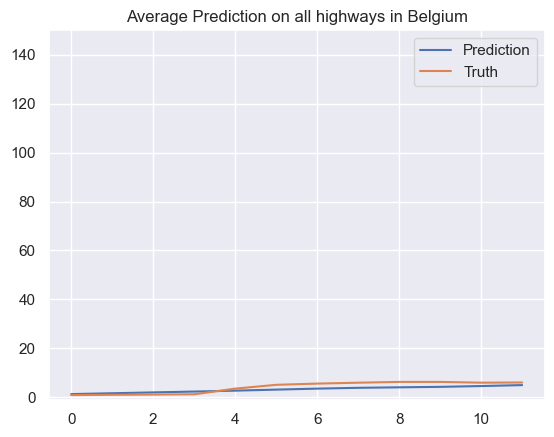

* Time step 91
* Prediction Accuracy (MAE) 1.978876344367467
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


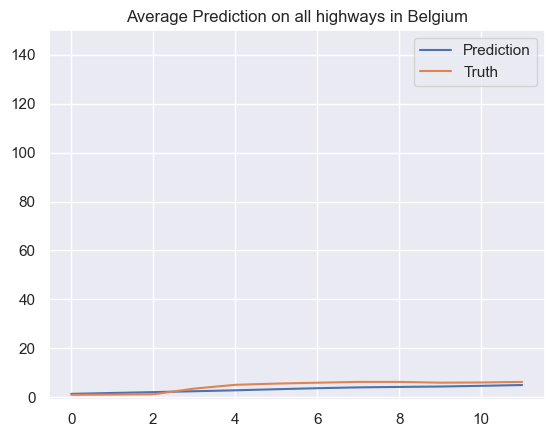

* Time step 92
* Prediction Accuracy (MAE) 2.108495662873947
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


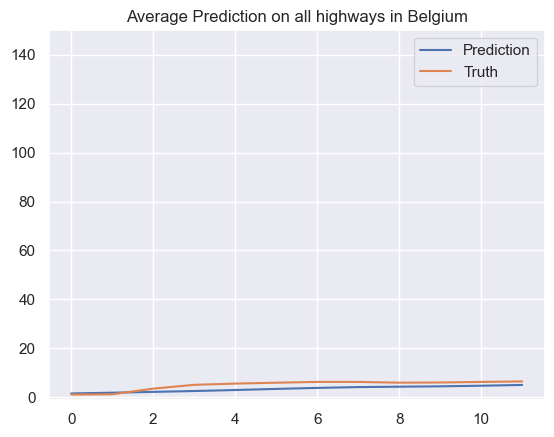

* Time step 93
* Prediction Accuracy (MAE) 2.2945175547331704
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


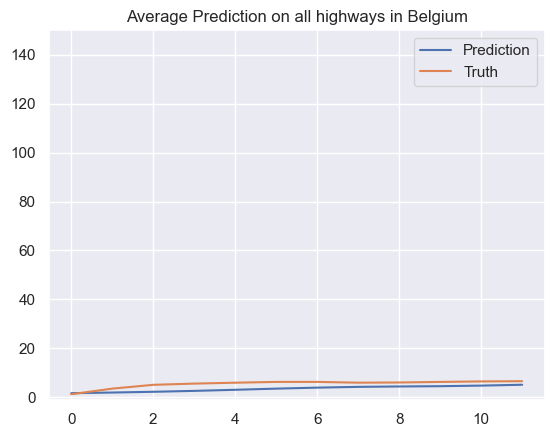

* Time step 94
* Prediction Accuracy (MAE) 2.5187878395651198
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


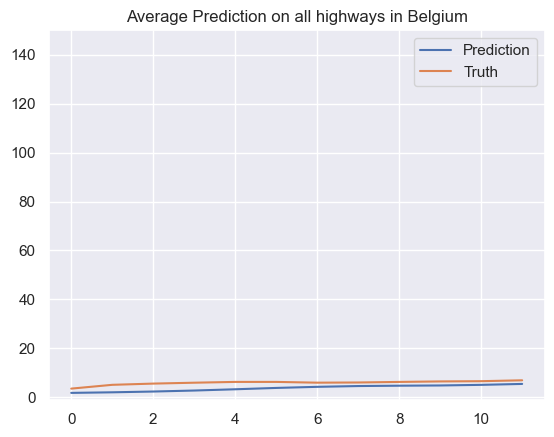

* Time step 95
* Prediction Accuracy (MAE) 2.715668996097229
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


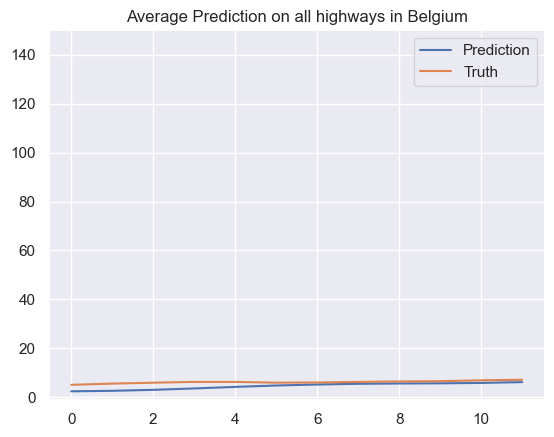

* Time step 96
* Prediction Accuracy (MAE) 2.513719740914432
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


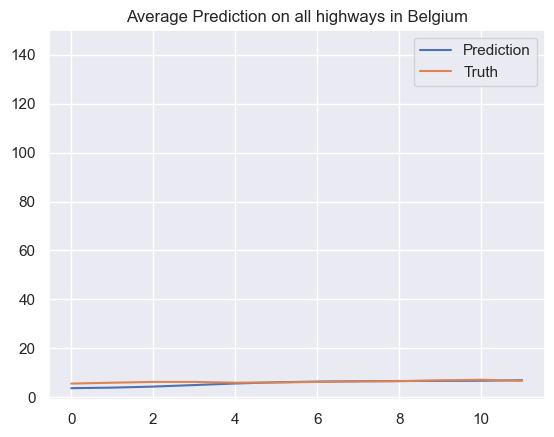

* Time step 97
* Prediction Accuracy (MAE) 2.253447316569765
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


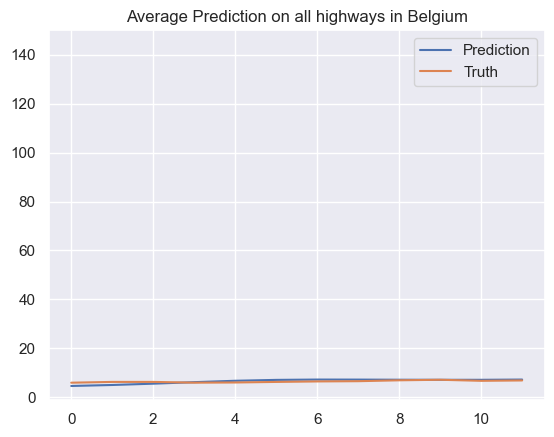

* Time step 98
* Prediction Accuracy (MAE) 2.269135119147206
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


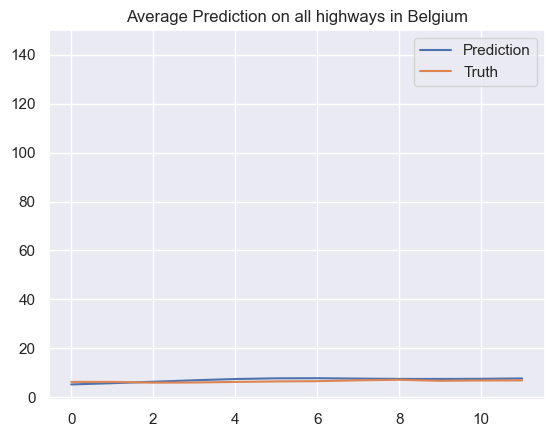

* Time step 99
* Prediction Accuracy (MAE) 2.3274885615489254
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


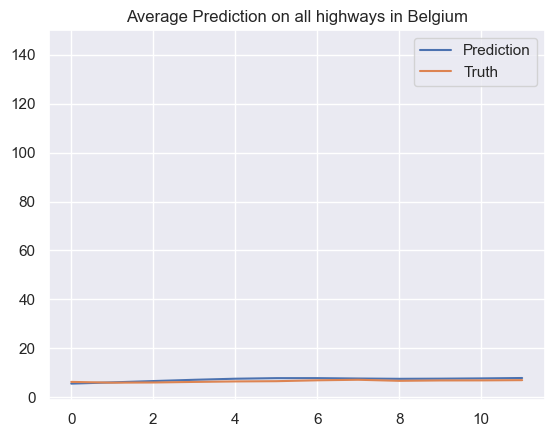

* Time step 100
* Prediction Accuracy (MAE) 2.291538786192726
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


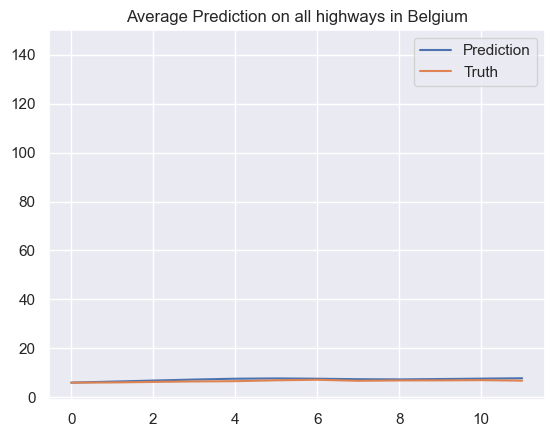

* Time step 101
* Prediction Accuracy (MAE) 2.2399414108999594
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


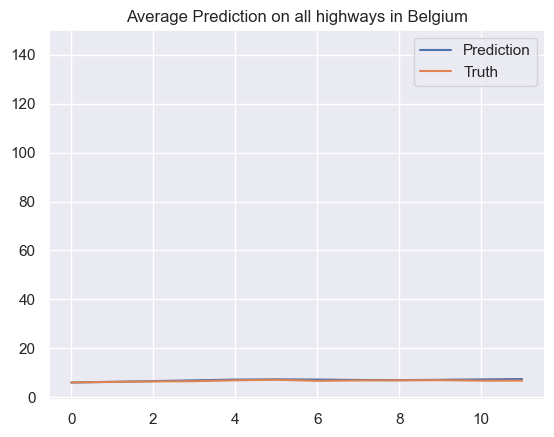

* Time step 102
* Prediction Accuracy (MAE) 2.127119121326456
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


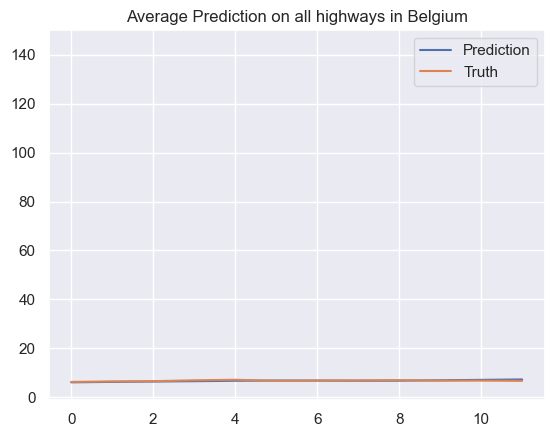

* Time step 103
* Prediction Accuracy (MAE) 2.0578479252807584
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


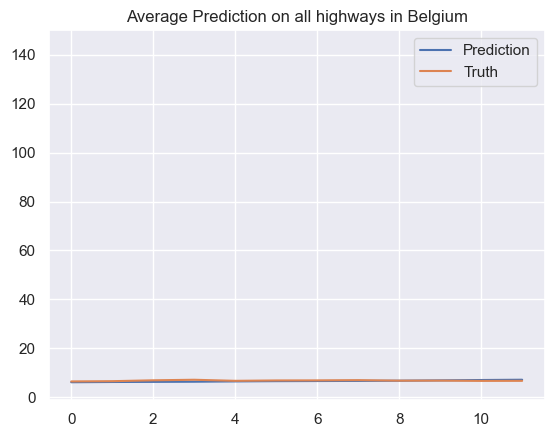

* Time step 104
* Prediction Accuracy (MAE) 2.0387453588027222
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


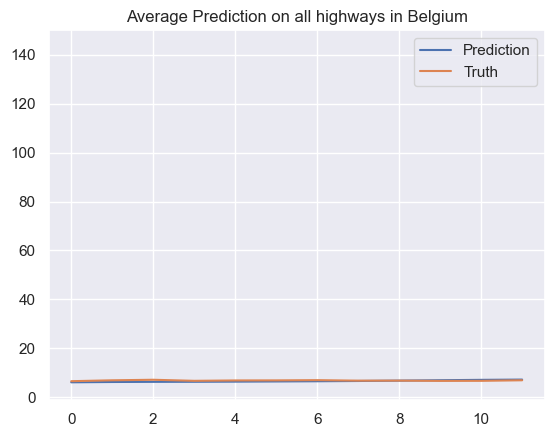

* Time step 105
* Prediction Accuracy (MAE) 2.059565921163739
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


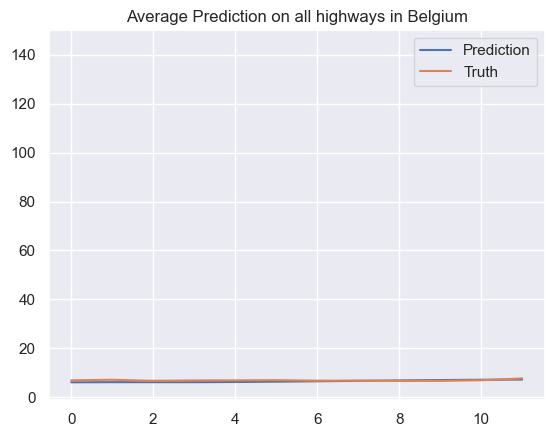

* Time step 106
* Prediction Accuracy (MAE) 2.1312893834375566
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


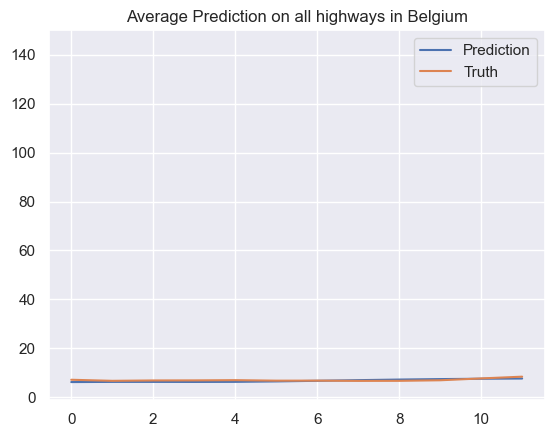

* Time step 107
* Prediction Accuracy (MAE) 2.2004915512761425
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


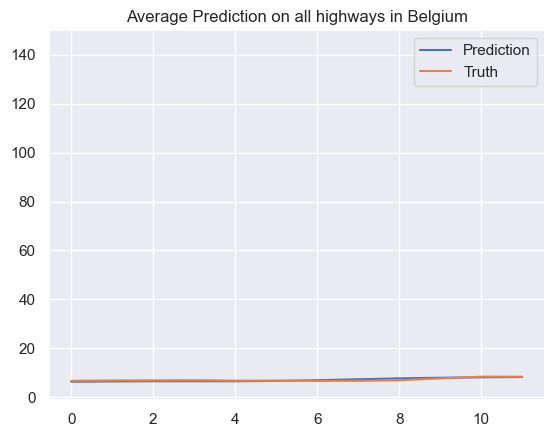

* Time step 108
* Prediction Accuracy (MAE) 2.2574408194610442
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


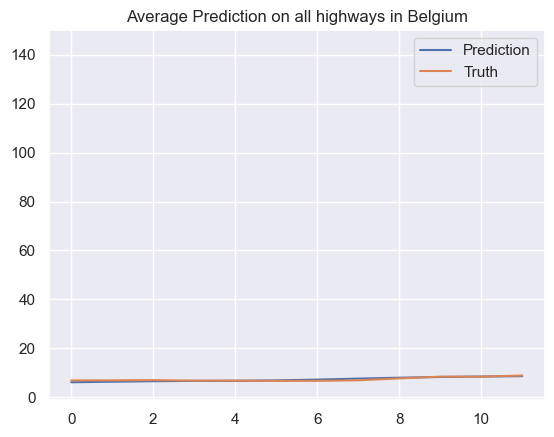

* Time step 109
* Prediction Accuracy (MAE) 2.309594498173104
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


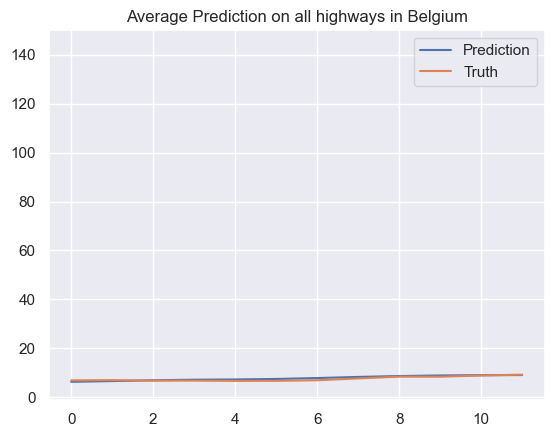

* Time step 110
* Prediction Accuracy (MAE) 2.4038214833212455
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


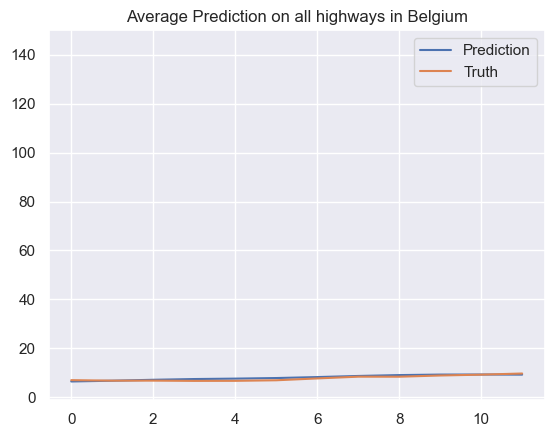

* Time step 111
* Prediction Accuracy (MAE) 2.472900438298072
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


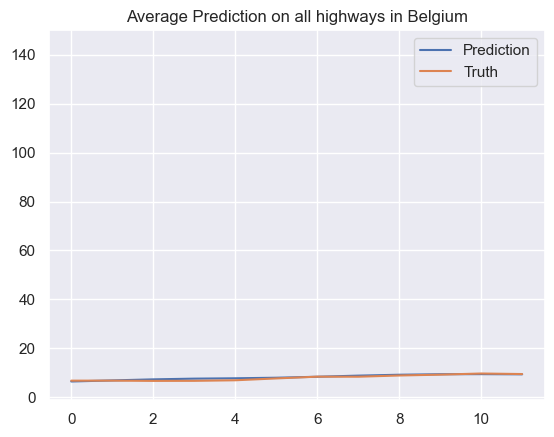

* Time step 112
* Prediction Accuracy (MAE) 2.461546205100657
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


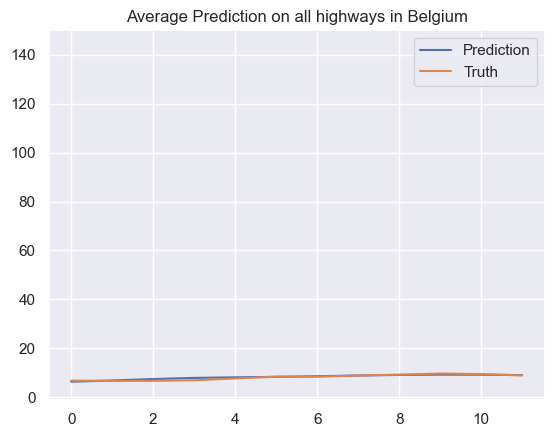

* Time step 113
* Prediction Accuracy (MAE) 2.465239006819833
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


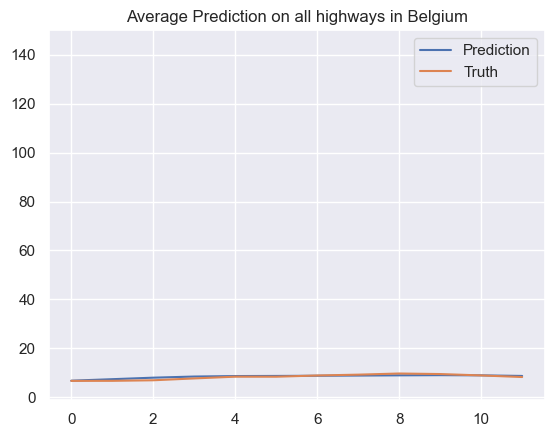

* Time step 114
* Prediction Accuracy (MAE) 2.540416588063985
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


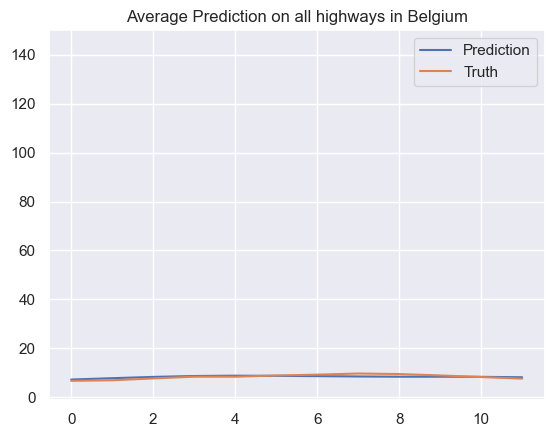

* Time step 115
* Prediction Accuracy (MAE) 2.6044004335361057
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


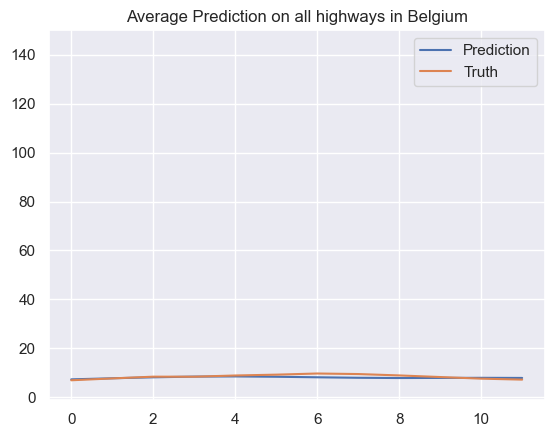

* Time step 116
* Prediction Accuracy (MAE) 2.643903016842362
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


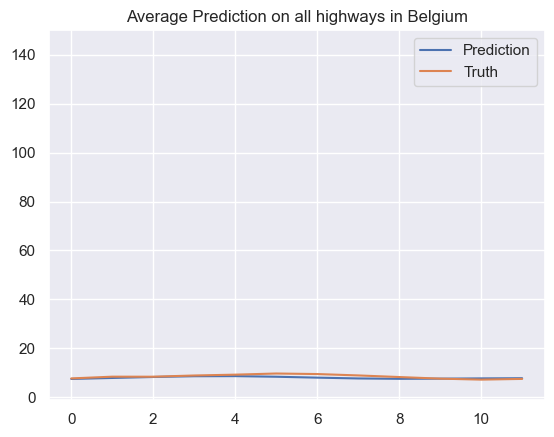

* Time step 117
* Prediction Accuracy (MAE) 2.663141547481714
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


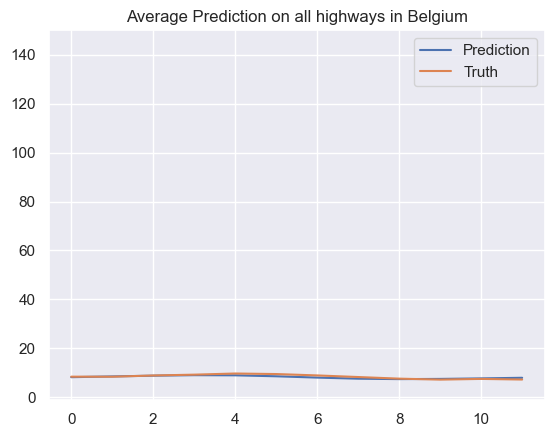

* Time step 118
* Prediction Accuracy (MAE) 2.586864859049768
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.039, Accuracy RMSE: 0.004


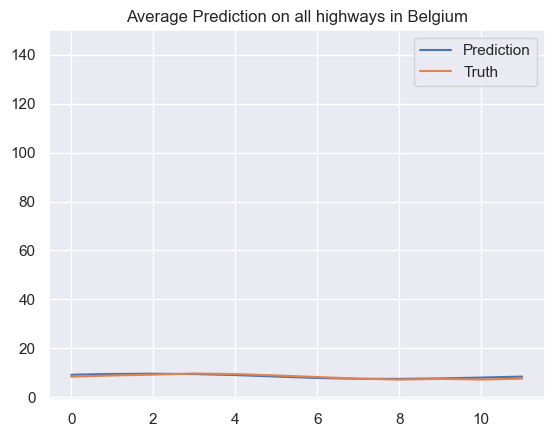

* Time step 119
* Prediction Accuracy (MAE) 2.5776797911635985
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


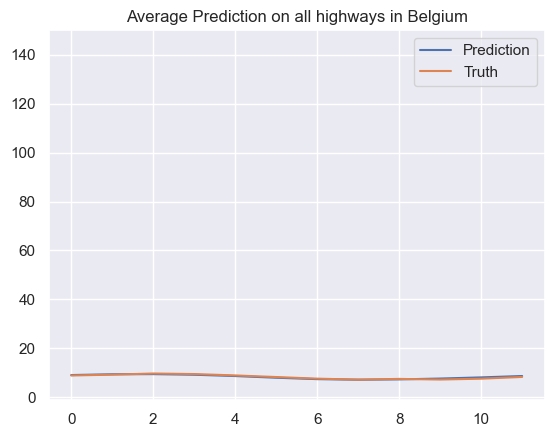

* Time step 120
* Prediction Accuracy (MAE) 2.5385282603103843
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


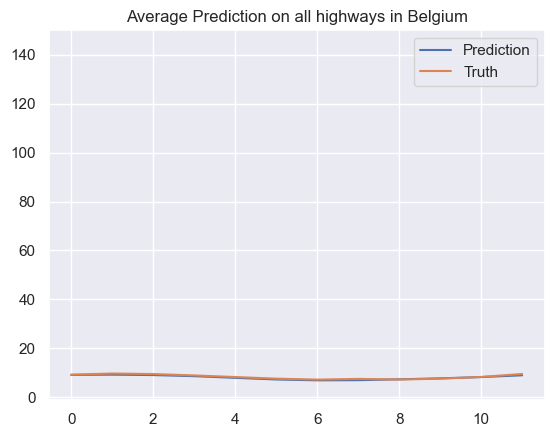

* Time step 121
* Prediction Accuracy (MAE) 2.48386996221018
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


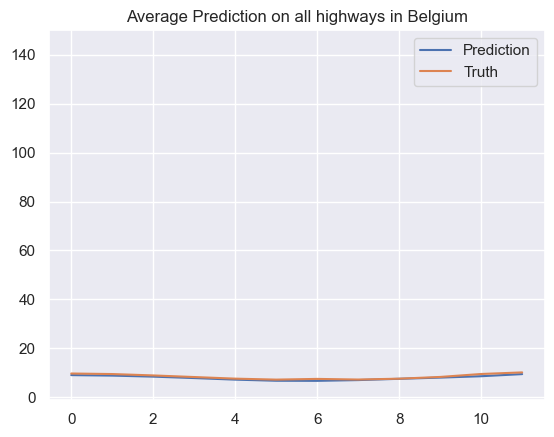

* Time step 122
* Prediction Accuracy (MAE) 2.4861600682309892
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


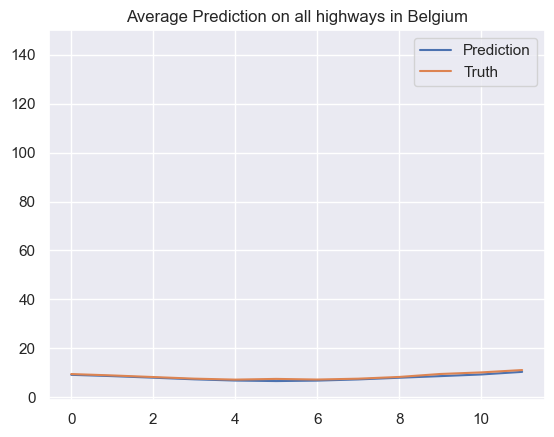

* Time step 123
* Prediction Accuracy (MAE) 2.4627248282783154
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


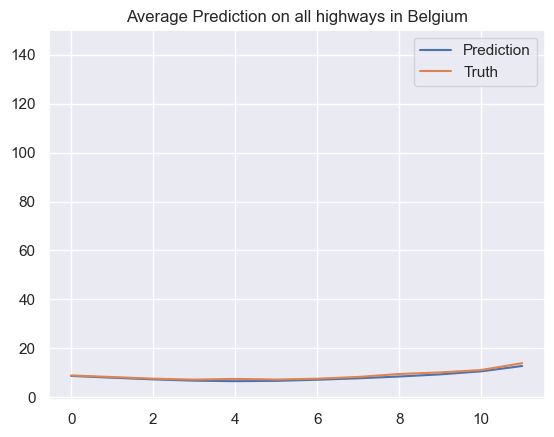

* Time step 124
* Prediction Accuracy (MAE) 2.435030330841963
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


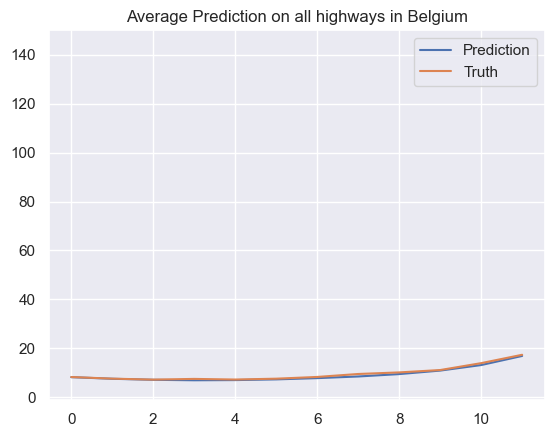

* Time step 125
* Prediction Accuracy (MAE) 2.4964844706384373
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


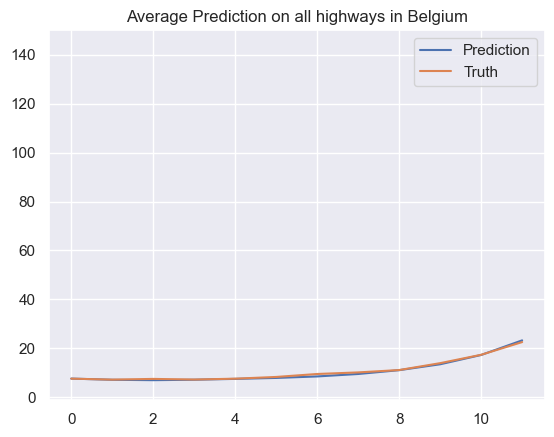

* Time step 126
* Prediction Accuracy (MAE) 2.6185868062350575
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


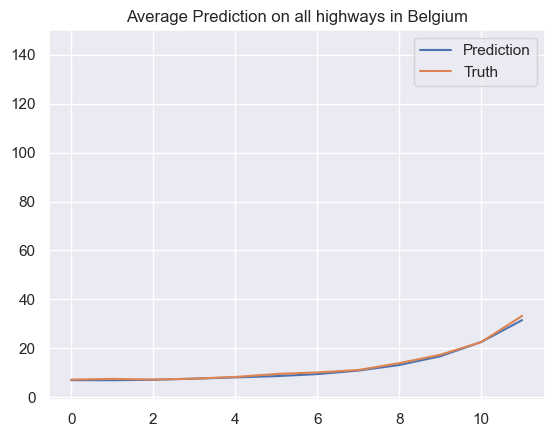

* Time step 127
* Prediction Accuracy (MAE) 2.796575983927034
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


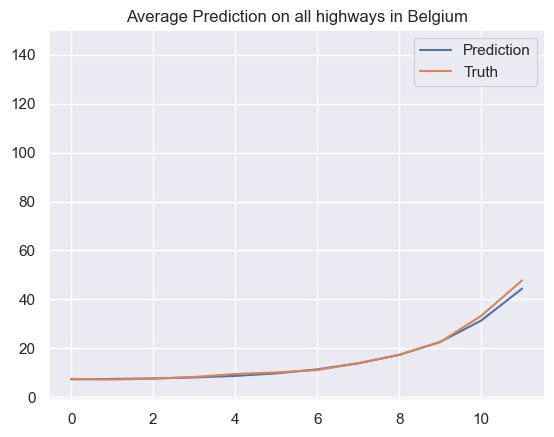

* Time step 128
* Prediction Accuracy (MAE) 3.1479074776523186
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


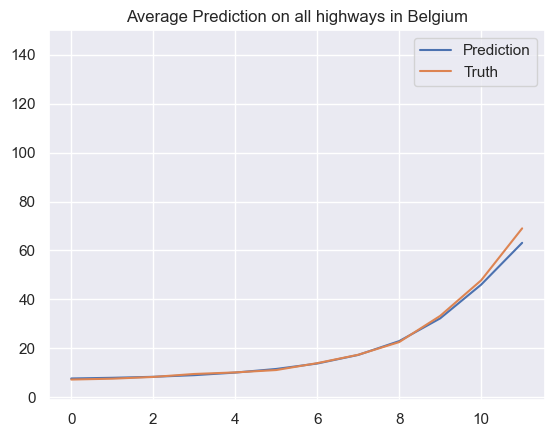

* Time step 129
* Prediction Accuracy (MAE) 3.6828530353567115
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


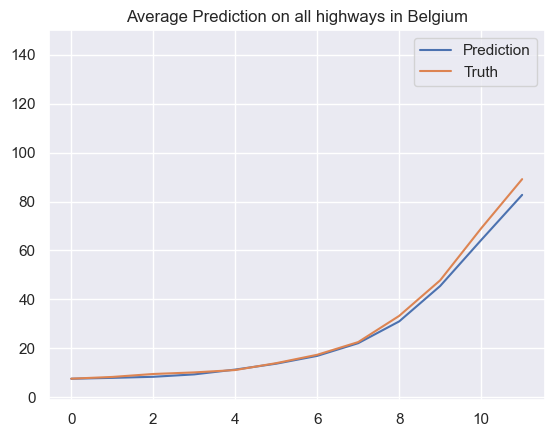

* Time step 130
* Prediction Accuracy (MAE) 4.283895365782323
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


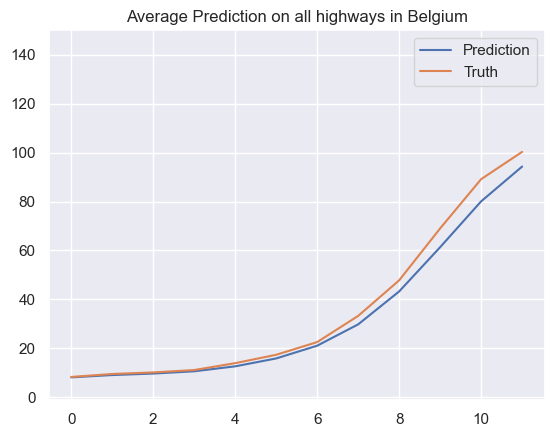

* Time step 131
* Prediction Accuracy (MAE) 5.325679618630009
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


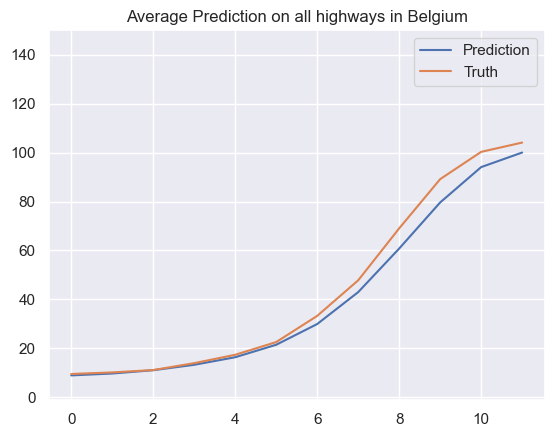

* Time step 132
* Prediction Accuracy (MAE) 6.173864516224354
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


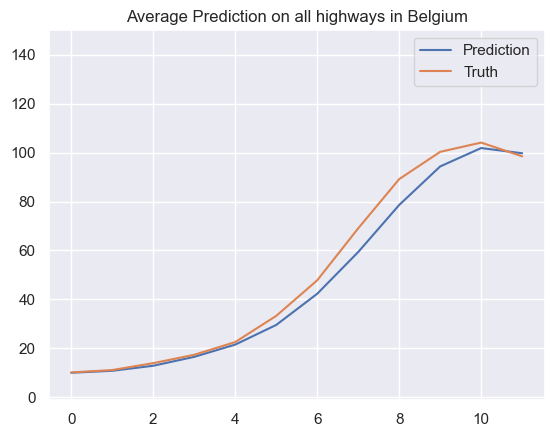

* Time step 133
* Prediction Accuracy (MAE) 7.190401177328053
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


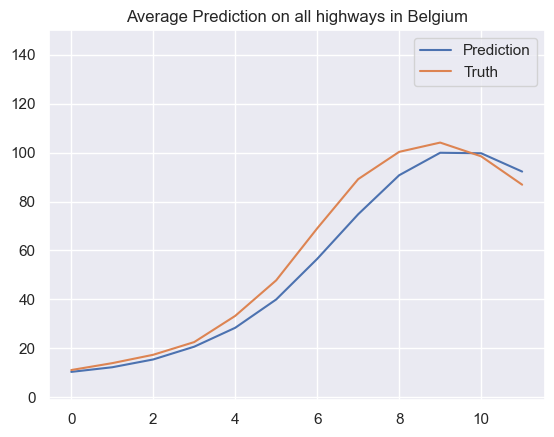

* Time step 134
* Prediction Accuracy (MAE) 8.92738385627509
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


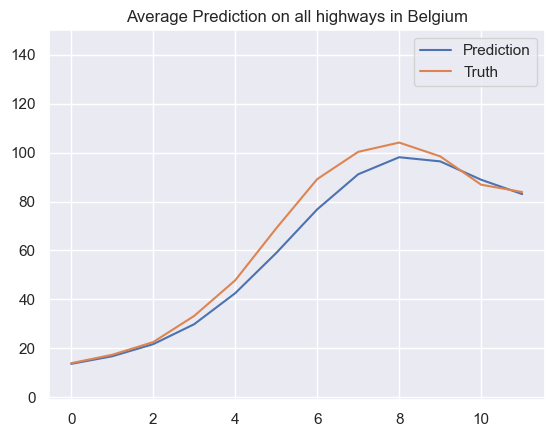

* Time step 135
* Prediction Accuracy (MAE) 8.675731617870113
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


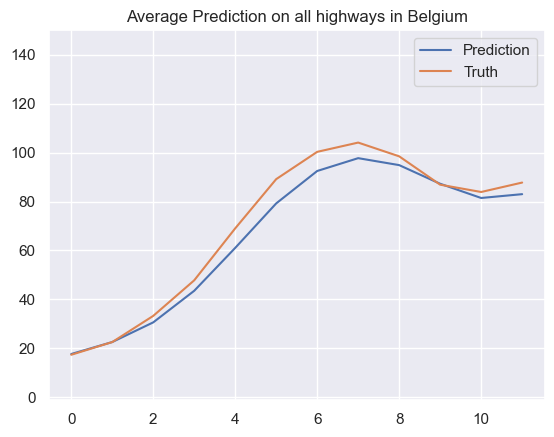

* Time step 136
* Prediction Accuracy (MAE) 8.726886634413608
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


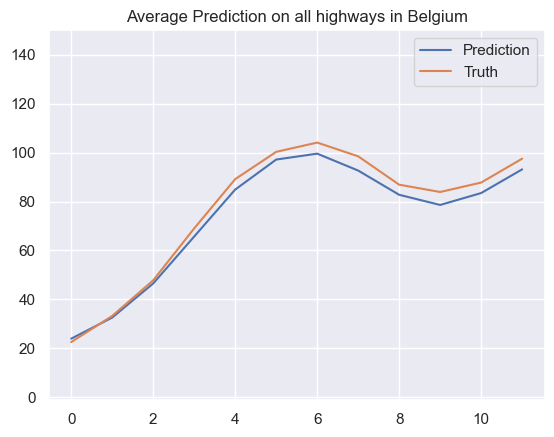

* Time step 137
* Prediction Accuracy (MAE) 8.318832663707003
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


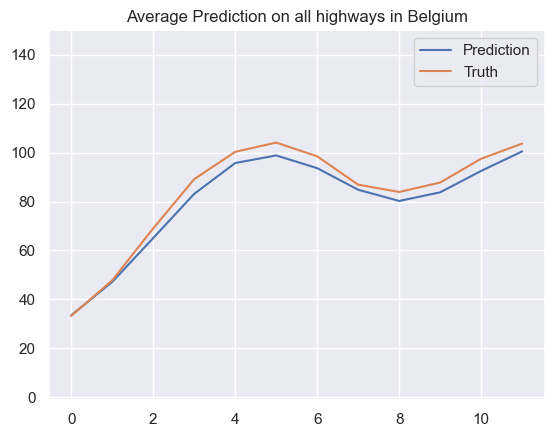

* Time step 138
* Prediction Accuracy (MAE) 8.973111468938063
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


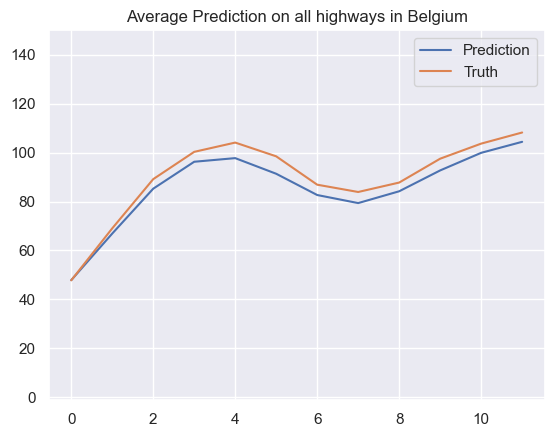

* Time step 139
* Prediction Accuracy (MAE) 9.52557764979985
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


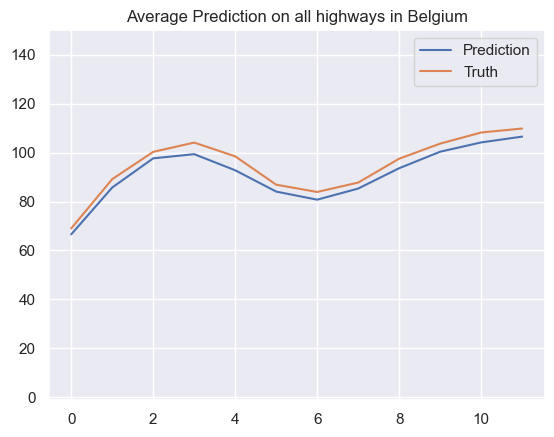

* Time step 140
* Prediction Accuracy (MAE) 9.826591024504072
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


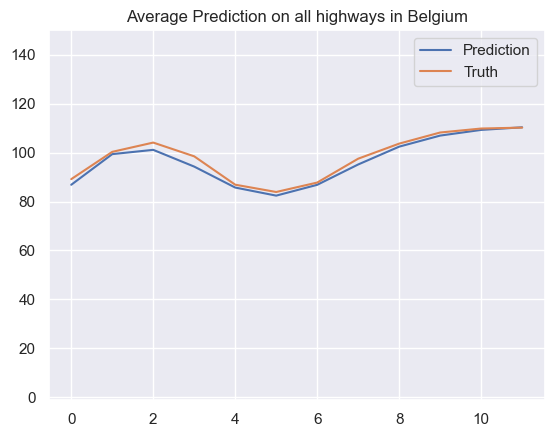

* Time step 141
* Prediction Accuracy (MAE) 9.872030442866922
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


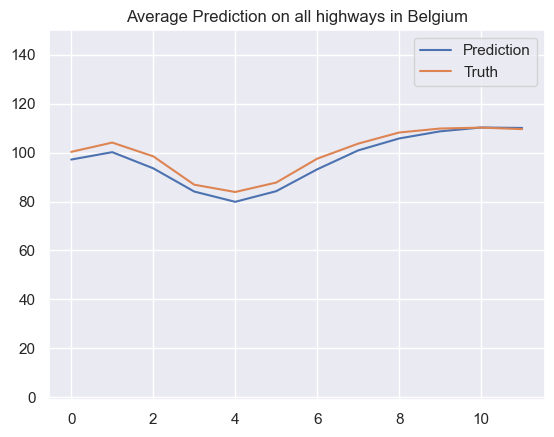

* Time step 142
* Prediction Accuracy (MAE) 10.091661703793422
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


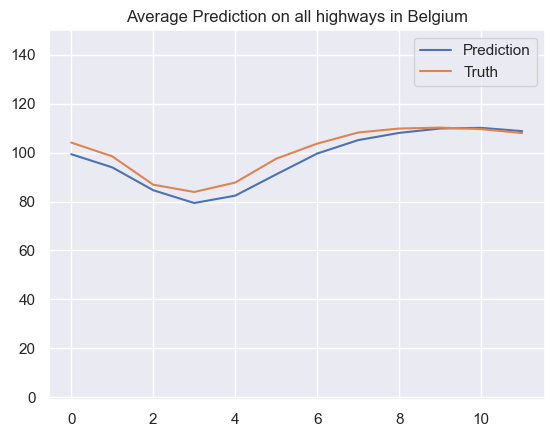

* Time step 143
* Prediction Accuracy (MAE) 10.345965144773457
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


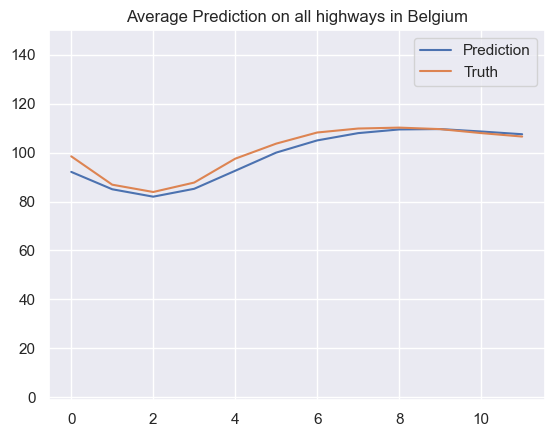

* Time step 144
* Prediction Accuracy (MAE) 10.143280320361242
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


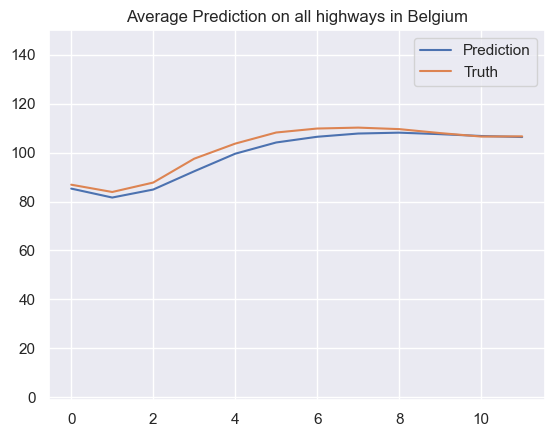

* Time step 145
* Prediction Accuracy (MAE) 10.078429672839441
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


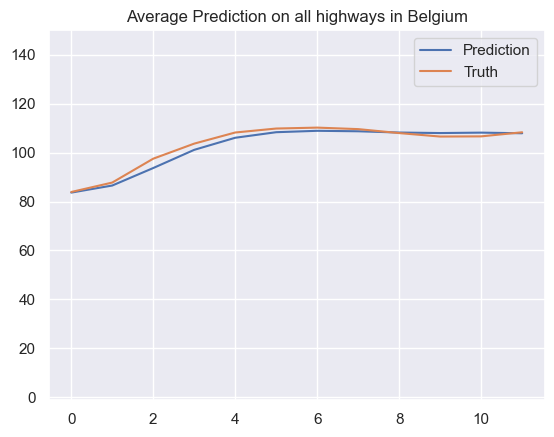

* Time step 146
* Prediction Accuracy (MAE) 9.75898917742276
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


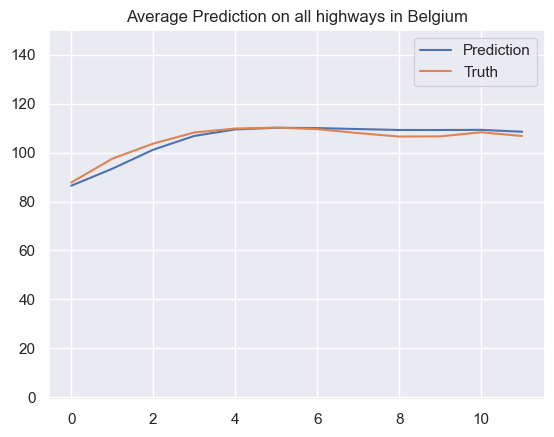

* Time step 147
* Prediction Accuracy (MAE) 9.803382103872256
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


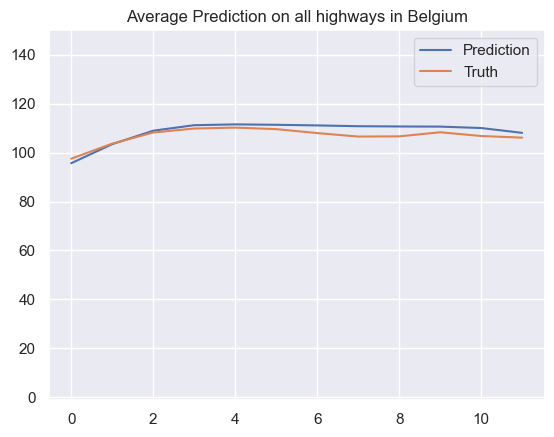

* Time step 148
* Prediction Accuracy (MAE) 10.263315252026917
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


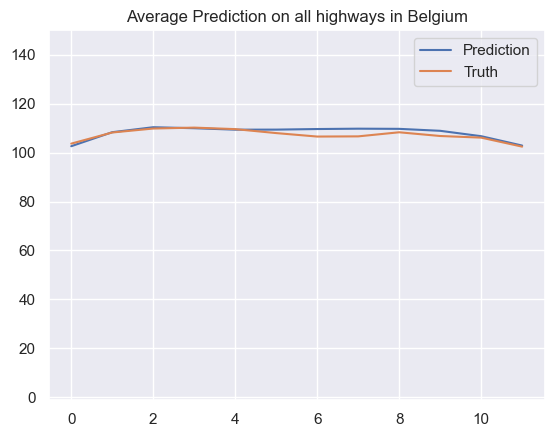

* Time step 149
* Prediction Accuracy (MAE) 10.26677145037233
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


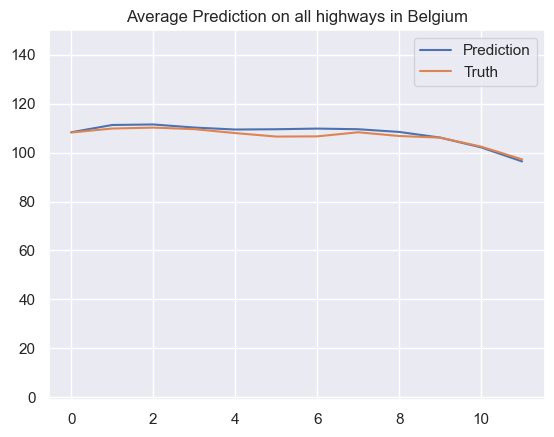

* Time step 150
* Prediction Accuracy (MAE) 10.170209582102489
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


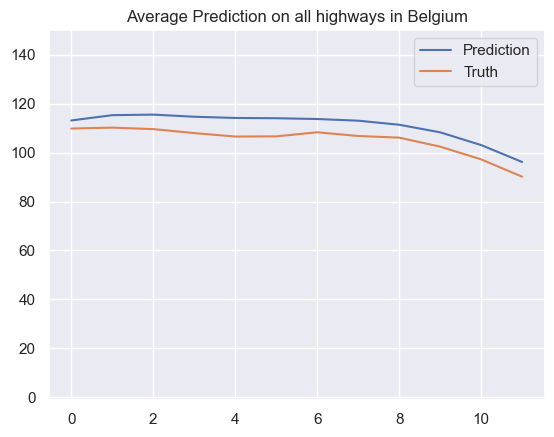

* Time step 151
* Prediction Accuracy (MAE) 11.564984184479835
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


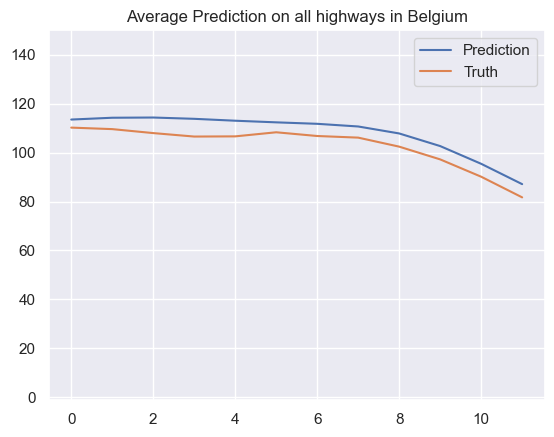

* Time step 152
* Prediction Accuracy (MAE) 11.360233515502106
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


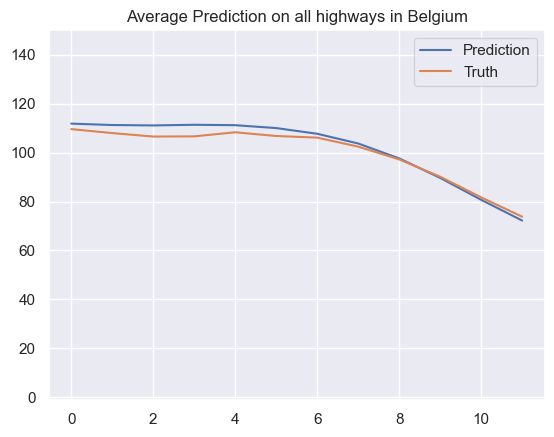

* Time step 153
* Prediction Accuracy (MAE) 10.124040609419232
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


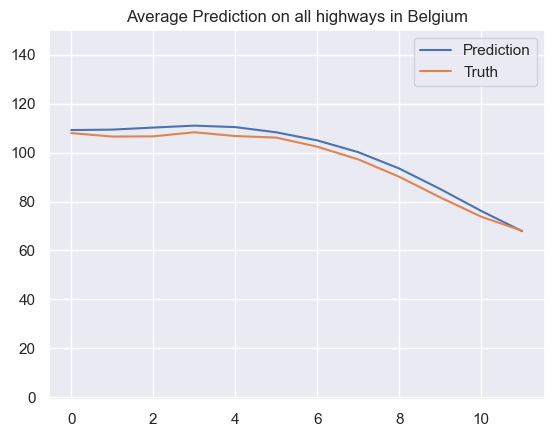

* Time step 154
* Prediction Accuracy (MAE) 9.958486327011318
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


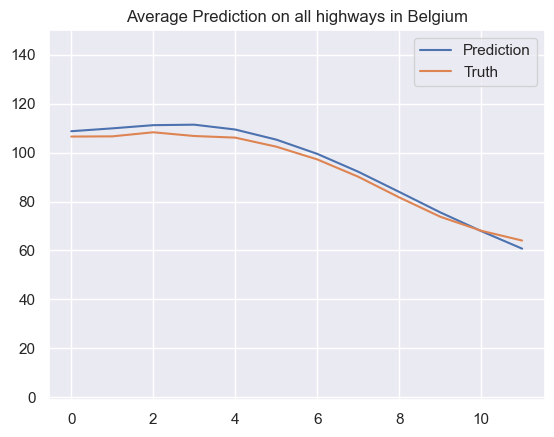

* Time step 155
* Prediction Accuracy (MAE) 10.322946333696411
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


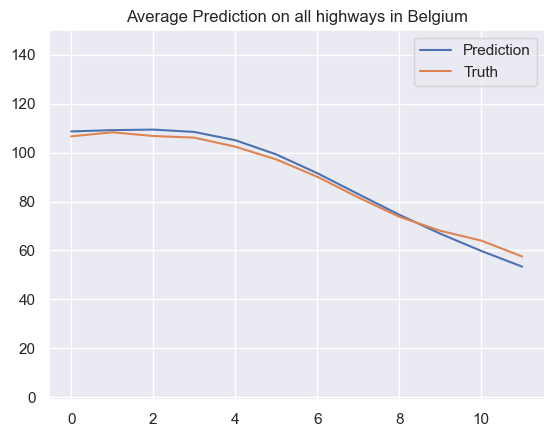

* Time step 156
* Prediction Accuracy (MAE) 10.058436536135241
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


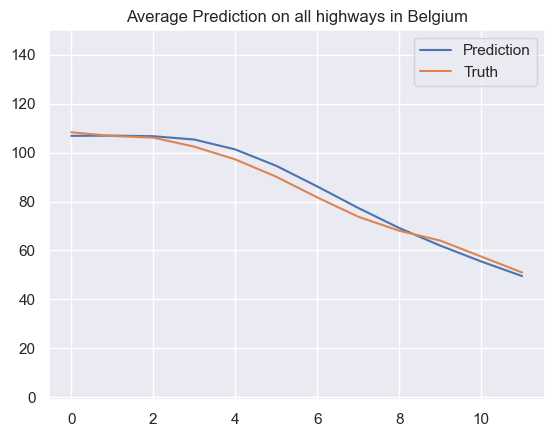

* Time step 157
* Prediction Accuracy (MAE) 10.197360250265298
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


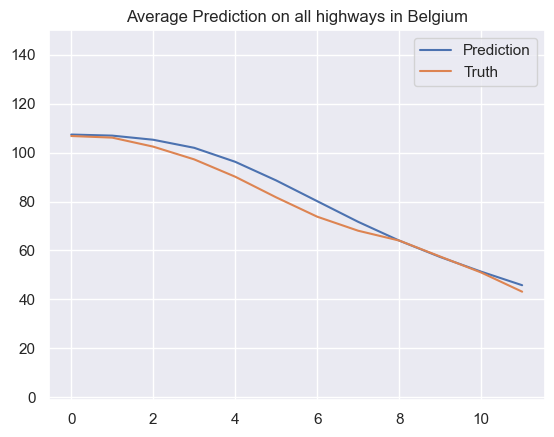

* Time step 158
* Prediction Accuracy (MAE) 10.321403155621178
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


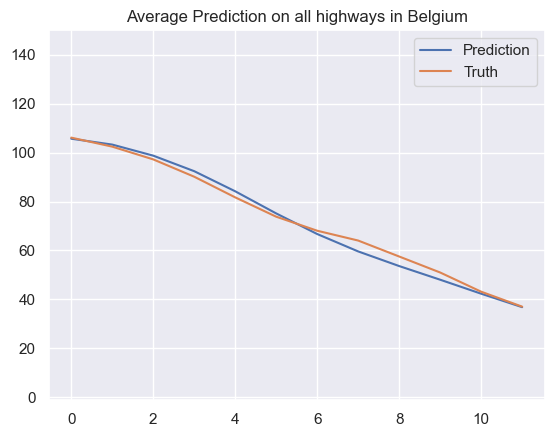

* Time step 159
* Prediction Accuracy (MAE) 9.159434115359378
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


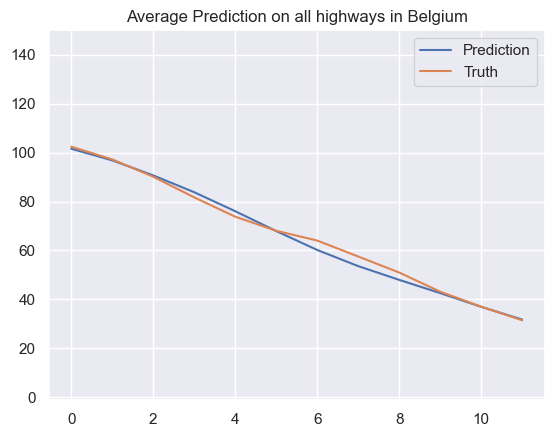

* Time step 160
* Prediction Accuracy (MAE) 8.634782973485686
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


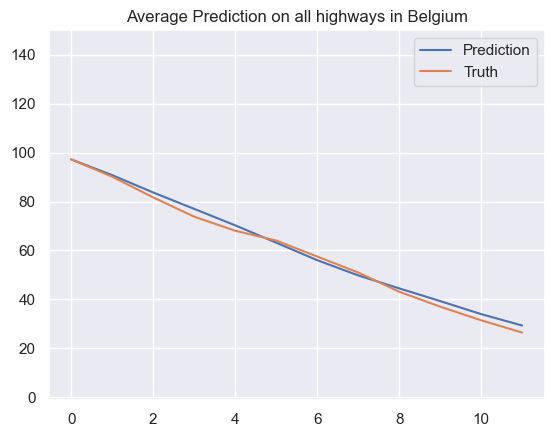

* Time step 161
* Prediction Accuracy (MAE) 8.397920867268597
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


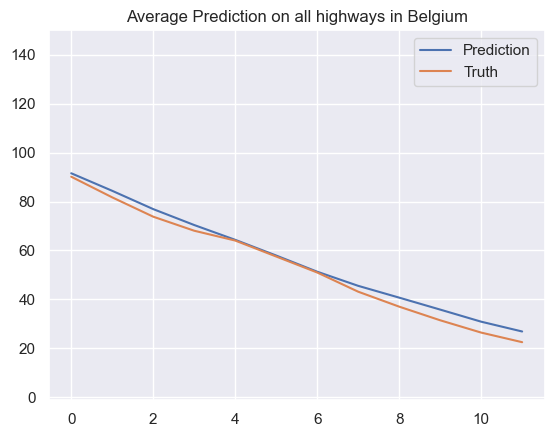

* Time step 162
* Prediction Accuracy (MAE) 8.462562252115134
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


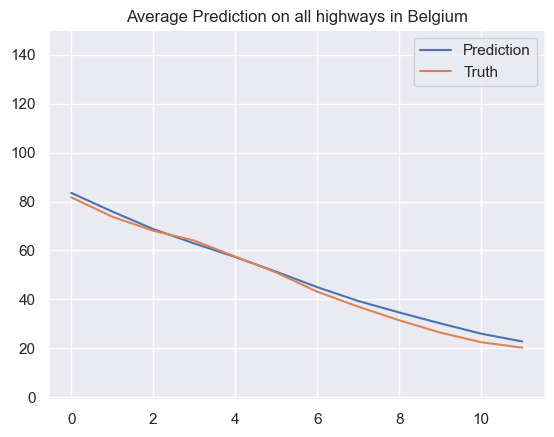

* Time step 163
* Prediction Accuracy (MAE) 7.593296473552863
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


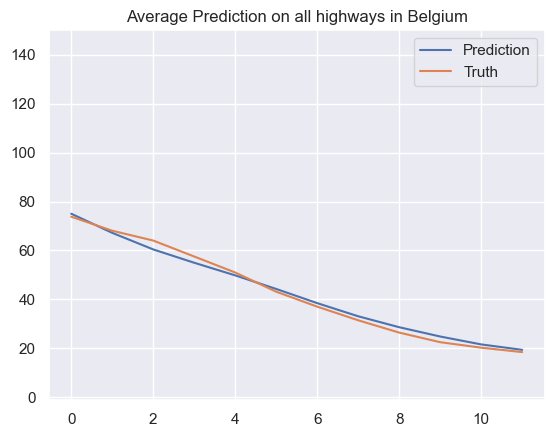

* Time step 164
* Prediction Accuracy (MAE) 6.6477663679296635
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


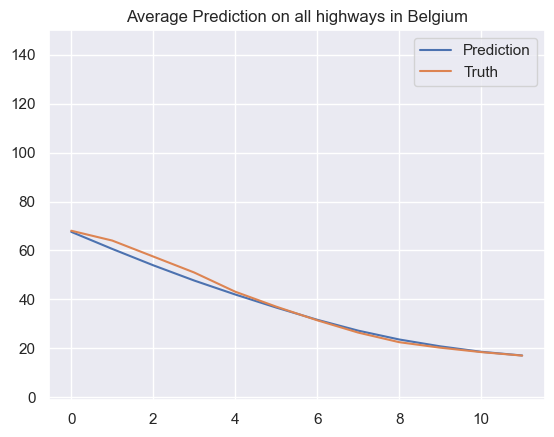

* Time step 165
* Prediction Accuracy (MAE) 6.053666578251516
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


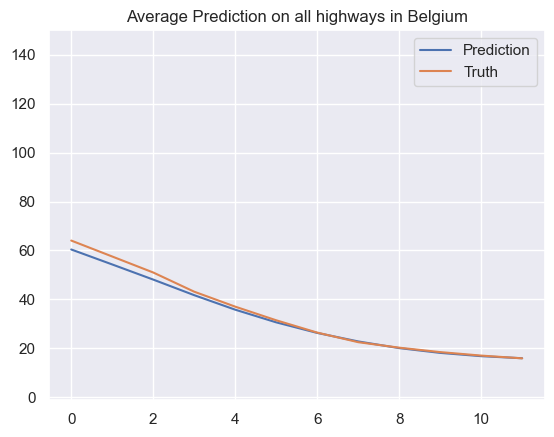

* Time step 166
* Prediction Accuracy (MAE) 5.530760883495234
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


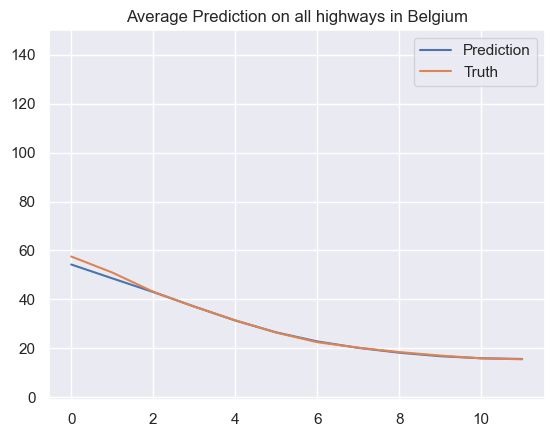

* Time step 167
* Prediction Accuracy (MAE) 5.019166614724343
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


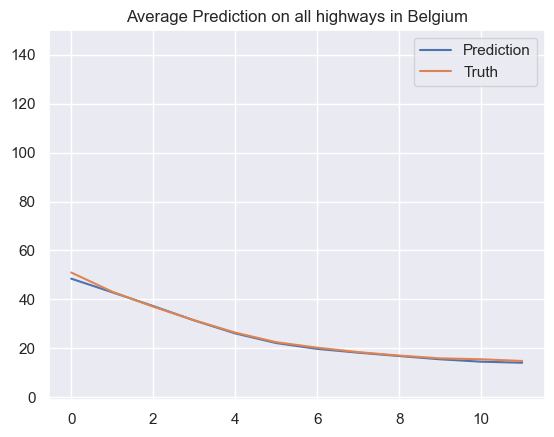

* Time step 168
* Prediction Accuracy (MAE) 4.461676950995609
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


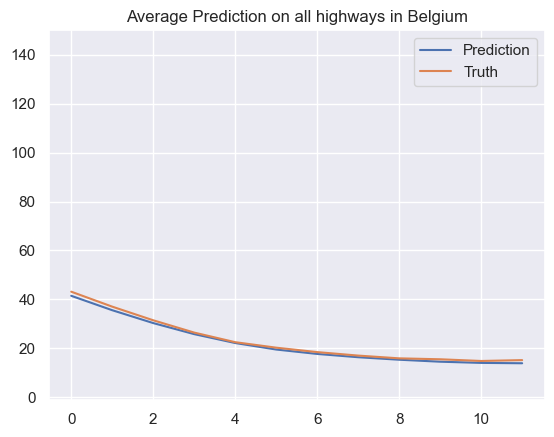

* Time step 169
* Prediction Accuracy (MAE) 3.962313526784082
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


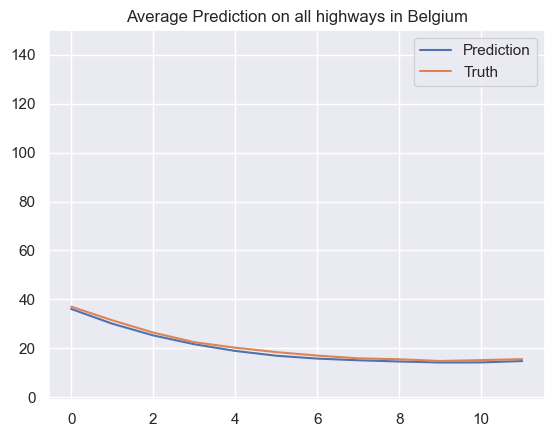

* Time step 170
* Prediction Accuracy (MAE) 3.862624972519808
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


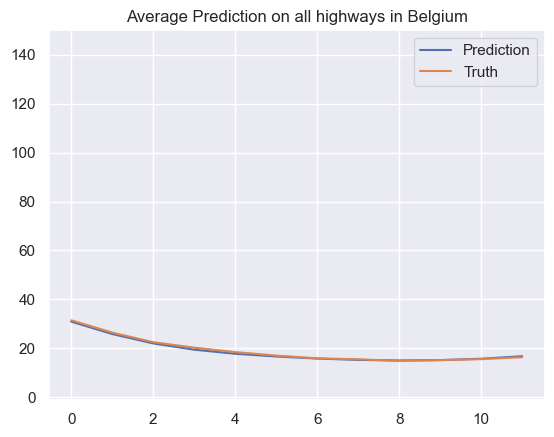

* Time step 171
* Prediction Accuracy (MAE) 3.4744176104093083
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


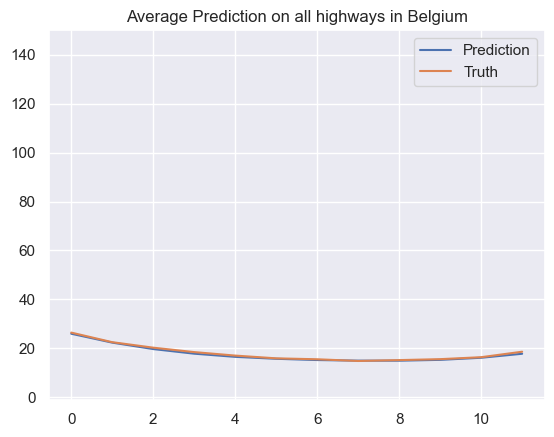

* Time step 172
* Prediction Accuracy (MAE) 3.3447960043920673
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


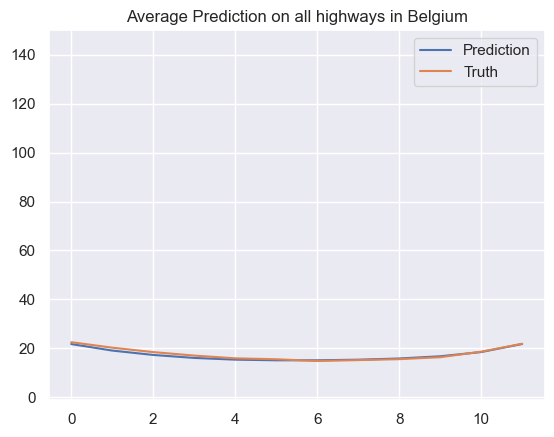

* Time step 173
* Prediction Accuracy (MAE) 3.216426616510285
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


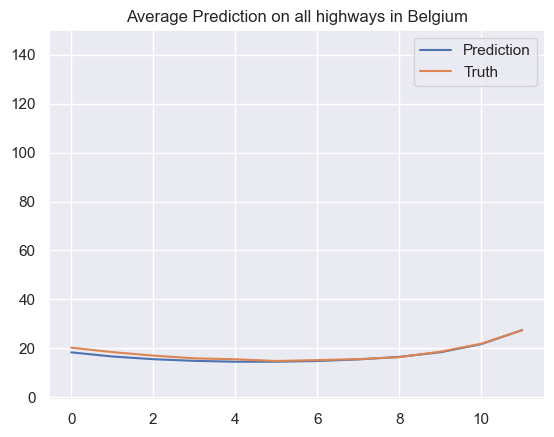

* Time step 174
* Prediction Accuracy (MAE) 3.278720766217495
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


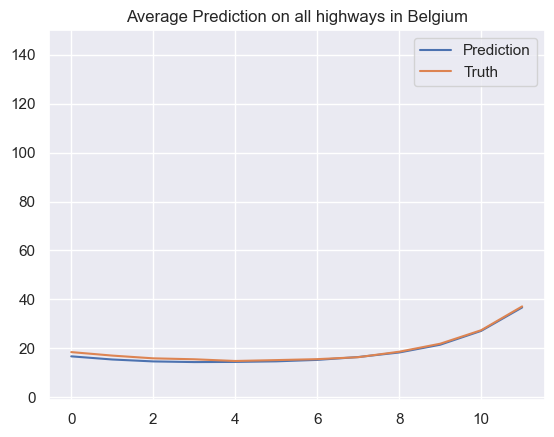

* Time step 175
* Prediction Accuracy (MAE) 3.3846501838073313
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


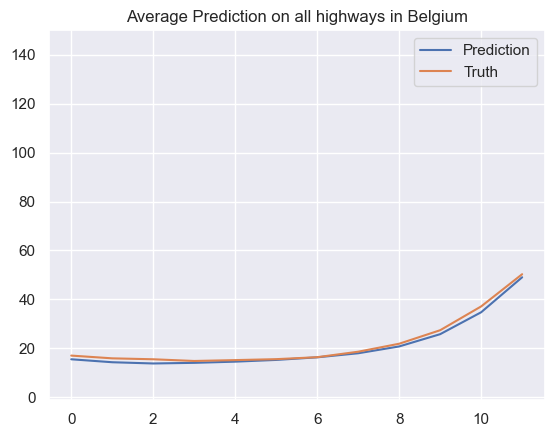

* Time step 176
* Prediction Accuracy (MAE) 3.6333539229852443
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


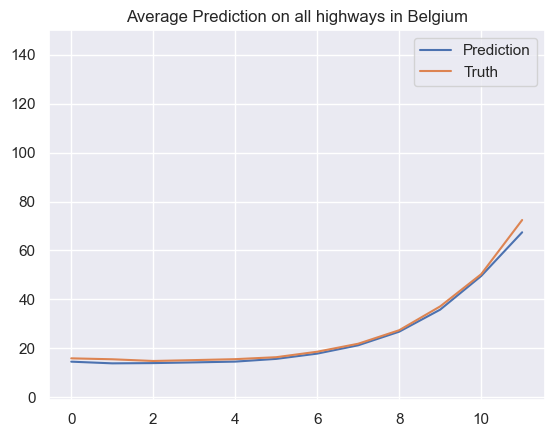

* Time step 177
* Prediction Accuracy (MAE) 4.022213463729665
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


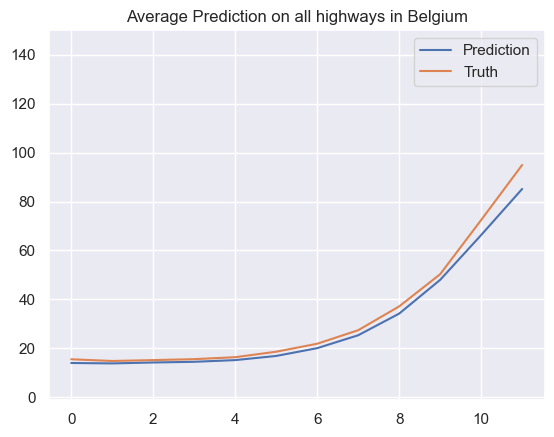

* Time step 178
* Prediction Accuracy (MAE) 4.889459646363621
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


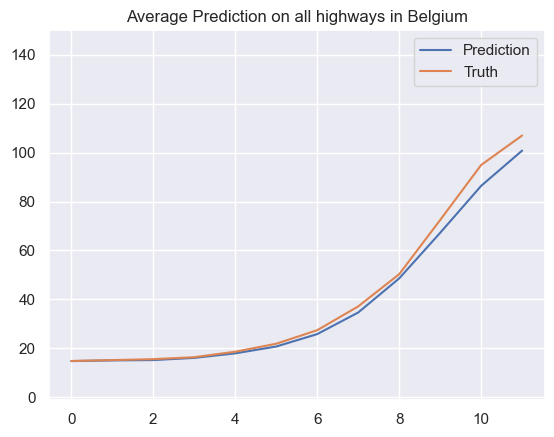

* Time step 179
* Prediction Accuracy (MAE) 5.362647986071267
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


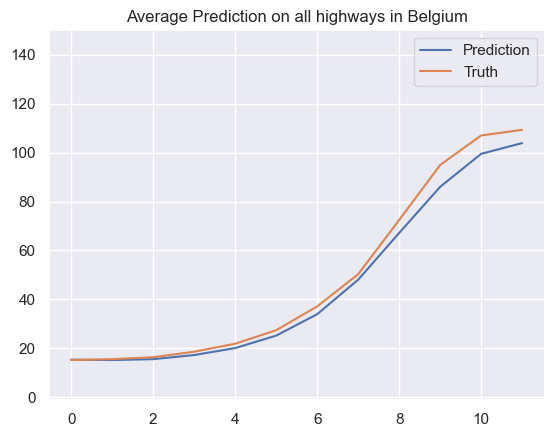

* Time step 180
* Prediction Accuracy (MAE) 6.183476700248387
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


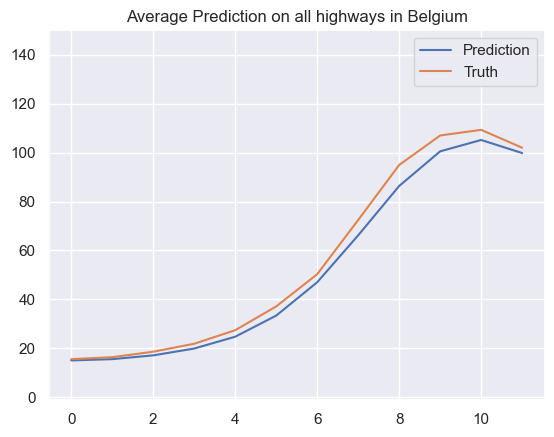

* Time step 181
* Prediction Accuracy (MAE) 6.815290128773981
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


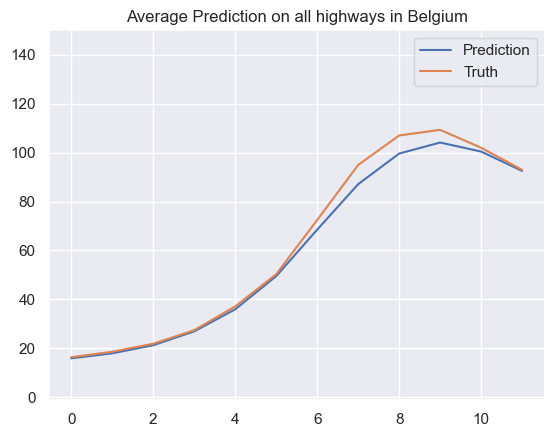

* Time step 182
* Prediction Accuracy (MAE) 7.070139651601664
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


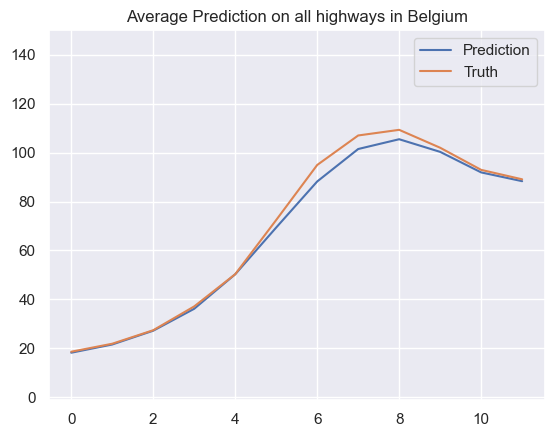

* Time step 183
* Prediction Accuracy (MAE) 7.247497638776796
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


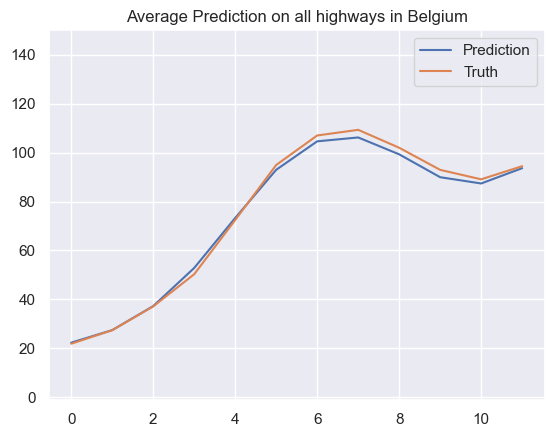

* Time step 184
* Prediction Accuracy (MAE) 7.623731239925151
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


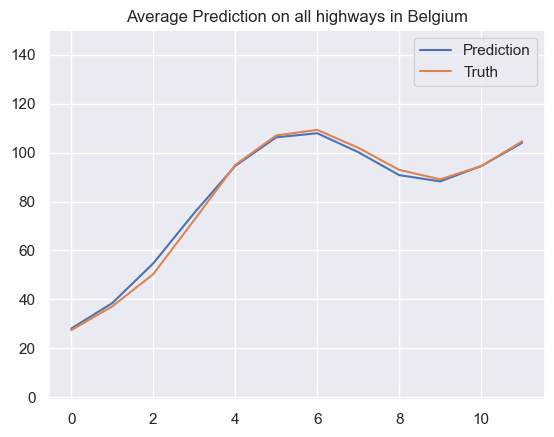

* Time step 185
* Prediction Accuracy (MAE) 8.252221245879413
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


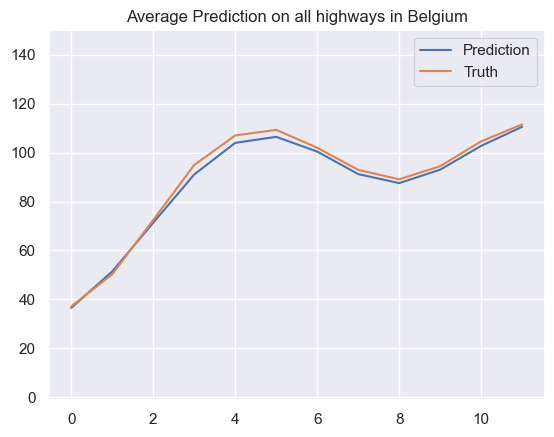

* Time step 186
* Prediction Accuracy (MAE) 8.855730036972565
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


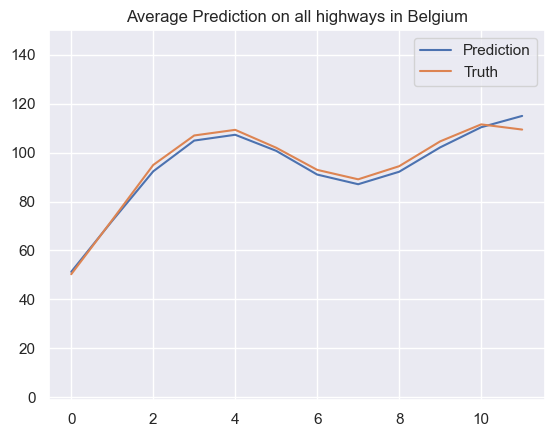

* Time step 187
* Prediction Accuracy (MAE) 9.516090196716625
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


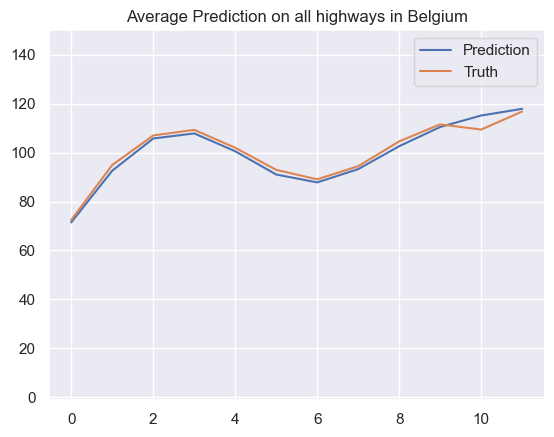

* Time step 188
* Prediction Accuracy (MAE) 10.065321730231824
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


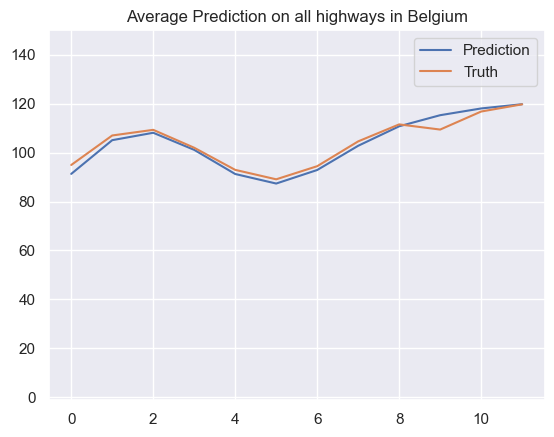

* Time step 189
* Prediction Accuracy (MAE) 10.259685707927321
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


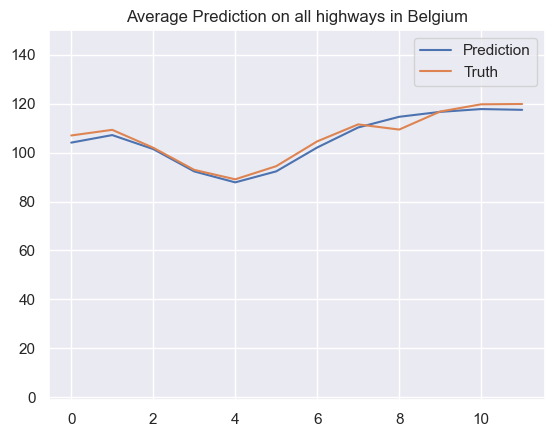

* Time step 190
* Prediction Accuracy (MAE) 10.400163046624264
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


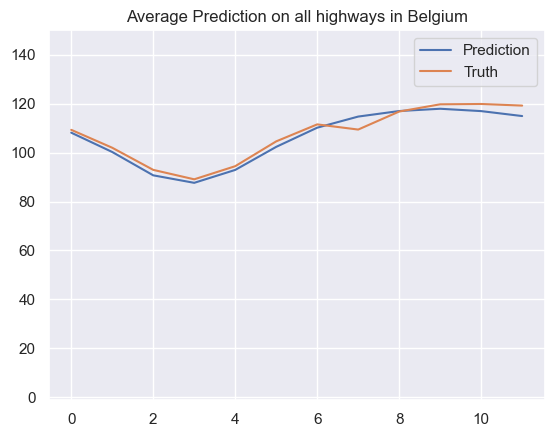

* Time step 191
* Prediction Accuracy (MAE) 10.349265988451513
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


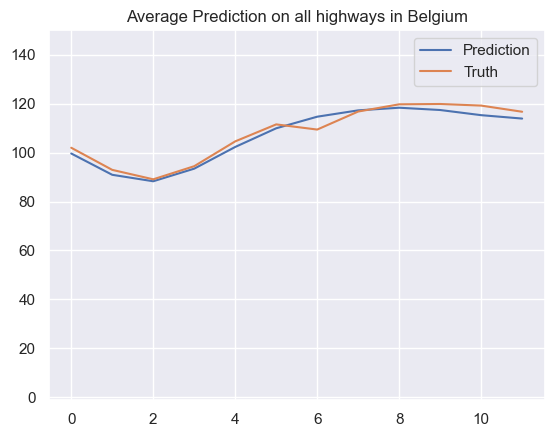

* Time step 192
* Prediction Accuracy (MAE) 10.473121563618728
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


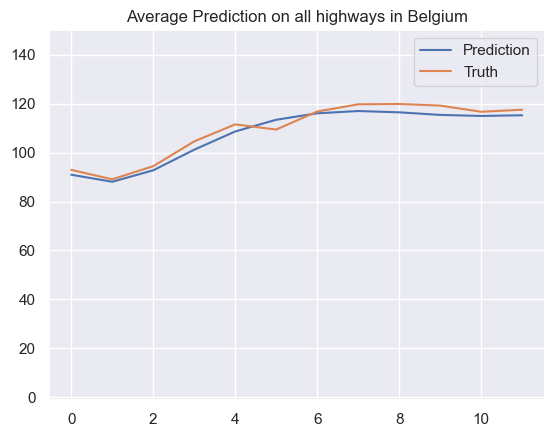

* Time step 193
* Prediction Accuracy (MAE) 10.598134199231007
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


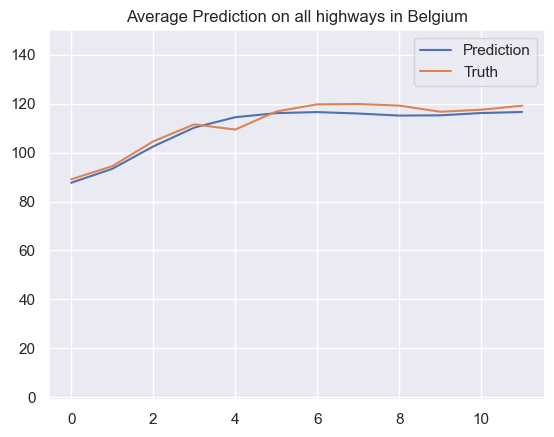

* Time step 194
* Prediction Accuracy (MAE) 10.816950201681976
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


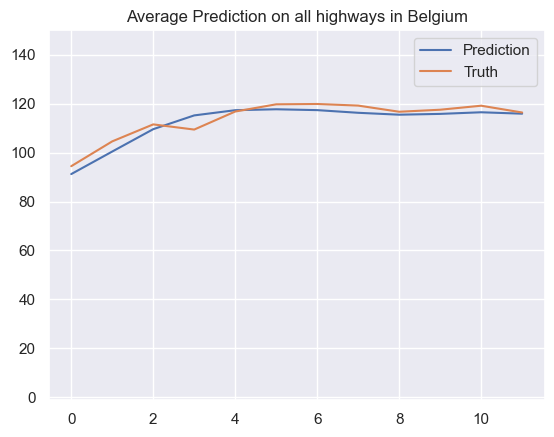

* Time step 195
* Prediction Accuracy (MAE) 10.820124161801338
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


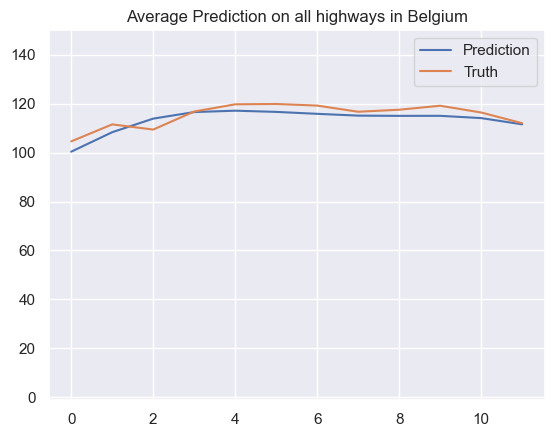

* Time step 196
* Prediction Accuracy (MAE) 11.081429051170332
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


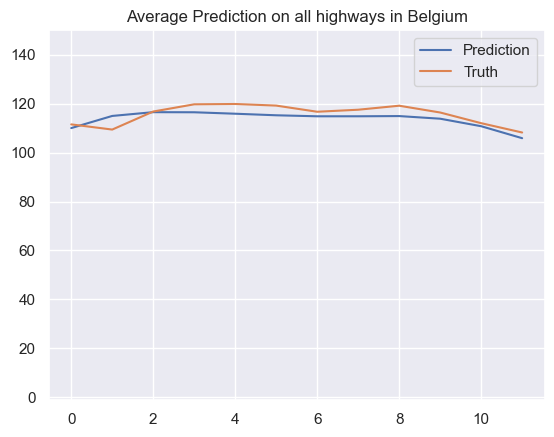

* Time step 197
* Prediction Accuracy (MAE) 11.384814383360261
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


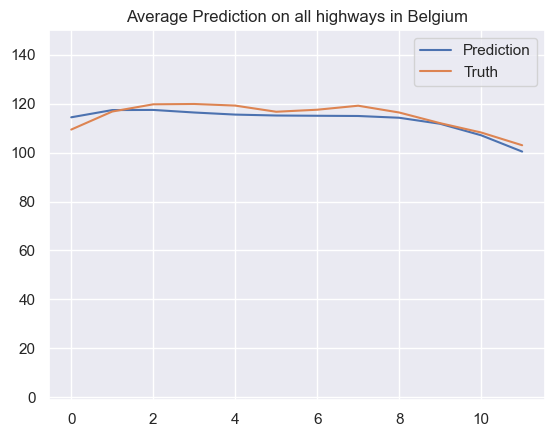

* Time step 198
* Prediction Accuracy (MAE) 11.294916074620653
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


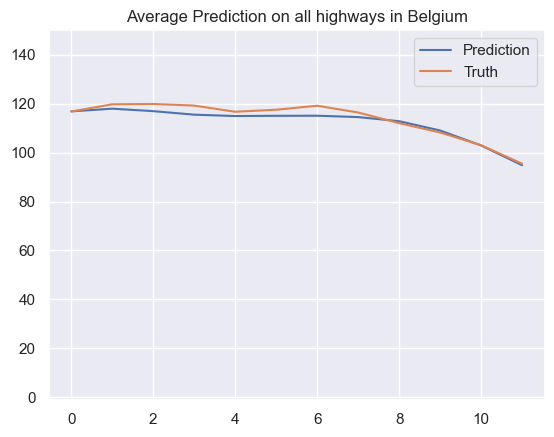

* Time step 199
* Prediction Accuracy (MAE) 11.134924495492257
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


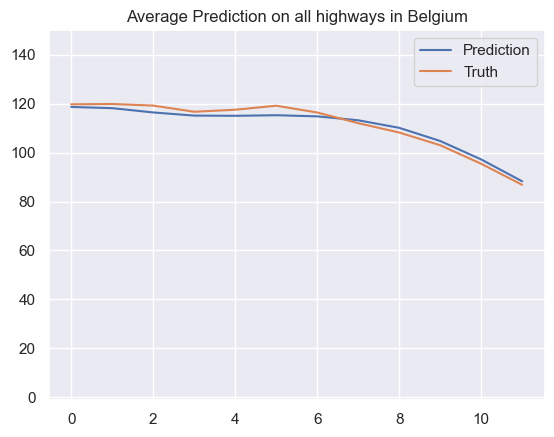

* Time step 200
* Prediction Accuracy (MAE) 11.063718178260084
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


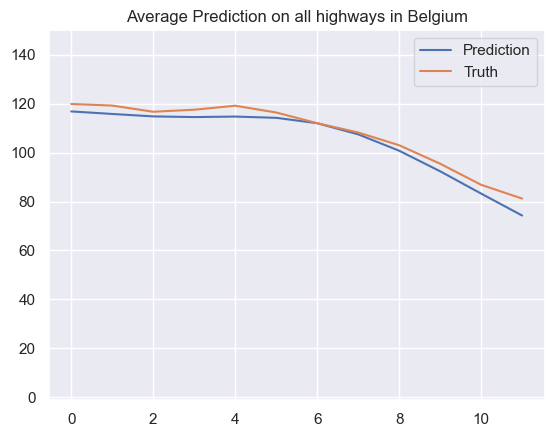

* Time step 201
* Prediction Accuracy (MAE) 11.125494052244827
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


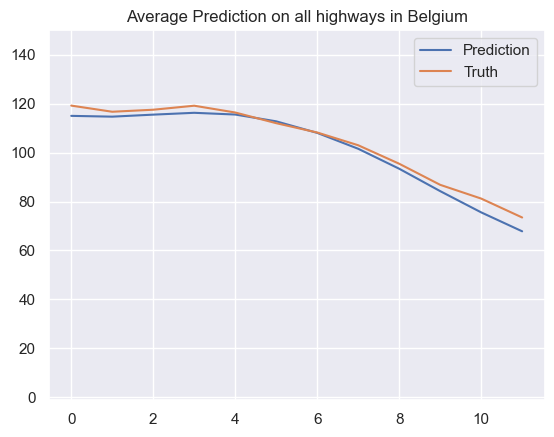

* Time step 202
* Prediction Accuracy (MAE) 10.923111726368244
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


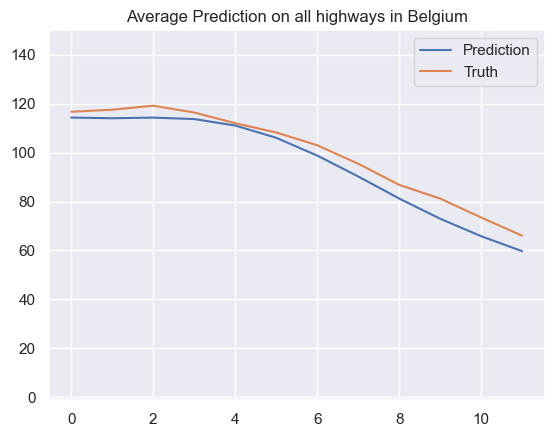

* Time step 203
* Prediction Accuracy (MAE) 11.5207110070945
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


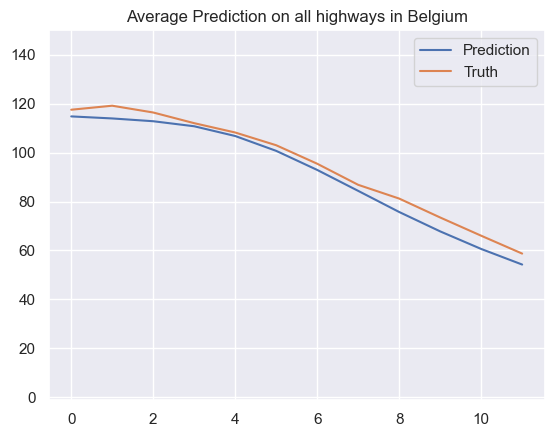

* Time step 204
* Prediction Accuracy (MAE) 10.795159411951028
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


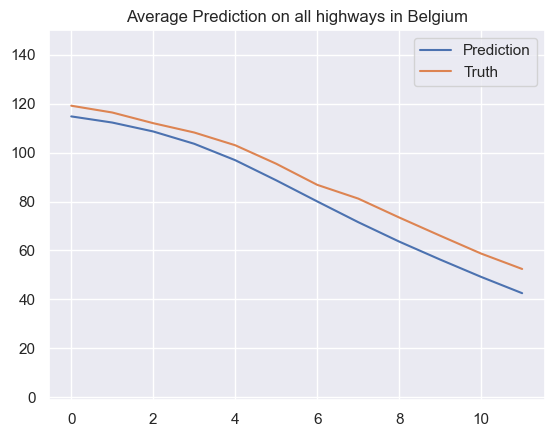

* Time step 205
* Prediction Accuracy (MAE) 12.09069498291442
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


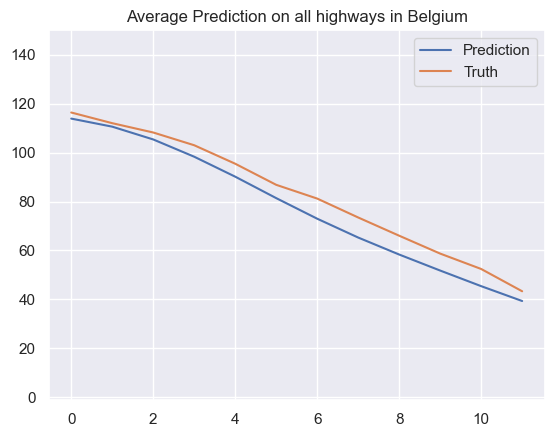

* Time step 206
* Prediction Accuracy (MAE) 11.023319745985708
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


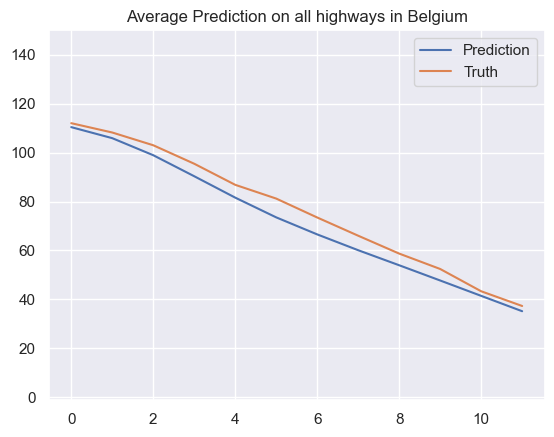

* Time step 207
* Prediction Accuracy (MAE) 10.22577577854954
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


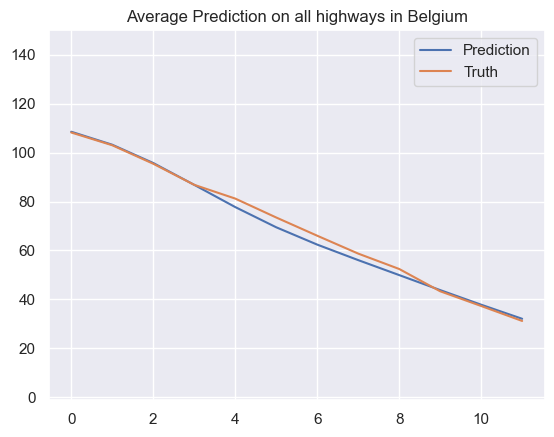

* Time step 208
* Prediction Accuracy (MAE) 9.208223223206765
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


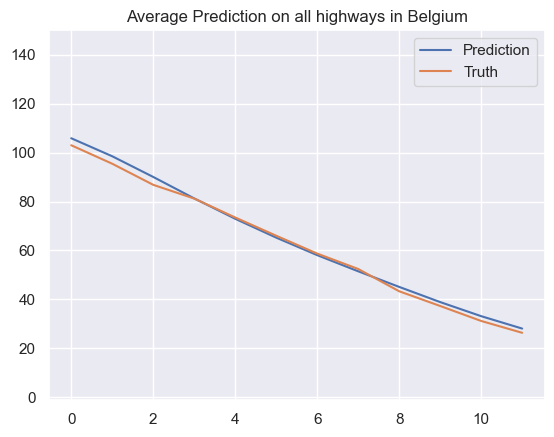

* Time step 209
* Prediction Accuracy (MAE) 8.822495162814208
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


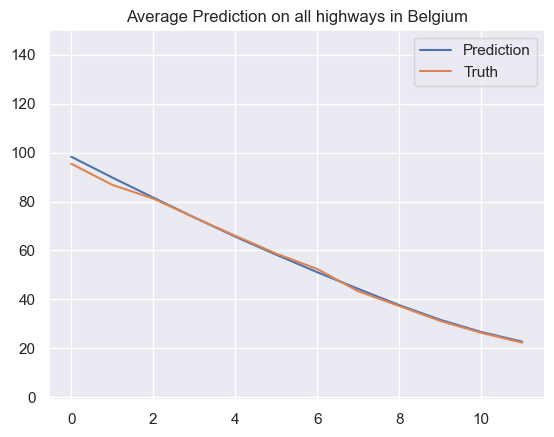

* Time step 210
* Prediction Accuracy (MAE) 8.00106107202275
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


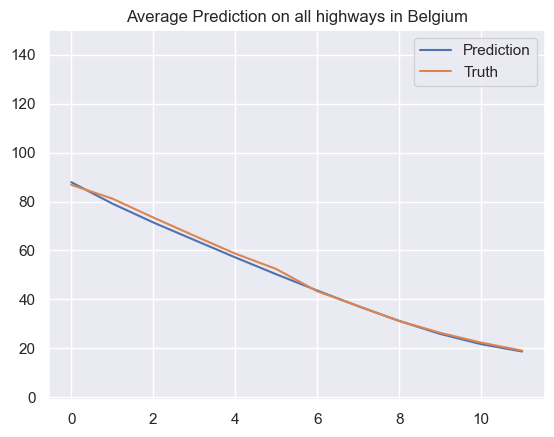

* Time step 211
* Prediction Accuracy (MAE) 7.11037104642549
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


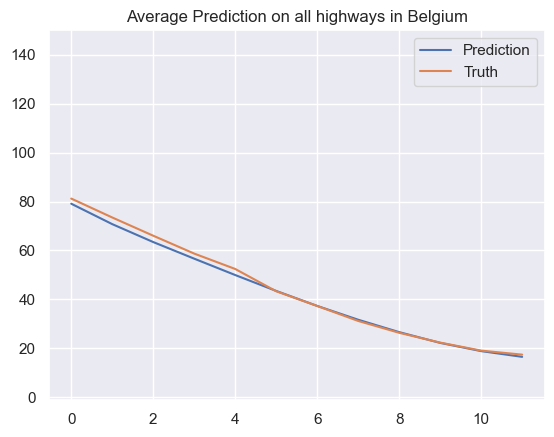

* Time step 212
* Prediction Accuracy (MAE) 6.639766907934246
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


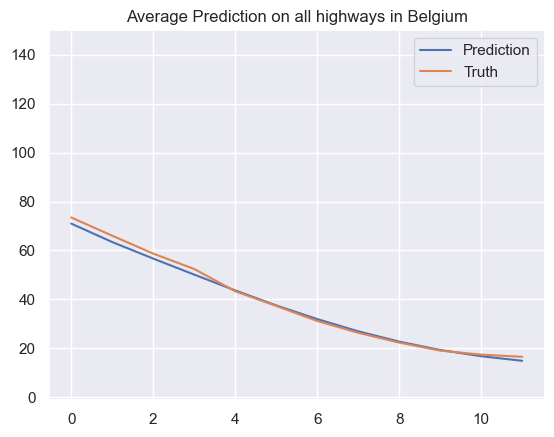

* Time step 213
* Prediction Accuracy (MAE) 6.197223171880265
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


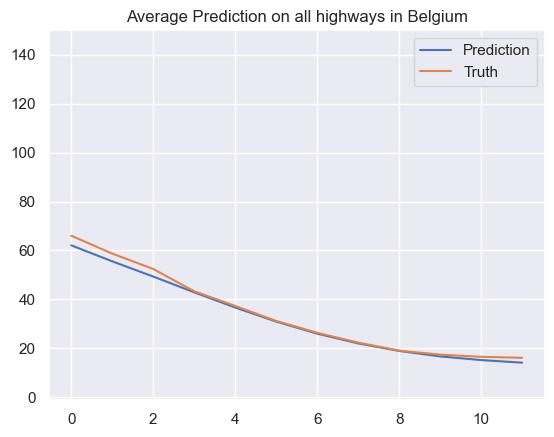

* Time step 214
* Prediction Accuracy (MAE) 5.542465277205866
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


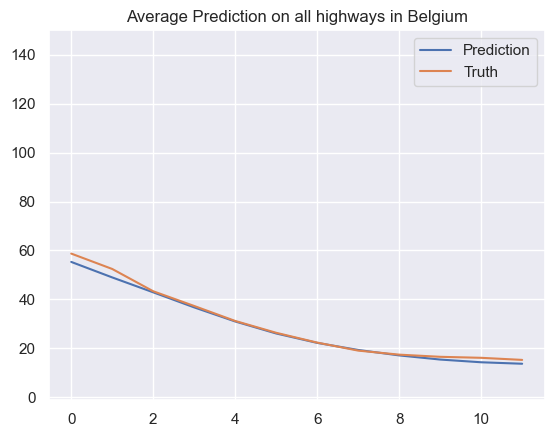

* Time step 215
* Prediction Accuracy (MAE) 5.1112741358451546
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


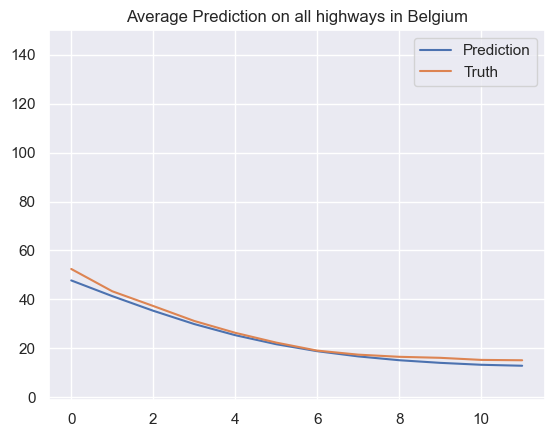

* Time step 216
* Prediction Accuracy (MAE) 4.765012490897422
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


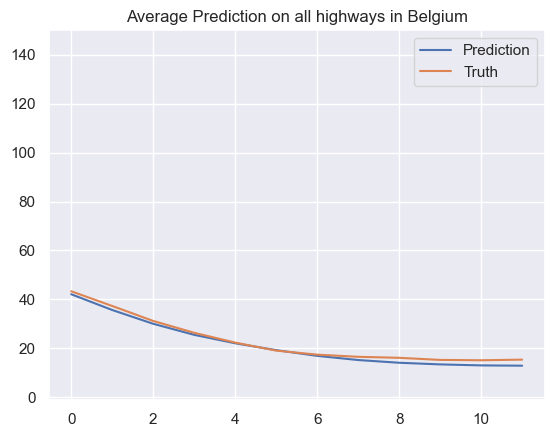

* Time step 217
* Prediction Accuracy (MAE) 4.3799338516068715
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


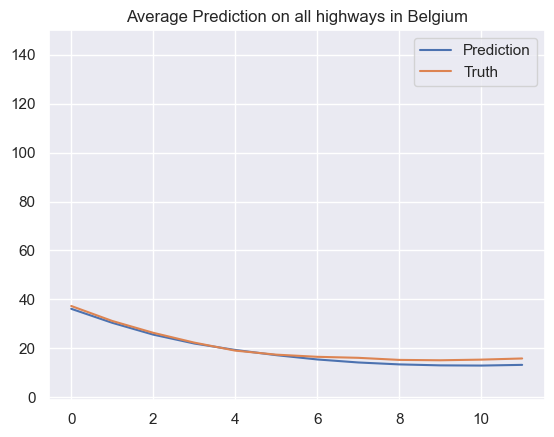

* Time step 218
* Prediction Accuracy (MAE) 4.035002050505621
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


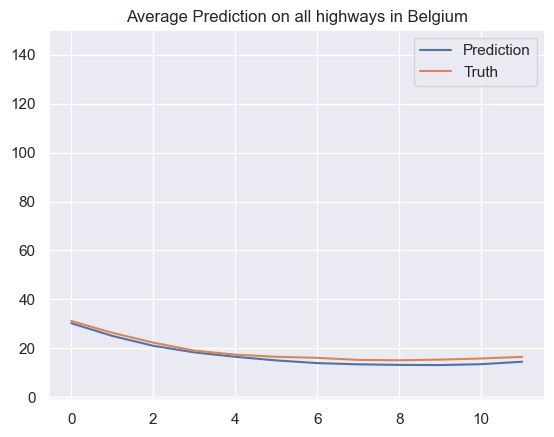

* Time step 219
* Prediction Accuracy (MAE) 3.8395685797954884
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


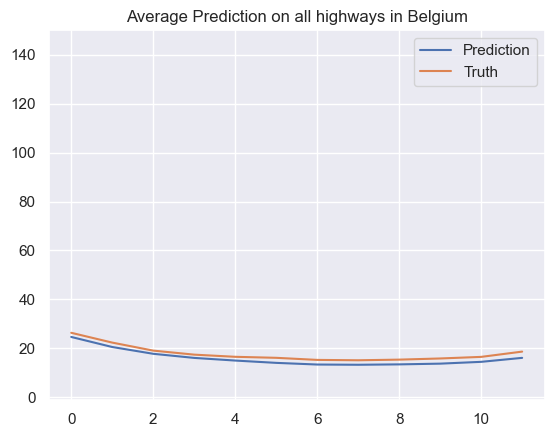

* Time step 220
* Prediction Accuracy (MAE) 3.763021445444499
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


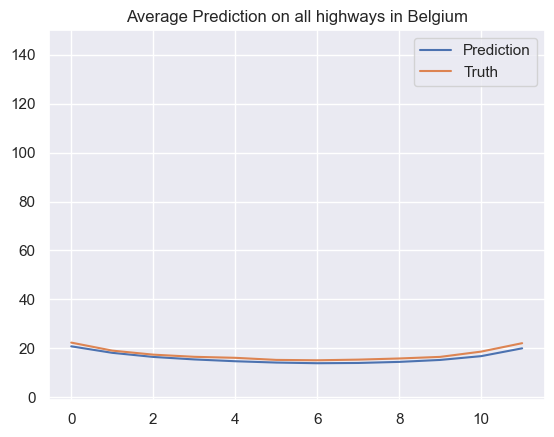

* Time step 221
* Prediction Accuracy (MAE) 3.4543248030058087
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


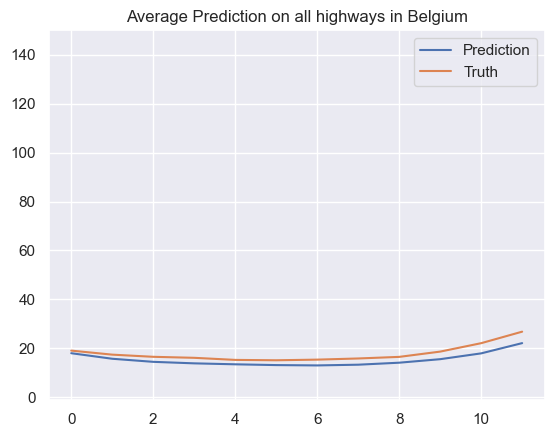

* Time step 222
* Prediction Accuracy (MAE) 3.978457173816451
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


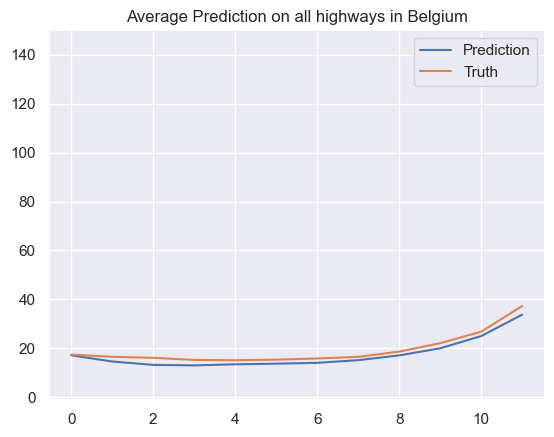

* Time step 223
* Prediction Accuracy (MAE) 3.8855391527900847
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


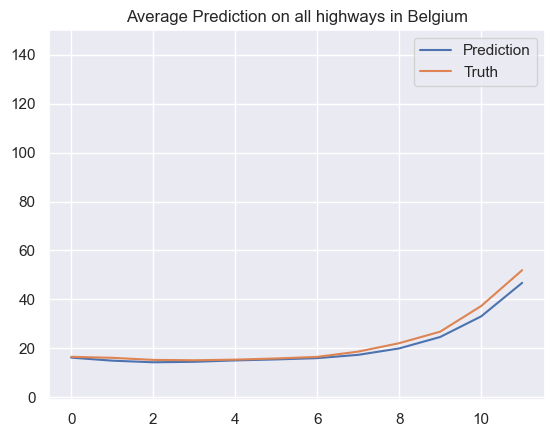

* Time step 224
* Prediction Accuracy (MAE) 4.00729892279668
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


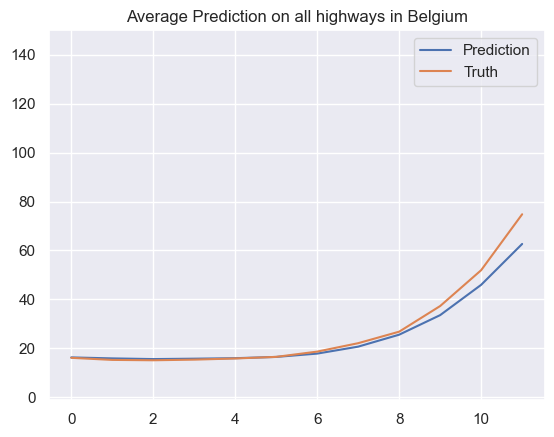

* Time step 225
* Prediction Accuracy (MAE) 4.9374252376314836
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


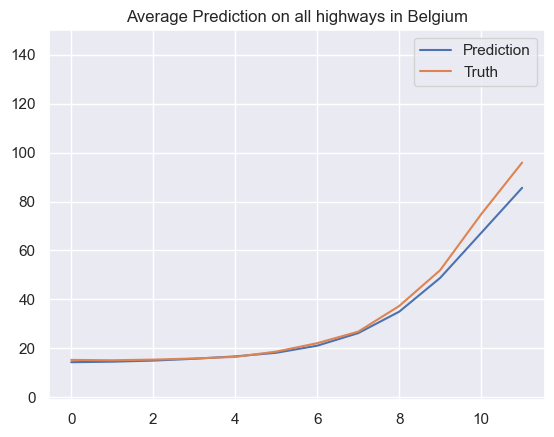

* Time step 226
* Prediction Accuracy (MAE) 5.180122895155921
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


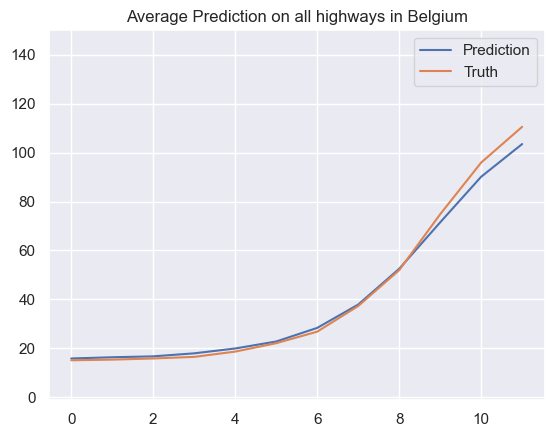

* Time step 227
* Prediction Accuracy (MAE) 5.292747197919285
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


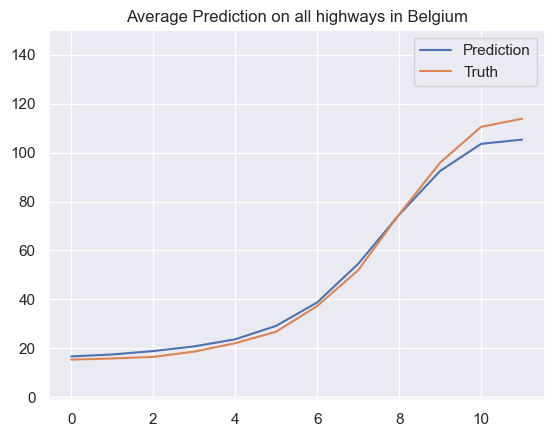

* Time step 228
* Prediction Accuracy (MAE) 6.345061346268363
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


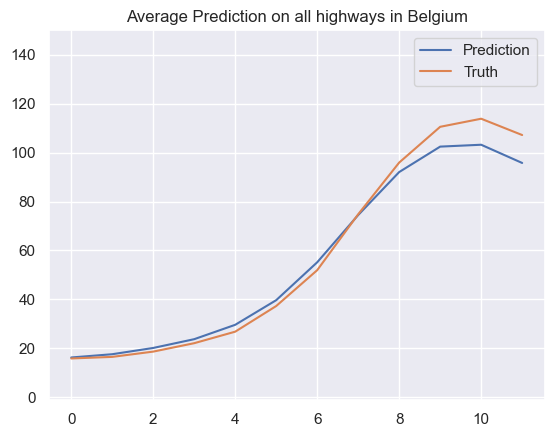

* Time step 229
* Prediction Accuracy (MAE) 7.353485051118918
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


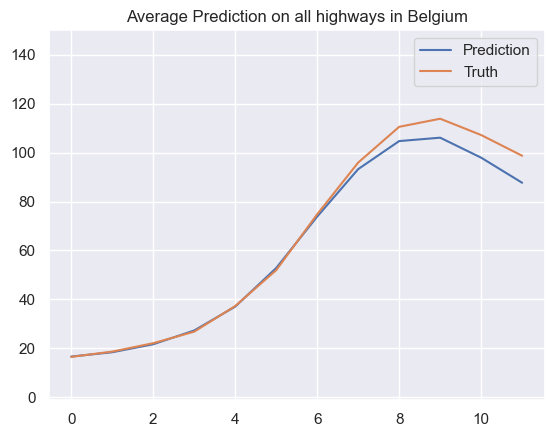

* Time step 230
* Prediction Accuracy (MAE) 7.611742925156638
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


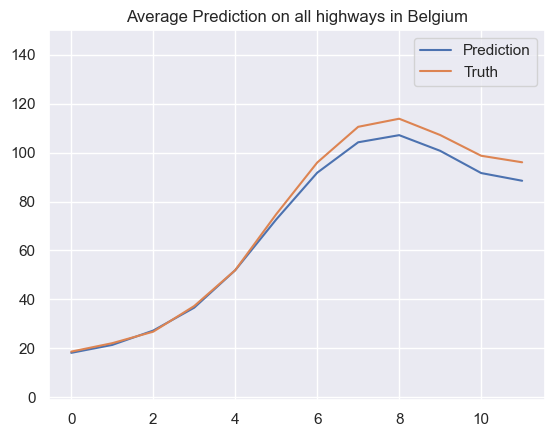

* Time step 231
* Prediction Accuracy (MAE) 8.001790419173455
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


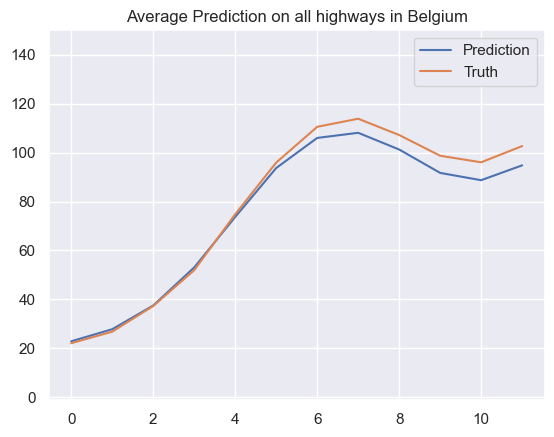

* Time step 232
* Prediction Accuracy (MAE) 8.641577484925373
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


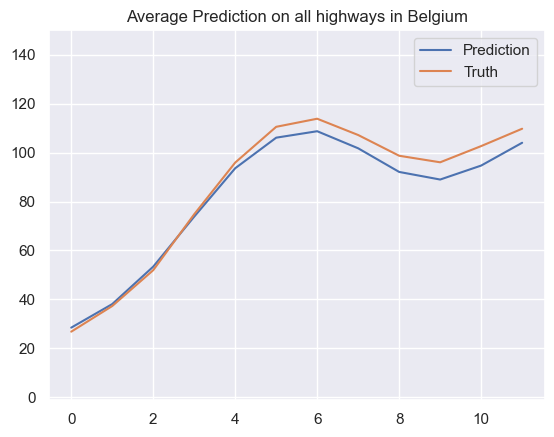

* Time step 233
* Prediction Accuracy (MAE) 9.441060749508313
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


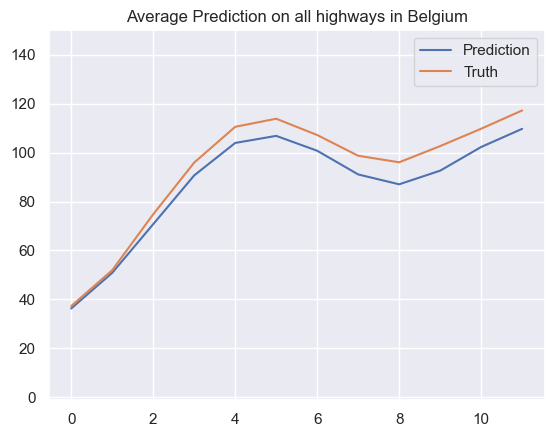

* Time step 234
* Prediction Accuracy (MAE) 10.77493819055874
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


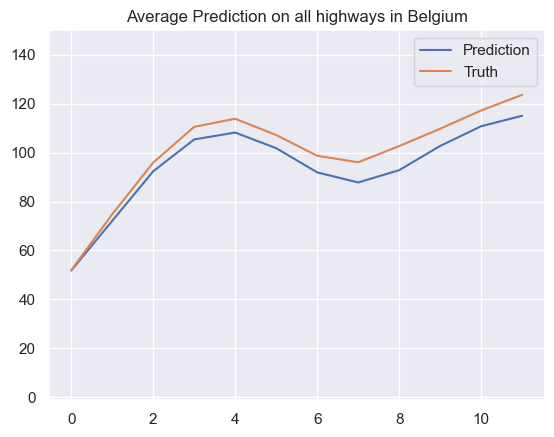

* Time step 235
* Prediction Accuracy (MAE) 11.153207333541246
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


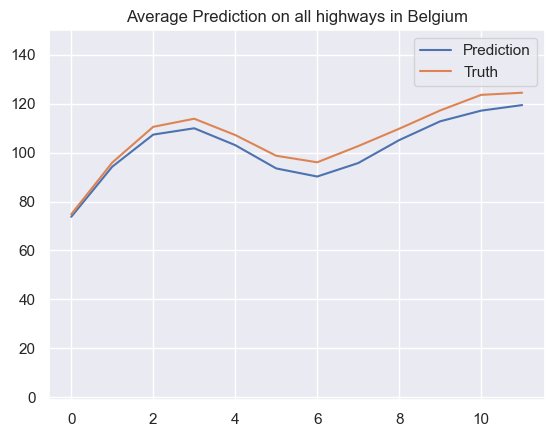

* Time step 236
* Prediction Accuracy (MAE) 11.02817468598683
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


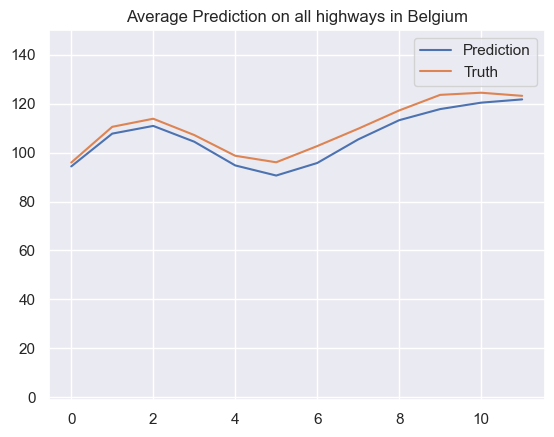

* Time step 237
* Prediction Accuracy (MAE) 11.507237083680694
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


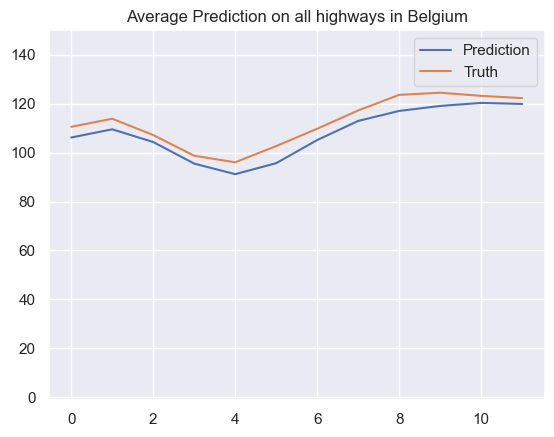

* Time step 238
* Prediction Accuracy (MAE) 11.857173166934604
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


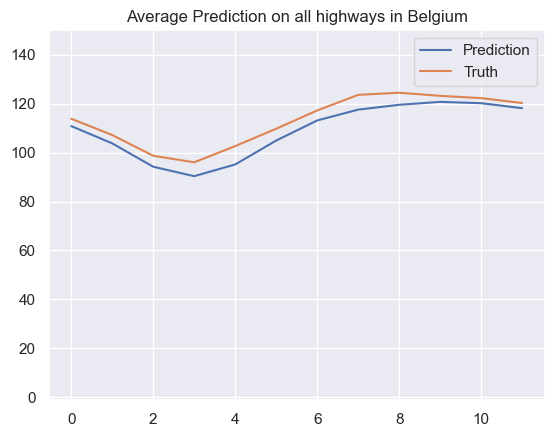

* Time step 239
* Prediction Accuracy (MAE) 12.013310624135983
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


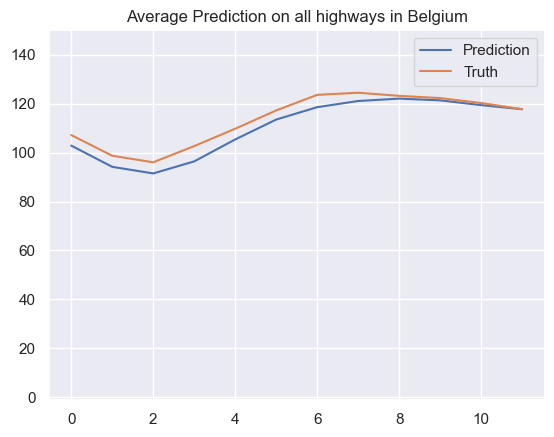

* Time step 240
* Prediction Accuracy (MAE) 11.907000367368175
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


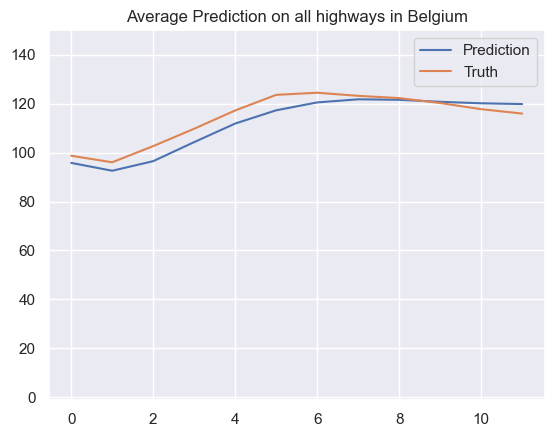

* Time step 241
* Prediction Accuracy (MAE) 12.271489675238952
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


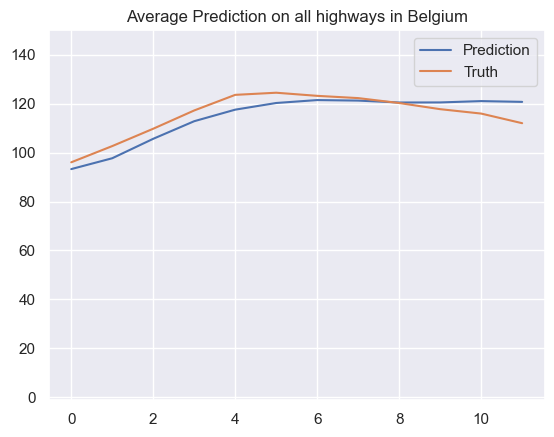

* Time step 242
* Prediction Accuracy (MAE) 12.725327057283312
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


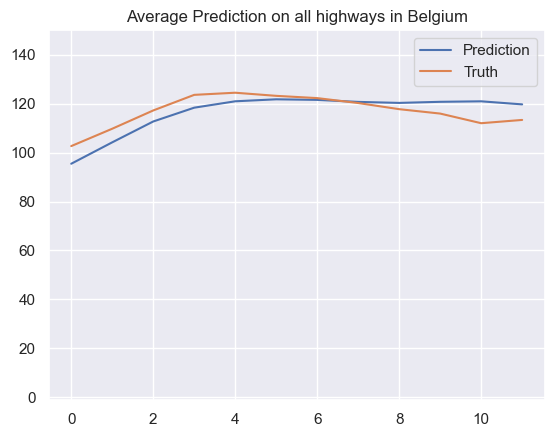

* Time step 243
* Prediction Accuracy (MAE) 13.174766071491145
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


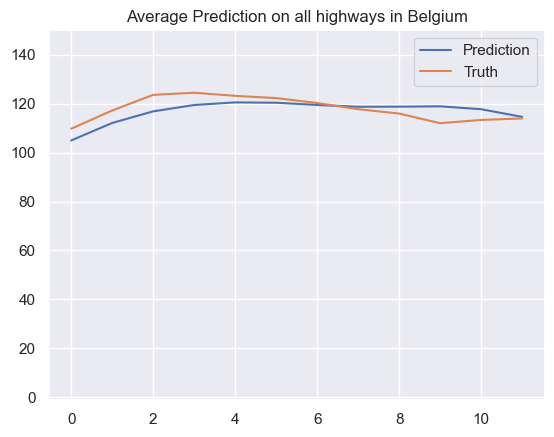

* Time step 244
* Prediction Accuracy (MAE) 13.074556373253893
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


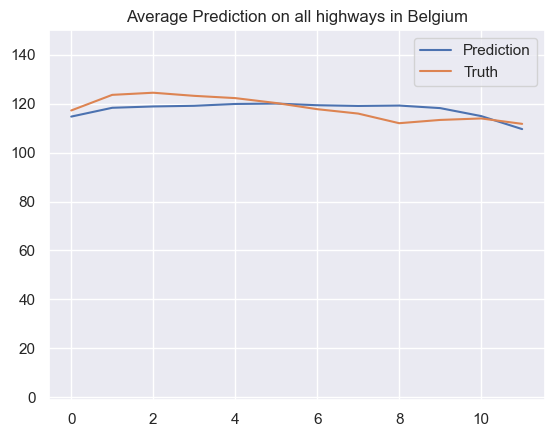

* Time step 245
* Prediction Accuracy (MAE) 12.936381273486099
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


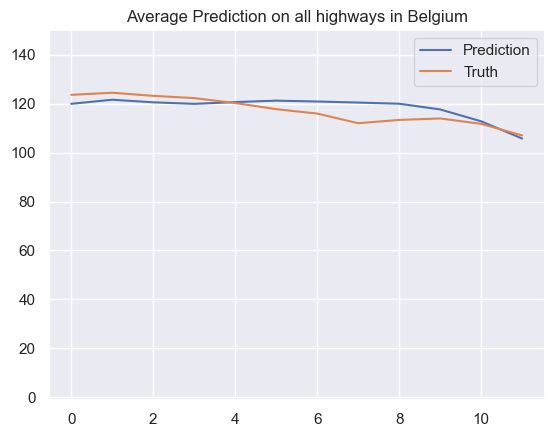

* Time step 246
* Prediction Accuracy (MAE) 12.998340224836367
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.004


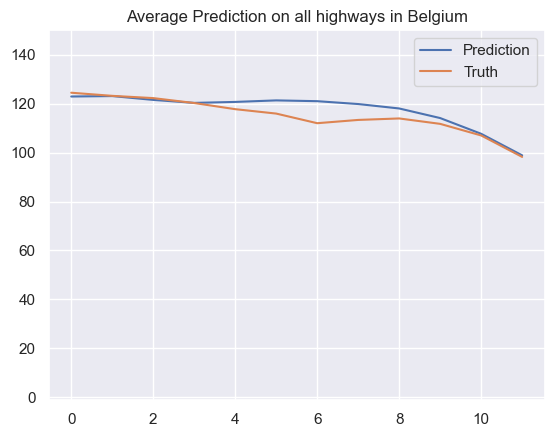

* Time step 247
* Prediction Accuracy (MAE) 12.899394816222534
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


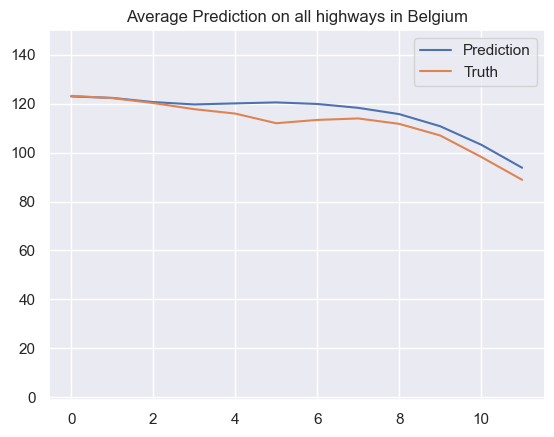

* Time step 248
* Prediction Accuracy (MAE) 13.128844424345164
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


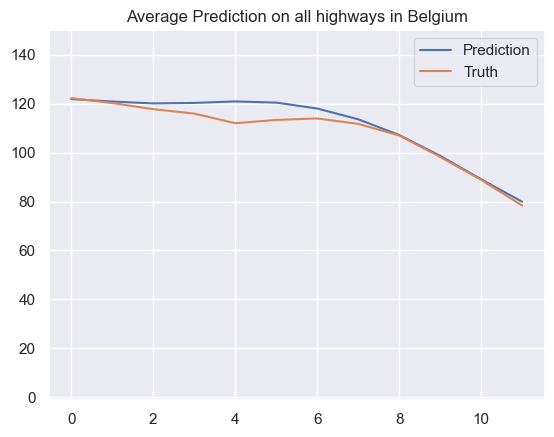

* Time step 249
* Prediction Accuracy (MAE) 12.566657201470251
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


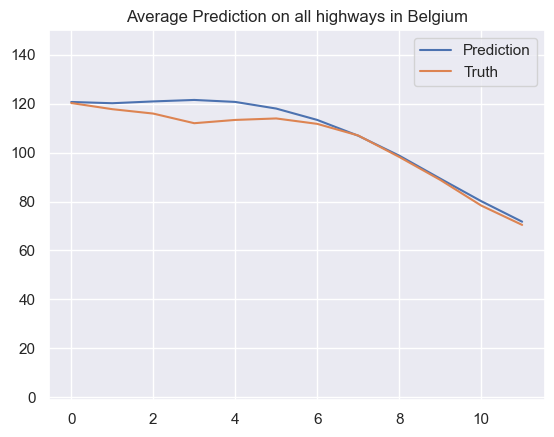

* Time step 250
* Prediction Accuracy (MAE) 12.269744360507936
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


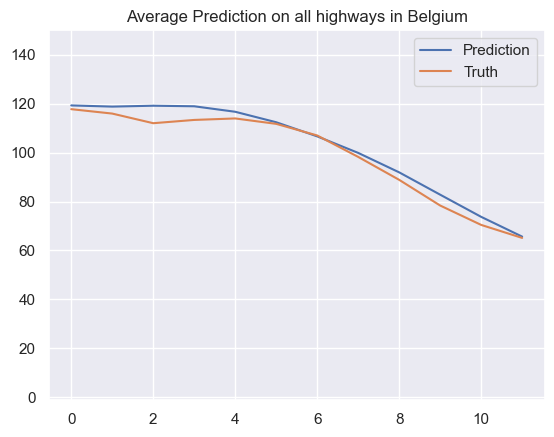

* Time step 251
* Prediction Accuracy (MAE) 12.127915821337933
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


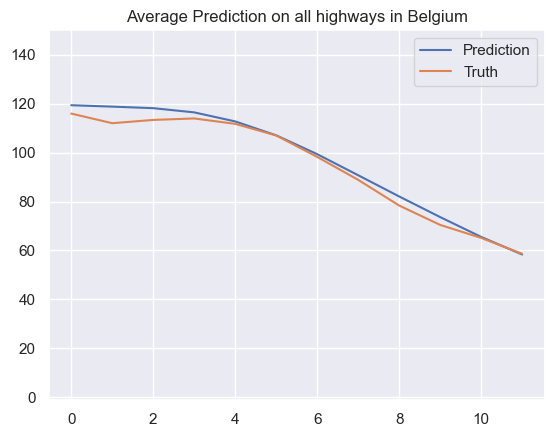

* Time step 252
* Prediction Accuracy (MAE) 11.67414060579189
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


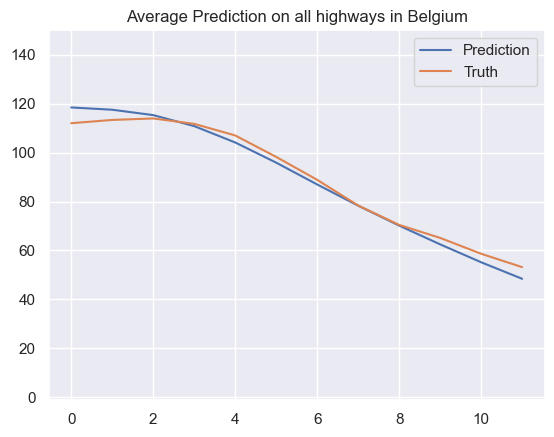

* Time step 253
* Prediction Accuracy (MAE) 11.233207724910951
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


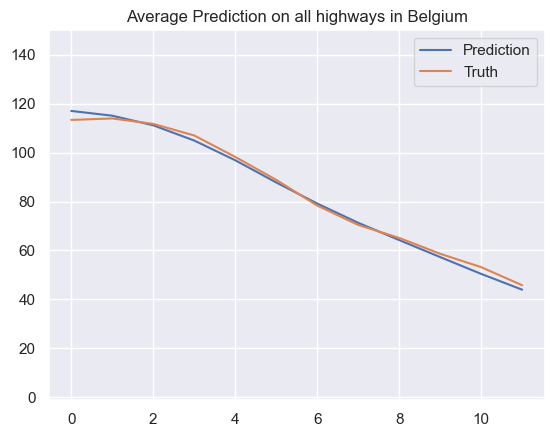

* Time step 254
* Prediction Accuracy (MAE) 10.31875053629794
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


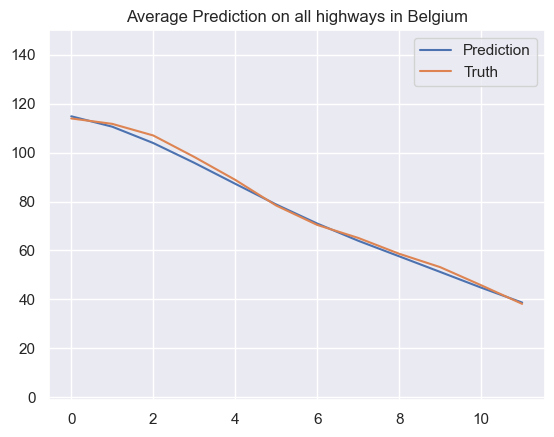

* Time step 255
* Prediction Accuracy (MAE) 9.59920890381169
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


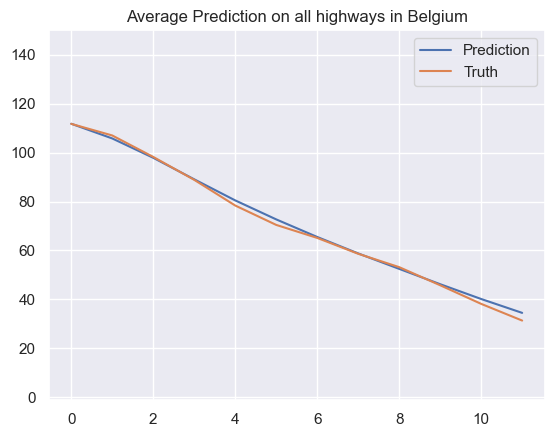

* Time step 256
* Prediction Accuracy (MAE) 9.107279544290932
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


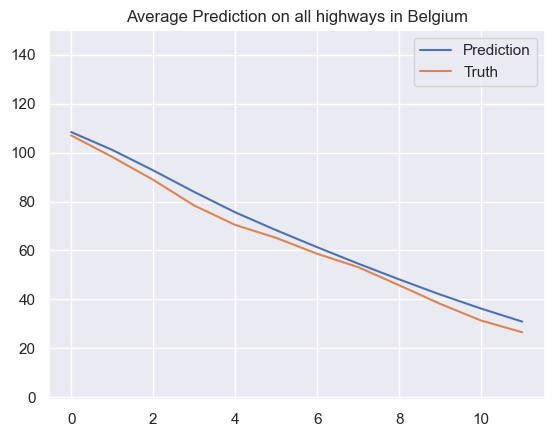

* Time step 257
* Prediction Accuracy (MAE) 9.165025760053142
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


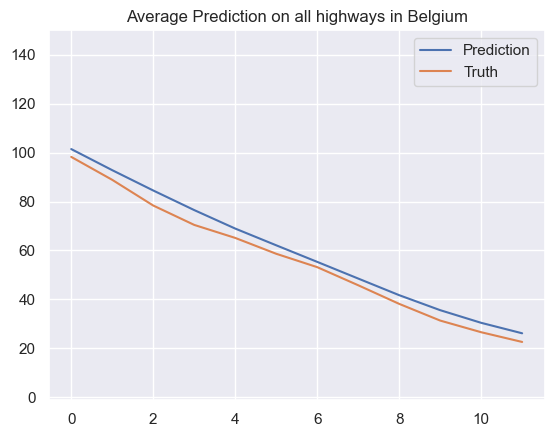

* Time step 258
* Prediction Accuracy (MAE) 8.774353116410085
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


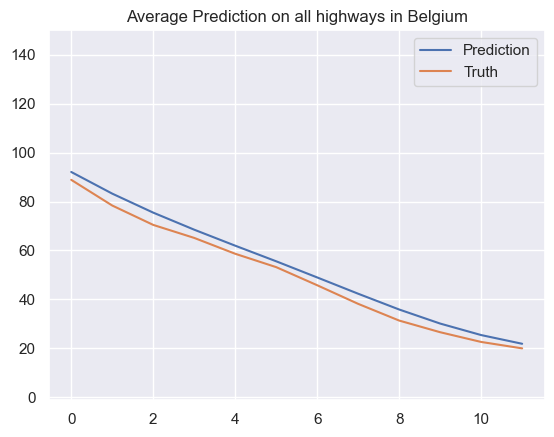

* Time step 259
* Prediction Accuracy (MAE) 7.981193359195232
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


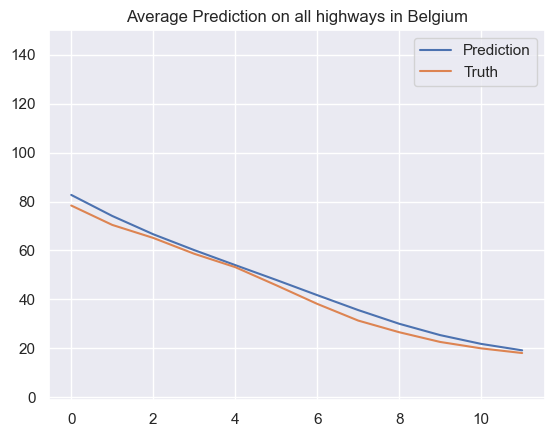

* Time step 260
* Prediction Accuracy (MAE) 7.149823756039463
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


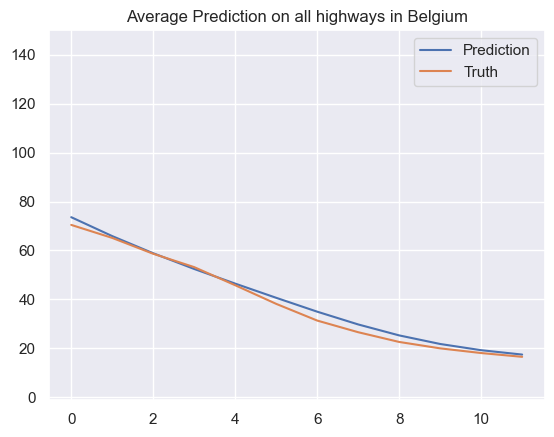

* Time step 261
* Prediction Accuracy (MAE) 6.499306676161826
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


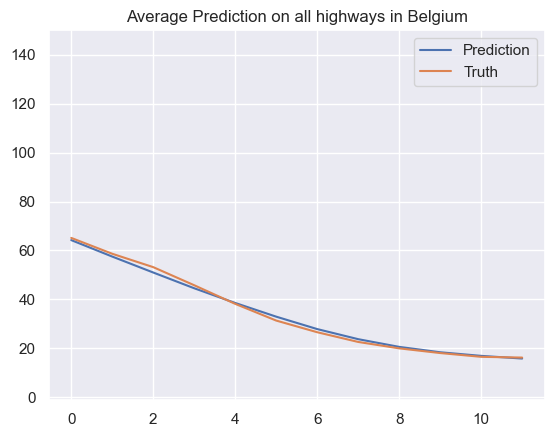

* Time step 262
* Prediction Accuracy (MAE) 5.588192904474651
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


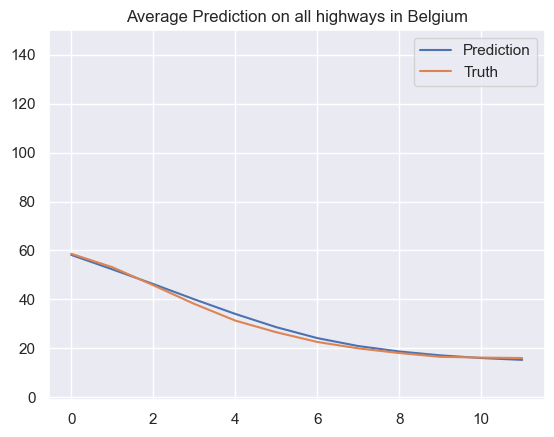

* Time step 263
* Prediction Accuracy (MAE) 5.169349282697342
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


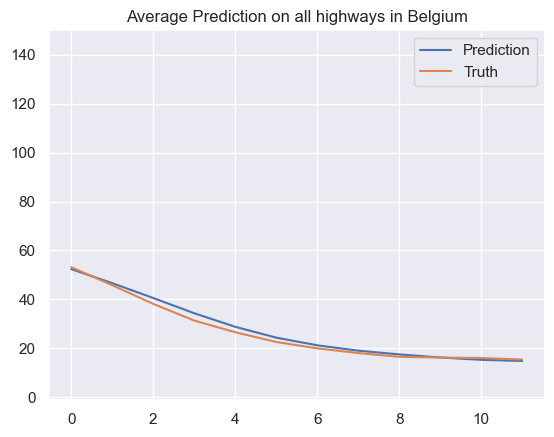

* Time step 264
* Prediction Accuracy (MAE) 4.735786295060973
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


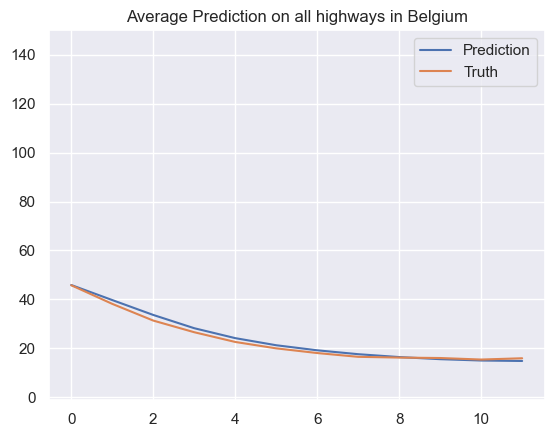

* Time step 265
* Prediction Accuracy (MAE) 4.290747525435773
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


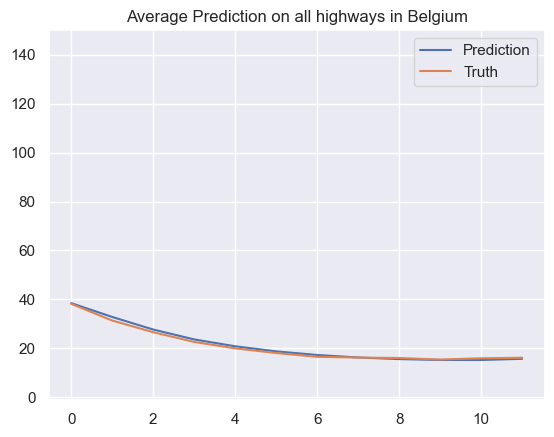

* Time step 266
* Prediction Accuracy (MAE) 3.848670756043748
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


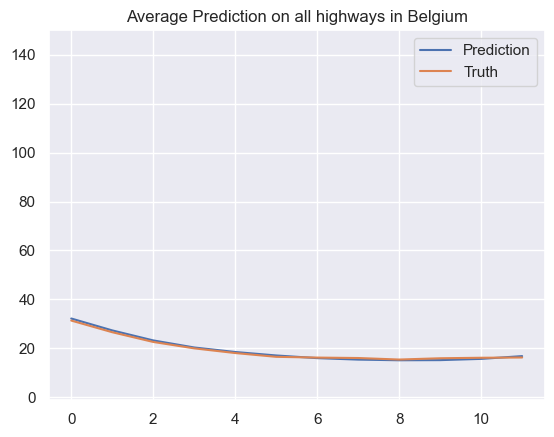

* Time step 267
* Prediction Accuracy (MAE) 3.5721324650392643
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


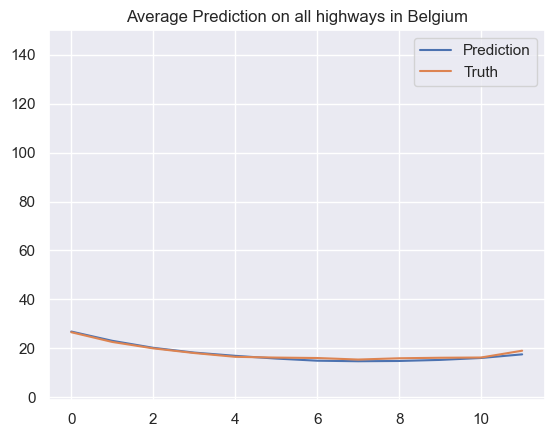

* Time step 268
* Prediction Accuracy (MAE) 3.490742258814676
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


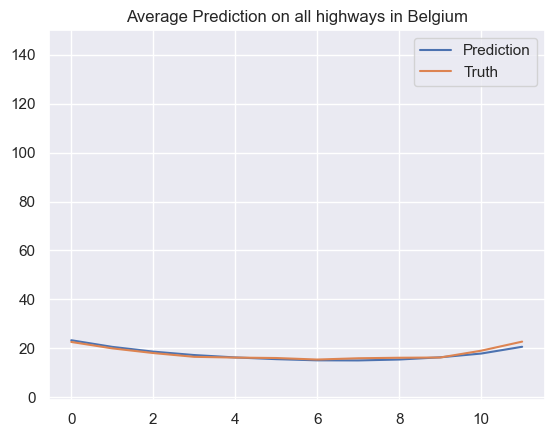

* Time step 269
* Prediction Accuracy (MAE) 3.4634000933380737
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


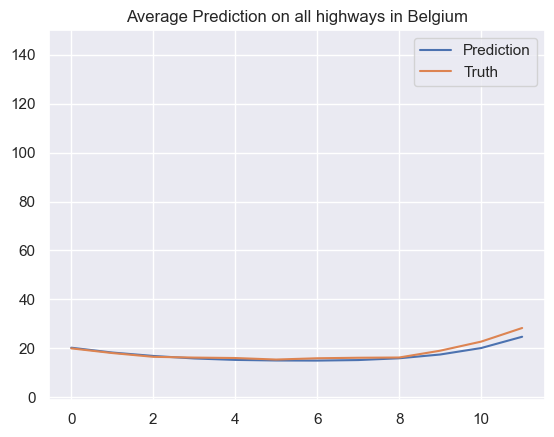

* Time step 270
* Prediction Accuracy (MAE) 3.581286415843691
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.038, Accuracy RMSE: 0.003


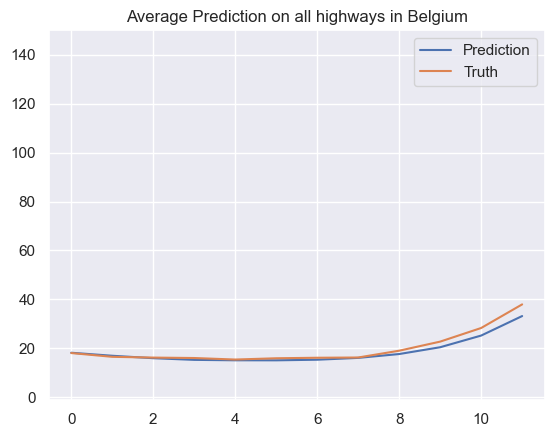

* Time step 271
* Prediction Accuracy (MAE) 3.7637364339086448
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


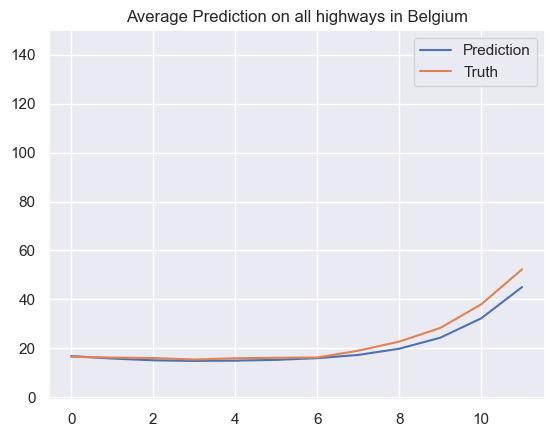

* Time step 272
* Prediction Accuracy (MAE) 4.292845442017262
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


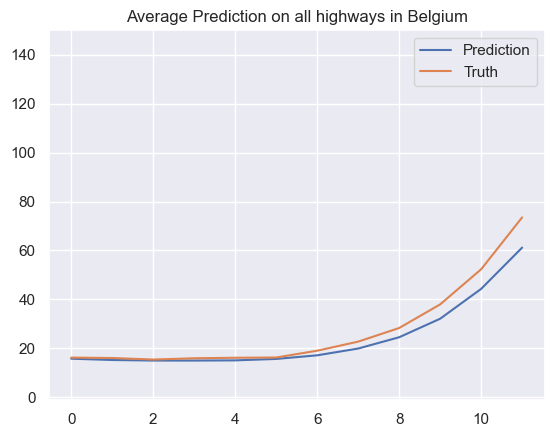

* Time step 273
* Prediction Accuracy (MAE) 5.159184768499226
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


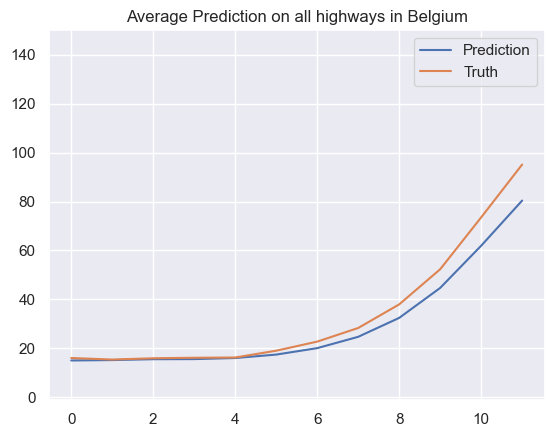

* Time step 274
* Prediction Accuracy (MAE) 6.142567449295299
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


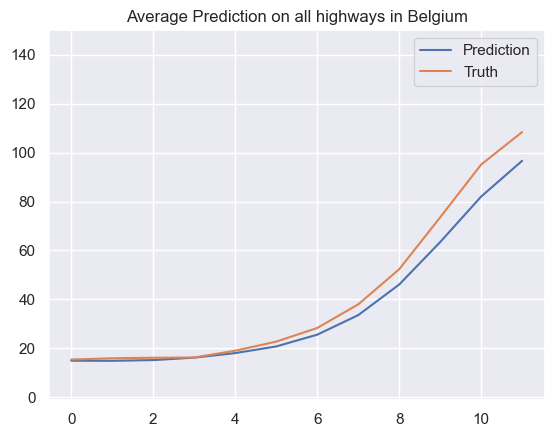

* Time step 275
* Prediction Accuracy (MAE) 6.665125227991673
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


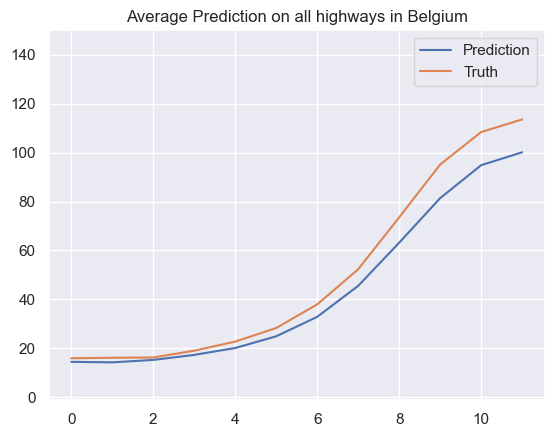

* Time step 276
* Prediction Accuracy (MAE) 7.975527619553385
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


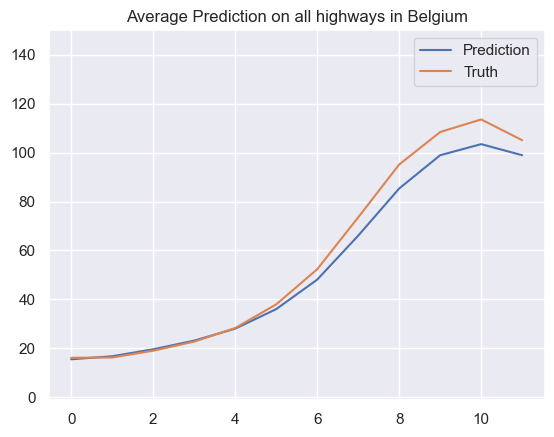

* Time step 277
* Prediction Accuracy (MAE) 7.488949038708457
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


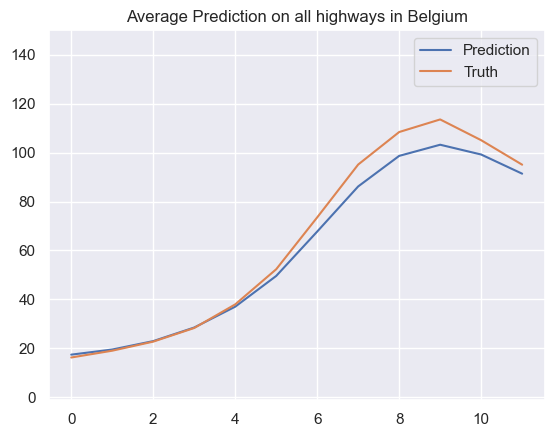

* Time step 278
* Prediction Accuracy (MAE) 7.919520759171416
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


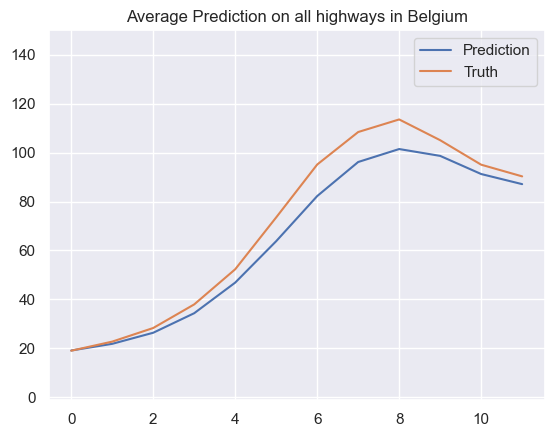

* Time step 279
* Prediction Accuracy (MAE) 9.676058937452636
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


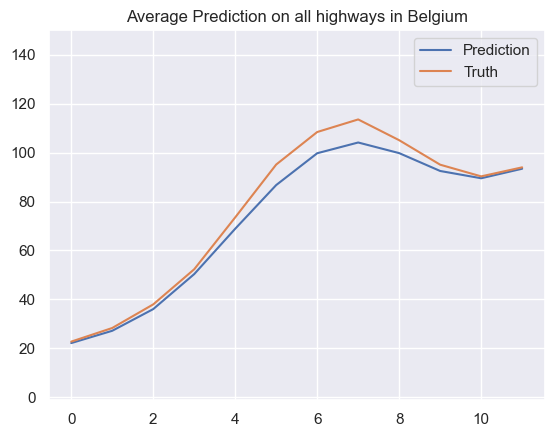

* Time step 280
* Prediction Accuracy (MAE) 9.40944815941698
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


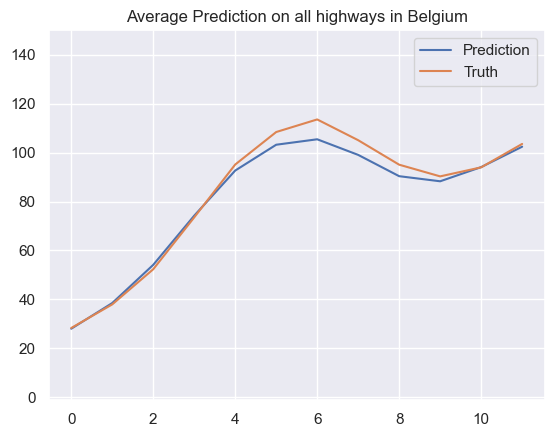

* Time step 281
* Prediction Accuracy (MAE) 9.571365754424738
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


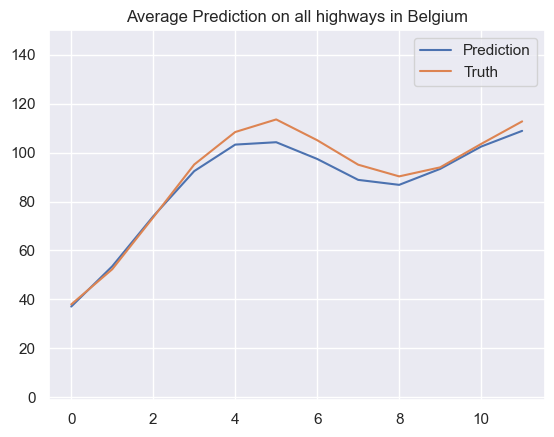

* Time step 282
* Prediction Accuracy (MAE) 10.493763613697544
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


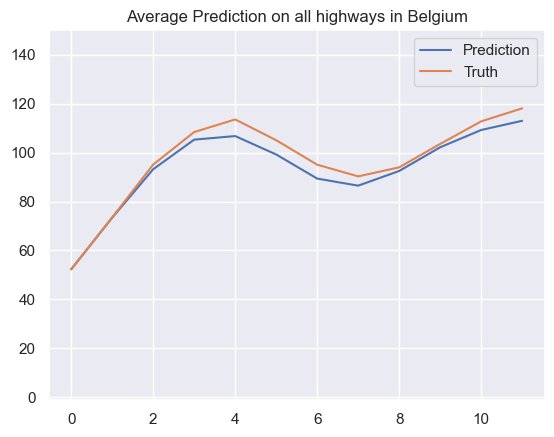

* Time step 283
* Prediction Accuracy (MAE) 10.668077712421656
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


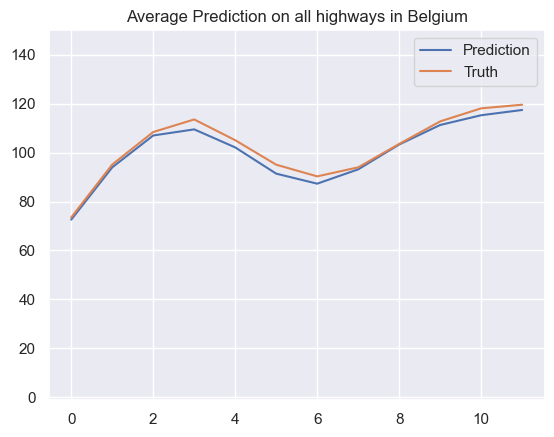

* Time step 284
* Prediction Accuracy (MAE) 10.794158534083687
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


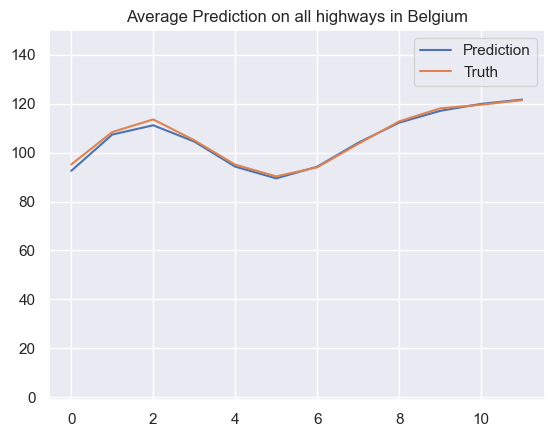

* Time step 285
* Prediction Accuracy (MAE) 11.002536739856314
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


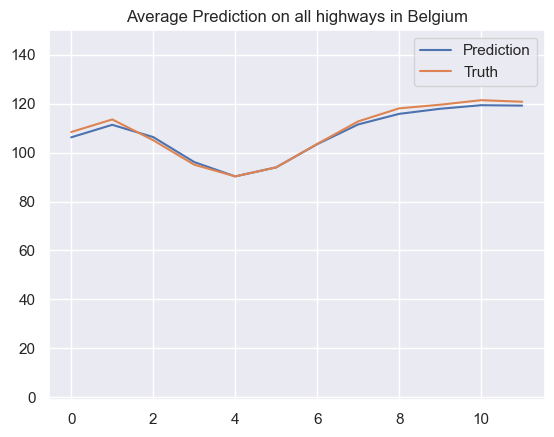

* Time step 286
* Prediction Accuracy (MAE) 11.154709572387583
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


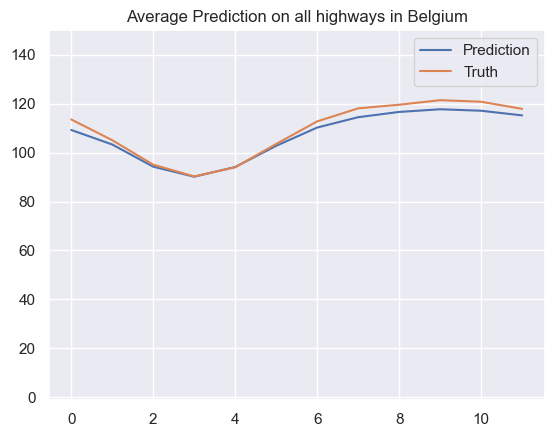

* Time step 287
* Prediction Accuracy (MAE) 11.356540605650034
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


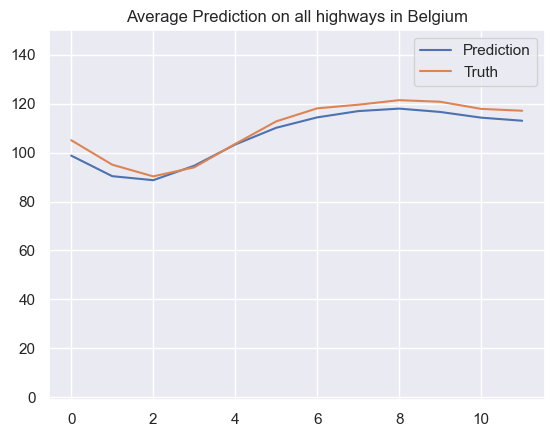

* Time step 288
* Prediction Accuracy (MAE) 11.660110864009281
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


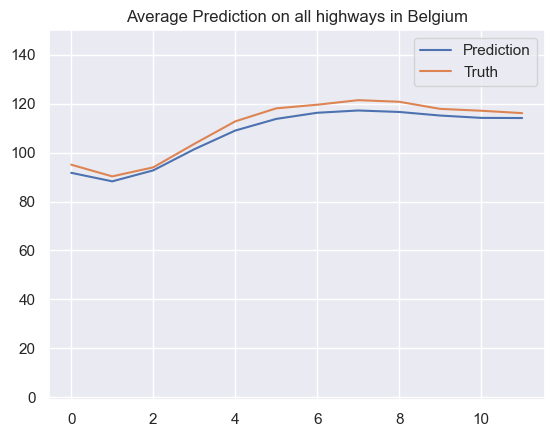

* Time step 289
* Prediction Accuracy (MAE) 11.596064028328659
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


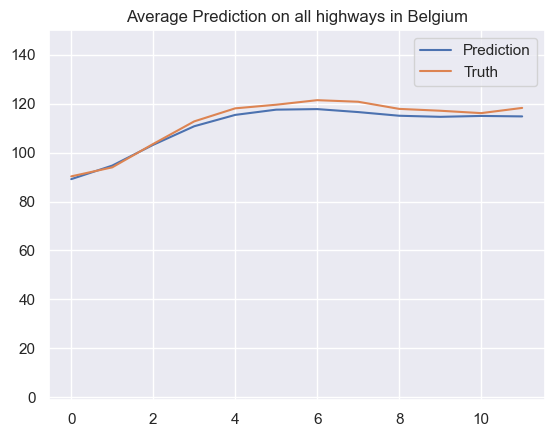

* Time step 290
* Prediction Accuracy (MAE) 11.556761821617117
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


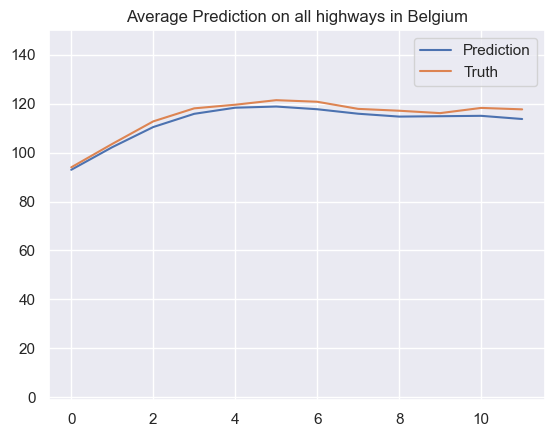

* Time step 291
* Prediction Accuracy (MAE) 11.44052054672087
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


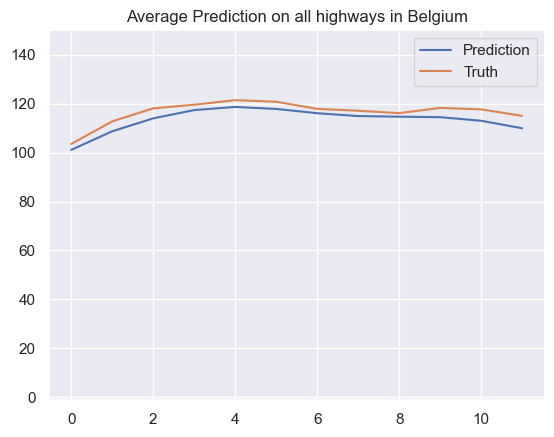

* Time step 292
* Prediction Accuracy (MAE) 11.398956975009472
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


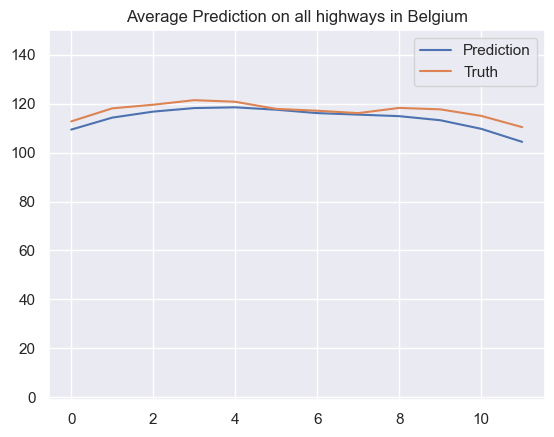

* Time step 293
* Prediction Accuracy (MAE) 11.209799748599671
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


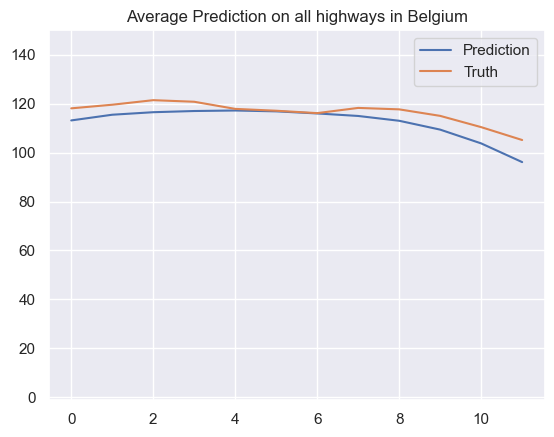

* Time step 294
* Prediction Accuracy (MAE) 11.344269569762304
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


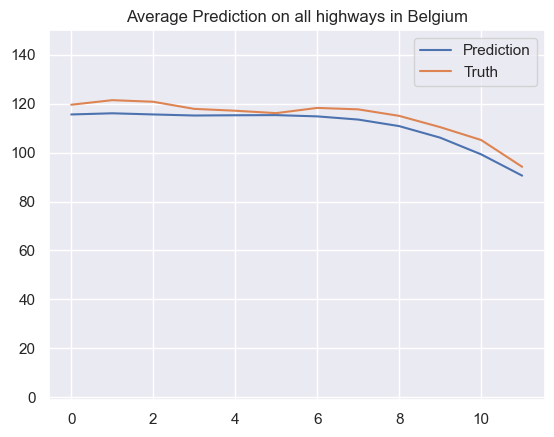

* Time step 295
* Prediction Accuracy (MAE) 10.784652088927182
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


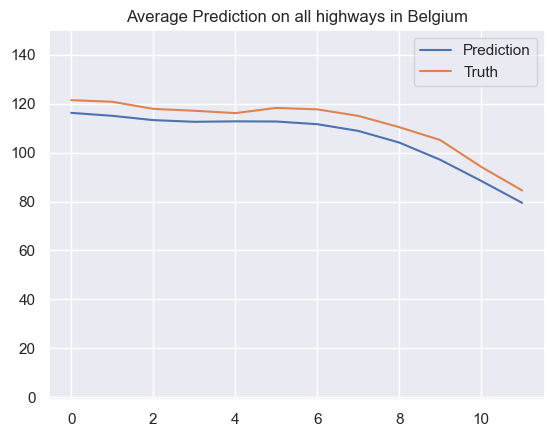

* Time step 296
* Prediction Accuracy (MAE) 11.017526334254926
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


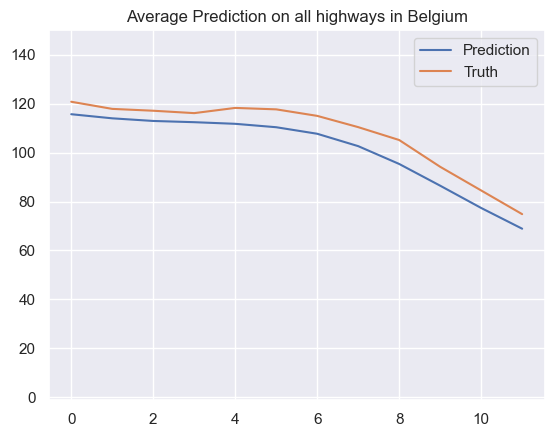

* Time step 297
* Prediction Accuracy (MAE) 11.373136831816003
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


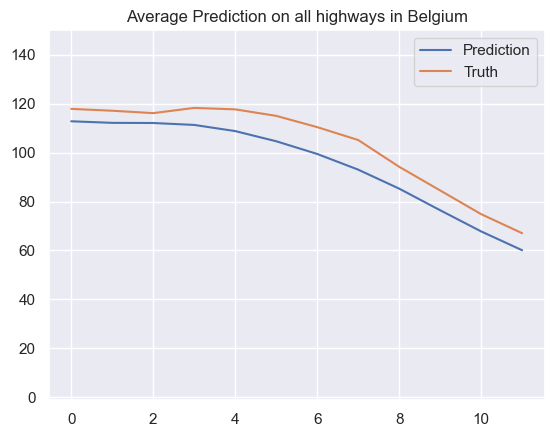

* Time step 298
* Prediction Accuracy (MAE) 11.945731254926768
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


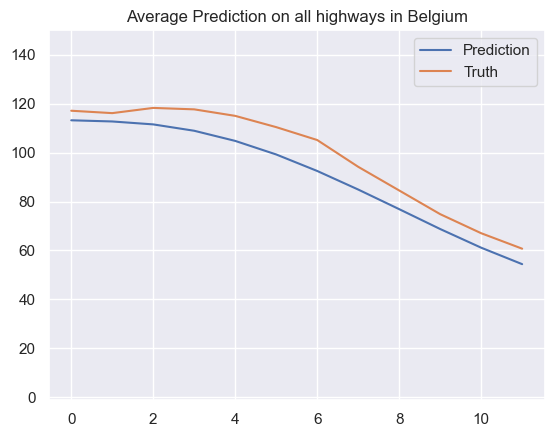

* Time step 299
* Prediction Accuracy (MAE) 11.701584680009969
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


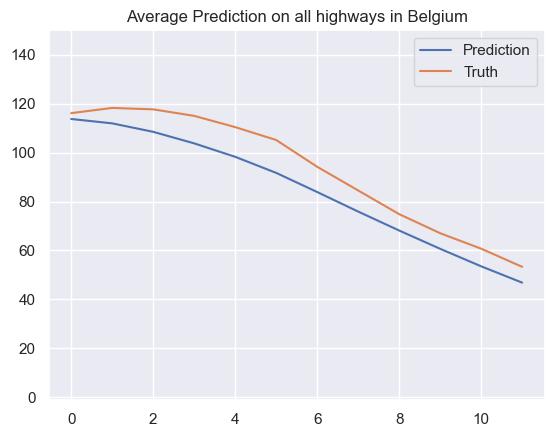

* Time step 300
* Prediction Accuracy (MAE) 11.877366149418345
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


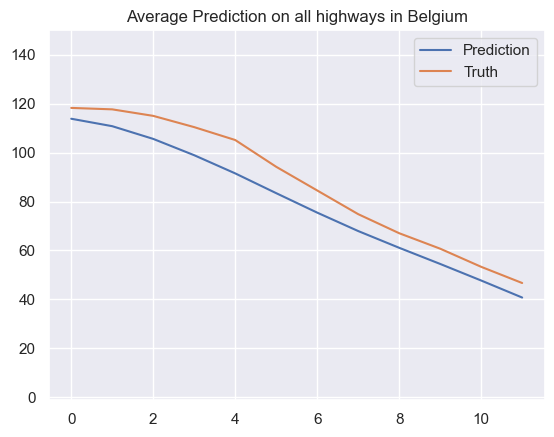

* Time step 301
* Prediction Accuracy (MAE) 11.628430861928818
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


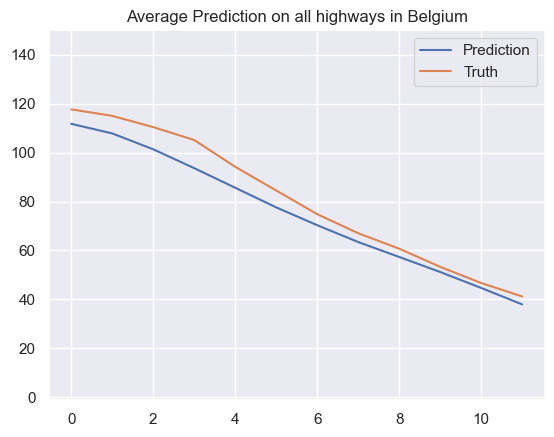

* Time step 302
* Prediction Accuracy (MAE) 10.05625718134465
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


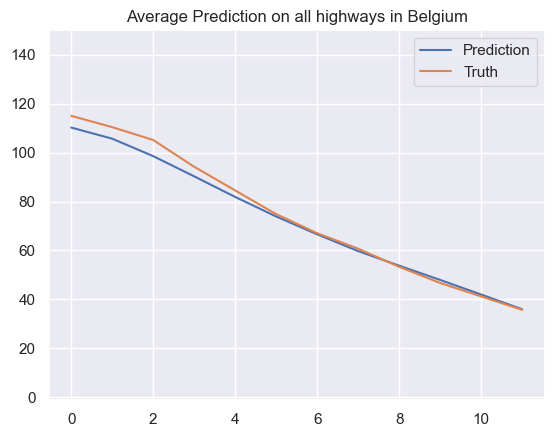

* Time step 303
* Prediction Accuracy (MAE) 8.59404983468338
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


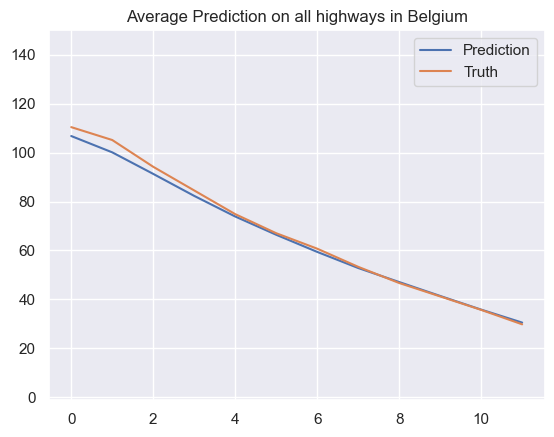

* Time step 304
* Prediction Accuracy (MAE) 7.960084839467904
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


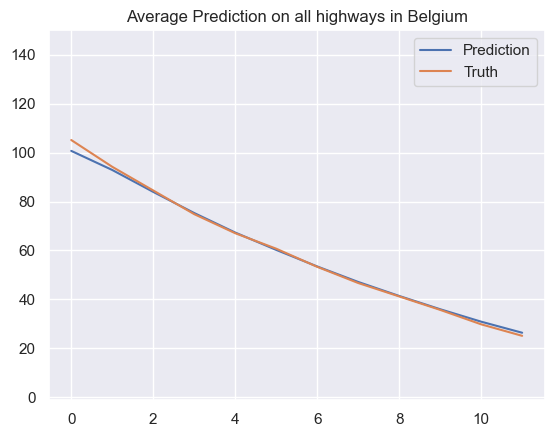

* Time step 305
* Prediction Accuracy (MAE) 7.549170425122626
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


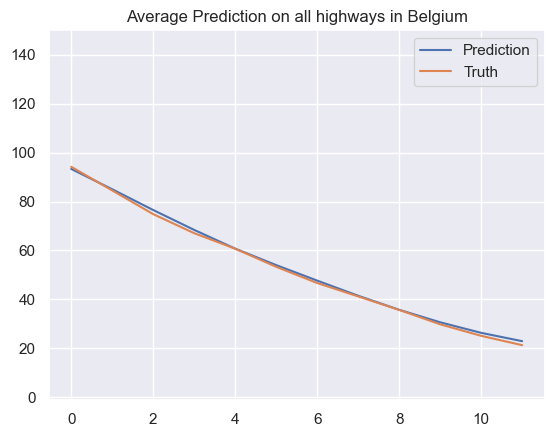

* Time step 306
* Prediction Accuracy (MAE) 7.16076273539257
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


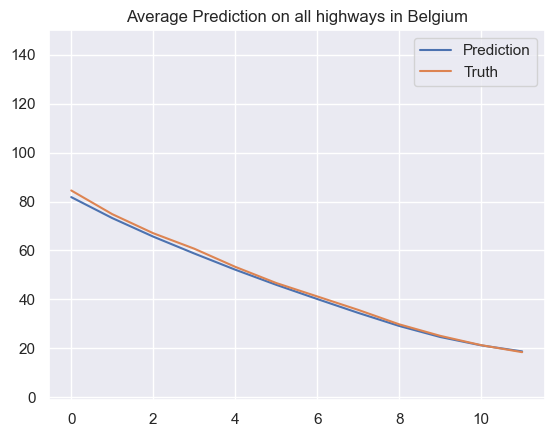

* Time step 307
* Prediction Accuracy (MAE) 6.46662870520261
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


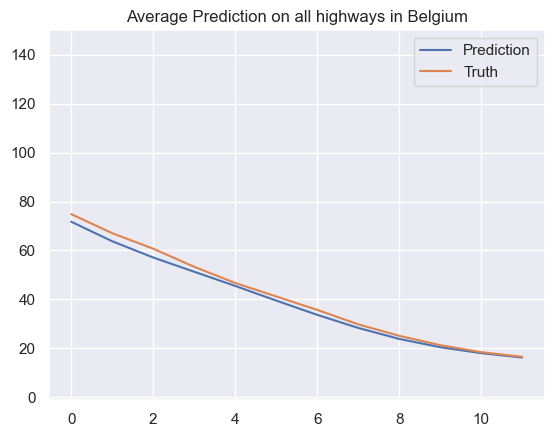

* Time step 308
* Prediction Accuracy (MAE) 6.169221547318604
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


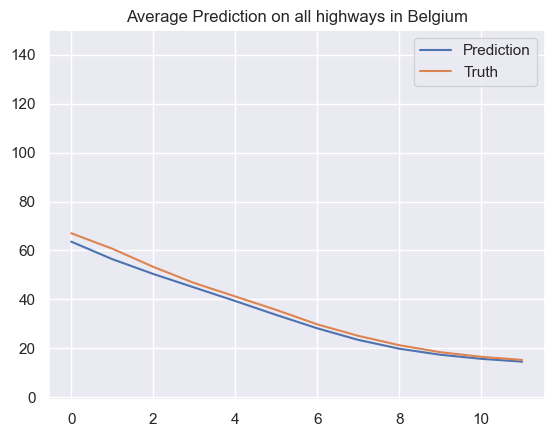

* Time step 309
* Prediction Accuracy (MAE) 5.744287126485966
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


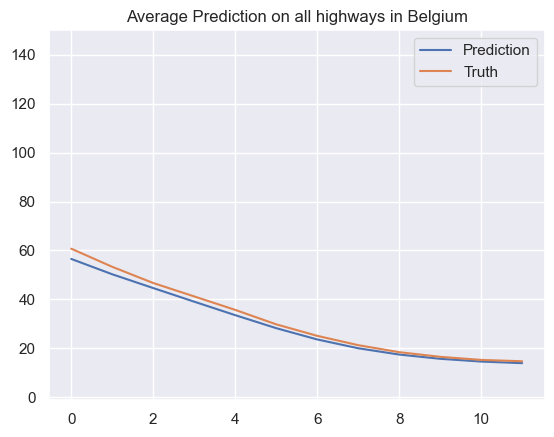

* Time step 310
* Prediction Accuracy (MAE) 5.283041758483196
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


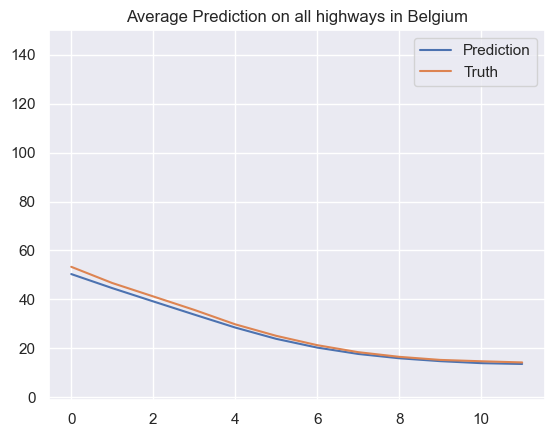

* Time step 311
* Prediction Accuracy (MAE) 4.811664981466893
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


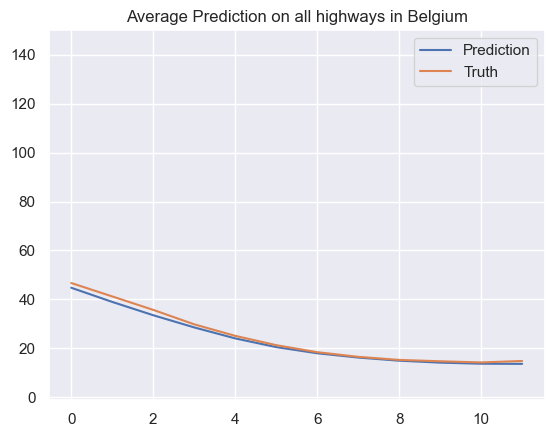

* Time step 312
* Prediction Accuracy (MAE) 4.4184333880538045
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


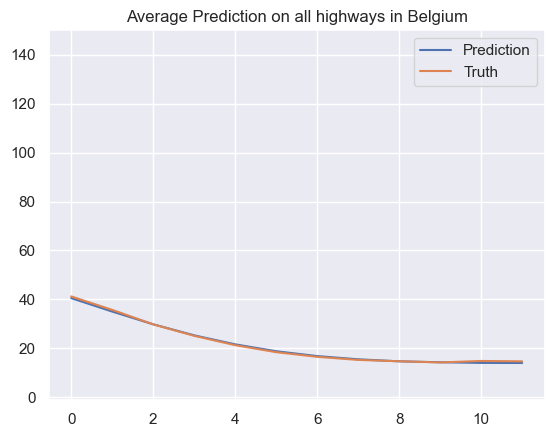

* Time step 313
* Prediction Accuracy (MAE) 4.024864291492733
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


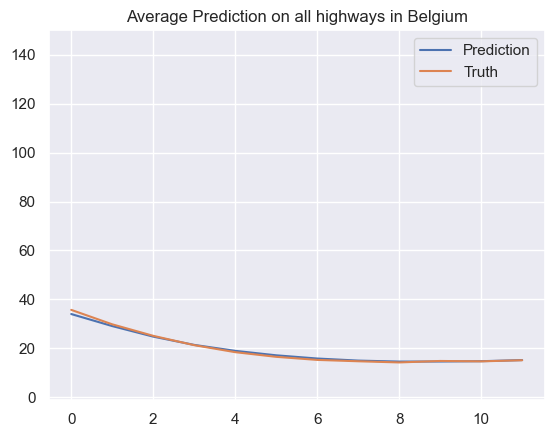

* Time step 314
* Prediction Accuracy (MAE) 3.7875933269001005
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


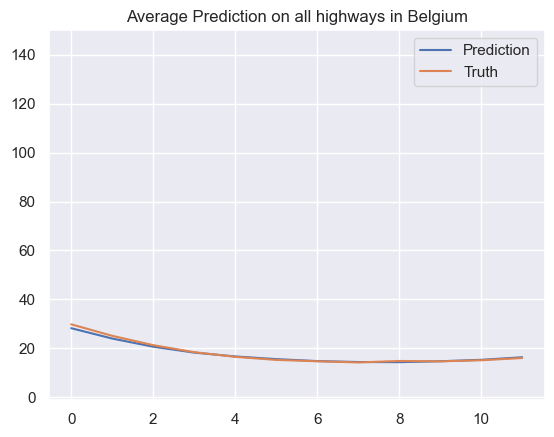

* Time step 315
* Prediction Accuracy (MAE) 3.5565130502481885
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


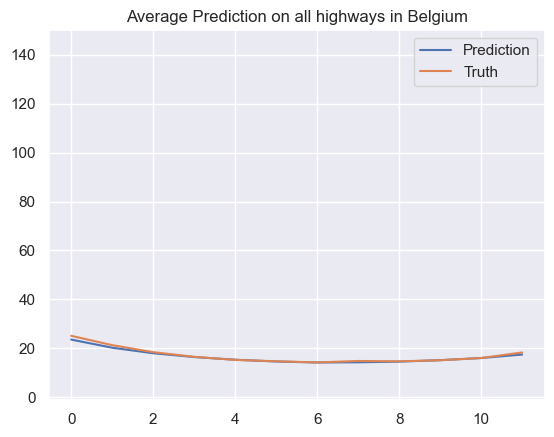

* Time step 316
* Prediction Accuracy (MAE) 3.4469929845336544
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


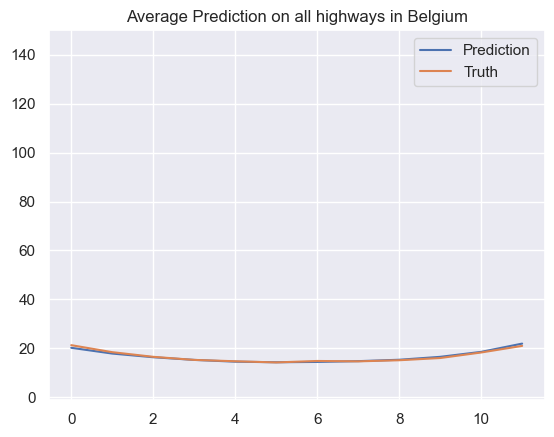

* Time step 317
* Prediction Accuracy (MAE) 3.430013143833914
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


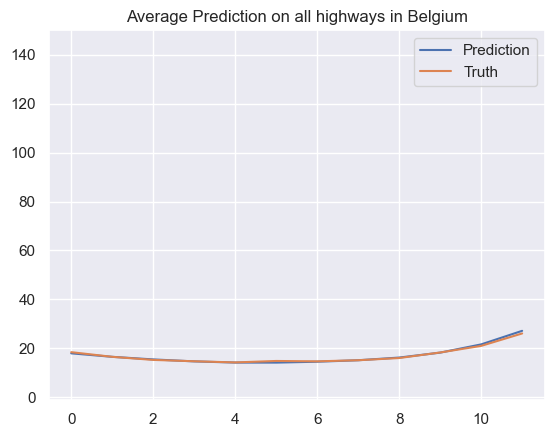

* Time step 318
* Prediction Accuracy (MAE) 3.460575389095416
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


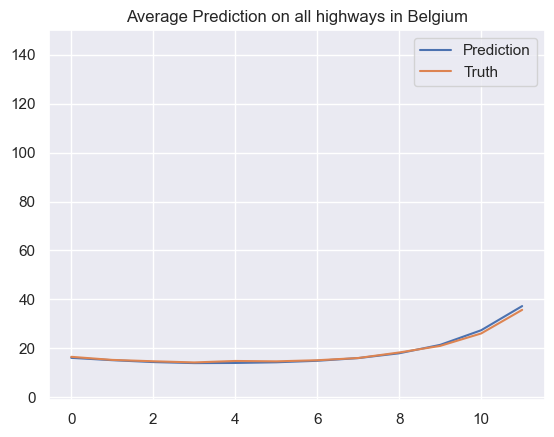

* Time step 319
* Prediction Accuracy (MAE) 3.6198675503881623
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


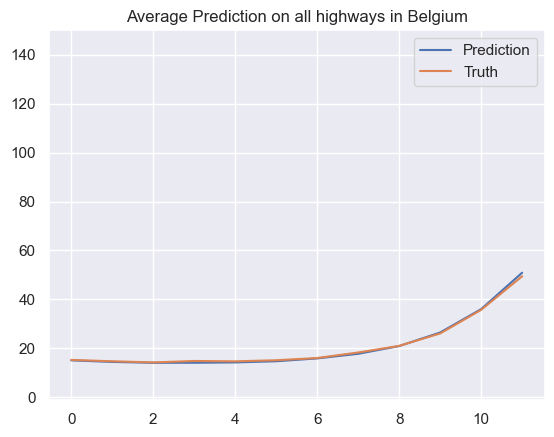

* Time step 320
* Prediction Accuracy (MAE) 3.8196711781443677
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


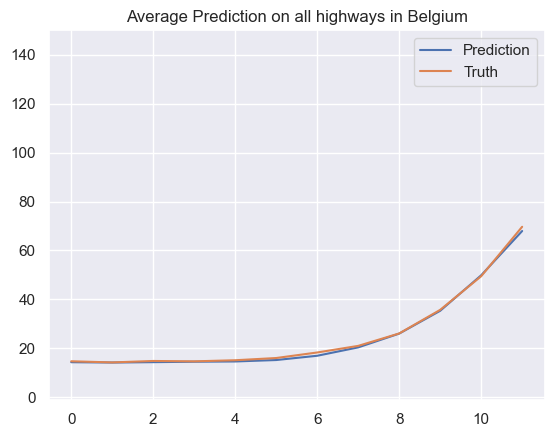

* Time step 321
* Prediction Accuracy (MAE) 4.218517239281558
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


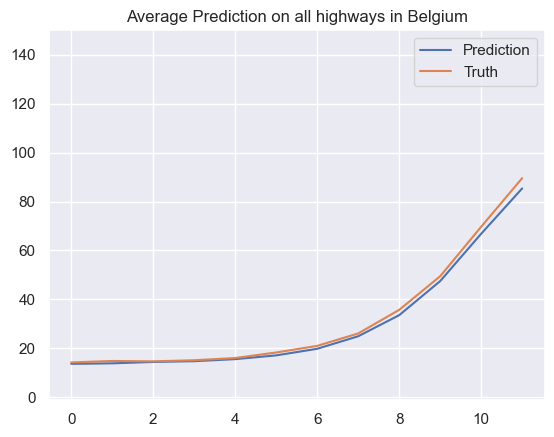

* Time step 322
* Prediction Accuracy (MAE) 4.764297923286131
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


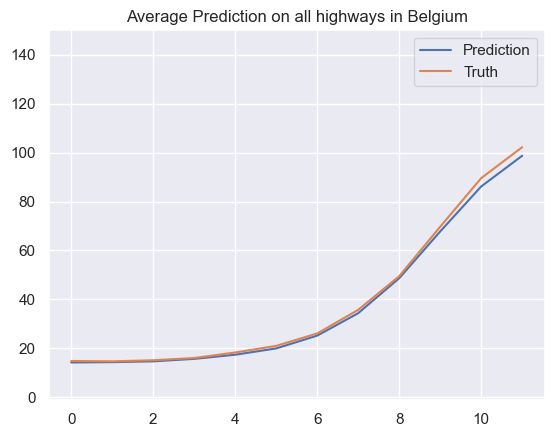

* Time step 323
* Prediction Accuracy (MAE) 5.185467658142386
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


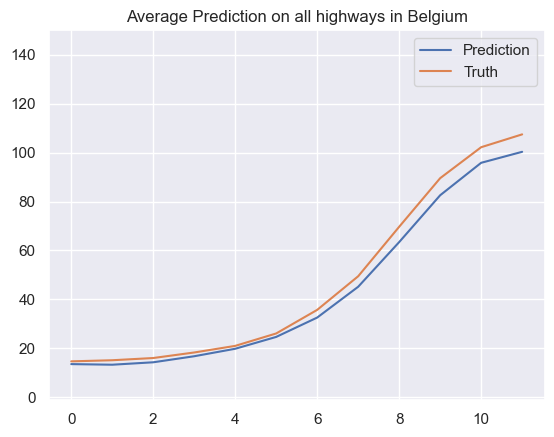

* Time step 324
* Prediction Accuracy (MAE) 6.318404534511818
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


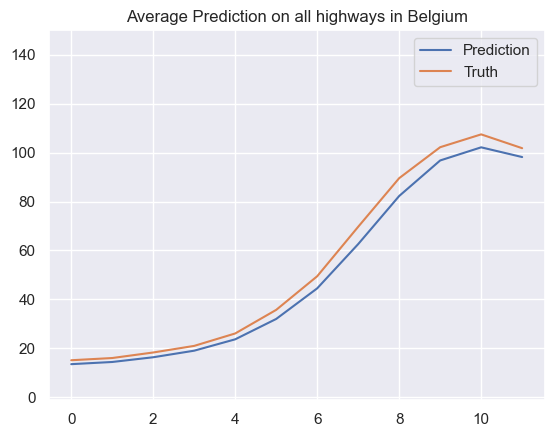

* Time step 325
* Prediction Accuracy (MAE) 6.9213800848967555
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


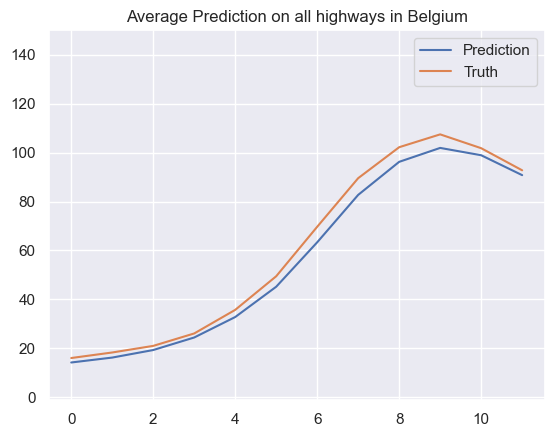

* Time step 326
* Prediction Accuracy (MAE) 7.2330221570985
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


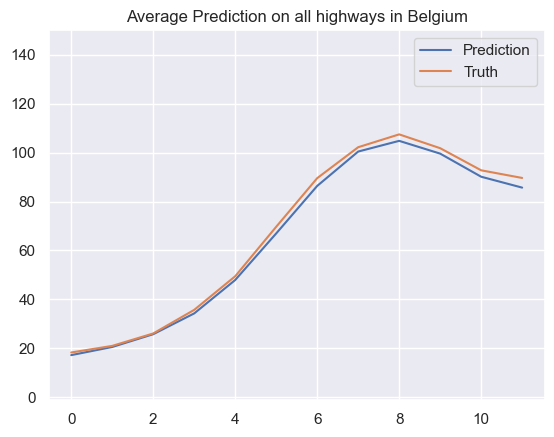

* Time step 327
* Prediction Accuracy (MAE) 7.241253442252652
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


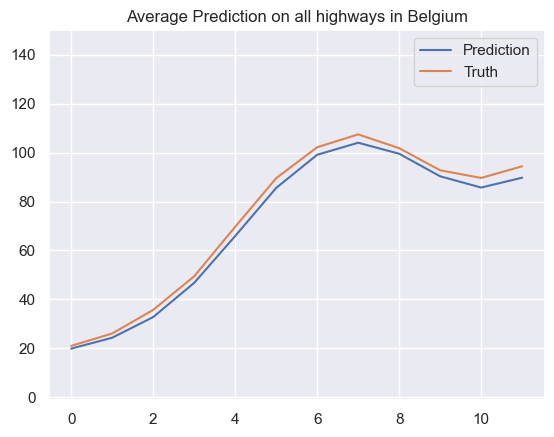

* Time step 328
* Prediction Accuracy (MAE) 8.016742490025043
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


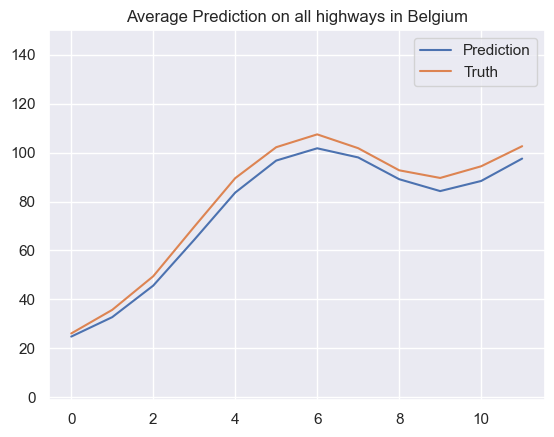

* Time step 329
* Prediction Accuracy (MAE) 8.997173231701428
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


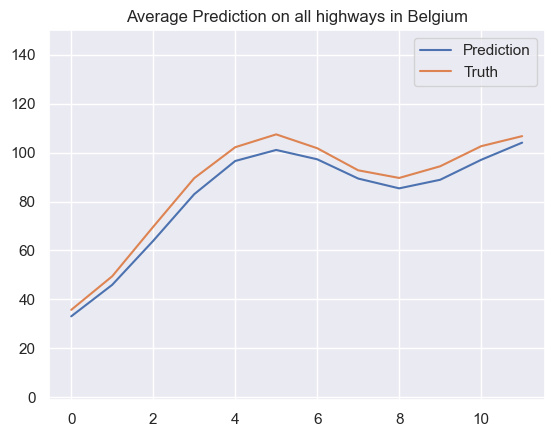

* Time step 330
* Prediction Accuracy (MAE) 9.571206267521527
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


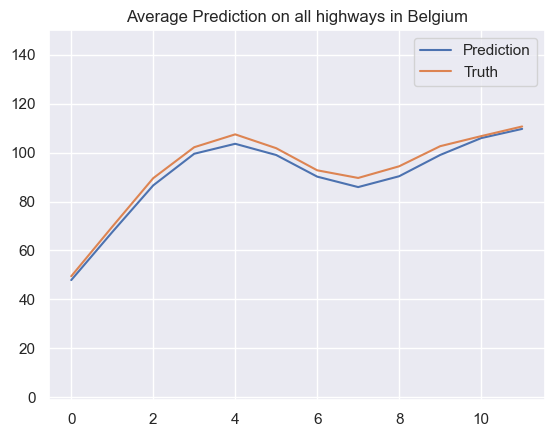

* Time step 331
* Prediction Accuracy (MAE) 9.312517281257234
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


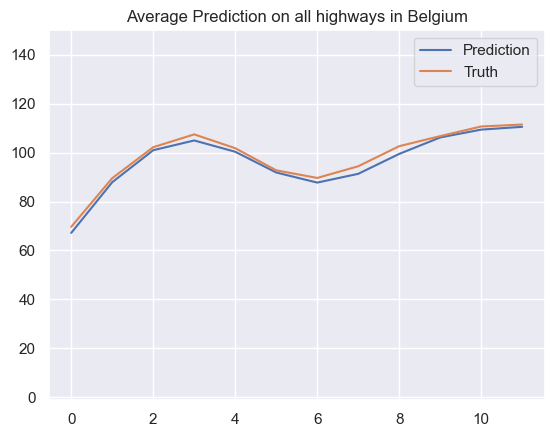

* Time step 332
* Prediction Accuracy (MAE) 9.562137007914503
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


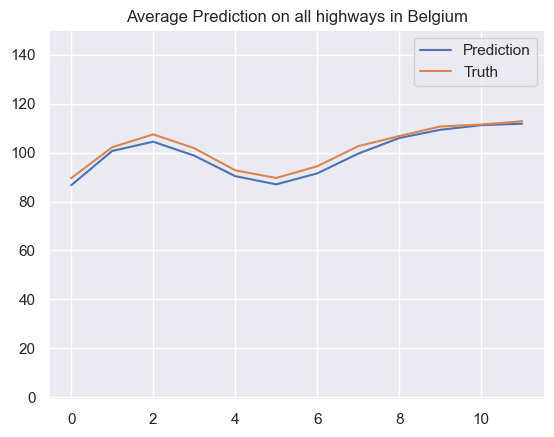

* Time step 333
* Prediction Accuracy (MAE) 9.752592019120488
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


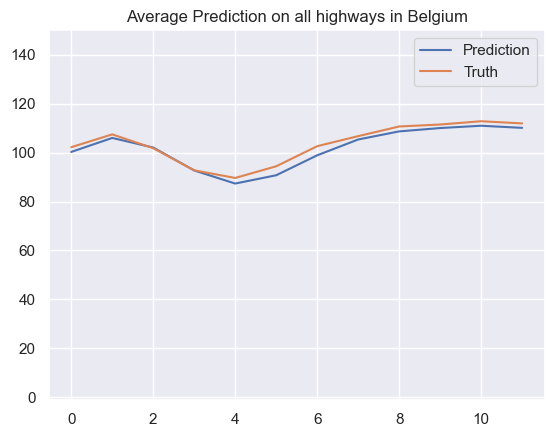

* Time step 334
* Prediction Accuracy (MAE) 9.695031045043716
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


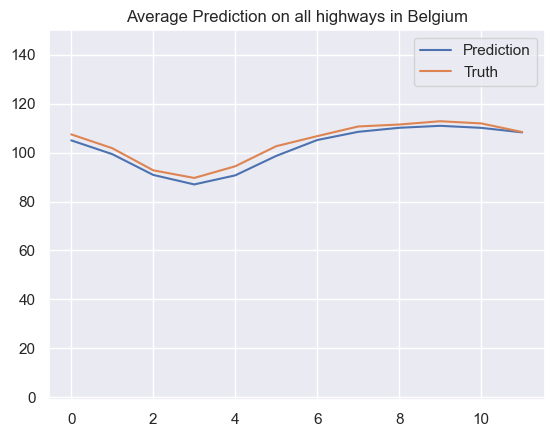

* Time step 335
* Prediction Accuracy (MAE) 9.804053839075694
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


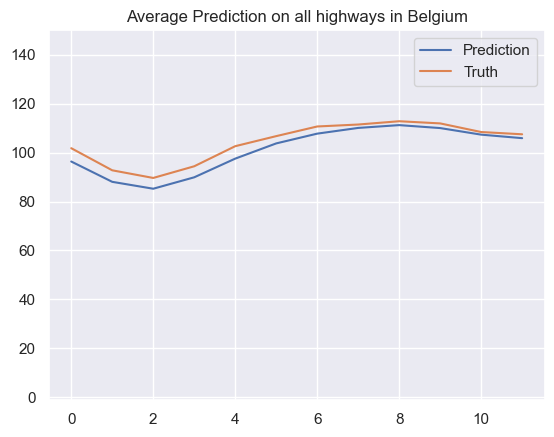

* Time step 336
* Prediction Accuracy (MAE) 10.30849975263417
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


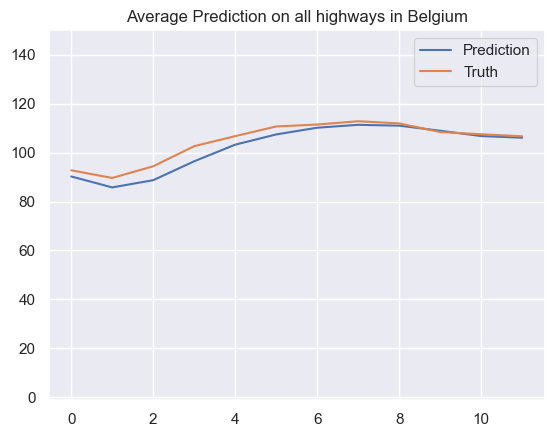

* Time step 337
* Prediction Accuracy (MAE) 10.396961684124703
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


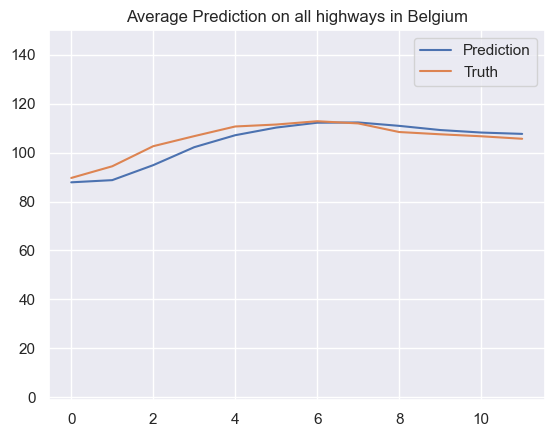

* Time step 338
* Prediction Accuracy (MAE) 10.584619697421651
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


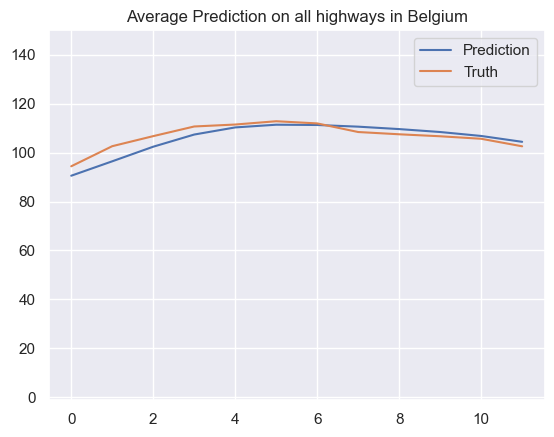

* Time step 339
* Prediction Accuracy (MAE) 10.380389282252974
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


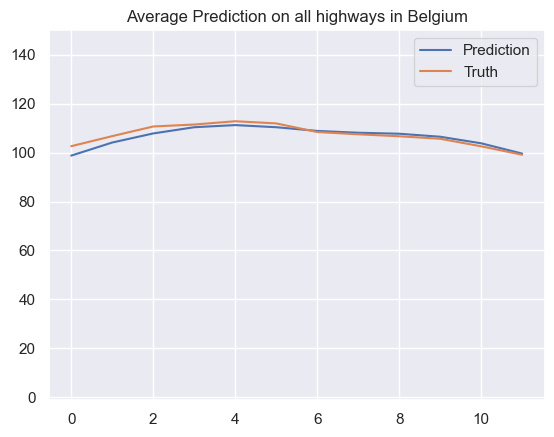

* Time step 340
* Prediction Accuracy (MAE) 10.188919598784995
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


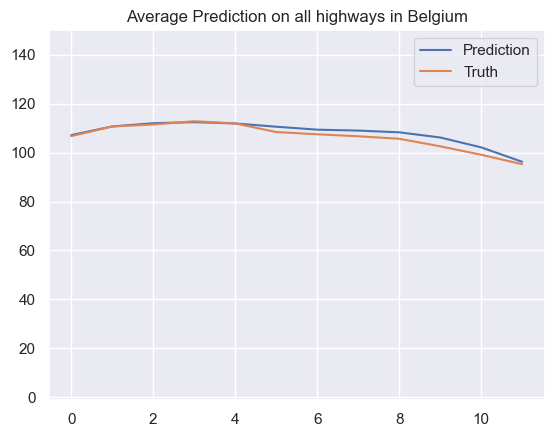

* Time step 341
* Prediction Accuracy (MAE) 10.270437839991077
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


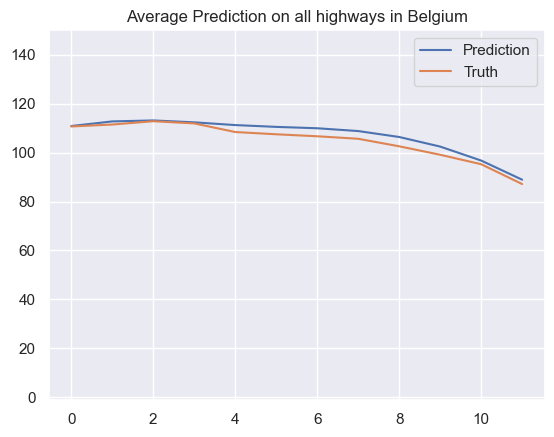

* Time step 342
* Prediction Accuracy (MAE) 10.576690230737093
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


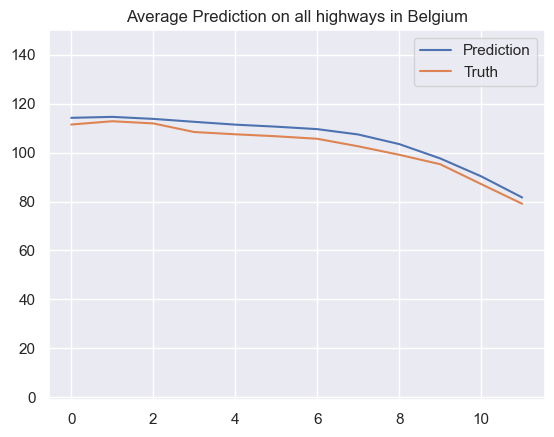

* Time step 343
* Prediction Accuracy (MAE) 10.87441138902427
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


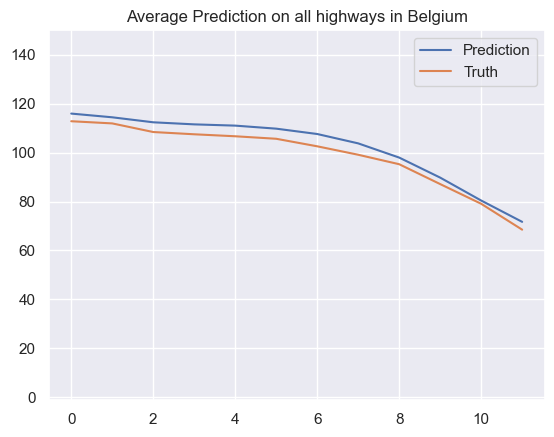

* Time step 344
* Prediction Accuracy (MAE) 10.925942839908414
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


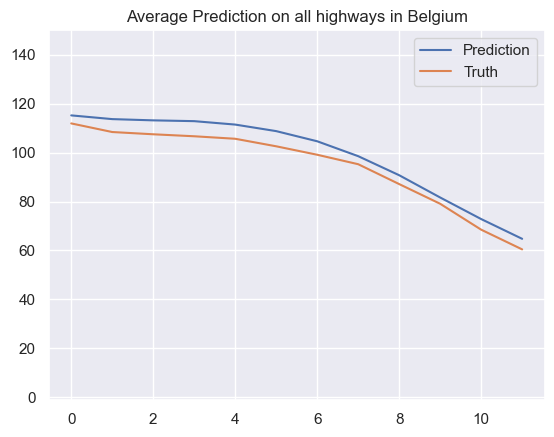

* Time step 345
* Prediction Accuracy (MAE) 10.97304219335831
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


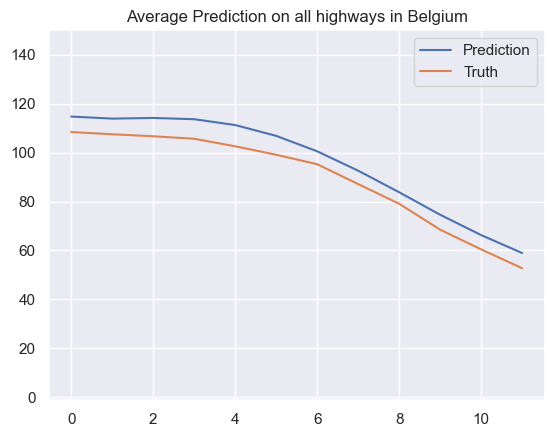

* Time step 346
* Prediction Accuracy (MAE) 11.385453507222419
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


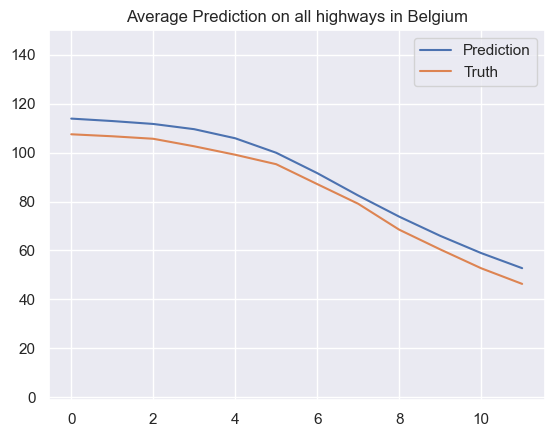

* Time step 347
* Prediction Accuracy (MAE) 10.758171151371718
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


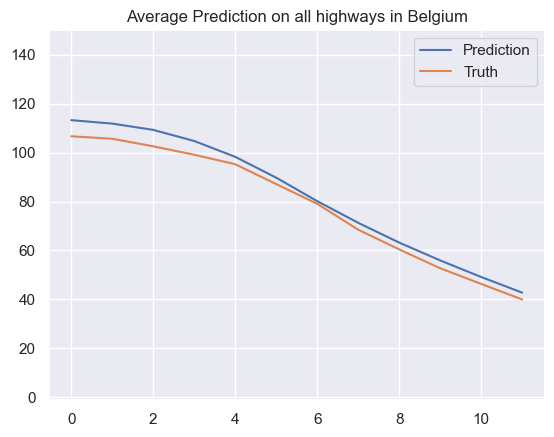

* Time step 348
* Prediction Accuracy (MAE) 10.061952365039458
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


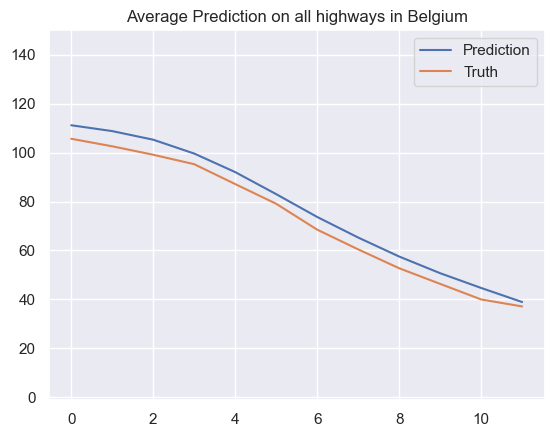

* Time step 349
* Prediction Accuracy (MAE) 10.166297473167065
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


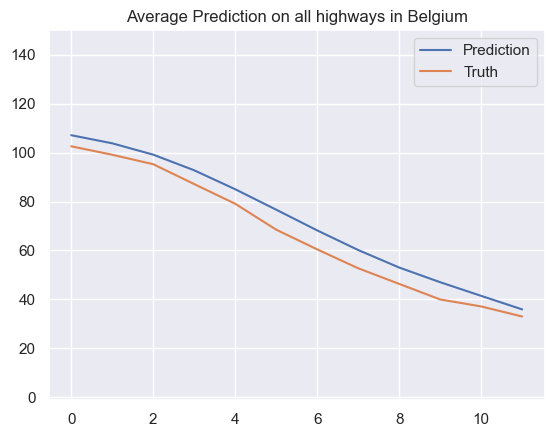

* Time step 350
* Prediction Accuracy (MAE) 10.438055197222882
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


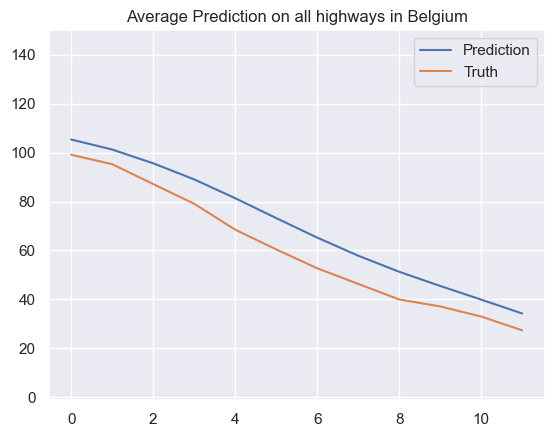

* Time step 351
* Prediction Accuracy (MAE) 12.271219401172944
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


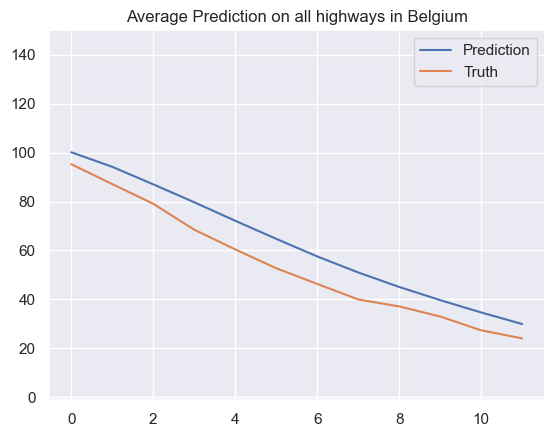

* Time step 352
* Prediction Accuracy (MAE) 11.435351415843067
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


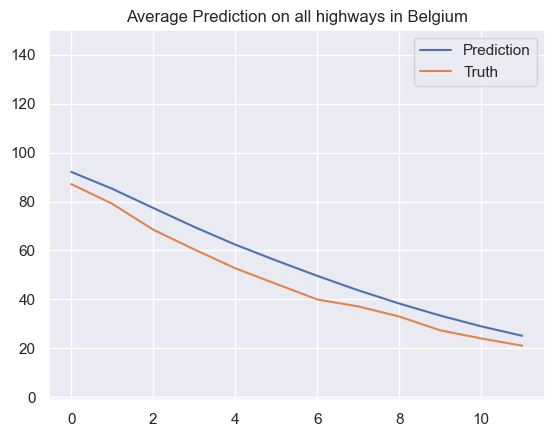

* Time step 353
* Prediction Accuracy (MAE) 9.986567837927465
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


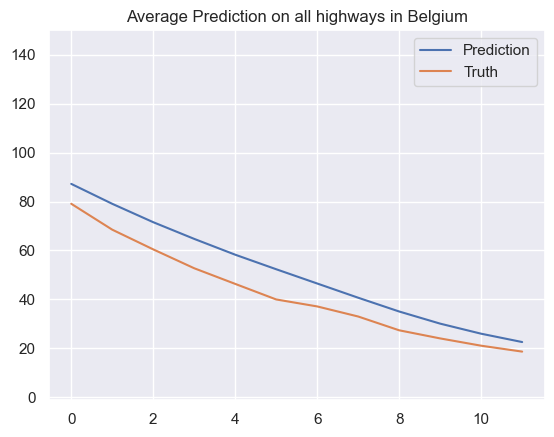

* Time step 354
* Prediction Accuracy (MAE) 10.80952658837606
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


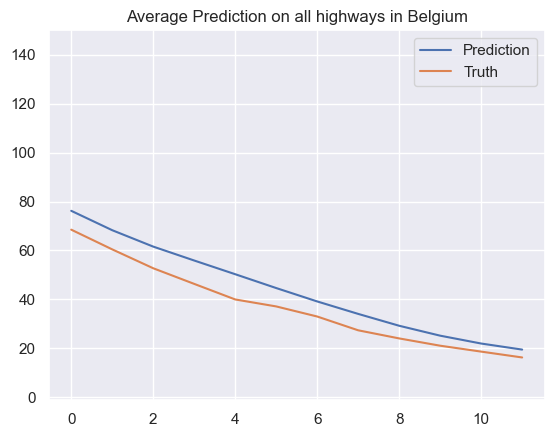

* Time step 355
* Prediction Accuracy (MAE) 9.125478340434077
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


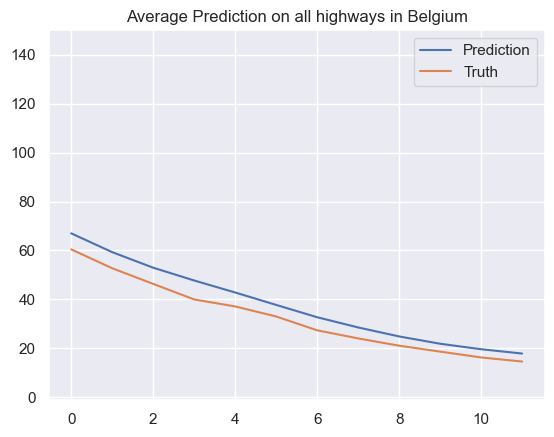

* Time step 356
* Prediction Accuracy (MAE) 7.925540154814948
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


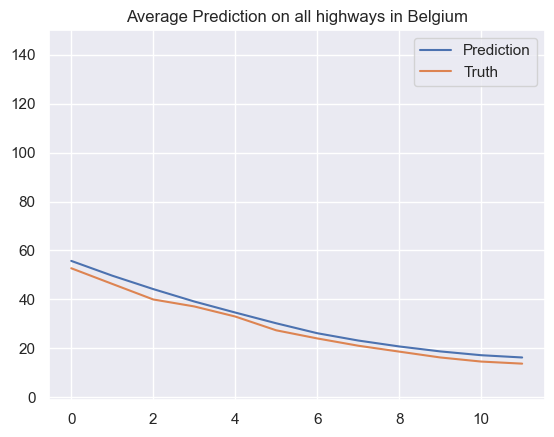

* Time step 357
* Prediction Accuracy (MAE) 6.202217817719887
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


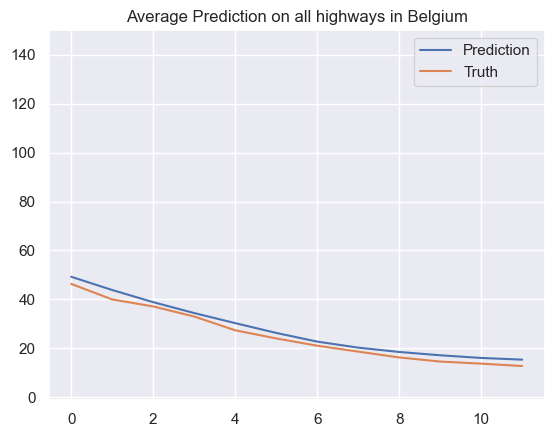

* Time step 358
* Prediction Accuracy (MAE) 5.714417215765872
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


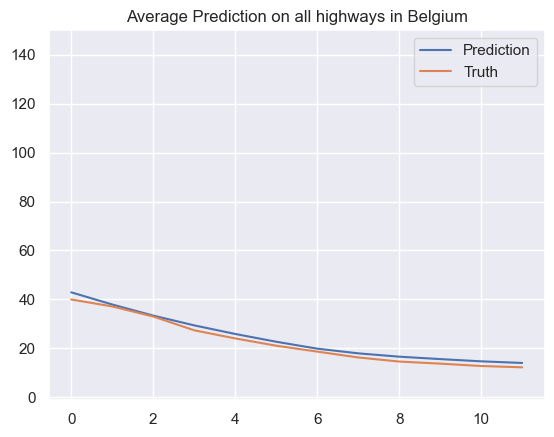

* Time step 359
* Prediction Accuracy (MAE) 5.153447209389966
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


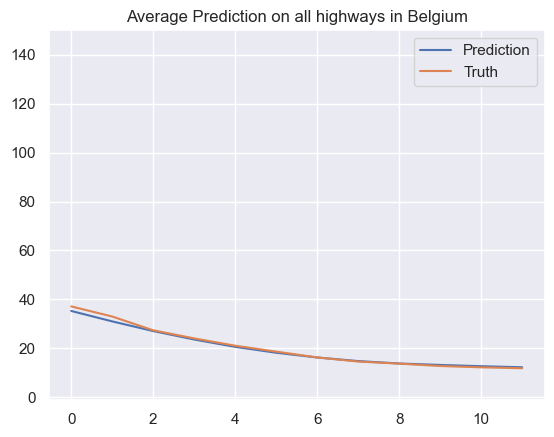

* Time step 360
* Prediction Accuracy (MAE) 4.250969167855992
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


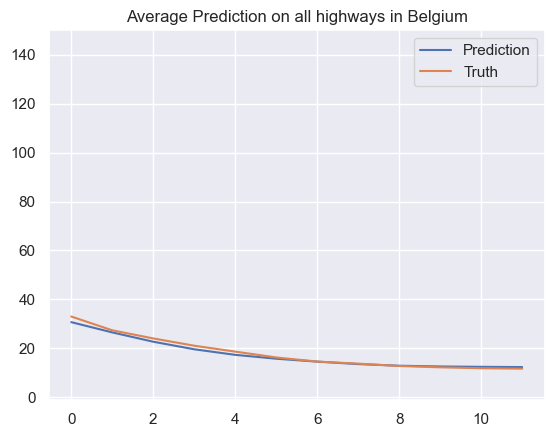

* Time step 361
* Prediction Accuracy (MAE) 3.7683936750048086
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


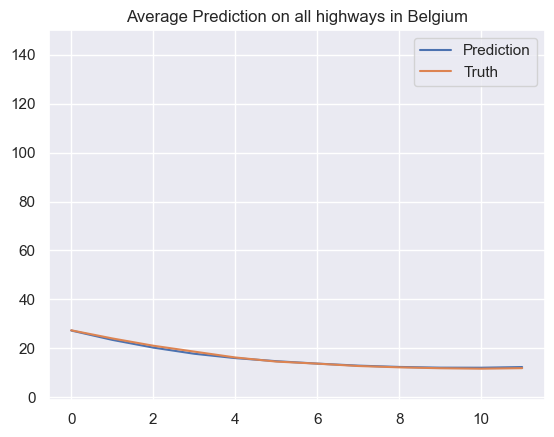

* Time step 362
* Prediction Accuracy (MAE) 3.3456404878384727
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


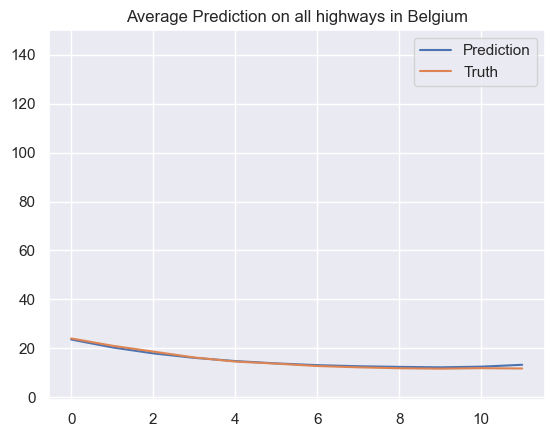

* Time step 363
* Prediction Accuracy (MAE) 3.2357778920731555
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


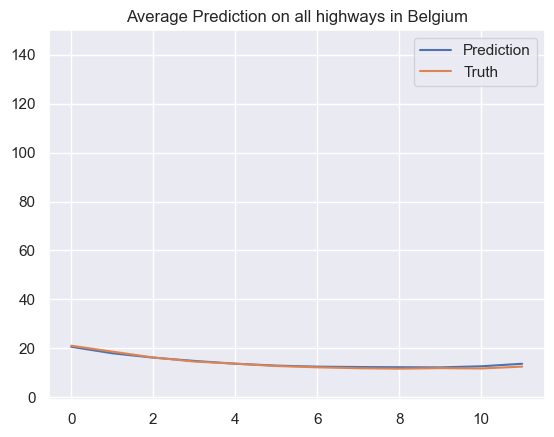

* Time step 364
* Prediction Accuracy (MAE) 3.12767827550155
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


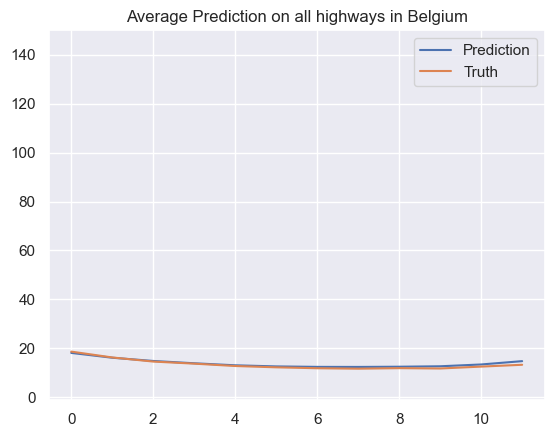

* Time step 365
* Prediction Accuracy (MAE) 3.0476896987563404
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


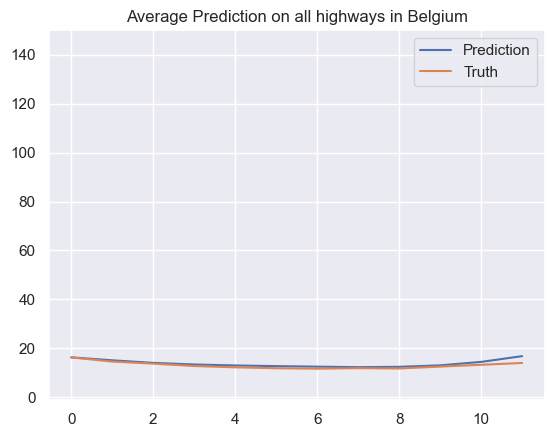

* Time step 366
* Prediction Accuracy (MAE) 3.032078899506155
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


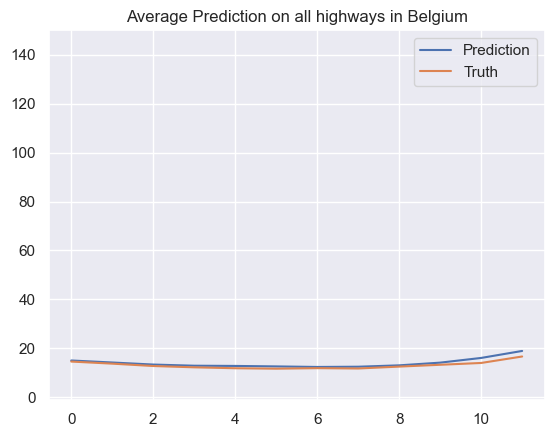

* Time step 367
* Prediction Accuracy (MAE) 3.0290281364576024
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


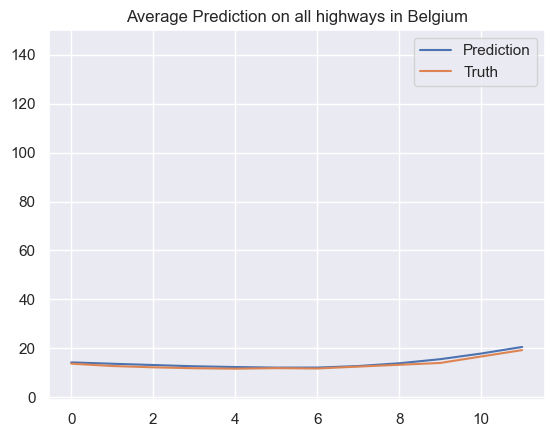

* Time step 368
* Prediction Accuracy (MAE) 2.9802251552988386
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


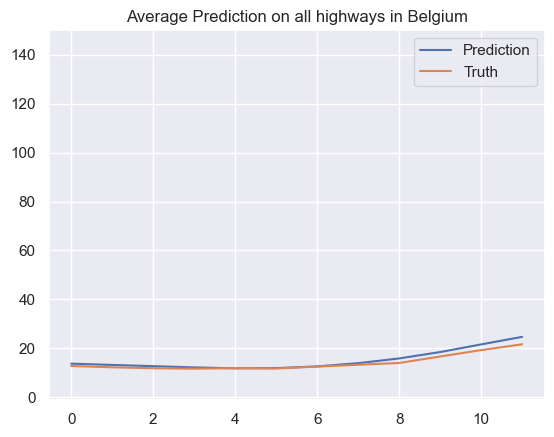

* Time step 369
* Prediction Accuracy (MAE) 3.2318652363384697
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


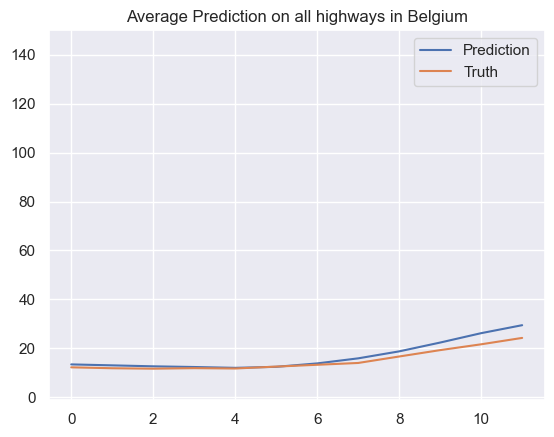

* Time step 370
* Prediction Accuracy (MAE) 3.705457737436332
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


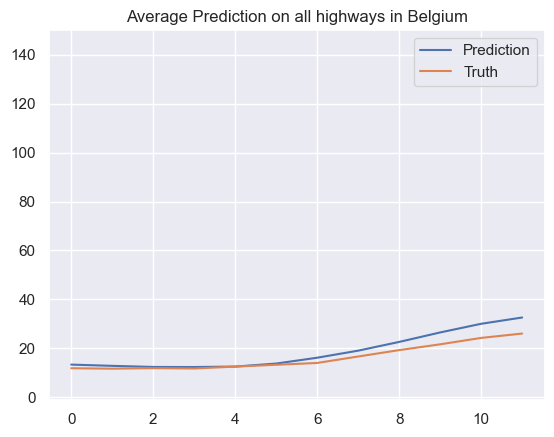

* Time step 371
* Prediction Accuracy (MAE) 4.218104285882924
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


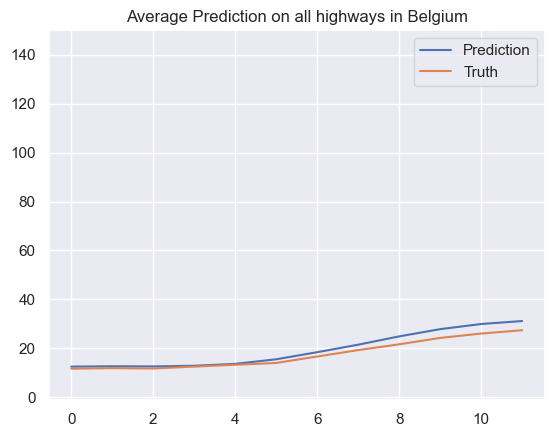

* Time step 372
* Prediction Accuracy (MAE) 3.9512568854867256
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


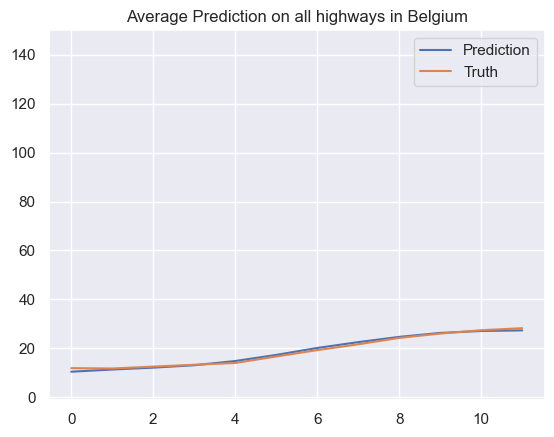

* Time step 373
* Prediction Accuracy (MAE) 3.6016750007983043
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


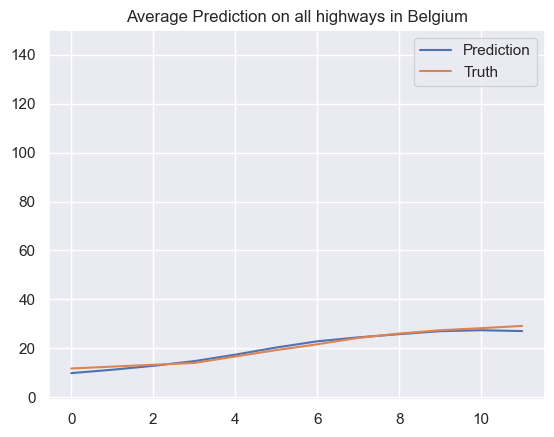

* Time step 374
* Prediction Accuracy (MAE) 3.8653053242493502
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


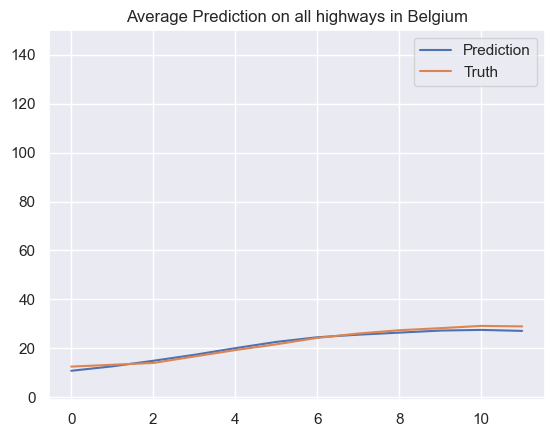

* Time step 375
* Prediction Accuracy (MAE) 3.842016979754944
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


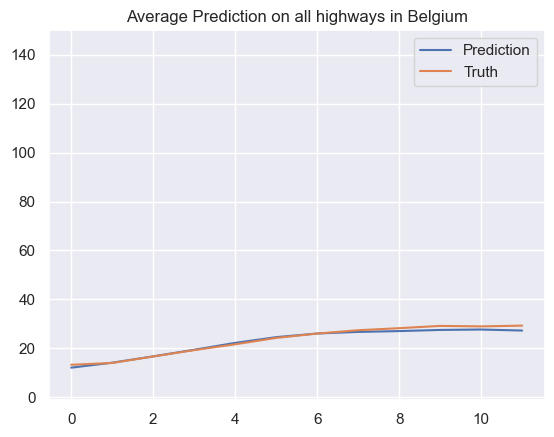

* Time step 376
* Prediction Accuracy (MAE) 3.868091198523836
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


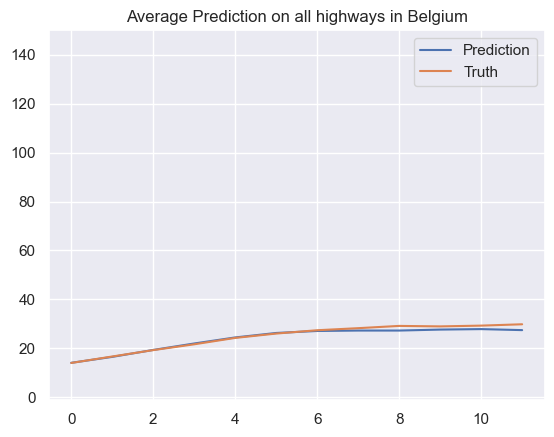

* Time step 377
* Prediction Accuracy (MAE) 4.0076002723414845
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


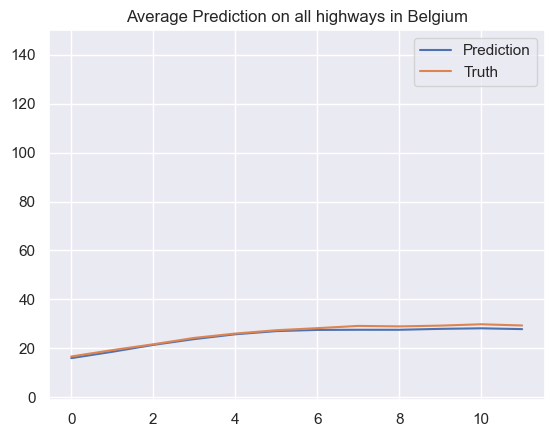

* Time step 378
* Prediction Accuracy (MAE) 4.12365504808859
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


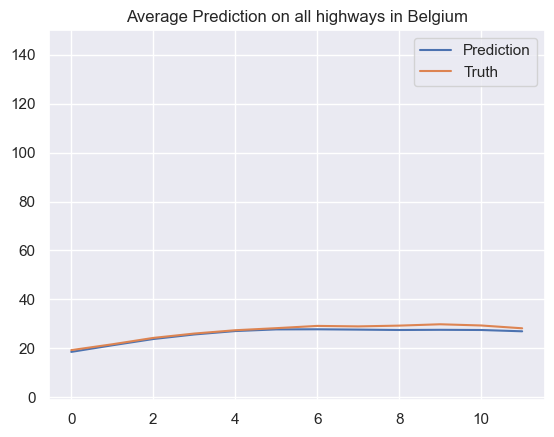

* Time step 379
* Prediction Accuracy (MAE) 4.2610222462216285
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


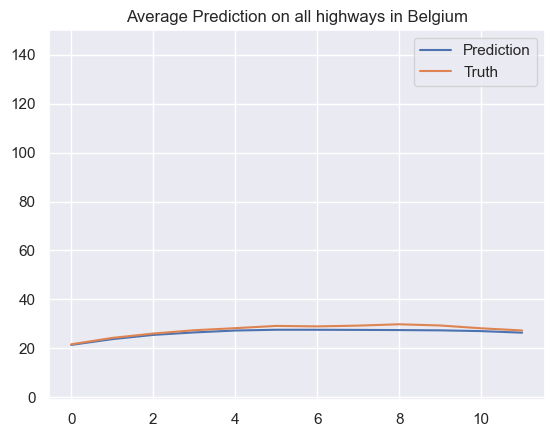

* Time step 380
* Prediction Accuracy (MAE) 4.377125709306618
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


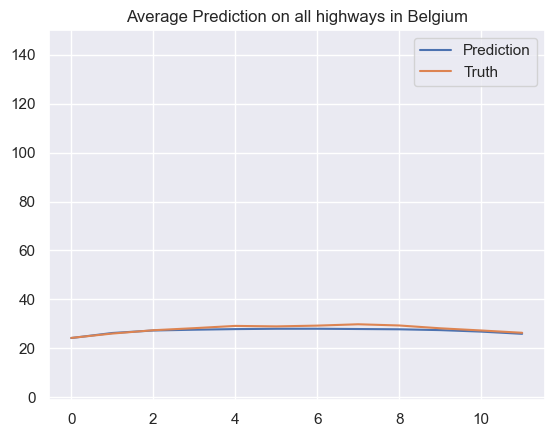

* Time step 381
* Prediction Accuracy (MAE) 4.375780739749807
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


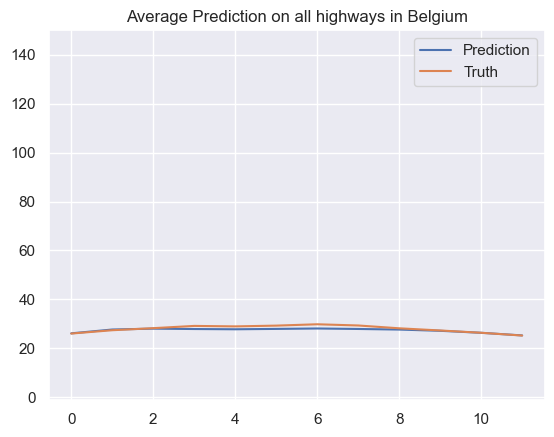

* Time step 382
* Prediction Accuracy (MAE) 4.418756311258341
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


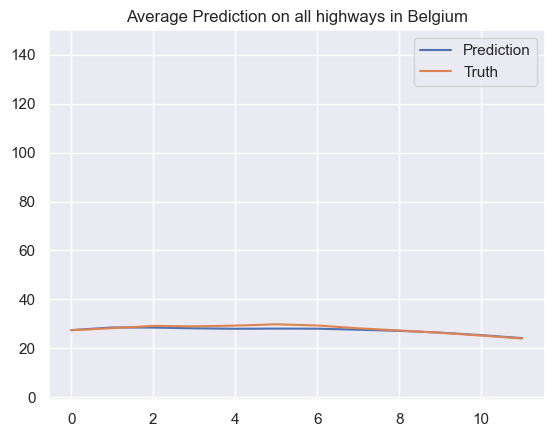

* Time step 383
* Prediction Accuracy (MAE) 4.463137050942576
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


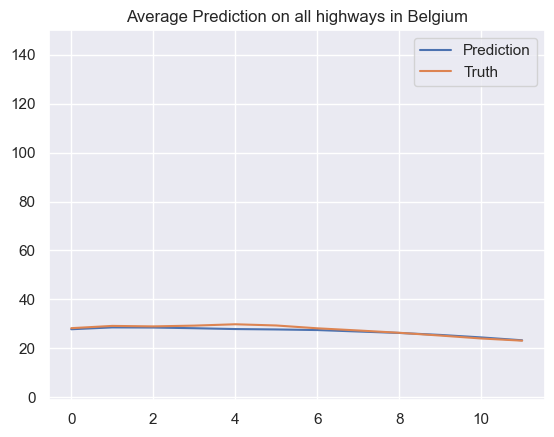

* Time step 384
* Prediction Accuracy (MAE) 4.462904311805416
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


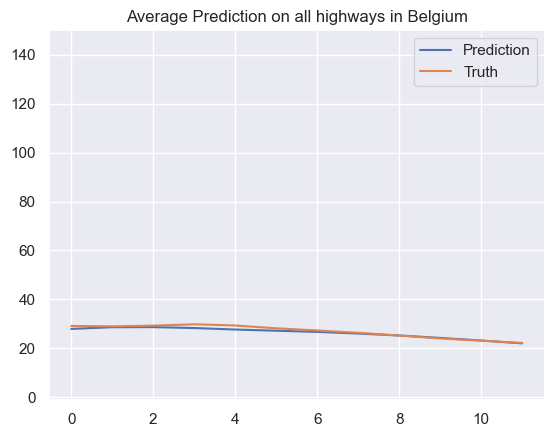

* Time step 385
* Prediction Accuracy (MAE) 4.438754879717821
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


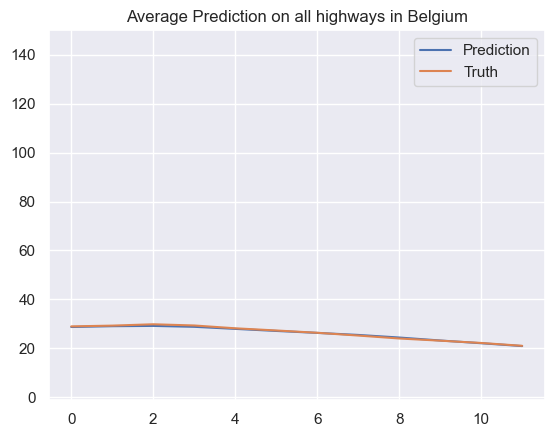

* Time step 386
* Prediction Accuracy (MAE) 4.3759417286839515
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


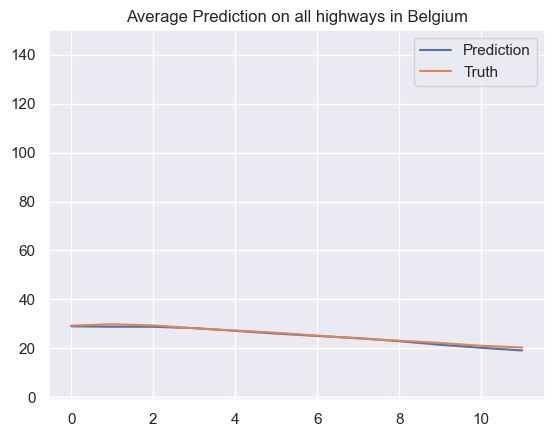

* Time step 387
* Prediction Accuracy (MAE) 4.383981489766958
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


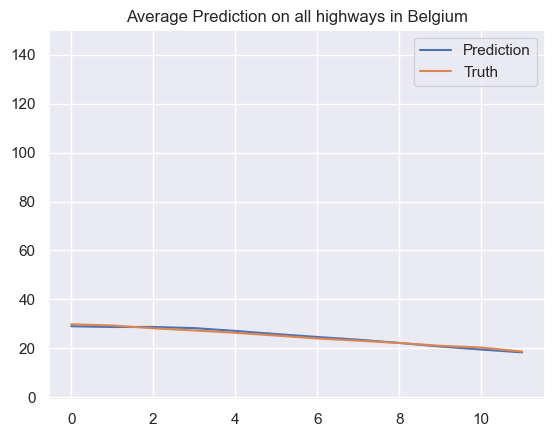

* Time step 388
* Prediction Accuracy (MAE) 4.348505893062215
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


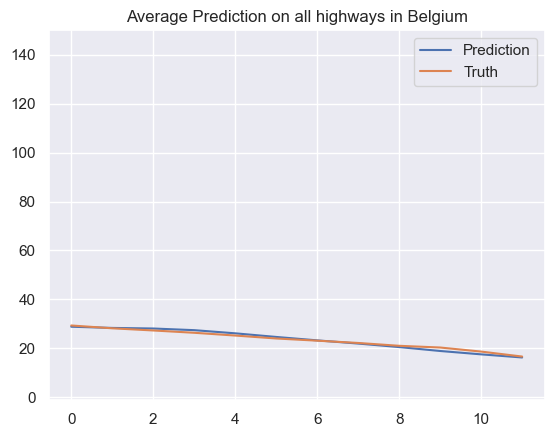

* Time step 389
* Prediction Accuracy (MAE) 4.280972642191046
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


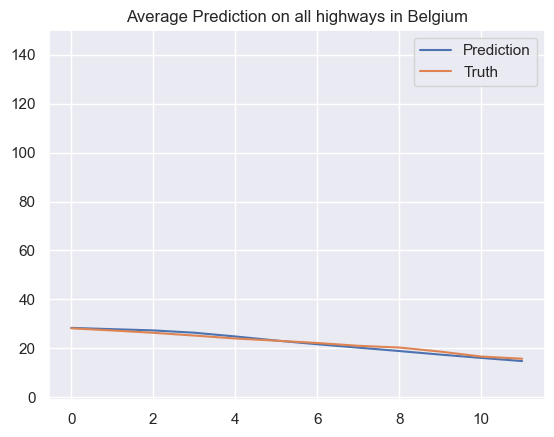

* Time step 390
* Prediction Accuracy (MAE) 4.218295426067416
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


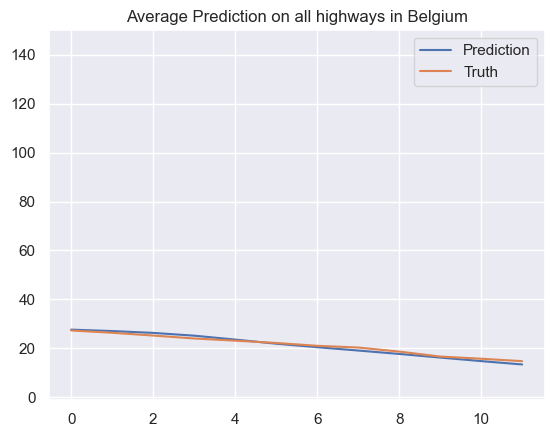

* Time step 391
* Prediction Accuracy (MAE) 4.1306517983619715
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


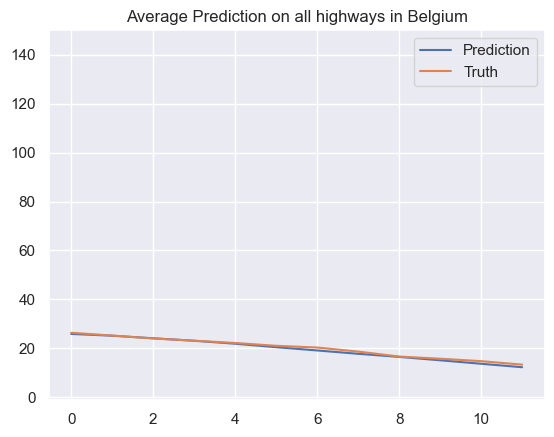

* Time step 392
* Prediction Accuracy (MAE) 3.9624812497654838
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


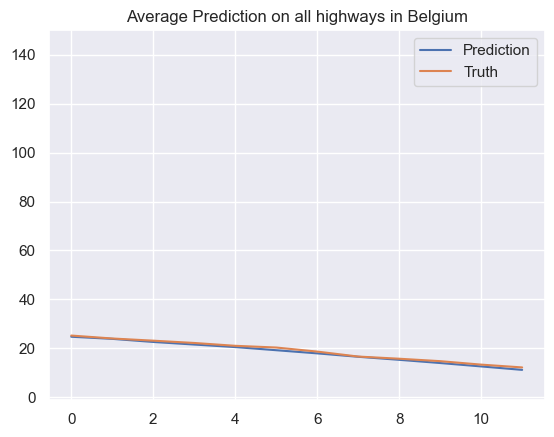

* Time step 393
* Prediction Accuracy (MAE) 3.8561321240136053
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


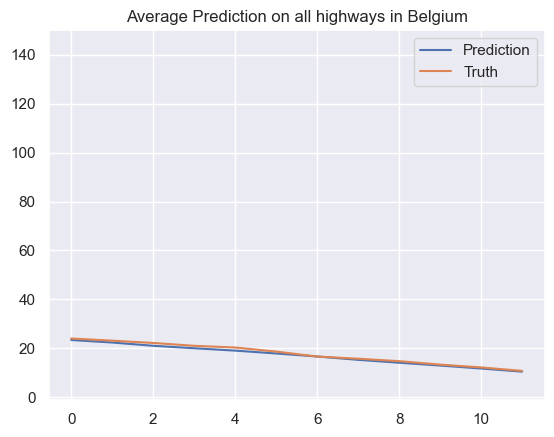

* Time step 394
* Prediction Accuracy (MAE) 3.6787676815978383
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


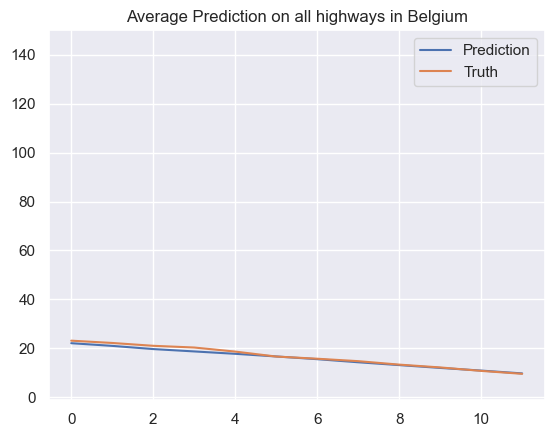

* Time step 395
* Prediction Accuracy (MAE) 3.5135689776779038
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


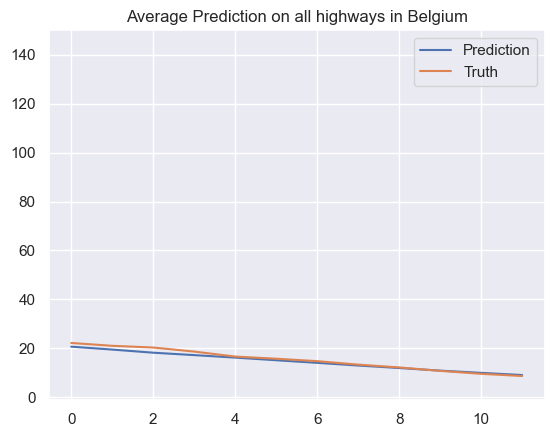

* Time step 396
* Prediction Accuracy (MAE) 3.3828656876964818
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


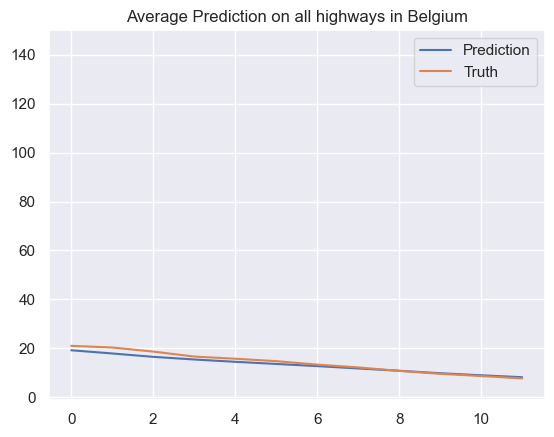

* Time step 397
* Prediction Accuracy (MAE) 3.2811672315327685
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


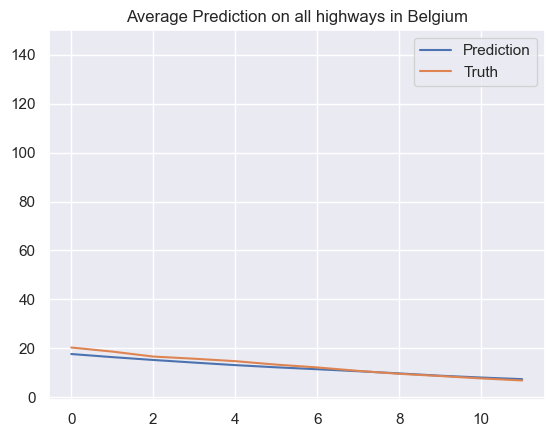

* Time step 398
* Prediction Accuracy (MAE) 3.1407681338885847
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


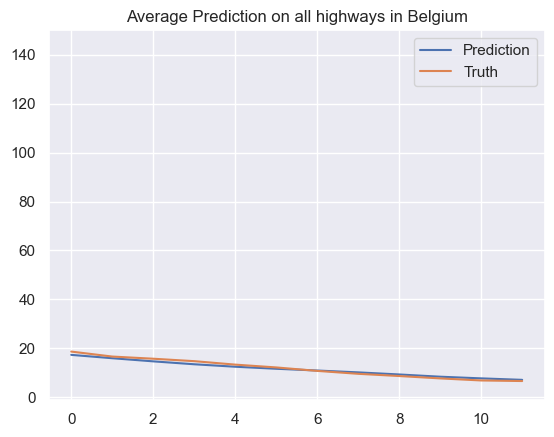

* Time step 399
* Prediction Accuracy (MAE) 2.941921570474334
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


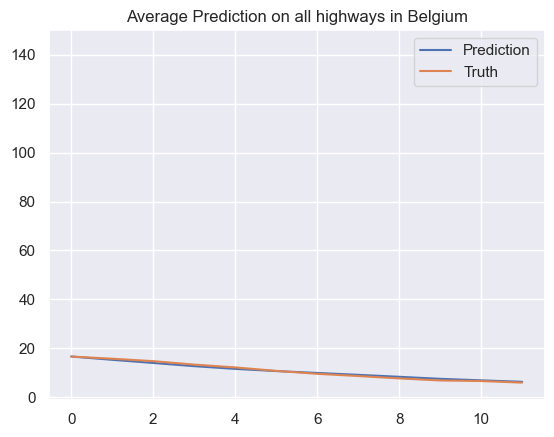

* Time step 400
* Prediction Accuracy (MAE) 2.74438793673143
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


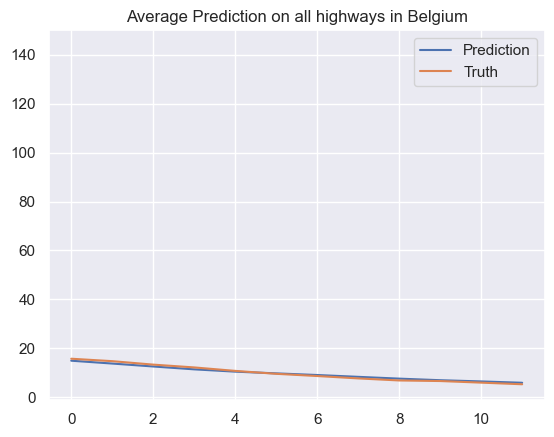

* Time step 401
* Prediction Accuracy (MAE) 2.615944958017744
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


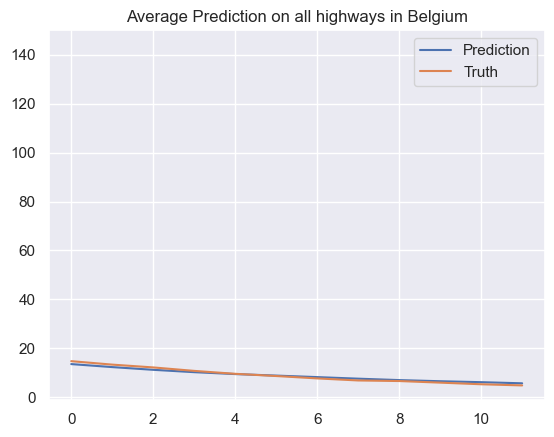

* Time step 402
* Prediction Accuracy (MAE) 2.492846224710137
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


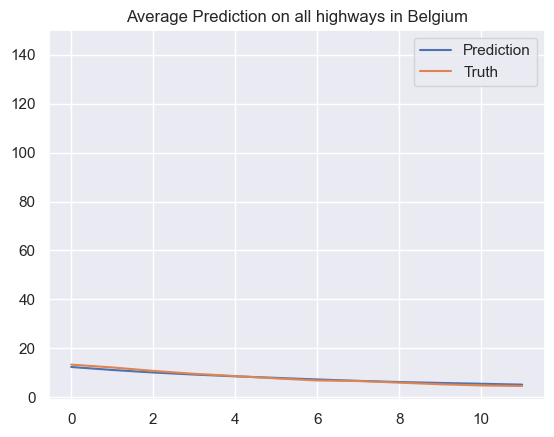

* Time step 403
* Prediction Accuracy (MAE) 2.3466369808973884
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


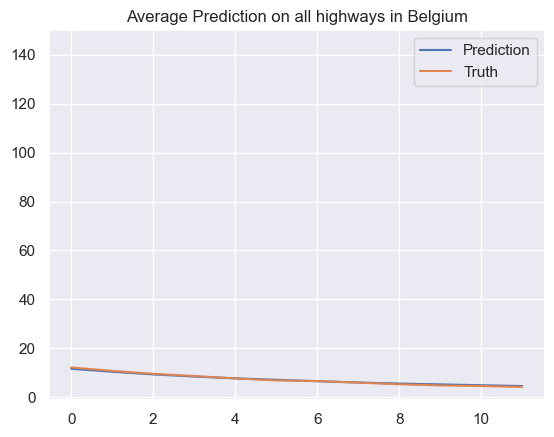

* Time step 404
* Prediction Accuracy (MAE) 2.1954667863452744
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


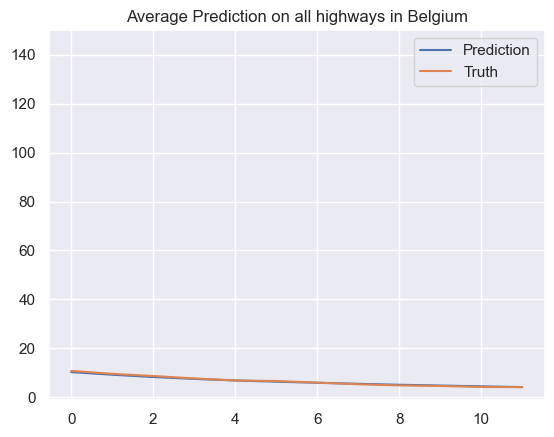

* Time step 405
* Prediction Accuracy (MAE) 2.0613382713446513
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


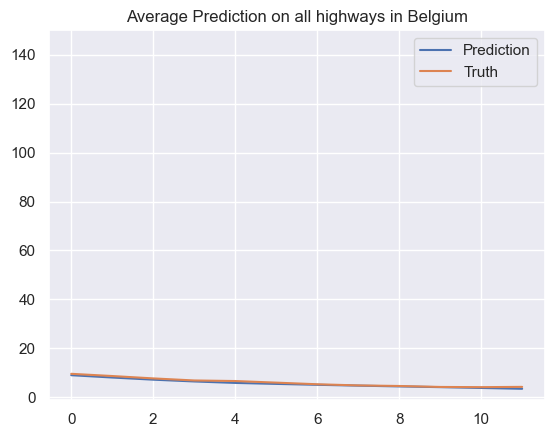

* Time step 406
* Prediction Accuracy (MAE) 1.9856662008616042
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


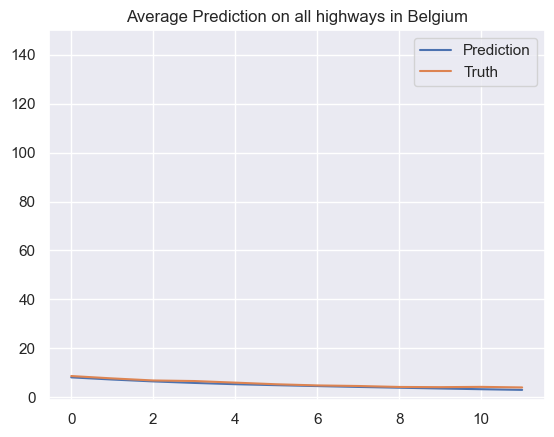

* Time step 407
* Prediction Accuracy (MAE) 1.9220396982386814
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


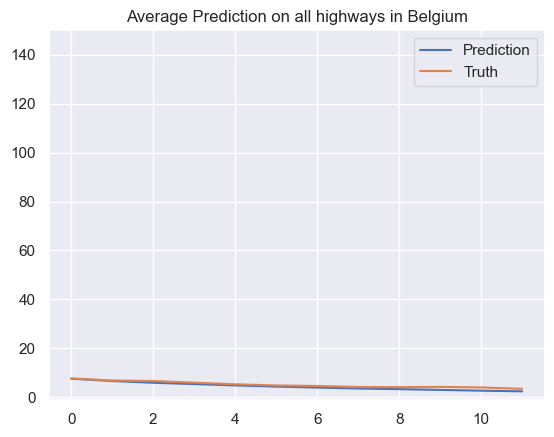

* Time step 408
* Prediction Accuracy (MAE) 1.8945897084987484
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


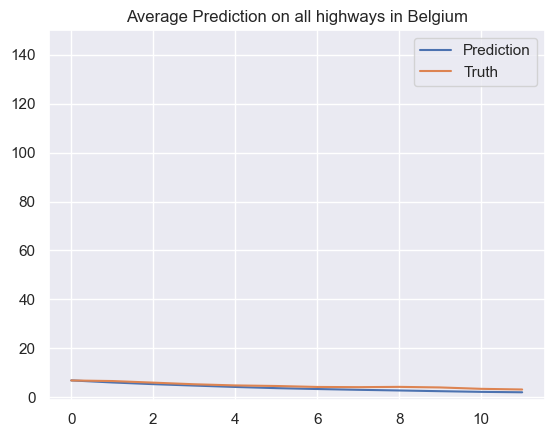

* Time step 409
* Prediction Accuracy (MAE) 1.8858243796901943
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


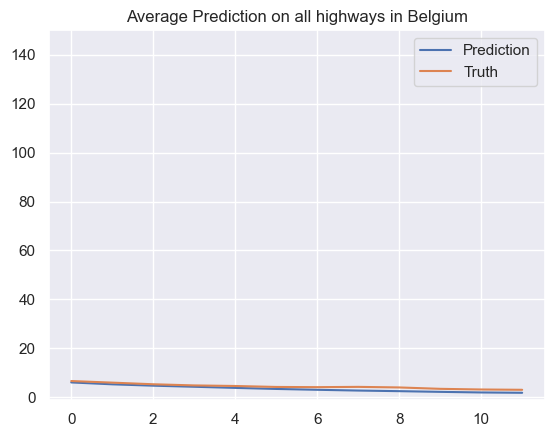

* Time step 410
* Prediction Accuracy (MAE) 1.837864687596164
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


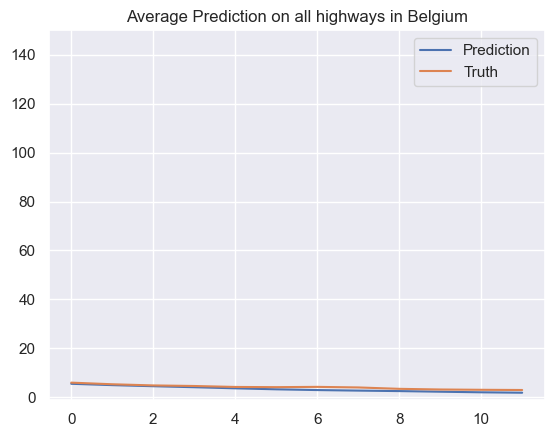

* Time step 411
* Prediction Accuracy (MAE) 1.7002664436023247
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


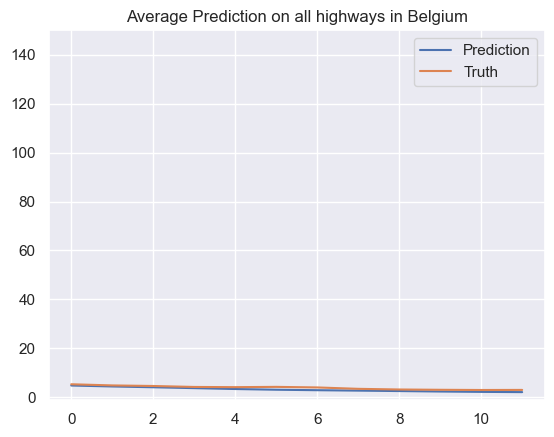

* Time step 412
* Prediction Accuracy (MAE) 1.6122142419097312
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


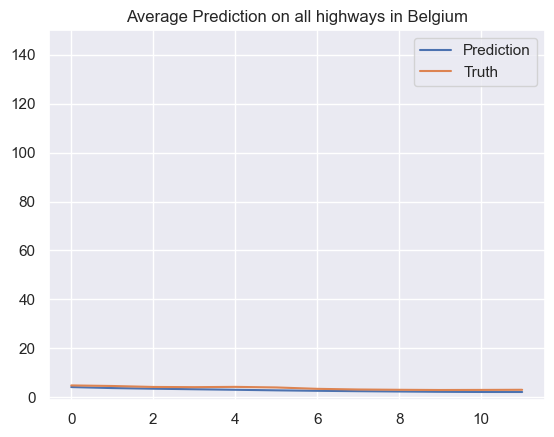

* Time step 413
* Prediction Accuracy (MAE) 1.6171805176224252
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


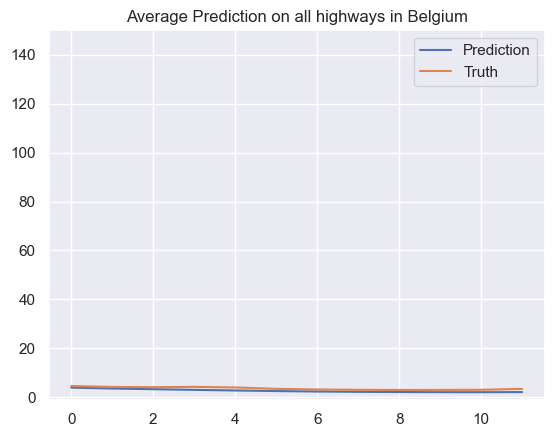

* Time step 414
* Prediction Accuracy (MAE) 1.6338409306603334
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


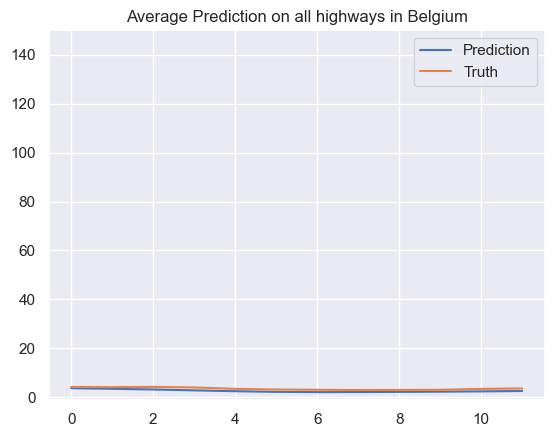

* Time step 415
* Prediction Accuracy (MAE) 1.586646626390324
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


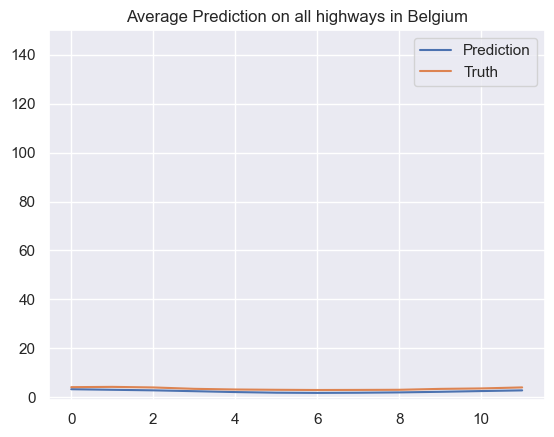

* Time step 416
* Prediction Accuracy (MAE) 1.6431472290697877
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


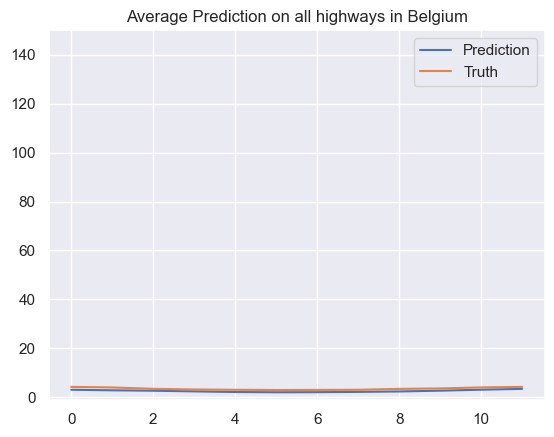

* Time step 417
* Prediction Accuracy (MAE) 1.5929947888227138
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


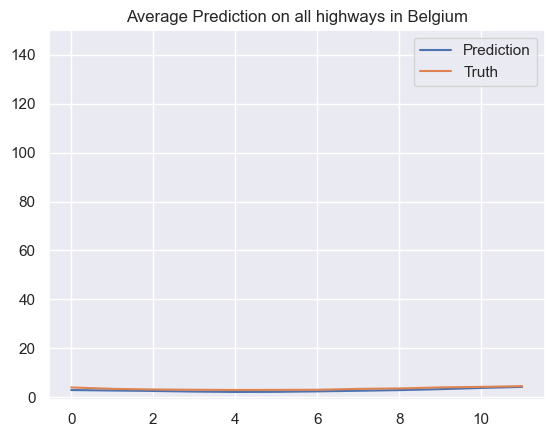

* Time step 418
* Prediction Accuracy (MAE) 1.5670393768855506
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


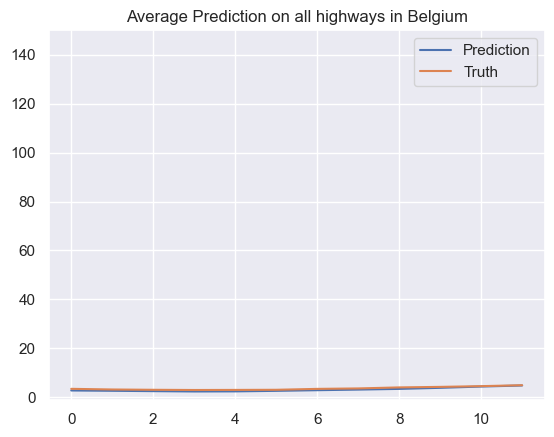

* Time step 419
* Prediction Accuracy (MAE) 1.561007888687254
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


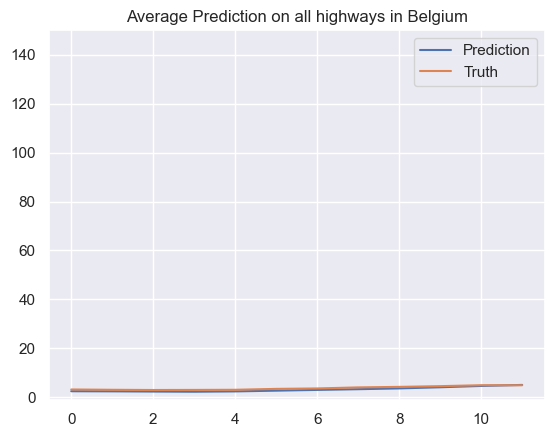

* Time step 420
* Prediction Accuracy (MAE) 1.6055391191464115
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


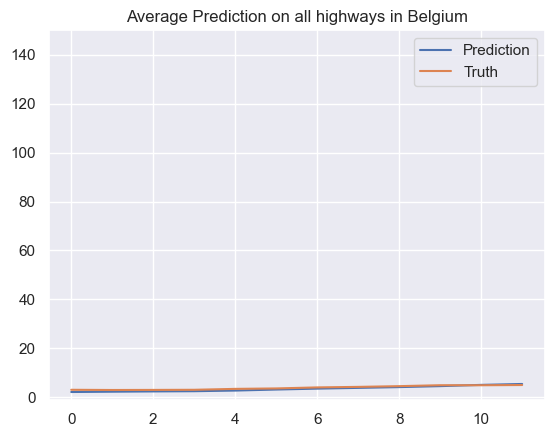

* Time step 421
* Prediction Accuracy (MAE) 1.6245125681343018
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


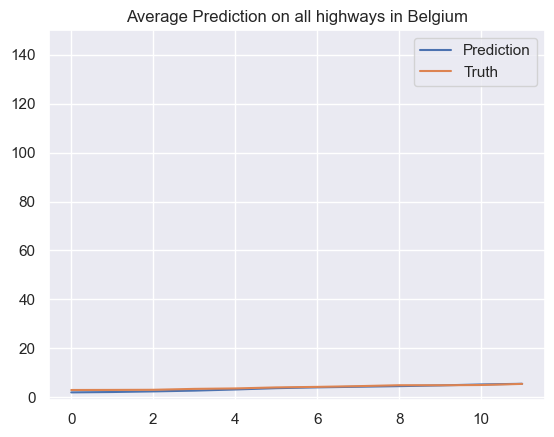

* Time step 422
* Prediction Accuracy (MAE) 1.6448969209791655
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


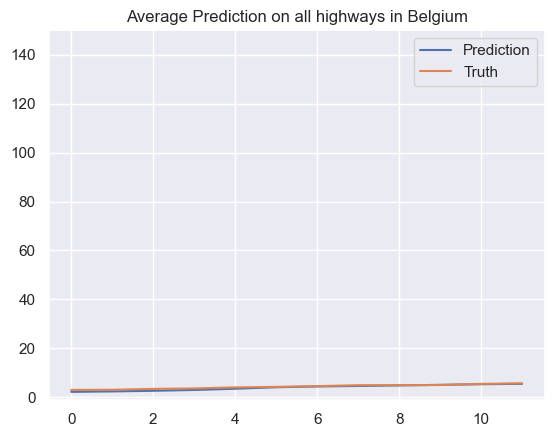

* Time step 423
* Prediction Accuracy (MAE) 1.6554764352913713
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


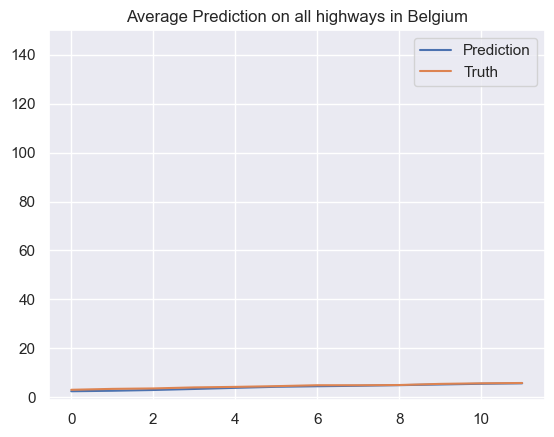

* Time step 424
* Prediction Accuracy (MAE) 1.6551988179164905
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


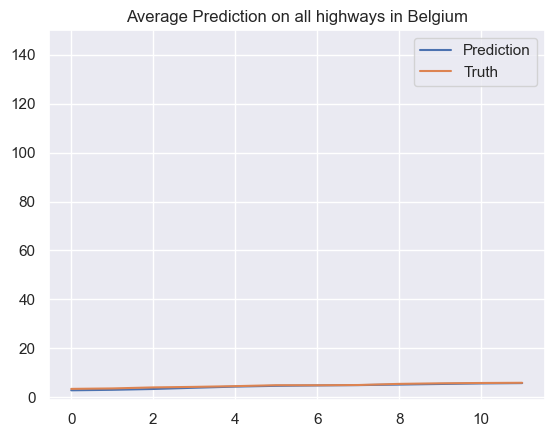

* Time step 425
* Prediction Accuracy (MAE) 1.6933280874071708
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


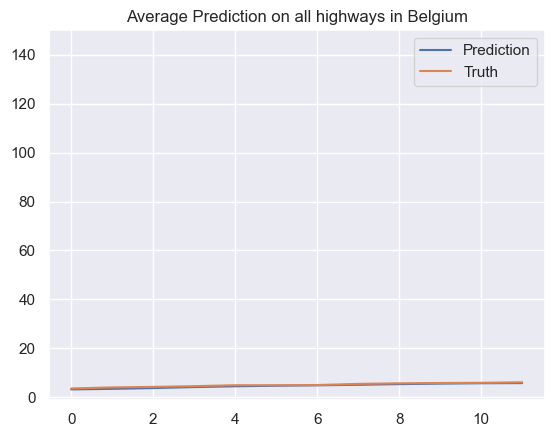

* Time step 426
* Prediction Accuracy (MAE) 1.725516230320127
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


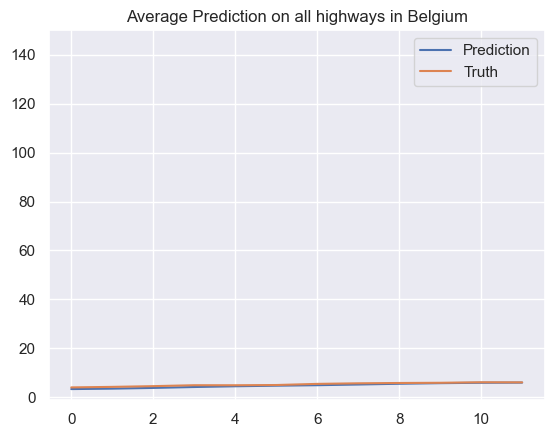

* Time step 427
* Prediction Accuracy (MAE) 1.7466688568821696
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


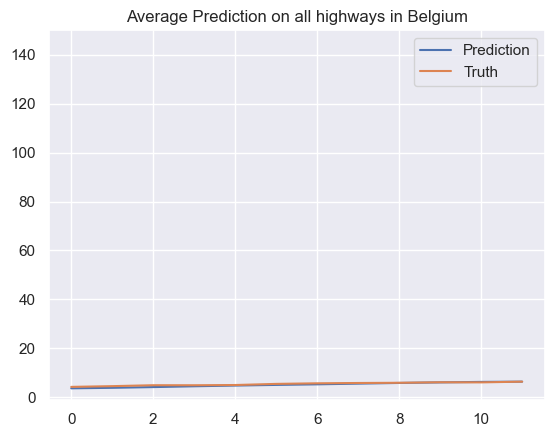

* Time step 428
* Prediction Accuracy (MAE) 1.7734661024841187
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


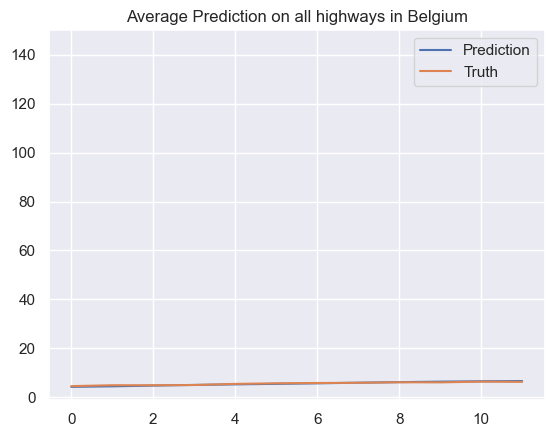

* Time step 429
* Prediction Accuracy (MAE) 1.8005659423542992
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


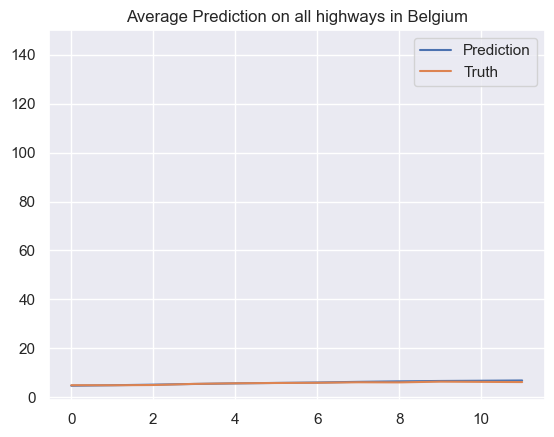

* Time step 430
* Prediction Accuracy (MAE) 1.8615301212854447
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


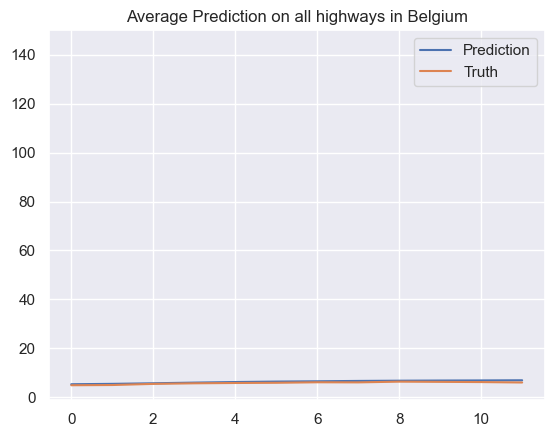

* Time step 431
* Prediction Accuracy (MAE) 1.9560649824501621
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


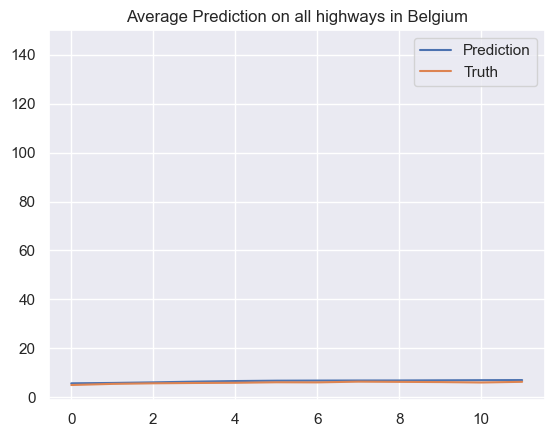

* Time step 432
* Prediction Accuracy (MAE) 2.012929090668716
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


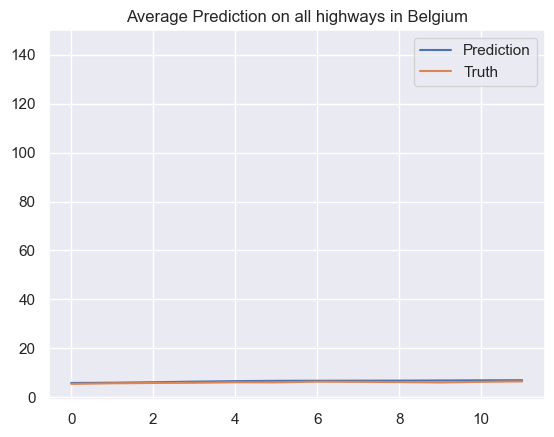

* Time step 433
* Prediction Accuracy (MAE) 1.9995779690501008
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


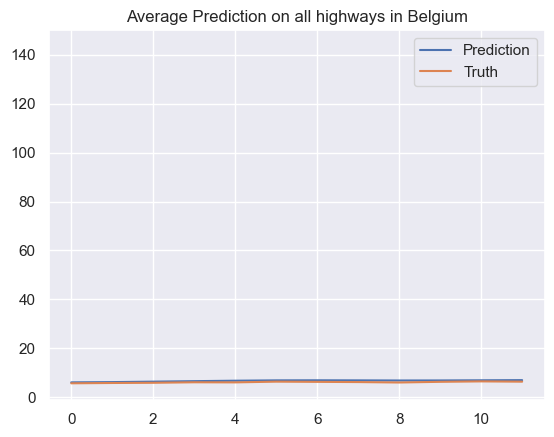

* Time step 434
* Prediction Accuracy (MAE) 2.040632600004295
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


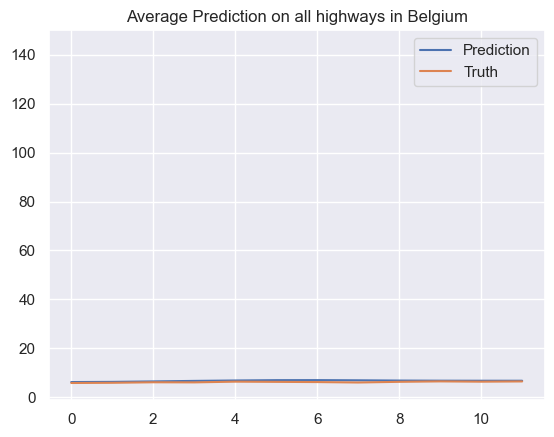

* Time step 435
* Prediction Accuracy (MAE) 2.0427645712372375
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


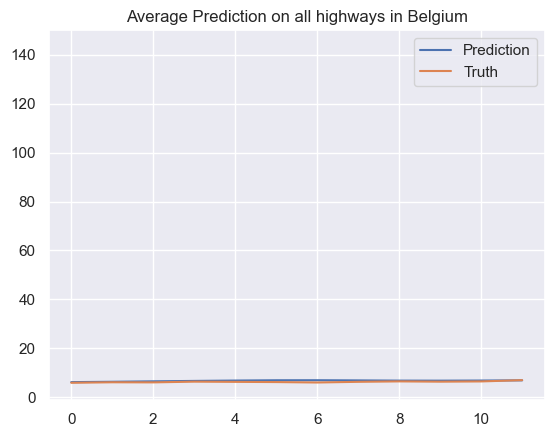

* Time step 436
* Prediction Accuracy (MAE) 2.053019369927932
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


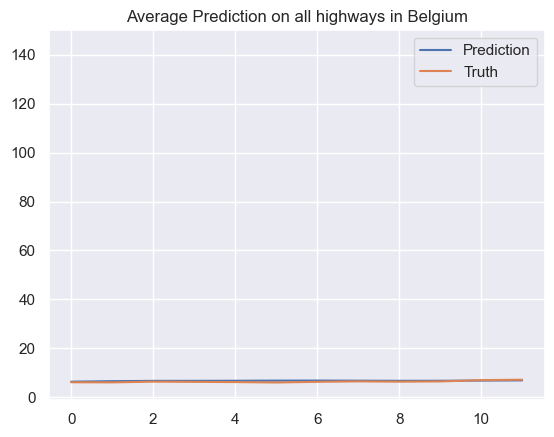

* Time step 437
* Prediction Accuracy (MAE) 2.048911748251498
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


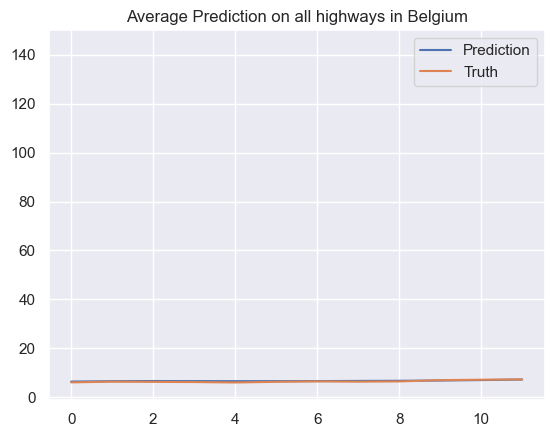

* Time step 438
* Prediction Accuracy (MAE) 2.0735416247262526
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


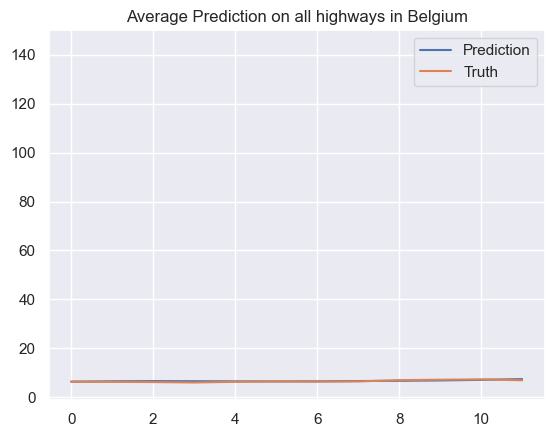

* Time step 439
* Prediction Accuracy (MAE) 2.0821860277880835
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


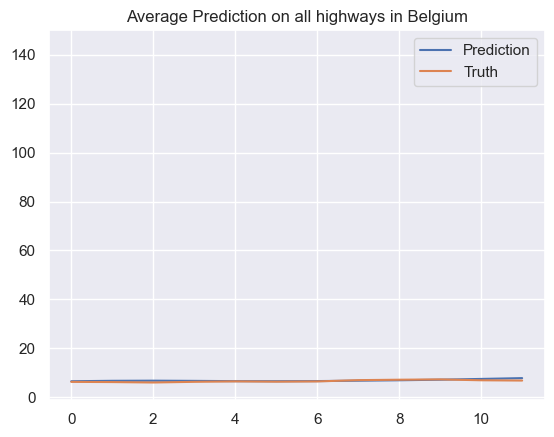

* Time step 440
* Prediction Accuracy (MAE) 2.1158460532433128
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


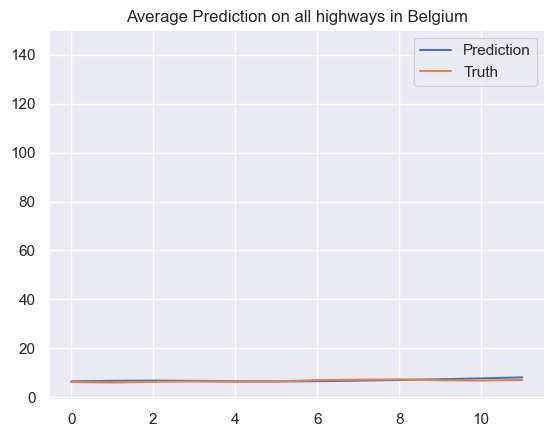

* Time step 441
* Prediction Accuracy (MAE) 2.1402184338296695
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


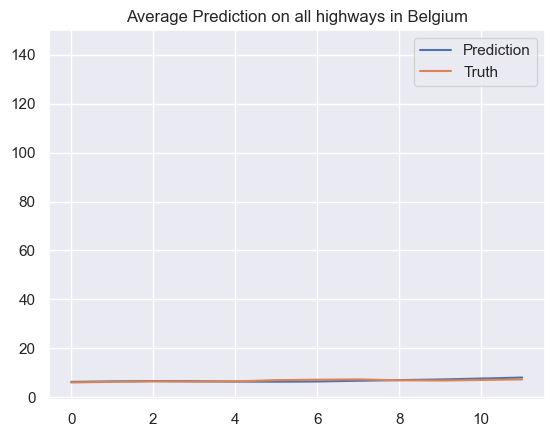

* Time step 442
* Prediction Accuracy (MAE) 2.139338694593824
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


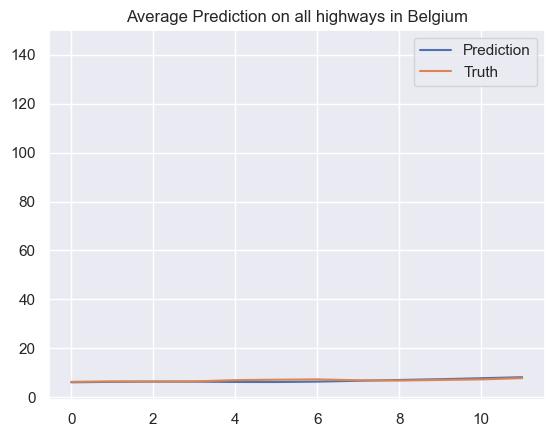

* Time step 443
* Prediction Accuracy (MAE) 2.1649161486058293
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


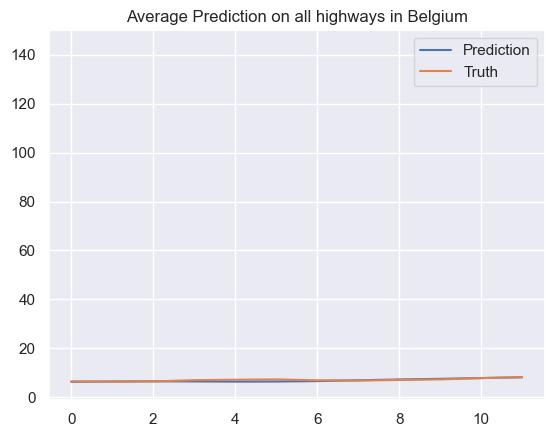

* Time step 444
* Prediction Accuracy (MAE) 2.1703709336725603
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


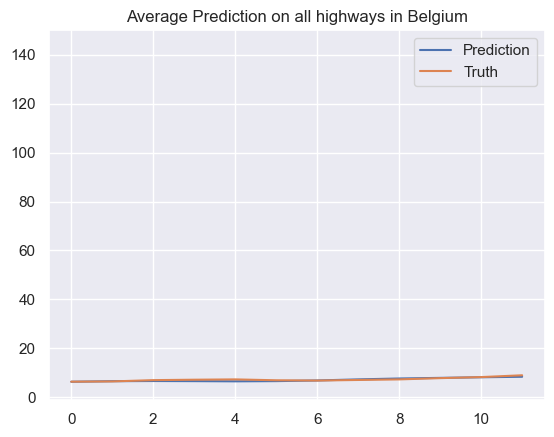

* Time step 445
* Prediction Accuracy (MAE) 2.2067876440564276
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


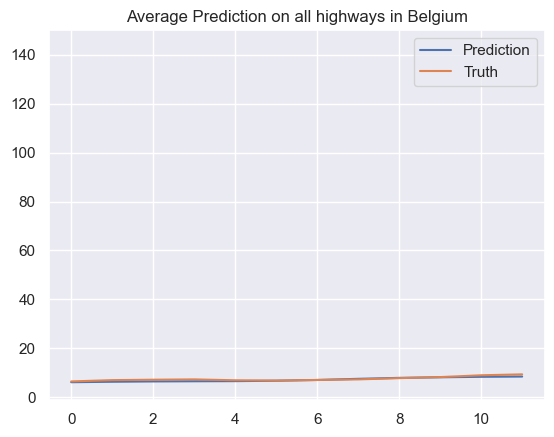

* Time step 446
* Prediction Accuracy (MAE) 2.2286436342579785
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


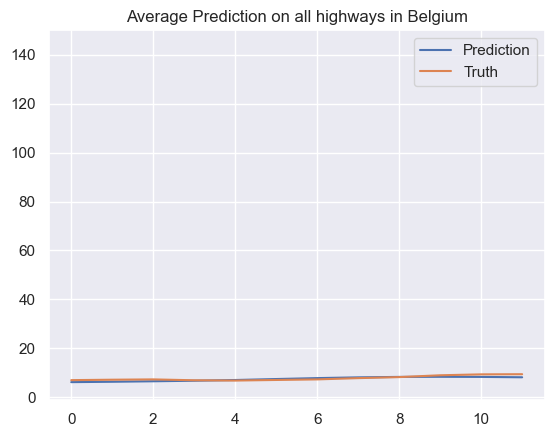

* Time step 447
* Prediction Accuracy (MAE) 2.2608152834953006
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


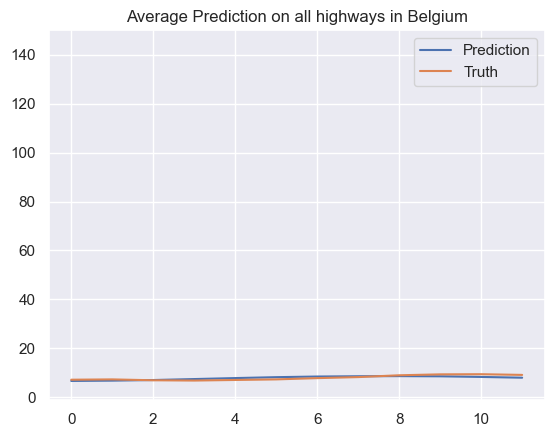

* Time step 448
* Prediction Accuracy (MAE) 2.291236770177406
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


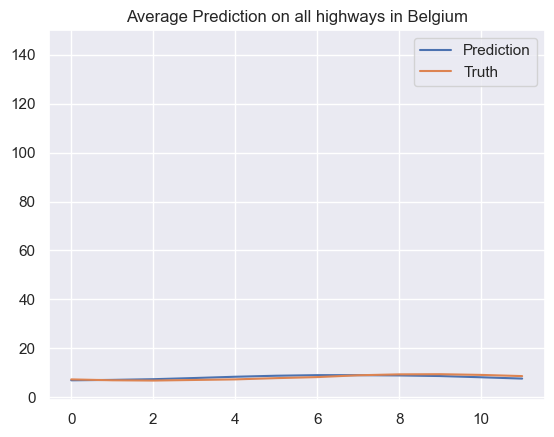

* Time step 449
* Prediction Accuracy (MAE) 2.350056566396218
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


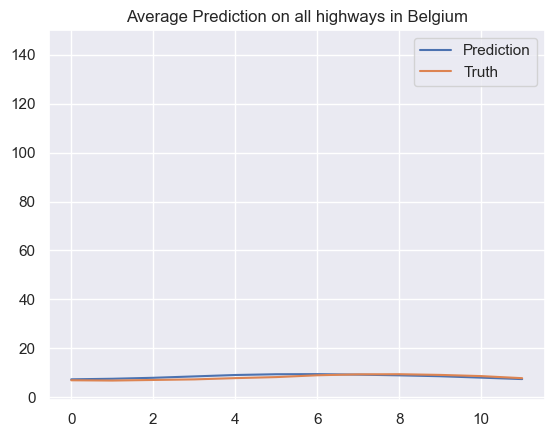

* Time step 450
* Prediction Accuracy (MAE) 2.390715868204531
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


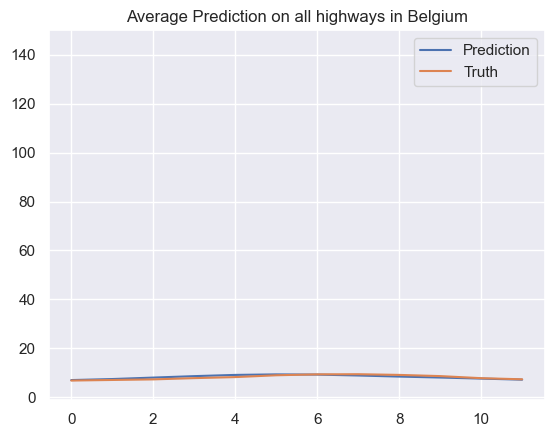

* Time step 451
* Prediction Accuracy (MAE) 2.3200838436906346
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


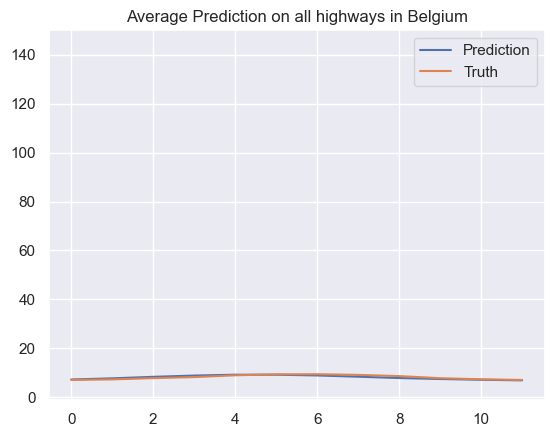

* Time step 452
* Prediction Accuracy (MAE) 2.2944405959032945
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


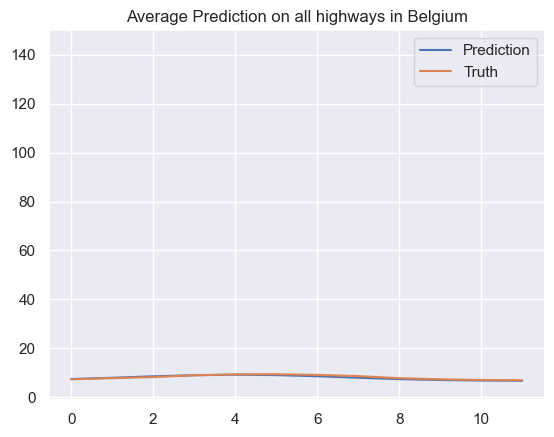

* Time step 453
* Prediction Accuracy (MAE) 2.284336071739334
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


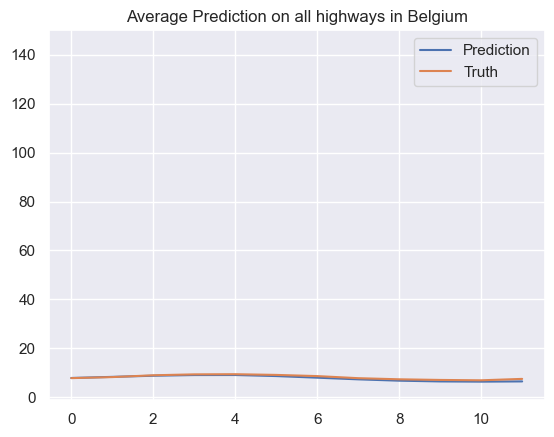

* Time step 454
* Prediction Accuracy (MAE) 2.3037877147600634
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


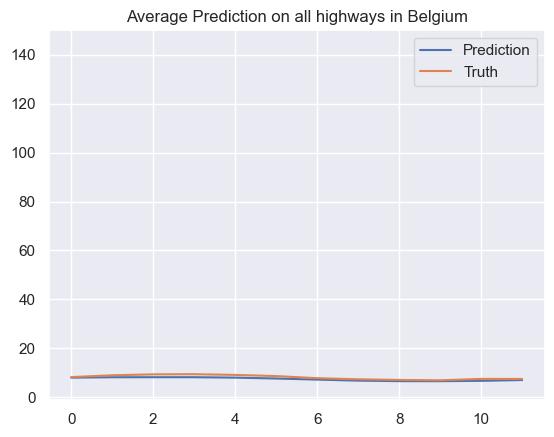

* Time step 455
* Prediction Accuracy (MAE) 2.334420819419475
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


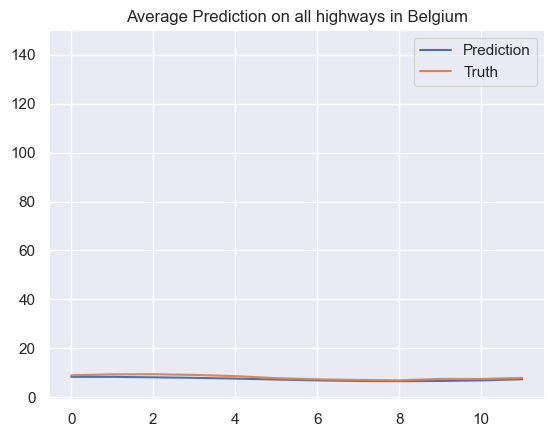

* Time step 456
* Prediction Accuracy (MAE) 2.342611963399747
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


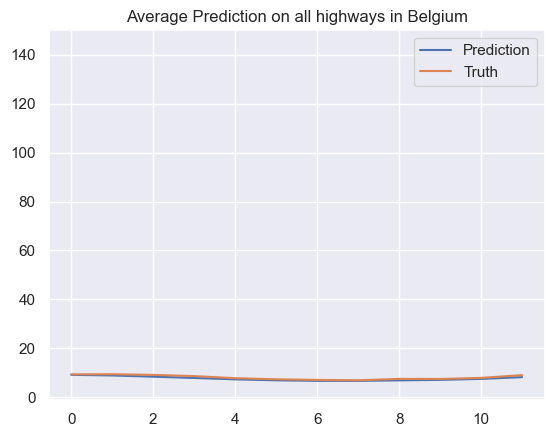

* Time step 457
* Prediction Accuracy (MAE) 2.3018895494293274
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


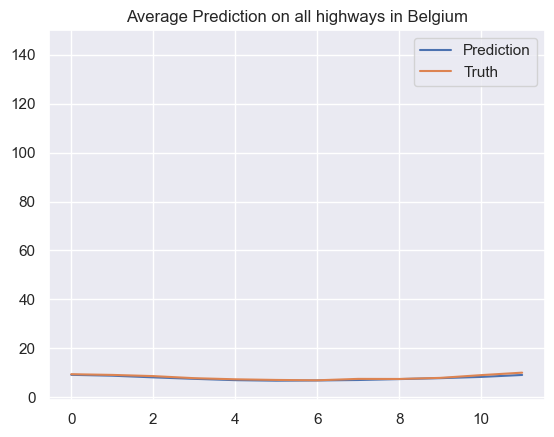

* Time step 458
* Prediction Accuracy (MAE) 2.3365227220542732
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


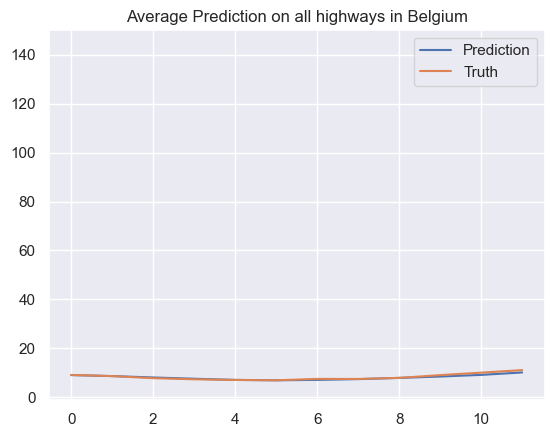

* Time step 459
* Prediction Accuracy (MAE) 2.393661369399564
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


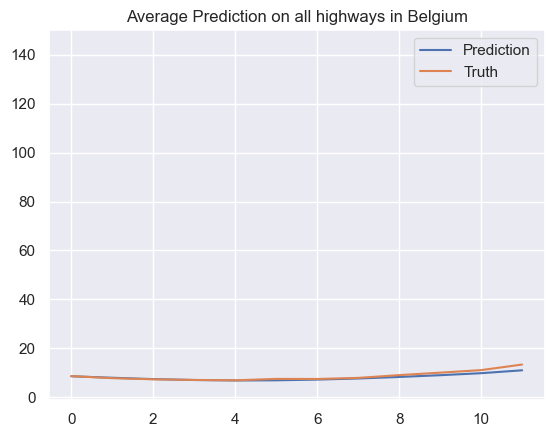

* Time step 460
* Prediction Accuracy (MAE) 2.5413140278527746
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


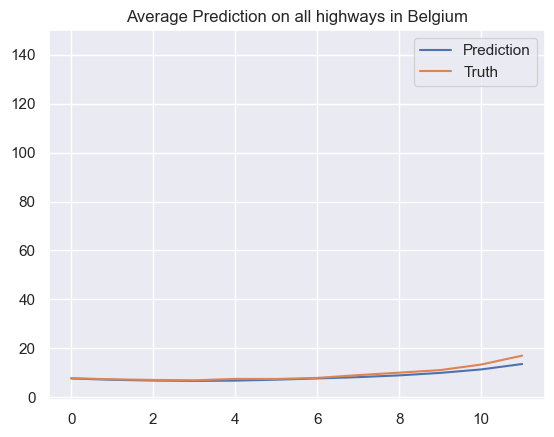

* Time step 461
* Prediction Accuracy (MAE) 2.6651607992329964
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


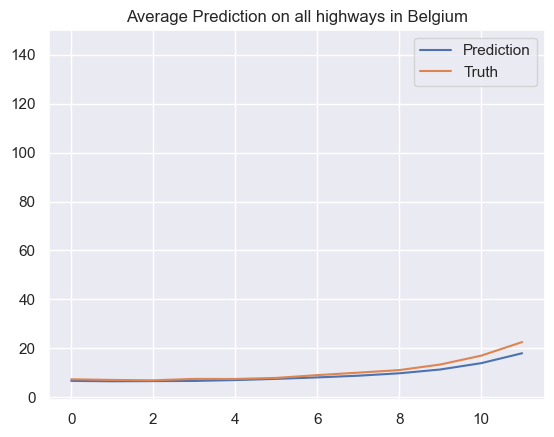

* Time step 462
* Prediction Accuracy (MAE) 2.93096197841776
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


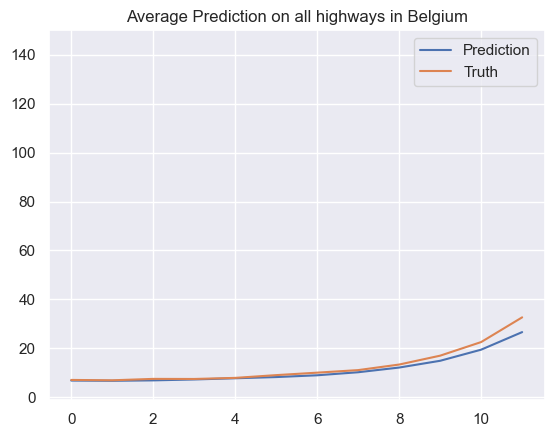

* Time step 463
* Prediction Accuracy (MAE) 3.1734467828336386
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


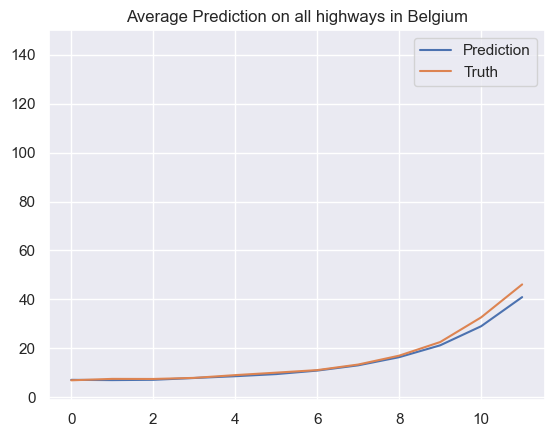

* Time step 464
* Prediction Accuracy (MAE) 3.3259716927404694
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


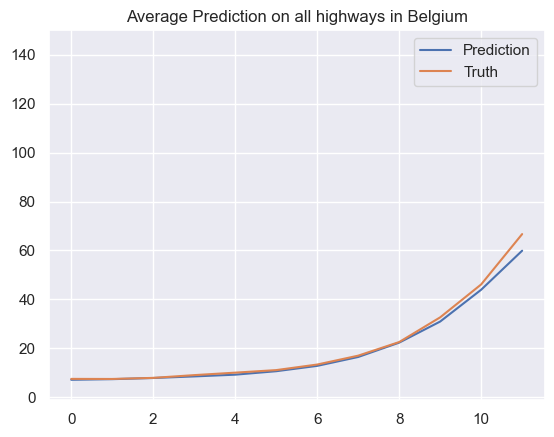

* Time step 465
* Prediction Accuracy (MAE) 3.7336954974156997
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


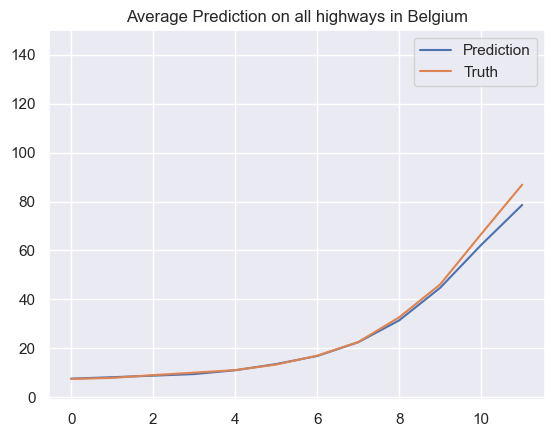

* Time step 466
* Prediction Accuracy (MAE) 4.302832548462515
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


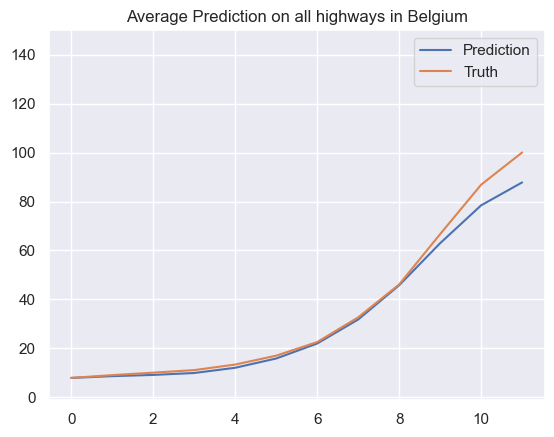

* Time step 467
* Prediction Accuracy (MAE) 5.370499364021376
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


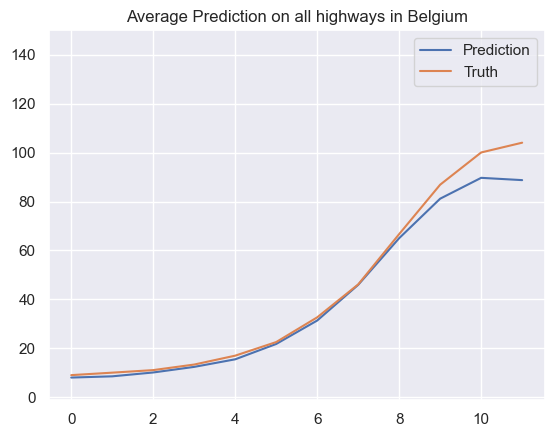

* Time step 468
* Prediction Accuracy (MAE) 6.517802475603446
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


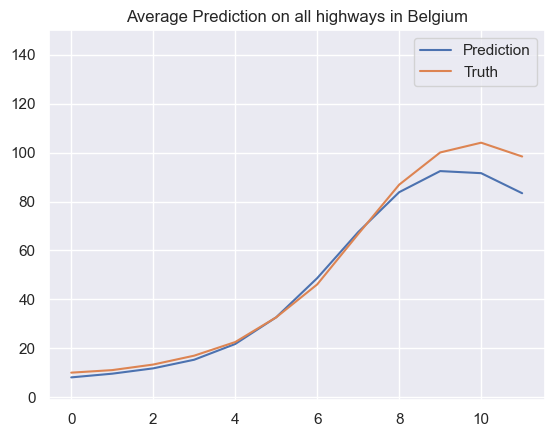

* Time step 469
* Prediction Accuracy (MAE) 7.42237601383619
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


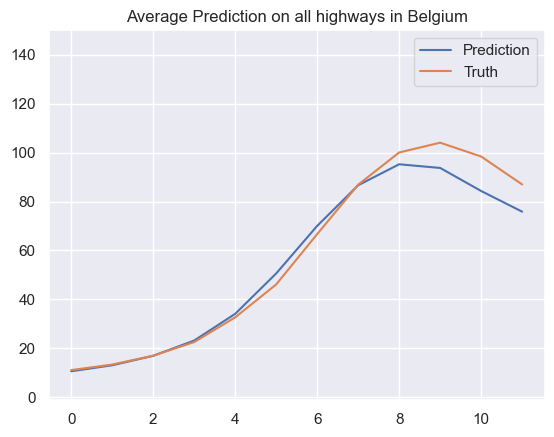

* Time step 470
* Prediction Accuracy (MAE) 8.286513007512577
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


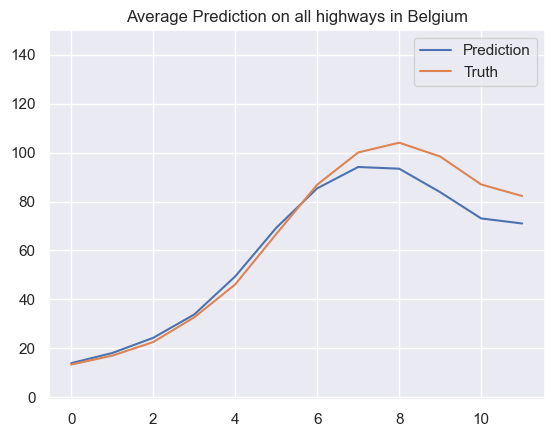

* Time step 471
* Prediction Accuracy (MAE) 9.221259375845483
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


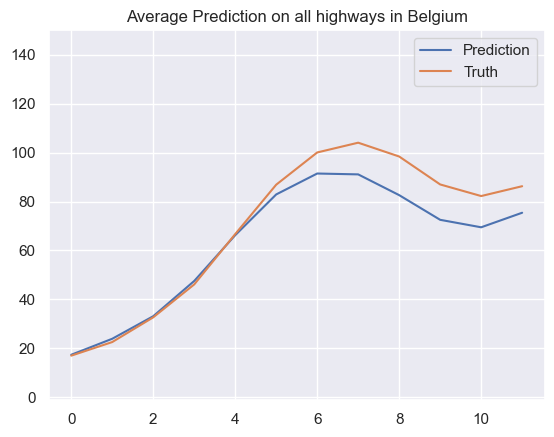

* Time step 472
* Prediction Accuracy (MAE) 10.45856632985373
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


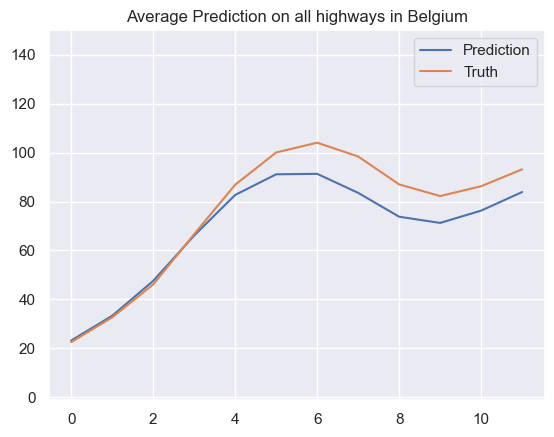

* Time step 473
* Prediction Accuracy (MAE) 10.791263828254806
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


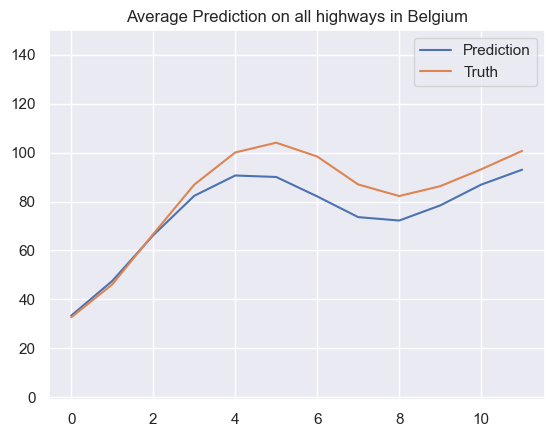

* Time step 474
* Prediction Accuracy (MAE) 11.652729308332077
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


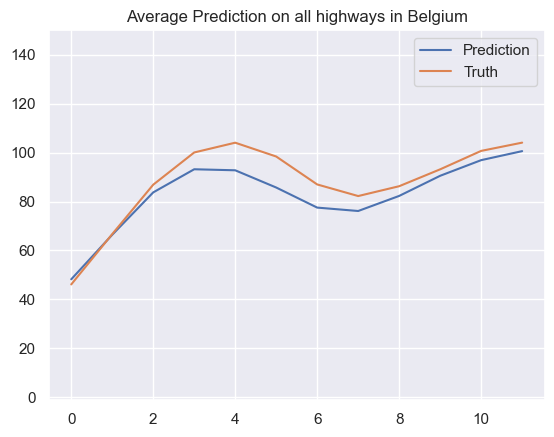

* Time step 475
* Prediction Accuracy (MAE) 10.714316917777456
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


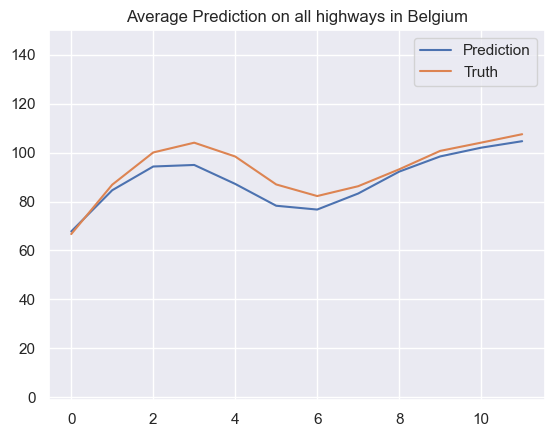

* Time step 476
* Prediction Accuracy (MAE) 10.644937857725791
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


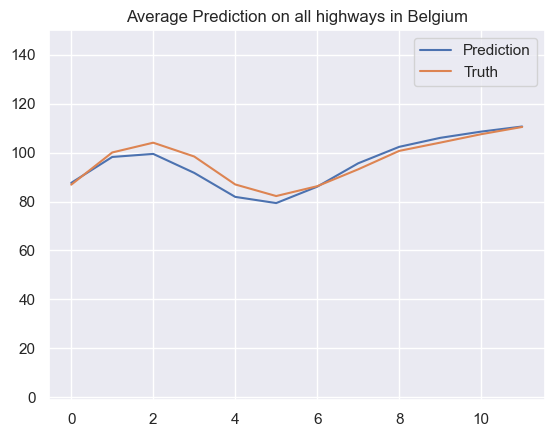

* Time step 477
* Prediction Accuracy (MAE) 10.166756231094428
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


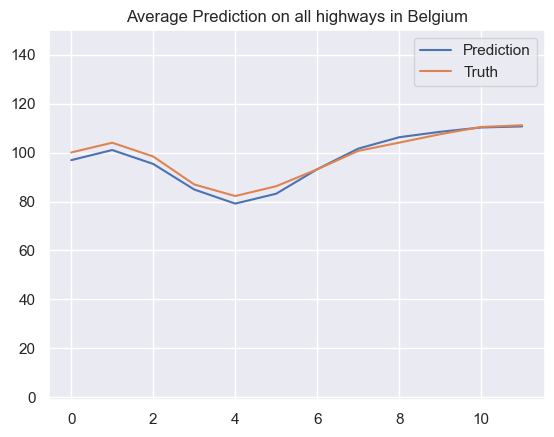

* Time step 478
* Prediction Accuracy (MAE) 9.978811822407465
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


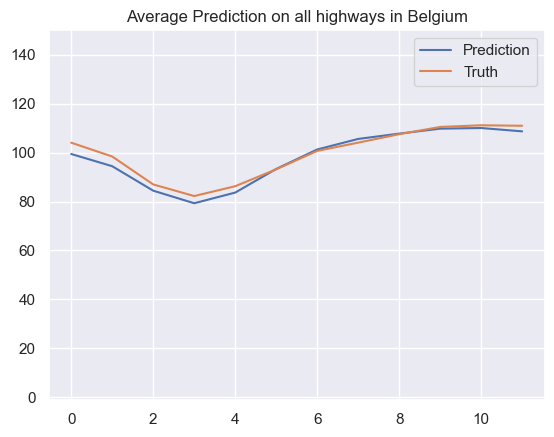

* Time step 479
* Prediction Accuracy (MAE) 10.095605755159568
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


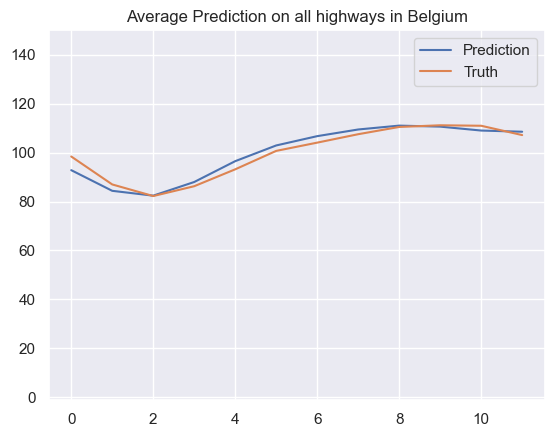

* Time step 480
* Prediction Accuracy (MAE) 10.319301313548161
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


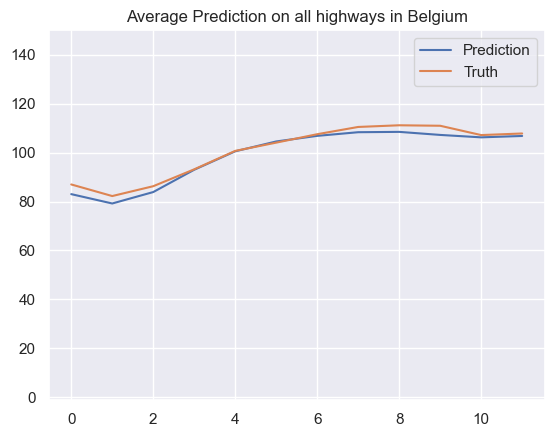

* Time step 481
* Prediction Accuracy (MAE) 10.116462283878912
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


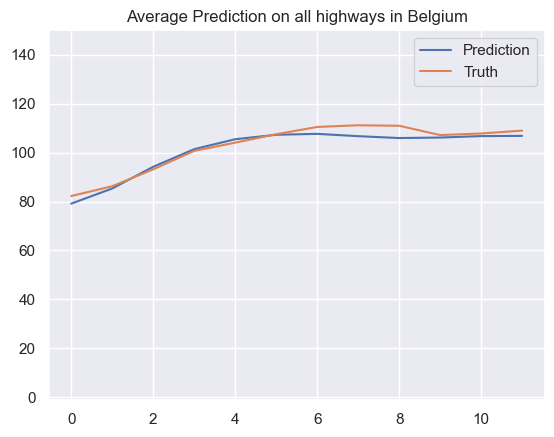

* Time step 482
* Prediction Accuracy (MAE) 10.348238046705205
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


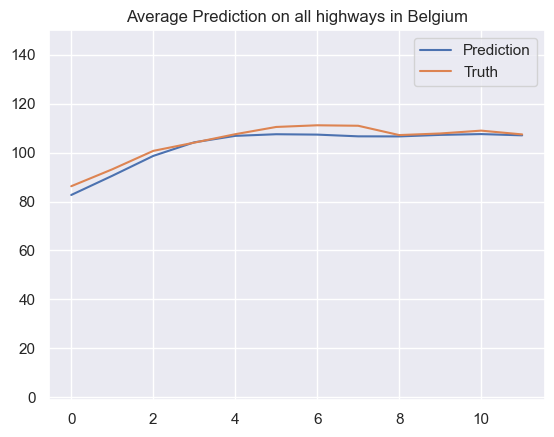

* Time step 483
* Prediction Accuracy (MAE) 10.215680292761894
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


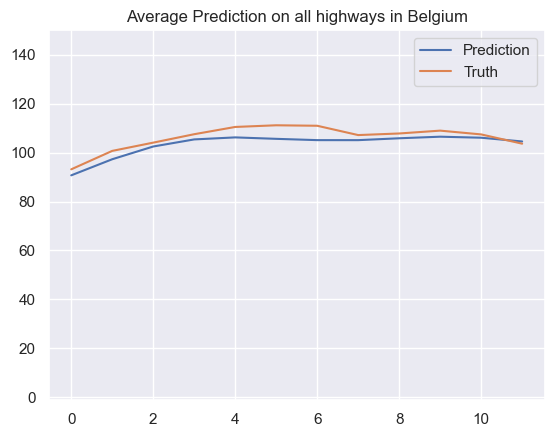

* Time step 484
* Prediction Accuracy (MAE) 10.476206077805388
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


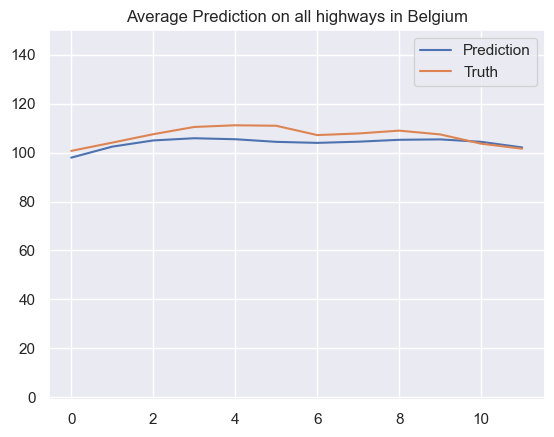

* Time step 485
* Prediction Accuracy (MAE) 10.618184356440764
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


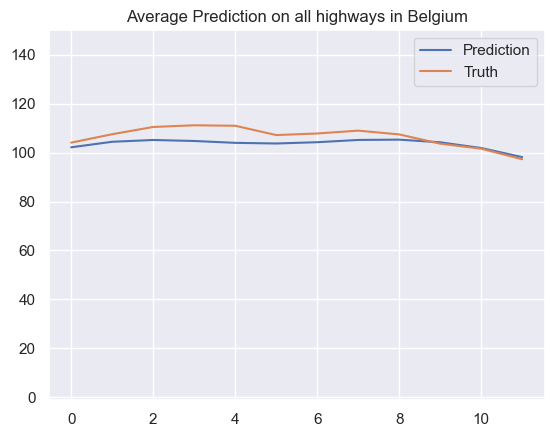

* Time step 486
* Prediction Accuracy (MAE) 10.65103944952703
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


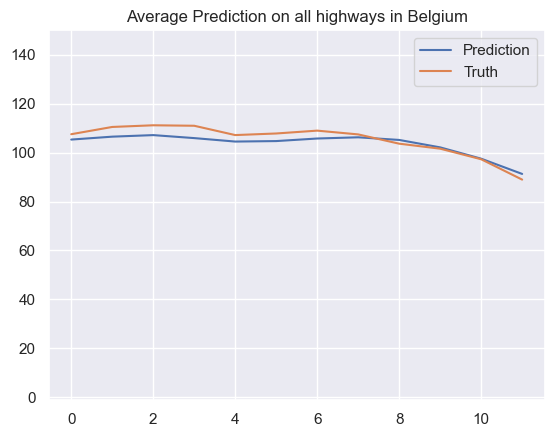

* Time step 487
* Prediction Accuracy (MAE) 10.368911350965565
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


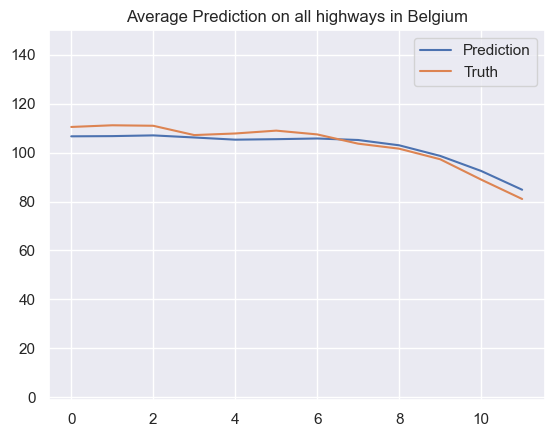

* Time step 488
* Prediction Accuracy (MAE) 10.50592697738544
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


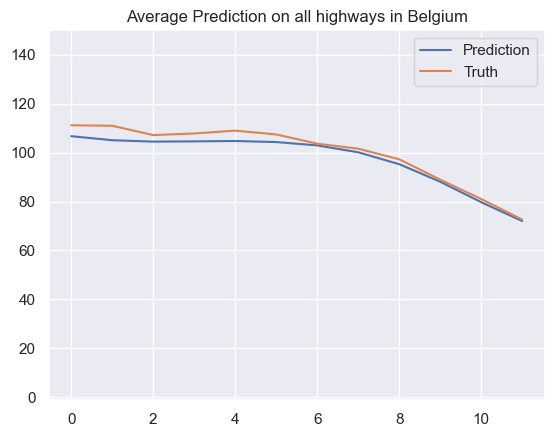

* Time step 489
* Prediction Accuracy (MAE) 10.075986398733813
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


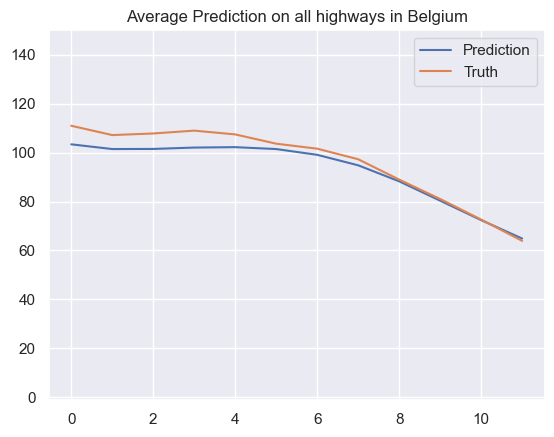

* Time step 490
* Prediction Accuracy (MAE) 10.34405490928666
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


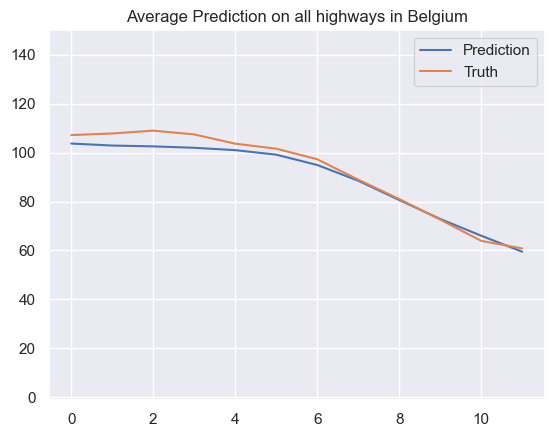

* Time step 491
* Prediction Accuracy (MAE) 9.967841956340429
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


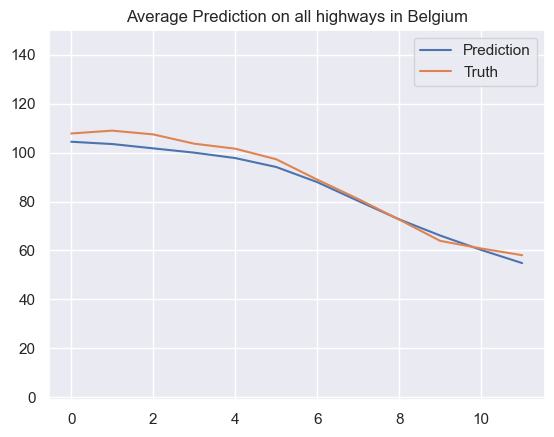

* Time step 492
* Prediction Accuracy (MAE) 9.866671741411126
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


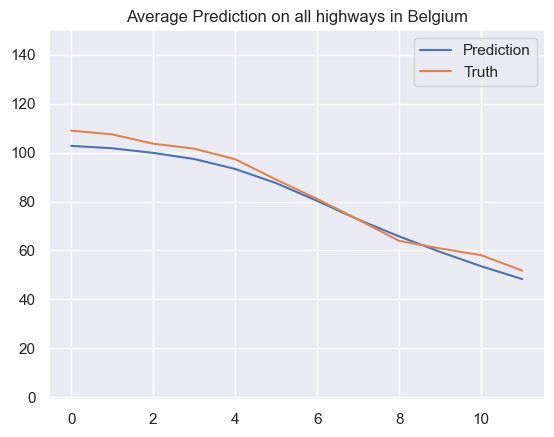

* Time step 493
* Prediction Accuracy (MAE) 9.805612920891363
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


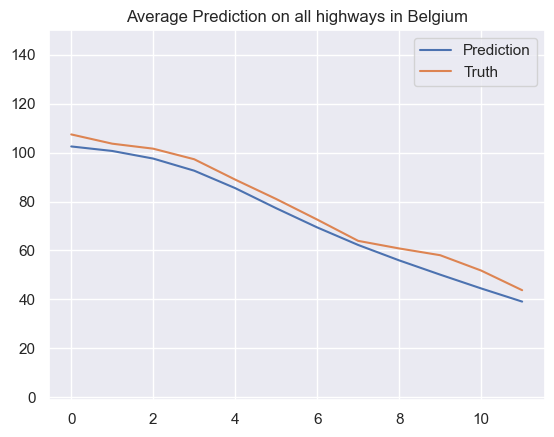

* Time step 494
* Prediction Accuracy (MAE) 9.741754283276222
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


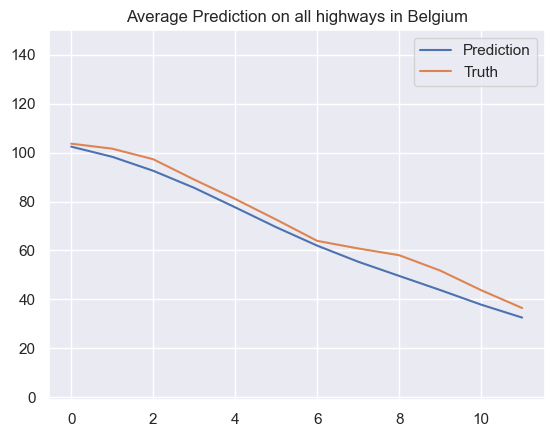

* Time step 495
* Prediction Accuracy (MAE) 9.57499020740751
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


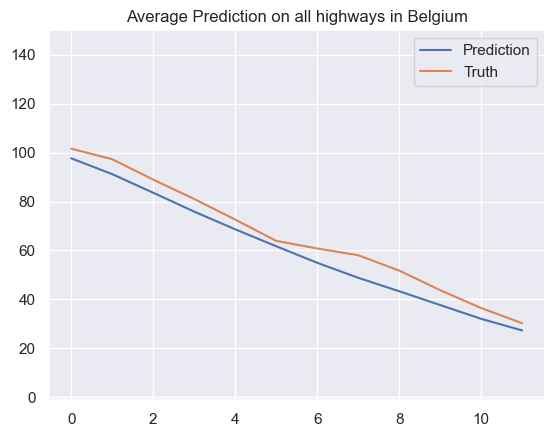

* Time step 496
* Prediction Accuracy (MAE) 9.360331208502856
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


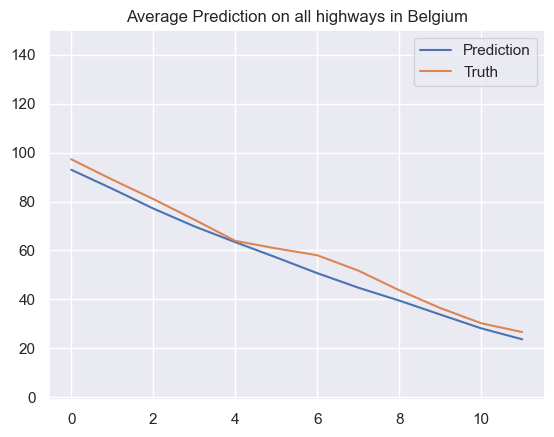

* Time step 497
* Prediction Accuracy (MAE) 8.35264176493791
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


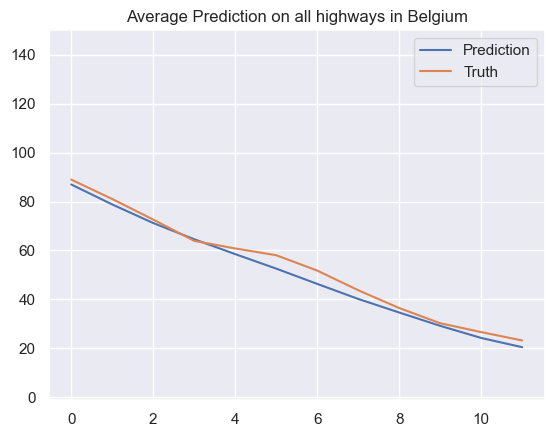

* Time step 498
* Prediction Accuracy (MAE) 7.574798295943841
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


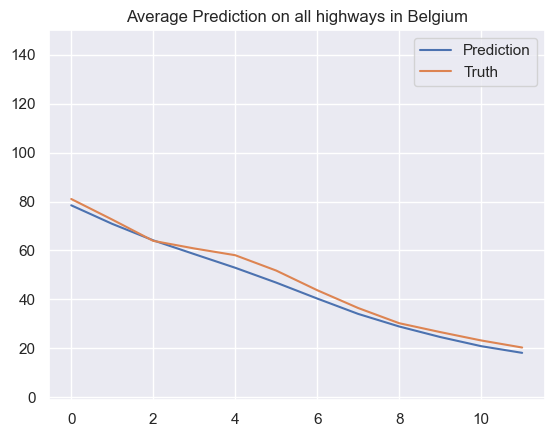

* Time step 499
* Prediction Accuracy (MAE) 7.08237666920344
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


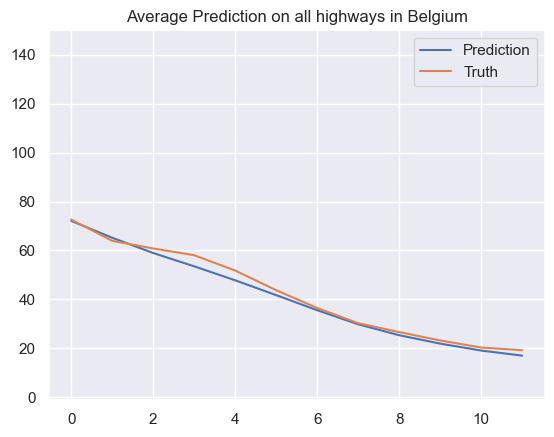

* Time step 500
* Prediction Accuracy (MAE) 6.516710691740518
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


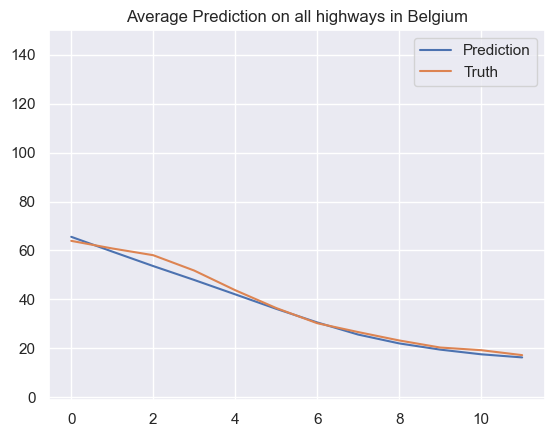

* Time step 501
* Prediction Accuracy (MAE) 6.0265389533593705
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


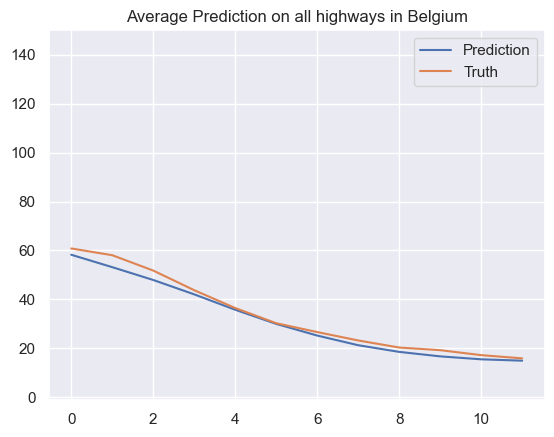

* Time step 502
* Prediction Accuracy (MAE) 5.659074556448978
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


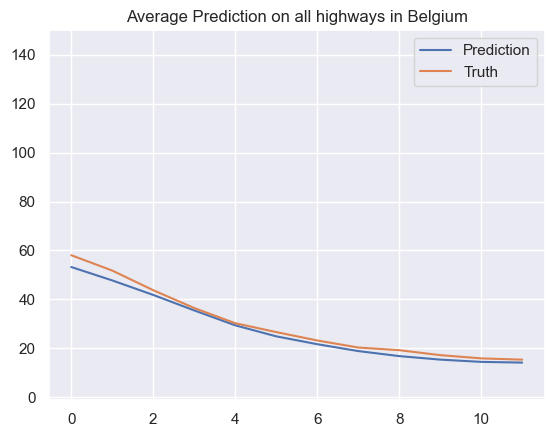

* Time step 503
* Prediction Accuracy (MAE) 5.096237888952601
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


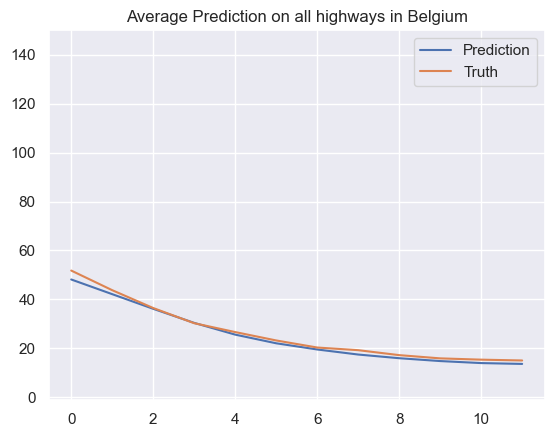

* Time step 504
* Prediction Accuracy (MAE) 4.529450097523176
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


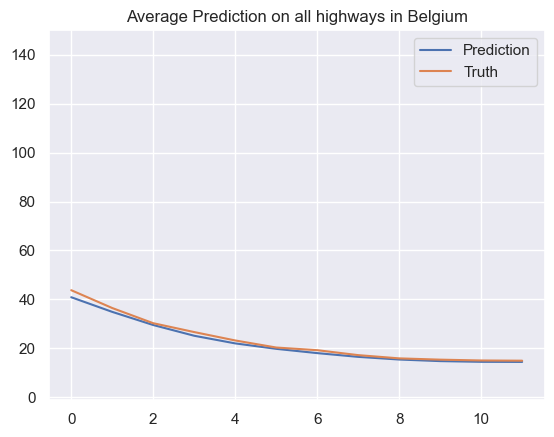

* Time step 505
* Prediction Accuracy (MAE) 3.9919438174225577
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


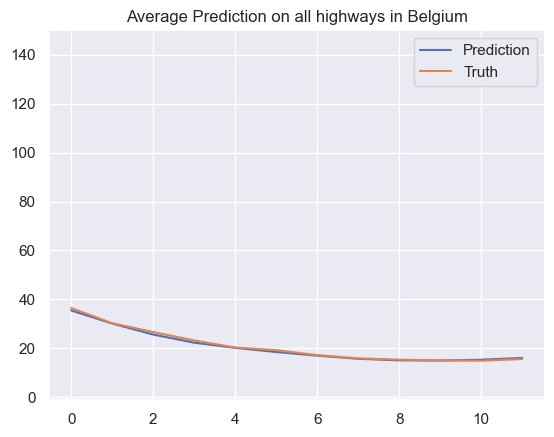

* Time step 506
* Prediction Accuracy (MAE) 3.6681950120147717
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


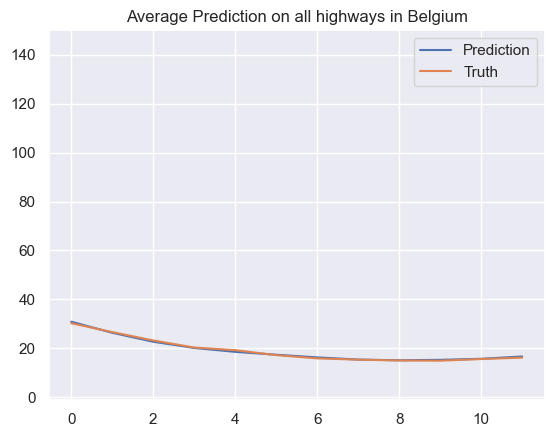

* Time step 507
* Prediction Accuracy (MAE) 3.5532635518201103
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


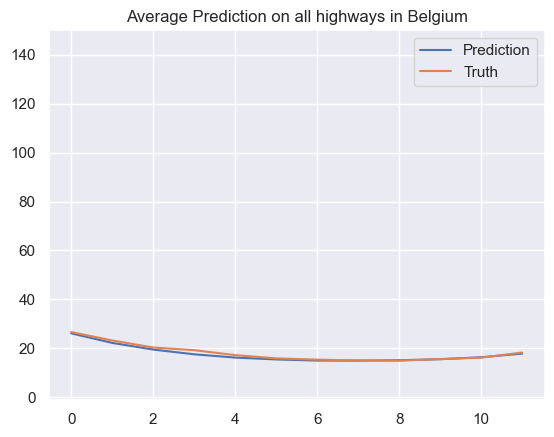

* Time step 508
* Prediction Accuracy (MAE) 3.5056523065319416
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


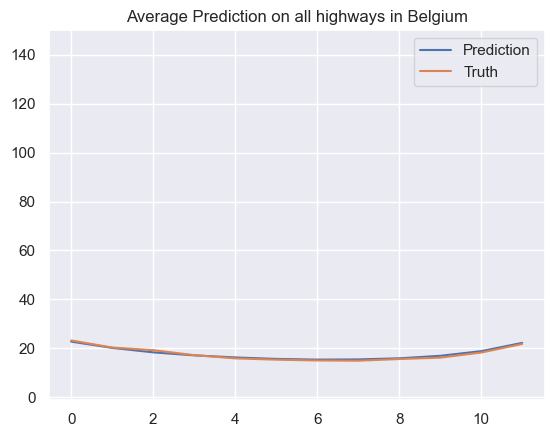

* Time step 509
* Prediction Accuracy (MAE) 3.4436388556436417
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


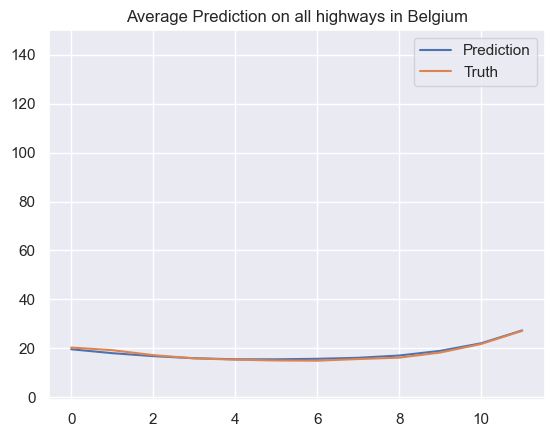

* Time step 510
* Prediction Accuracy (MAE) 3.4331712043676927
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


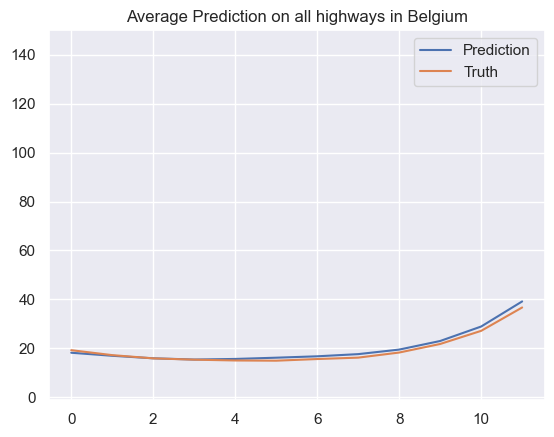

* Time step 511
* Prediction Accuracy (MAE) 3.641553786221061
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


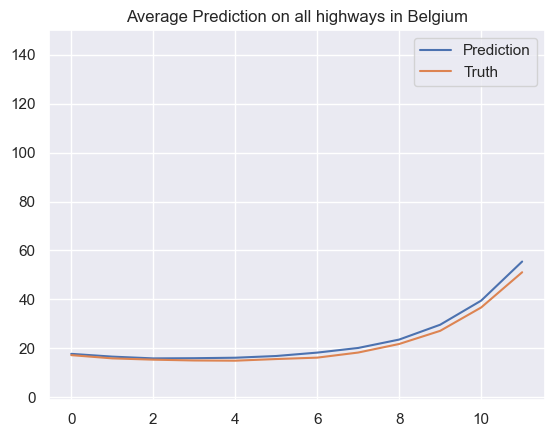

* Time step 512
* Prediction Accuracy (MAE) 3.977162000741545
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


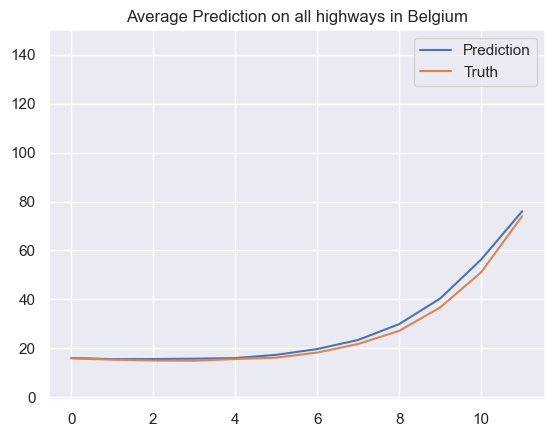

* Time step 513
* Prediction Accuracy (MAE) 4.390935656383882
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


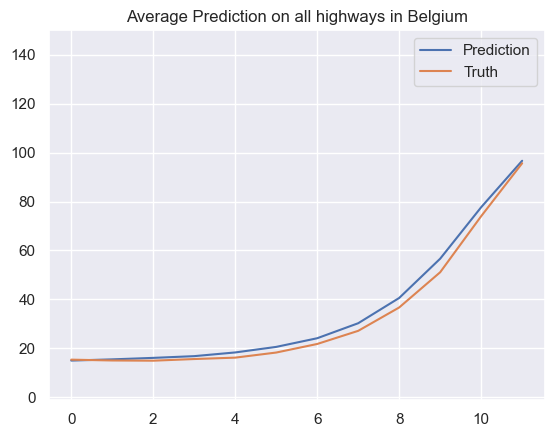

* Time step 514
* Prediction Accuracy (MAE) 5.111257163514672
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


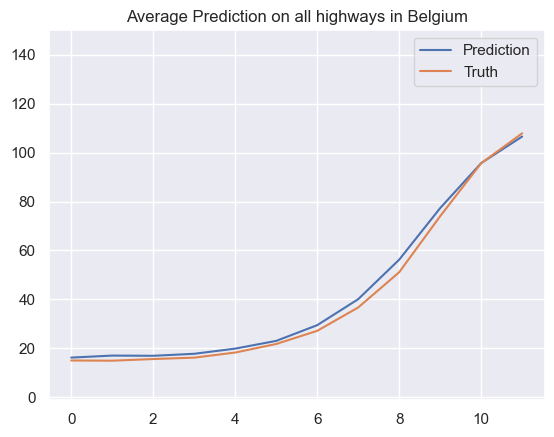

* Time step 515
* Prediction Accuracy (MAE) 5.469140516923752
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


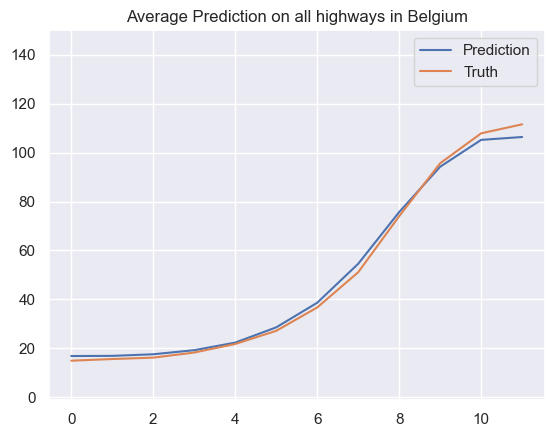

* Time step 516
* Prediction Accuracy (MAE) 6.005010290141591
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


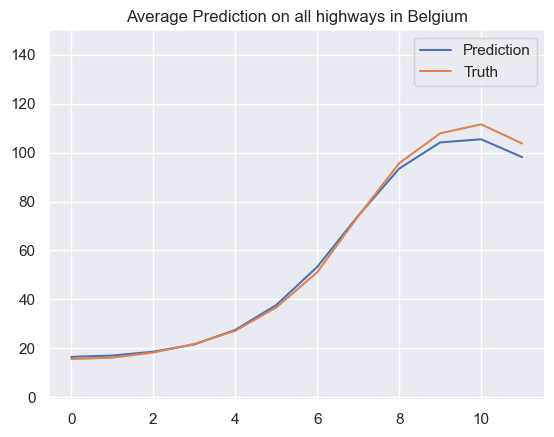

* Time step 517
* Prediction Accuracy (MAE) 6.488560901581493
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


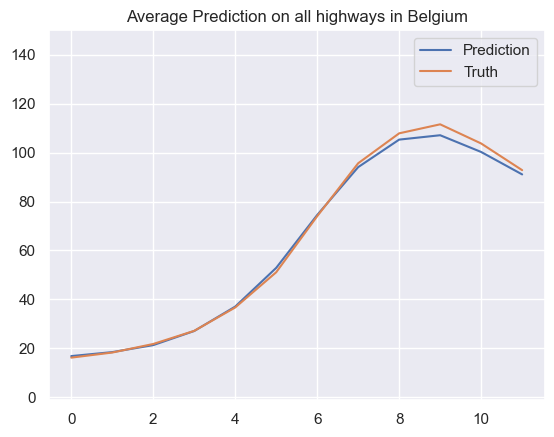

* Time step 518
* Prediction Accuracy (MAE) 6.687361286722969
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


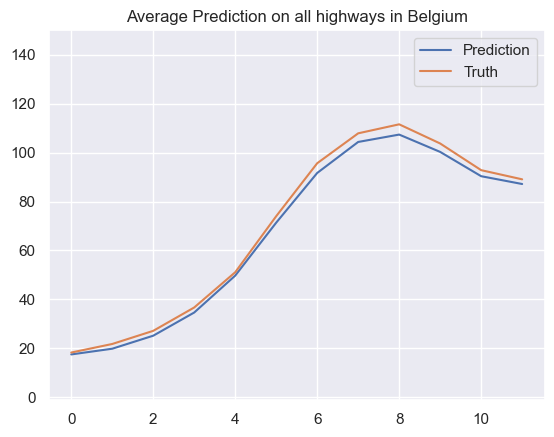

* Time step 519
* Prediction Accuracy (MAE) 7.246551866355317
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


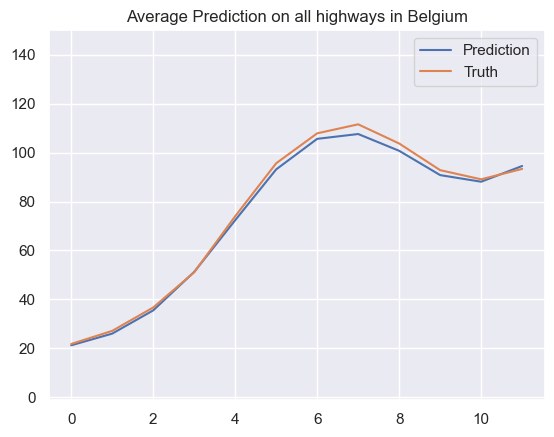

* Time step 520
* Prediction Accuracy (MAE) 7.605824790291238
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


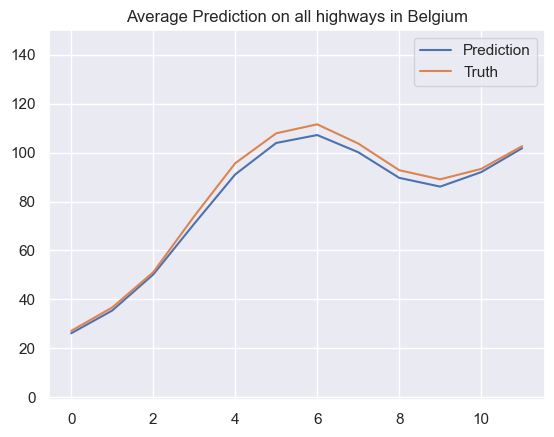

* Time step 521
* Prediction Accuracy (MAE) 8.288642671788487
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


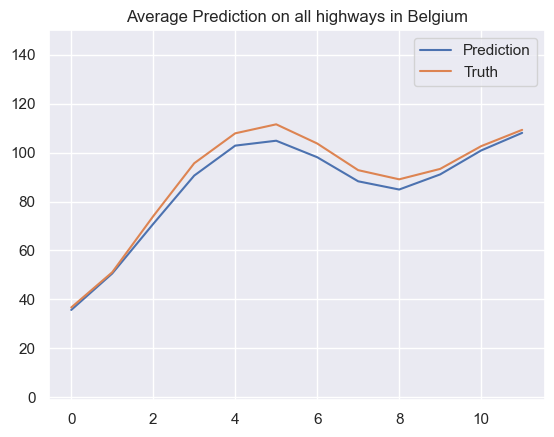

* Time step 522
* Prediction Accuracy (MAE) 9.365685566263583
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


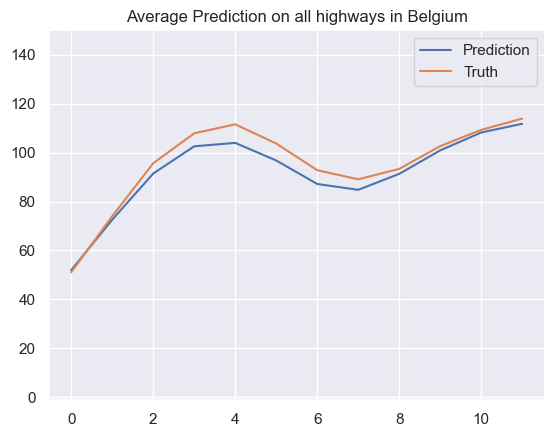

* Time step 523
* Prediction Accuracy (MAE) 9.91233542325661
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


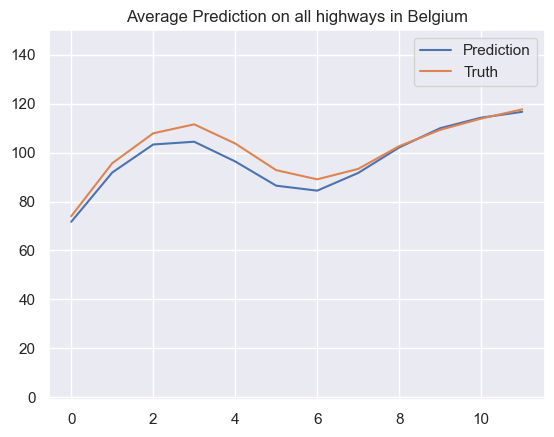

* Time step 524
* Prediction Accuracy (MAE) 10.435506207936015
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


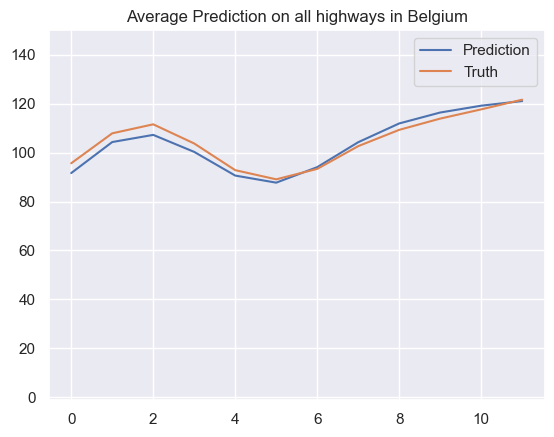

* Time step 525
* Prediction Accuracy (MAE) 10.156234543336774
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


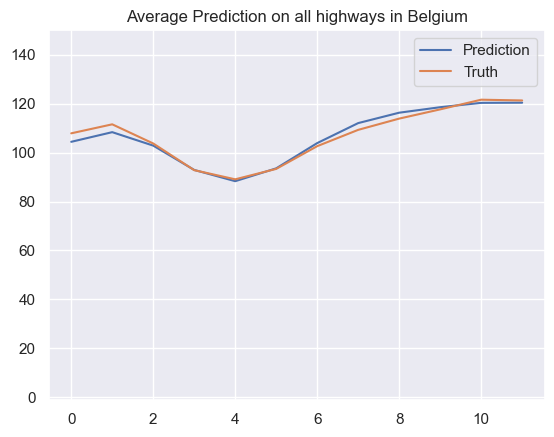

* Time step 526
* Prediction Accuracy (MAE) 10.117953531902762
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


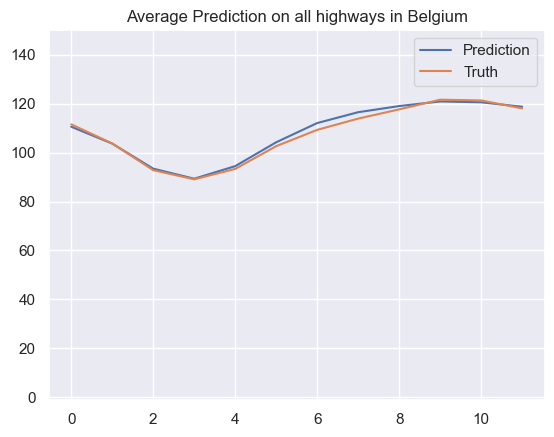

* Time step 527
* Prediction Accuracy (MAE) 10.173298615480022
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


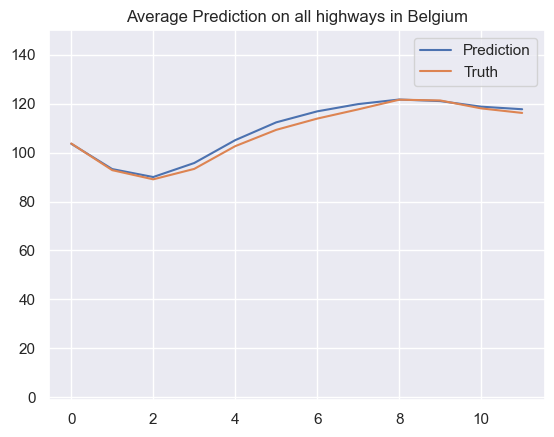

* Time step 528
* Prediction Accuracy (MAE) 10.337026924152658
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


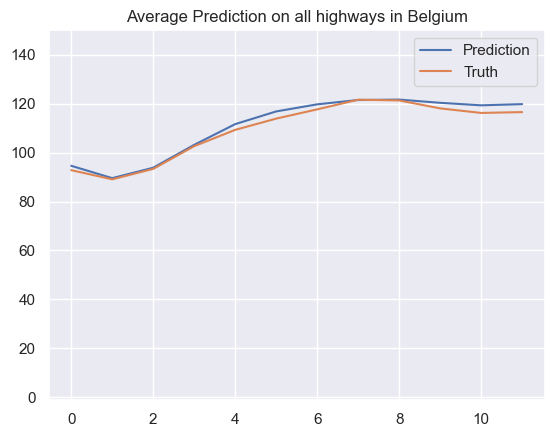

* Time step 529
* Prediction Accuracy (MAE) 10.548138690447653
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


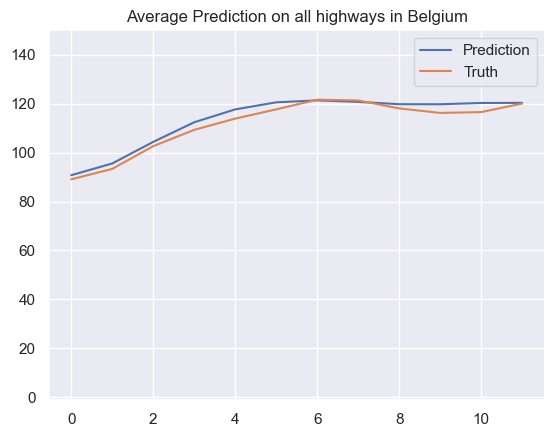

* Time step 530
* Prediction Accuracy (MAE) 10.921269870064107
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


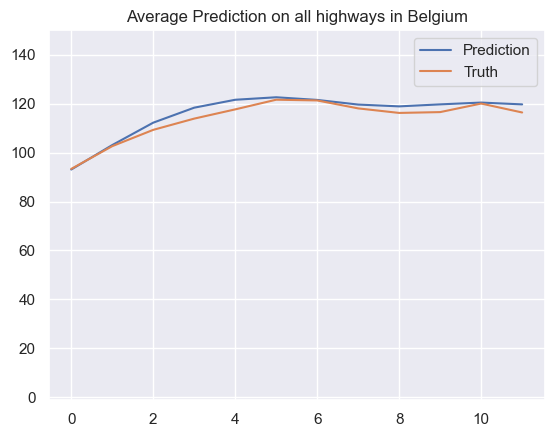

* Time step 531
* Prediction Accuracy (MAE) 11.116483165780853
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


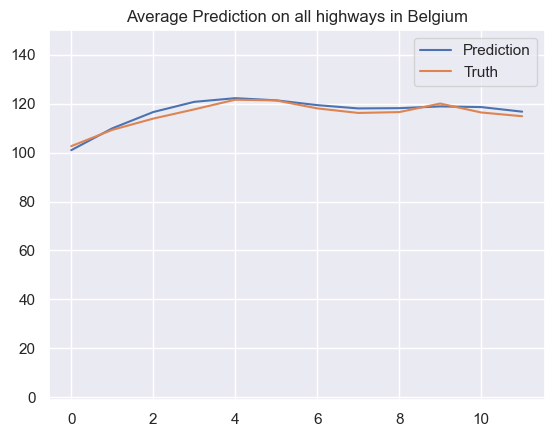

* Time step 532
* Prediction Accuracy (MAE) 11.175074227063275
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


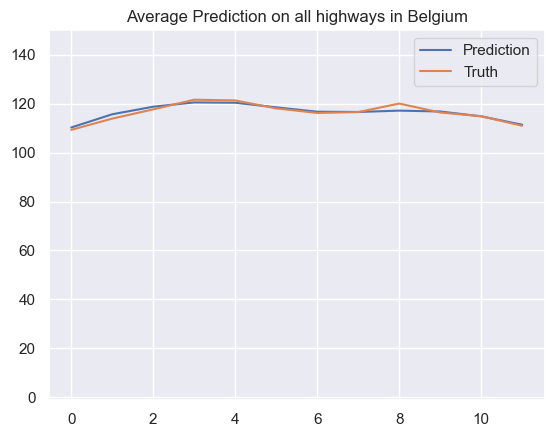

* Time step 533
* Prediction Accuracy (MAE) 11.146663214958286
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


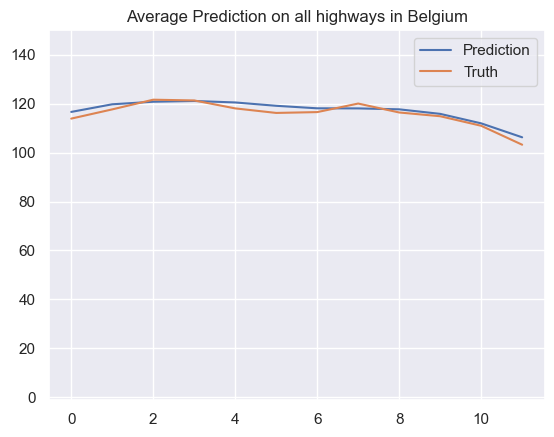

* Time step 534
* Prediction Accuracy (MAE) 11.256569270534934
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


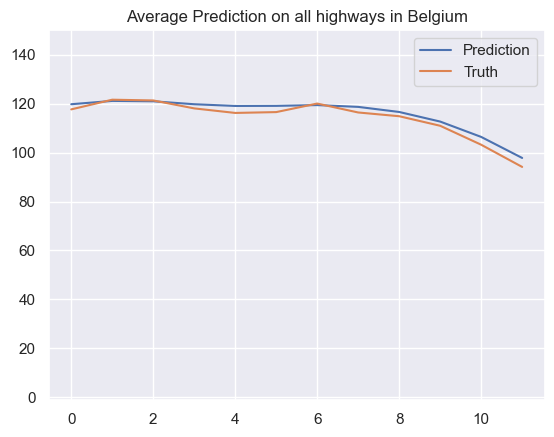

* Time step 535
* Prediction Accuracy (MAE) 11.261630976145895
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


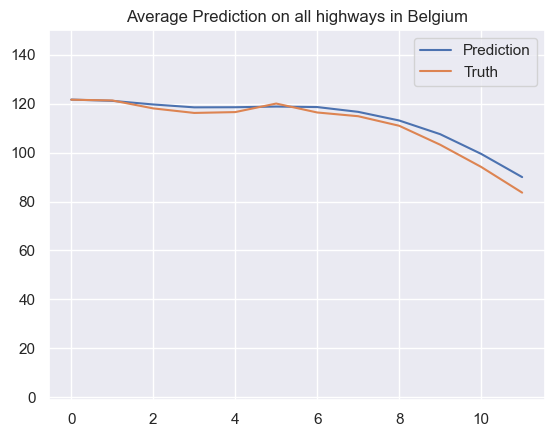

* Time step 536
* Prediction Accuracy (MAE) 11.366968295696555
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


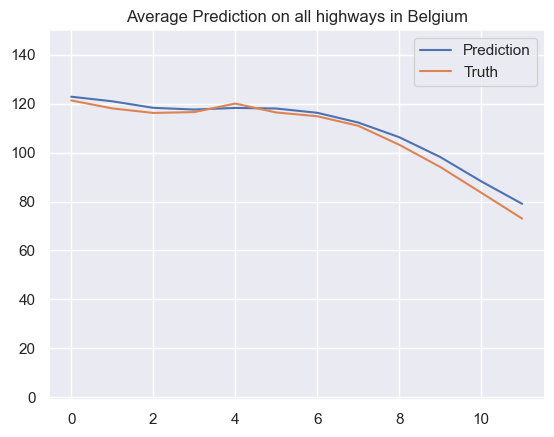

* Time step 537
* Prediction Accuracy (MAE) 11.18111202340865
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


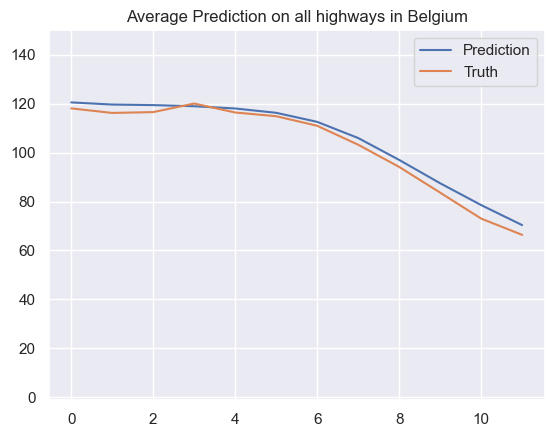

* Time step 538
* Prediction Accuracy (MAE) 11.09550808566586
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


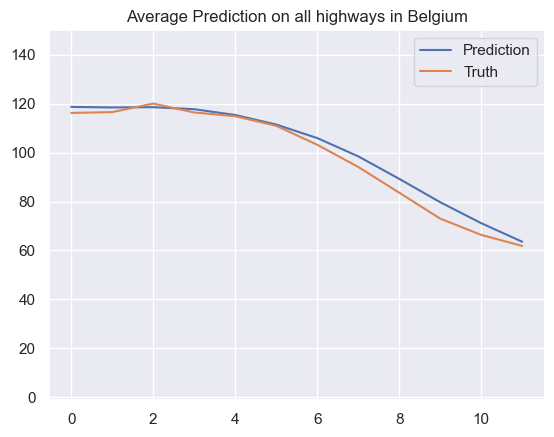

* Time step 539
* Prediction Accuracy (MAE) 11.541568185085127
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


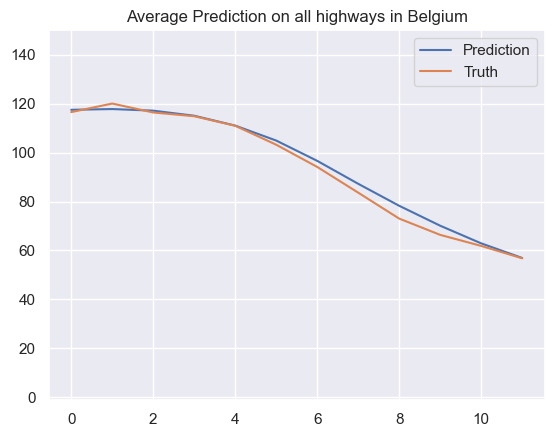

* Time step 540
* Prediction Accuracy (MAE) 10.956032003126989
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


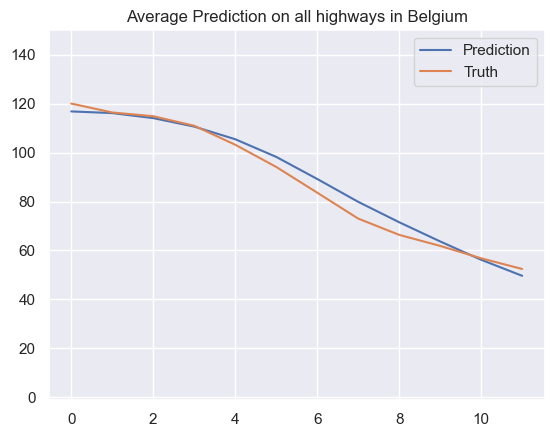

* Time step 541
* Prediction Accuracy (MAE) 11.11848125190882
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


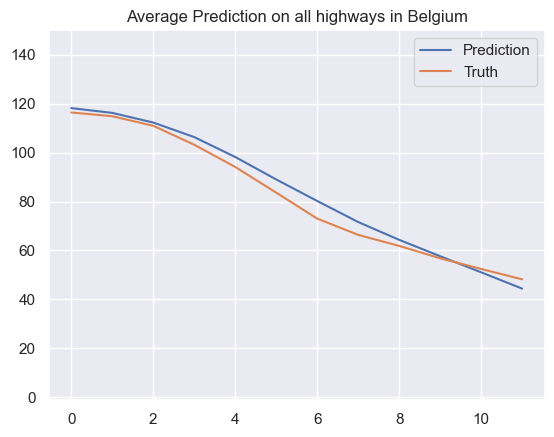

* Time step 542
* Prediction Accuracy (MAE) 10.766958016697842
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


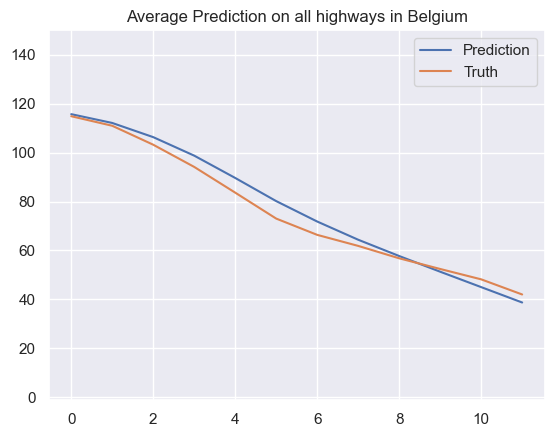

* Time step 543
* Prediction Accuracy (MAE) 10.526603877546298
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


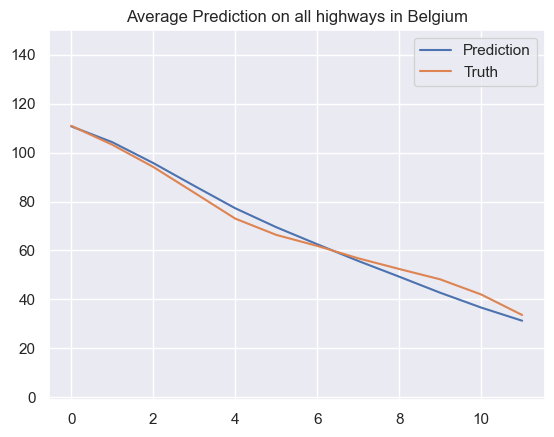

* Time step 544
* Prediction Accuracy (MAE) 9.710342659734053
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


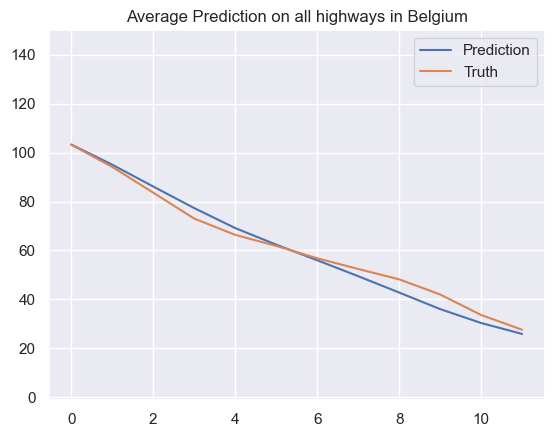

* Time step 545
* Prediction Accuracy (MAE) 9.235689310417323
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


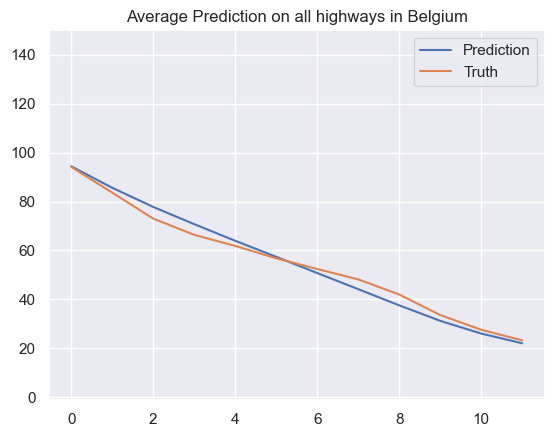

* Time step 546
* Prediction Accuracy (MAE) 8.508402546490915
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


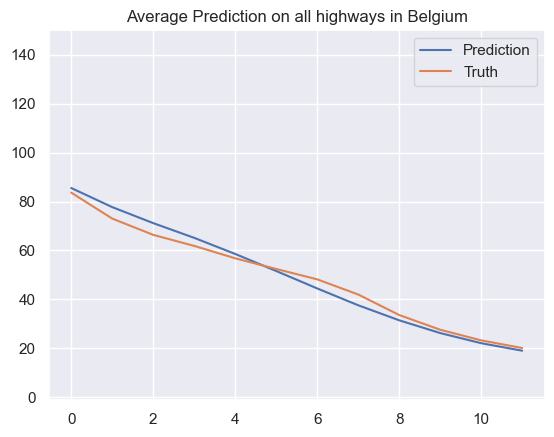

* Time step 547
* Prediction Accuracy (MAE) 7.915469335142838
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


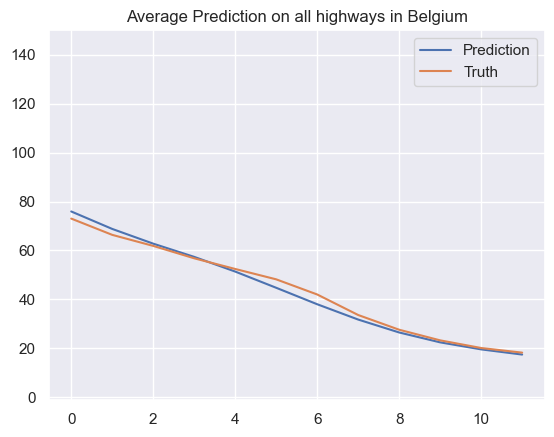

* Time step 548
* Prediction Accuracy (MAE) 7.122756805194248
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


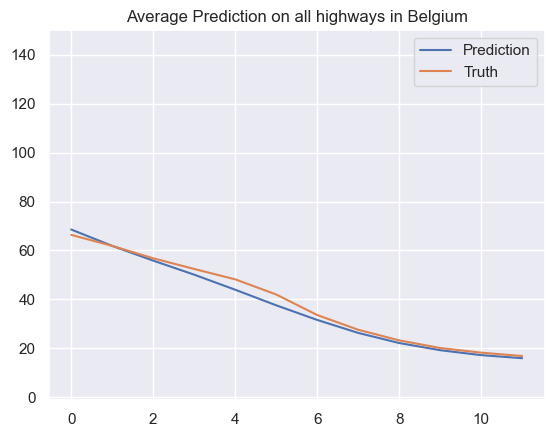

* Time step 549
* Prediction Accuracy (MAE) 6.575573530436242
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


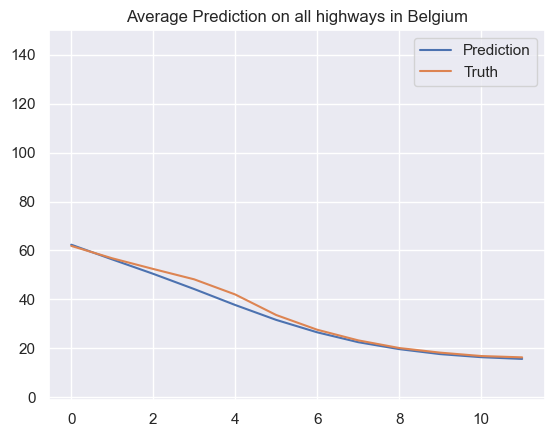

* Time step 550
* Prediction Accuracy (MAE) 6.008741333656099
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


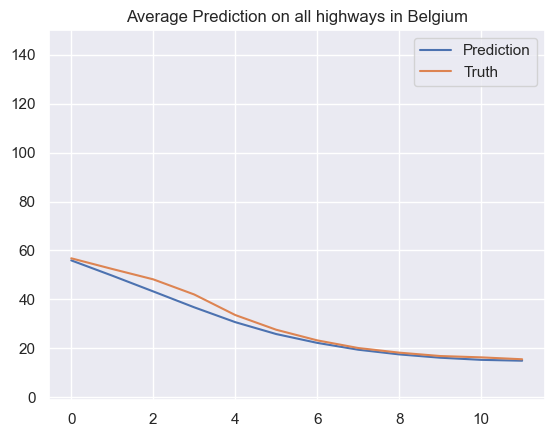

* Time step 551
* Prediction Accuracy (MAE) 5.501465956744616
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


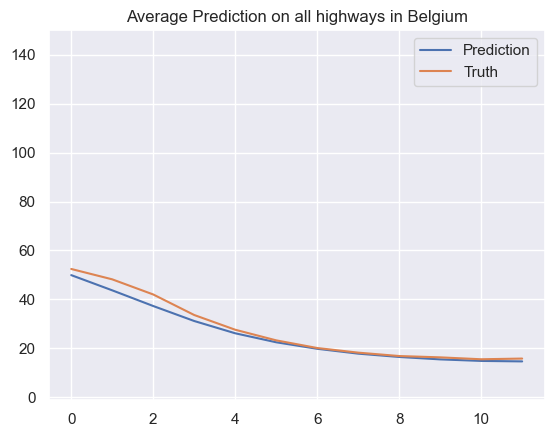

* Time step 552
* Prediction Accuracy (MAE) 4.914883383568801
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


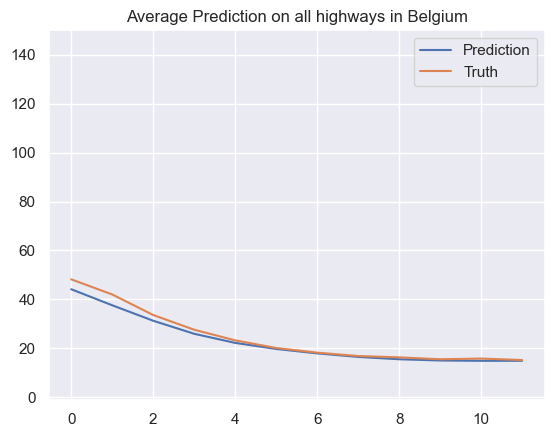

* Time step 553
* Prediction Accuracy (MAE) 4.503269196213135
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


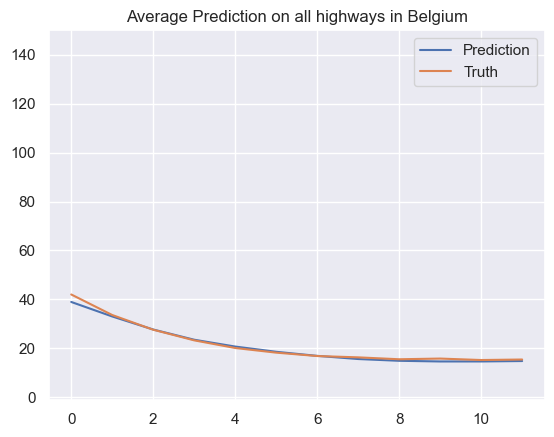

* Time step 554
* Prediction Accuracy (MAE) 3.974425068711944
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


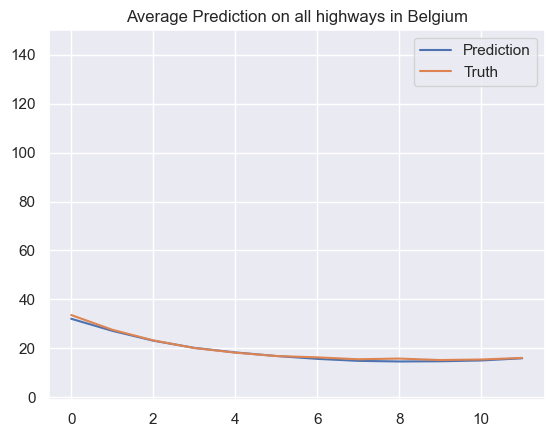

* Time step 555
* Prediction Accuracy (MAE) 3.604975939761428
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


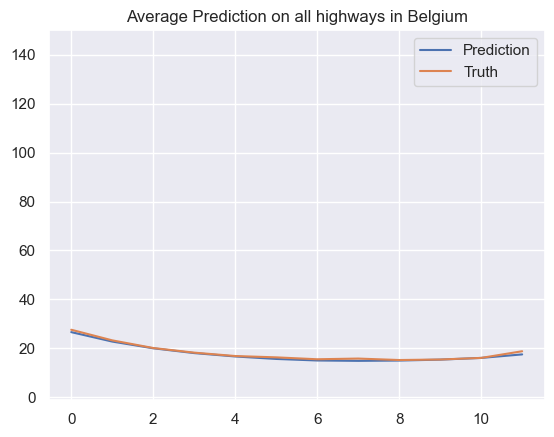

* Time step 556
* Prediction Accuracy (MAE) 3.3510082249041715
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


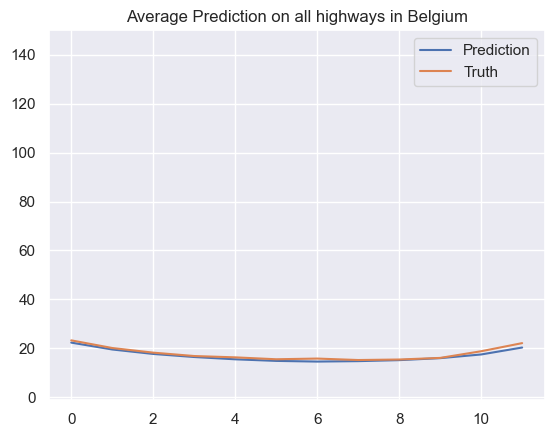

* Time step 557
* Prediction Accuracy (MAE) 3.3354908632504645
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


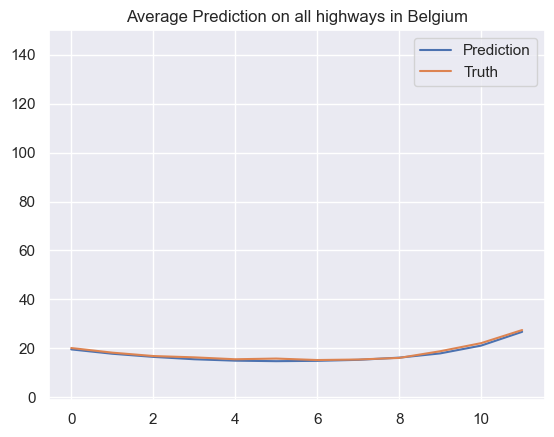

* Time step 558
* Prediction Accuracy (MAE) 3.3495836901740534
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


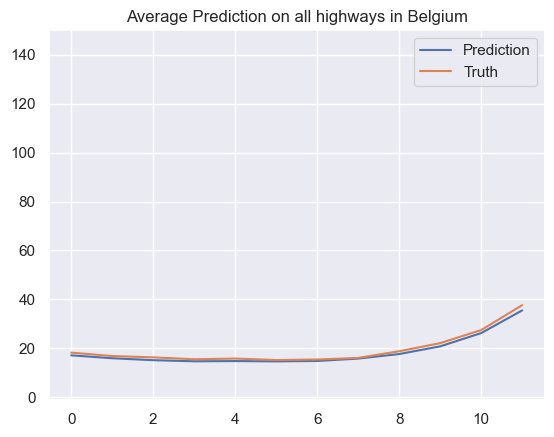

* Time step 559
* Prediction Accuracy (MAE) 3.532481790232432
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


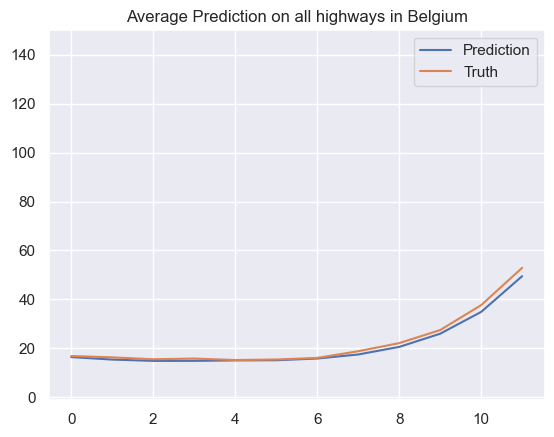

* Time step 560
* Prediction Accuracy (MAE) 3.7349029903320146
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


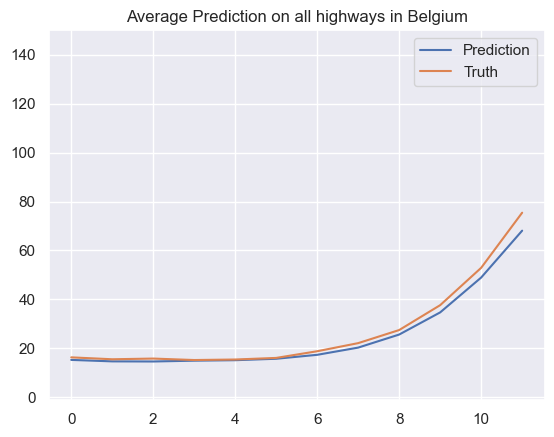

* Time step 561
* Prediction Accuracy (MAE) 4.302152231354137
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


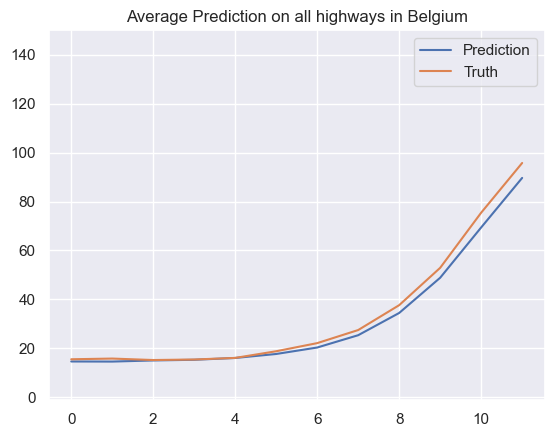

* Time step 562
* Prediction Accuracy (MAE) 4.783464745237295
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


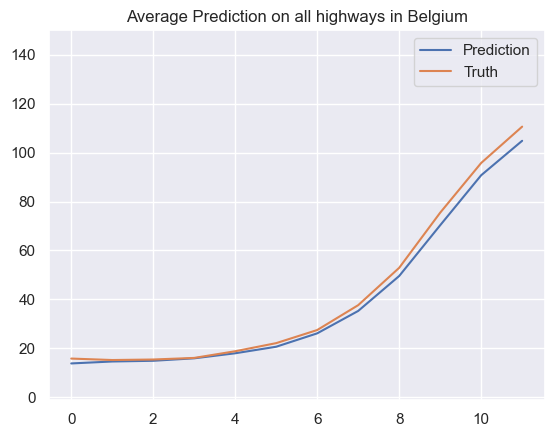

* Time step 563
* Prediction Accuracy (MAE) 5.277888658962375
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


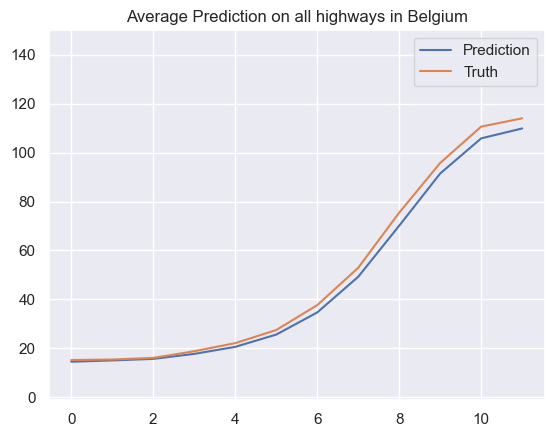

* Time step 564
* Prediction Accuracy (MAE) 5.887096267841354
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


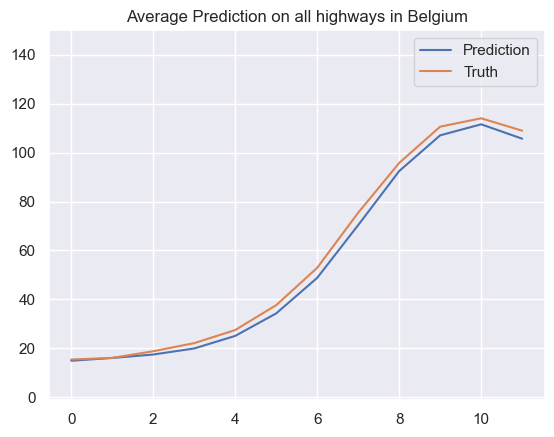

* Time step 565
* Prediction Accuracy (MAE) 6.4761398994785795
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


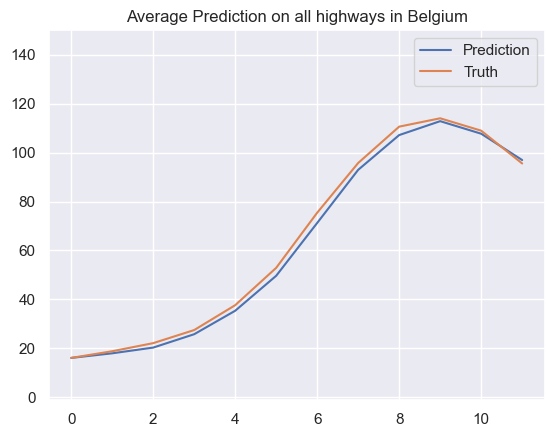

* Time step 566
* Prediction Accuracy (MAE) 6.930121546653558
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


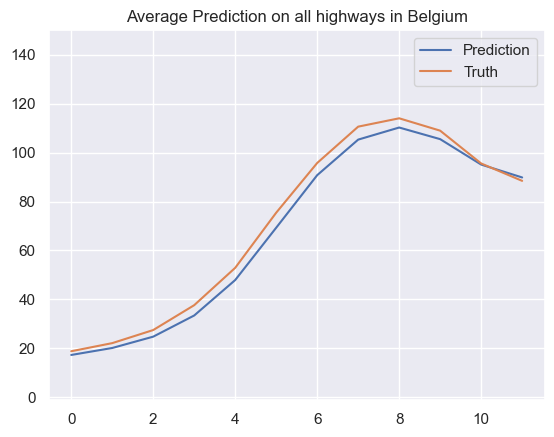

* Time step 567
* Prediction Accuracy (MAE) 8.17796824034921
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


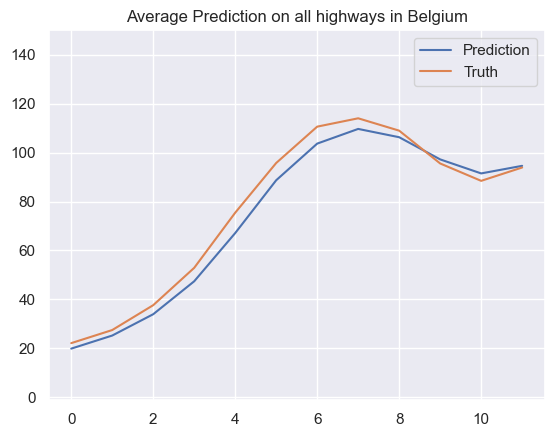

* Time step 568
* Prediction Accuracy (MAE) 9.507456913741818
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


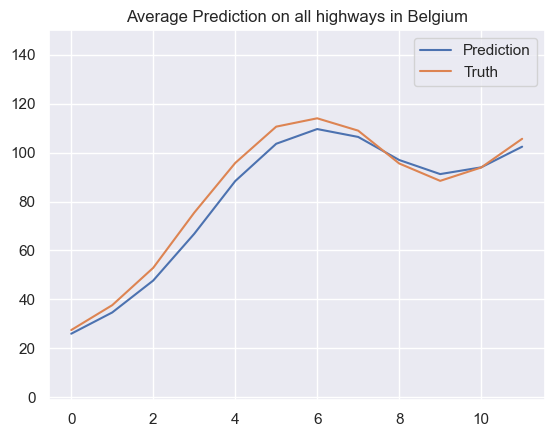

* Time step 569
* Prediction Accuracy (MAE) 10.325077630345389
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


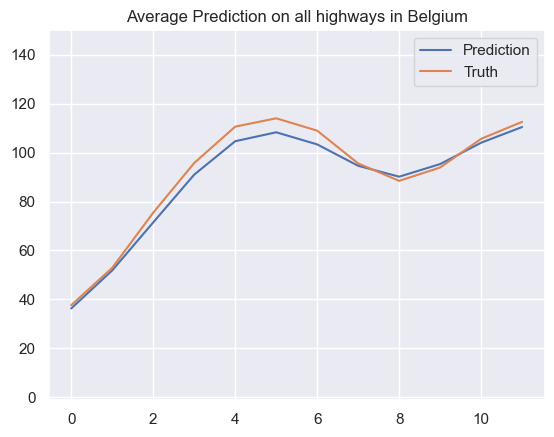

* Time step 570
* Prediction Accuracy (MAE) 10.404048830634771
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


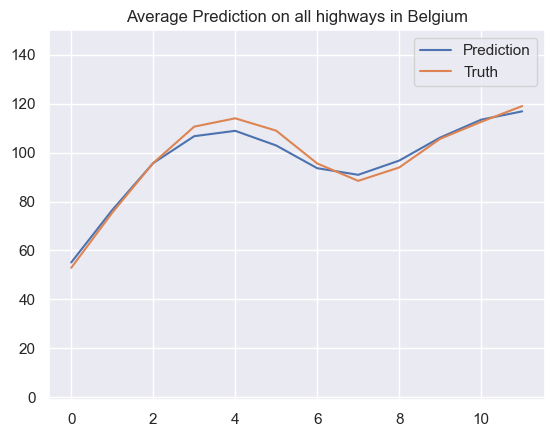

* Time step 571
* Prediction Accuracy (MAE) 10.938561416298992
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


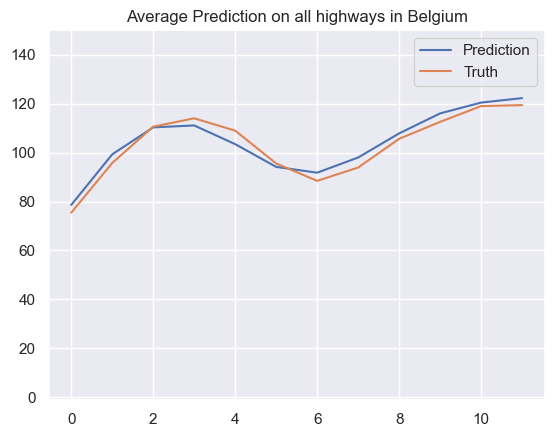

* Time step 572
* Prediction Accuracy (MAE) 11.524384561486324
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


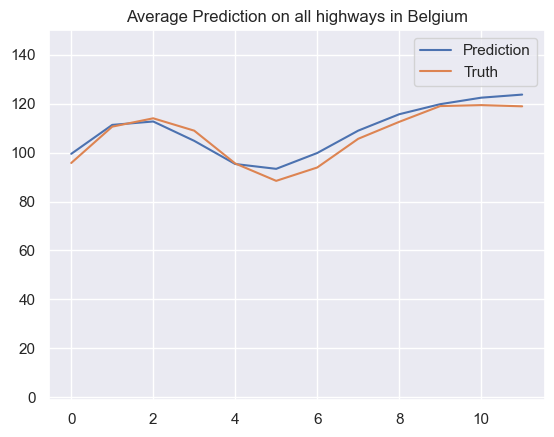

* Time step 573
* Prediction Accuracy (MAE) 11.927761495442226
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


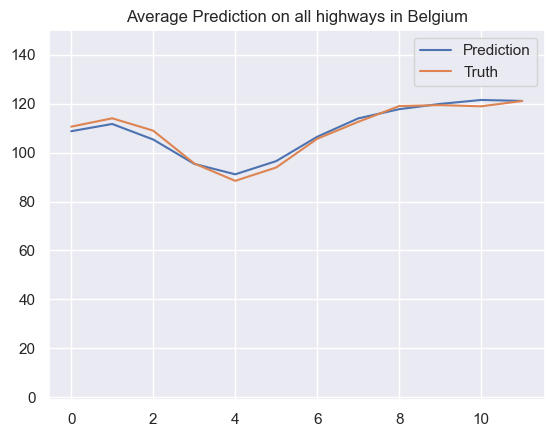

* Time step 574
* Prediction Accuracy (MAE) 11.856079084456166
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


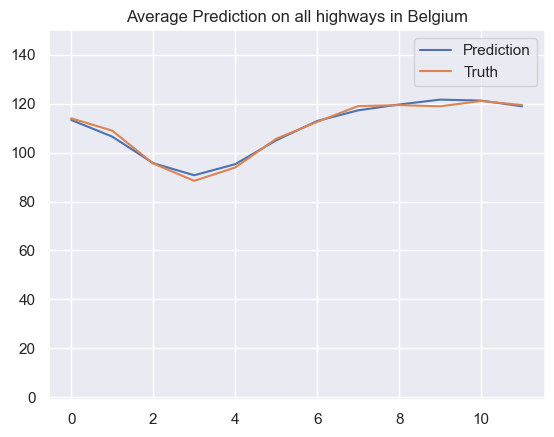

* Time step 575
* Prediction Accuracy (MAE) 11.975979509892037
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


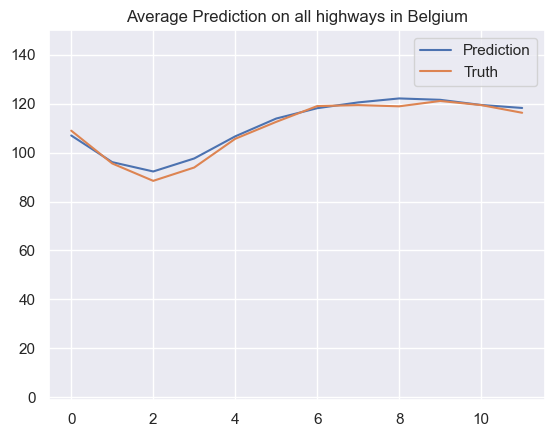

* Time step 576
* Prediction Accuracy (MAE) 12.069913198015495
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


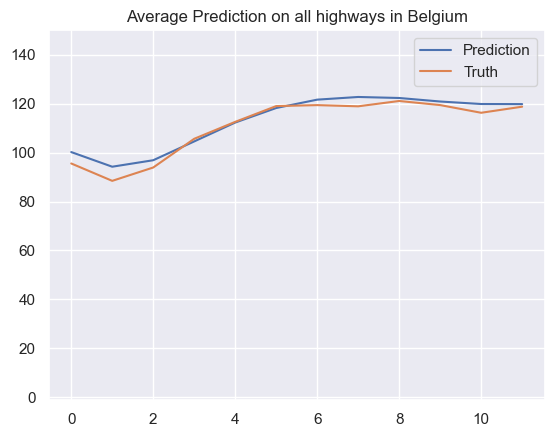

* Time step 577
* Prediction Accuracy (MAE) 12.394442922498385
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


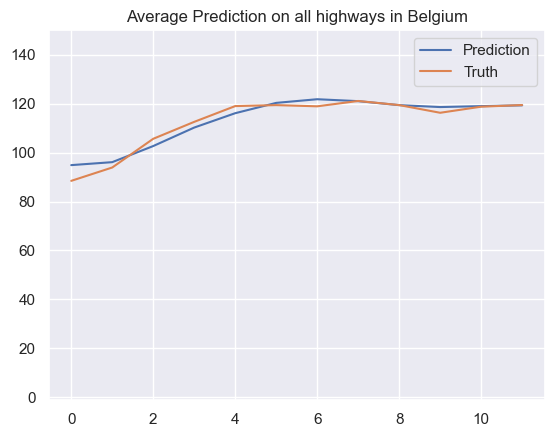

* Time step 578
* Prediction Accuracy (MAE) 12.45664325299892
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


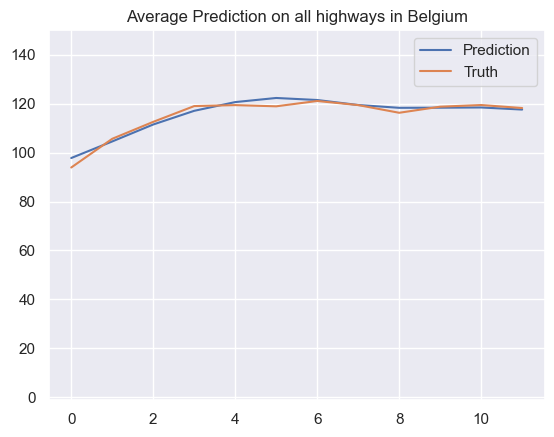

* Time step 579
* Prediction Accuracy (MAE) 12.453566151610323
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


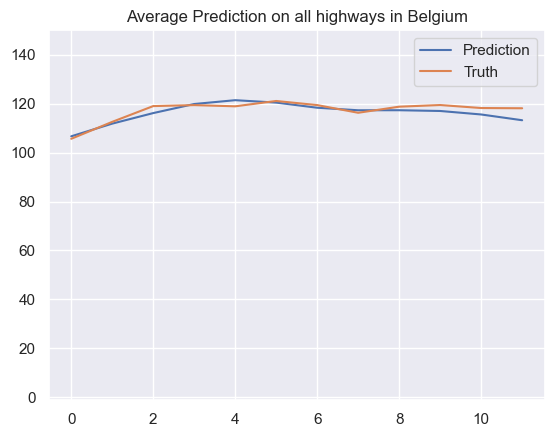

* Time step 580
* Prediction Accuracy (MAE) 12.483250219210266
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


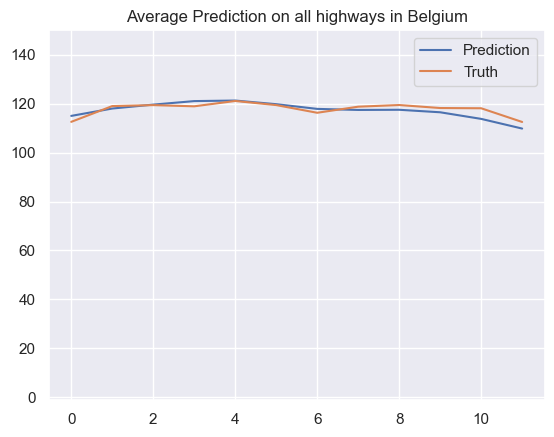

* Time step 581
* Prediction Accuracy (MAE) 12.356045624454602
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


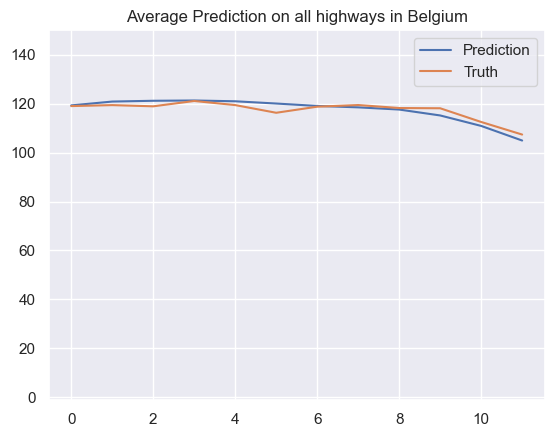

* Time step 582
* Prediction Accuracy (MAE) 12.276668799030556
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


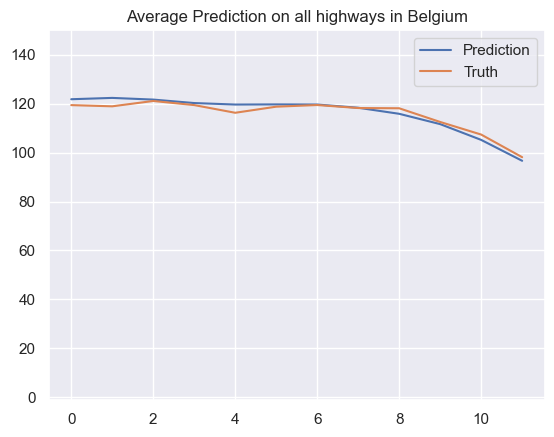

* Time step 583
* Prediction Accuracy (MAE) 12.149268011708067
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


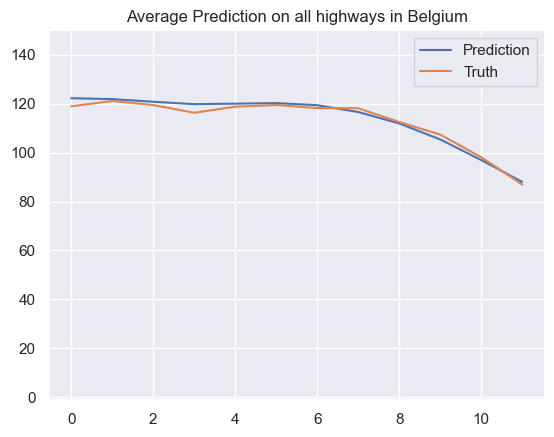

* Time step 584
* Prediction Accuracy (MAE) 11.899510592501922
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


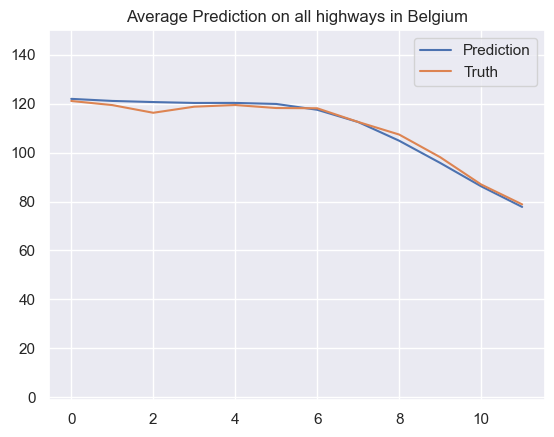

* Time step 585
* Prediction Accuracy (MAE) 11.616285357334023
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


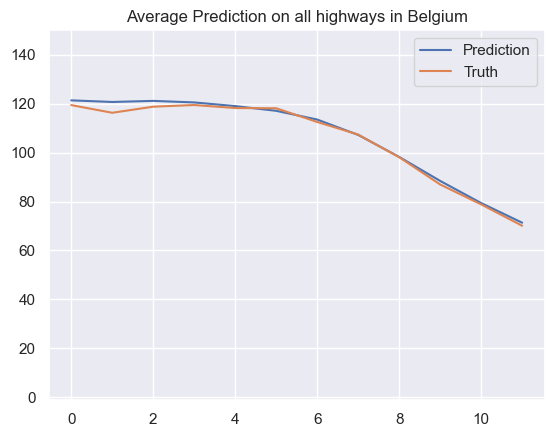

* Time step 586
* Prediction Accuracy (MAE) 11.398801965750012
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


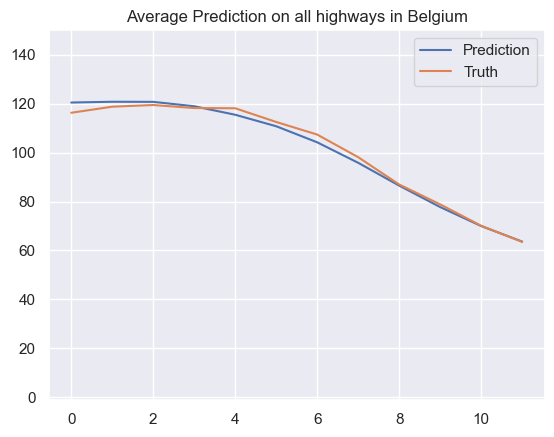

* Time step 587
* Prediction Accuracy (MAE) 11.0413566546777
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


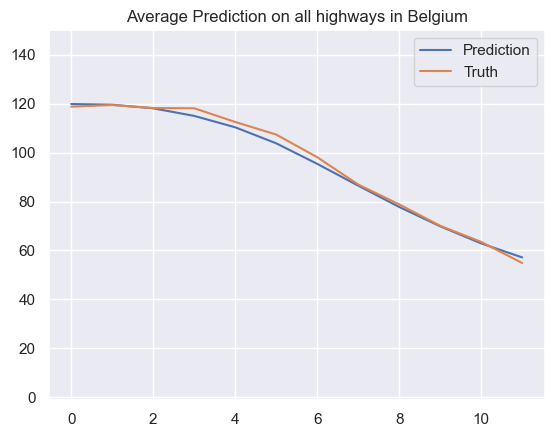

* Time step 588
* Prediction Accuracy (MAE) 10.835268978103139
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


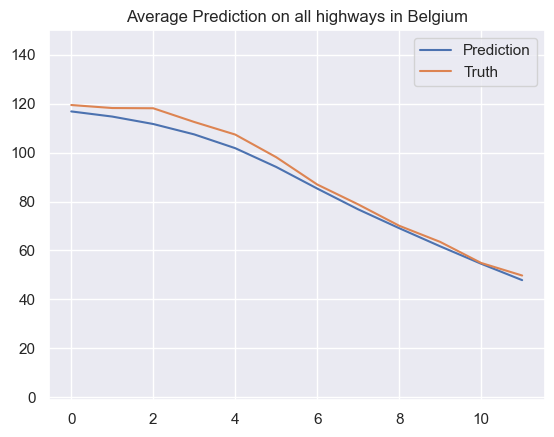

* Time step 589
* Prediction Accuracy (MAE) 11.153296520024728
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


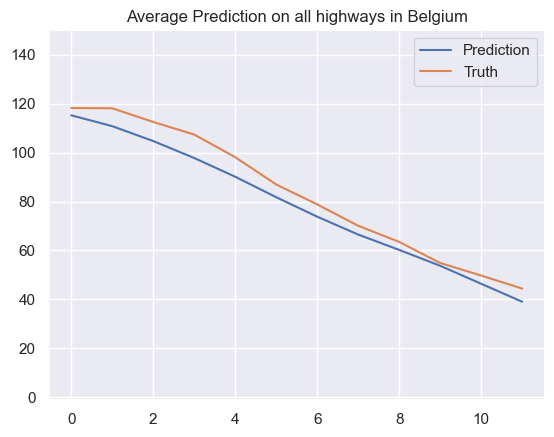

* Time step 590
* Prediction Accuracy (MAE) 11.753366646579126
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


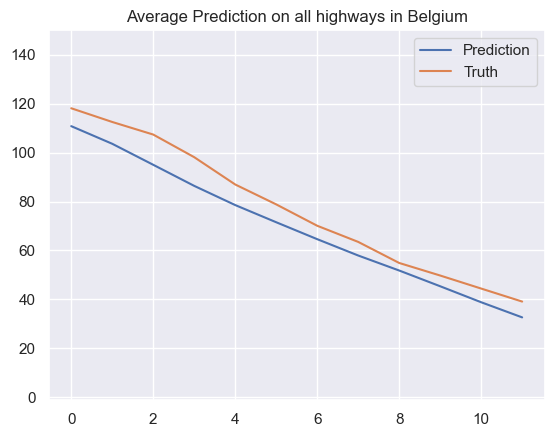

* Time step 591
* Prediction Accuracy (MAE) 11.901830565770341
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


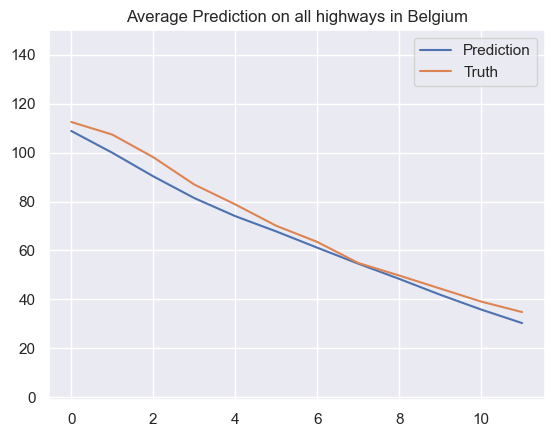

* Time step 592
* Prediction Accuracy (MAE) 10.031691792009088
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


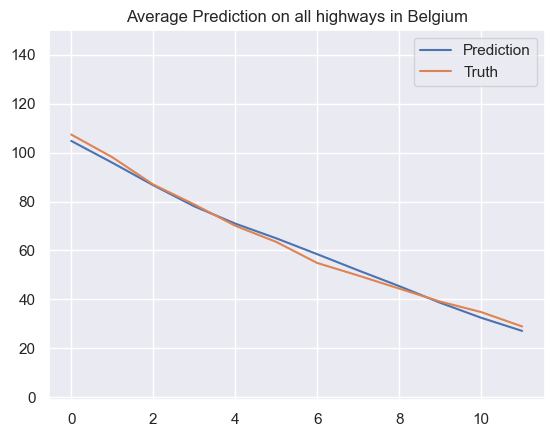

* Time step 593
* Prediction Accuracy (MAE) 9.127756959576443
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


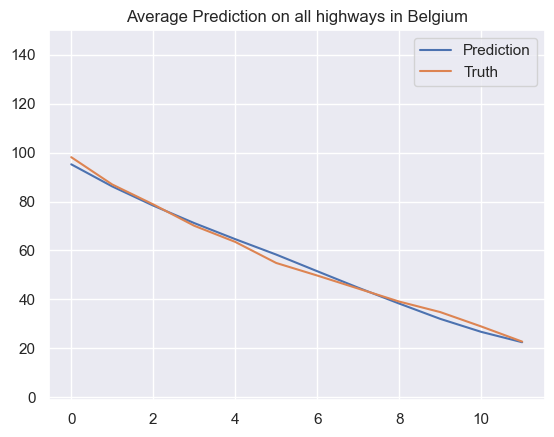

* Time step 594
* Prediction Accuracy (MAE) 8.49620104059633
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


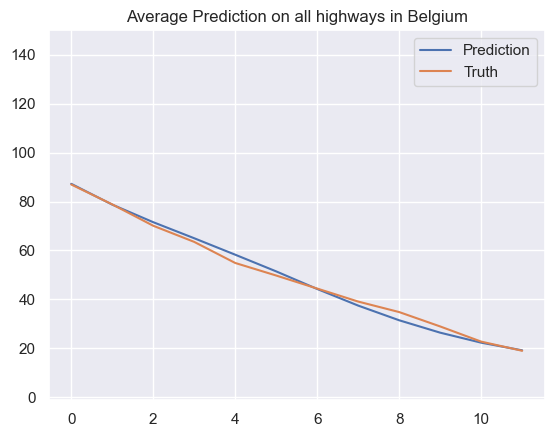

* Time step 595
* Prediction Accuracy (MAE) 7.840561044107904
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


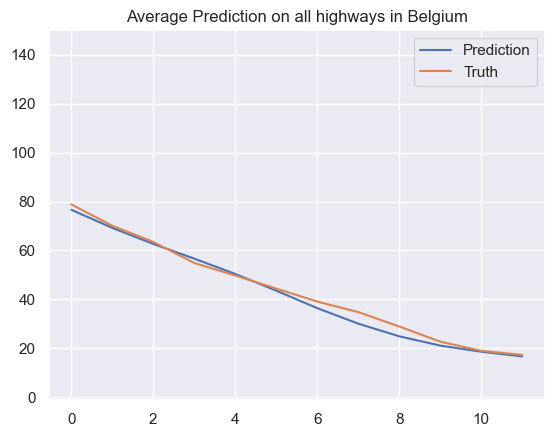

* Time step 596
* Prediction Accuracy (MAE) 7.349452143571454
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


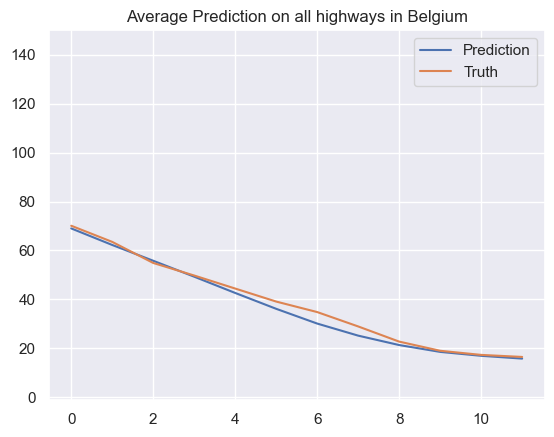

* Time step 597
* Prediction Accuracy (MAE) 6.772424309215462
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


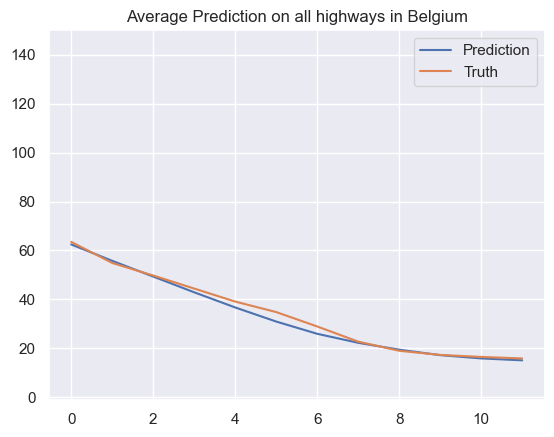

* Time step 598
* Prediction Accuracy (MAE) 6.209919377413108
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


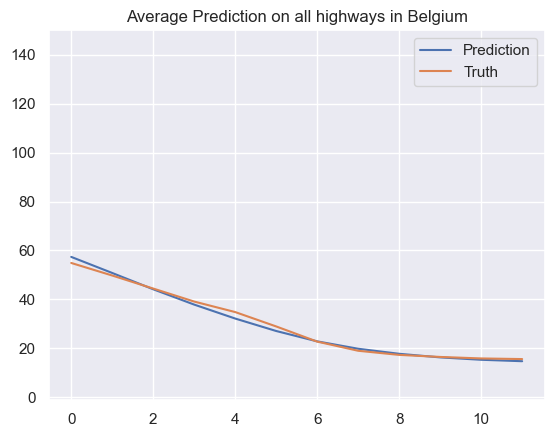

* Time step 599
* Prediction Accuracy (MAE) 5.7629923090779185
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


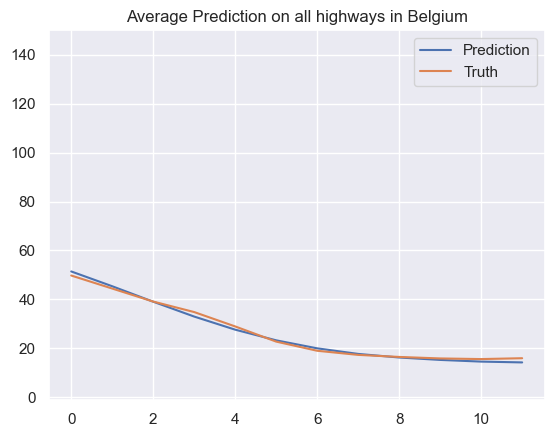

* Time step 600
* Prediction Accuracy (MAE) 5.251272082985826
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


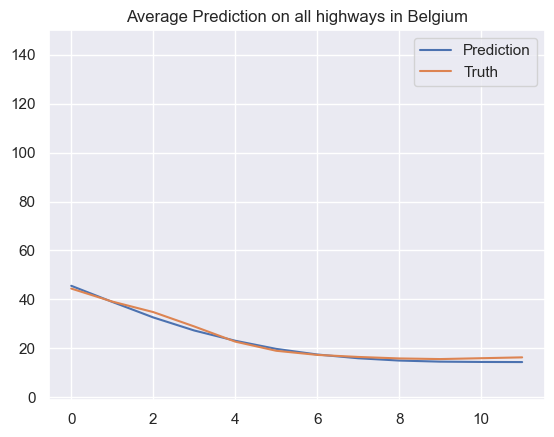

* Time step 601
* Prediction Accuracy (MAE) 4.715404027003181
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


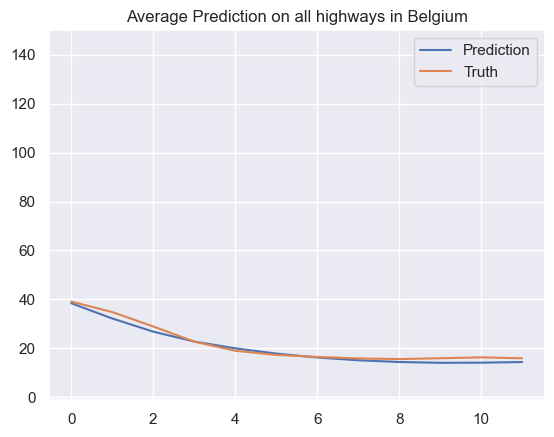

* Time step 602
* Prediction Accuracy (MAE) 4.2203152697842015
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


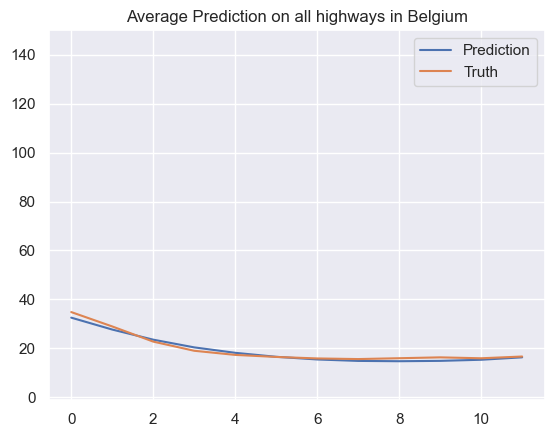

* Time step 603
* Prediction Accuracy (MAE) 3.8349555658185146
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


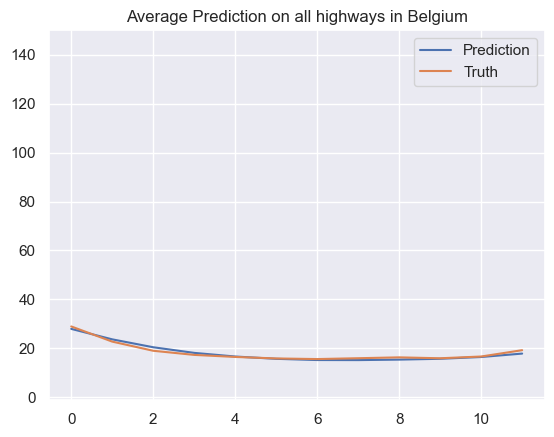

* Time step 604
* Prediction Accuracy (MAE) 3.6275461679263796
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


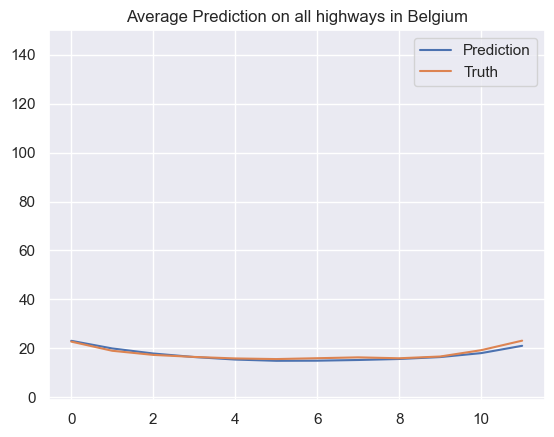

* Time step 605
* Prediction Accuracy (MAE) 3.5332534440993655
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


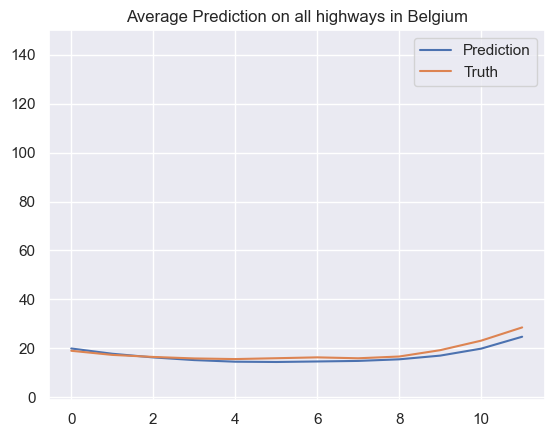

* Time step 606
* Prediction Accuracy (MAE) 3.6878794507180124
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


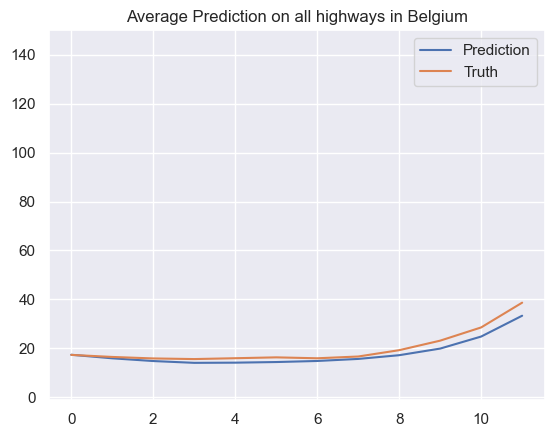

* Time step 607
* Prediction Accuracy (MAE) 3.9276799737488597
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


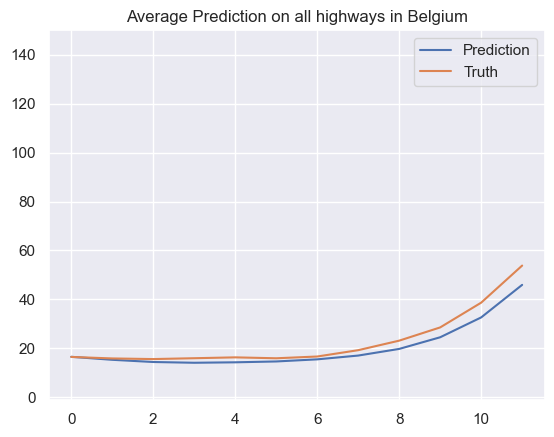

* Time step 608
* Prediction Accuracy (MAE) 4.451371060467197
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


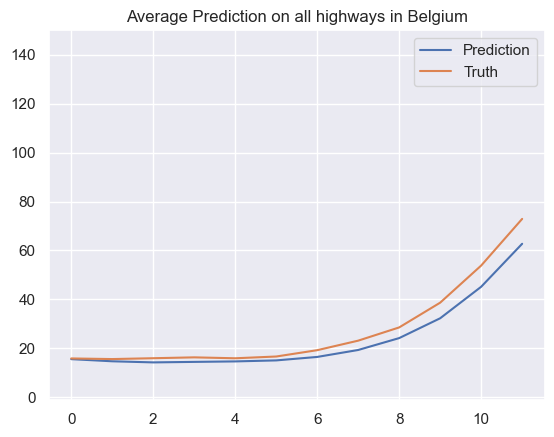

* Time step 609
* Prediction Accuracy (MAE) 5.276753220978222
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


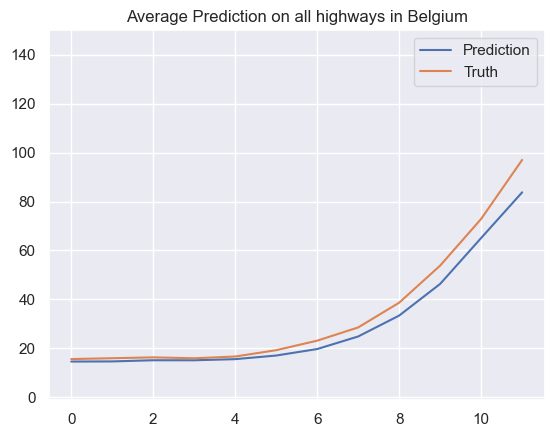

* Time step 610
* Prediction Accuracy (MAE) 5.85165496028707
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


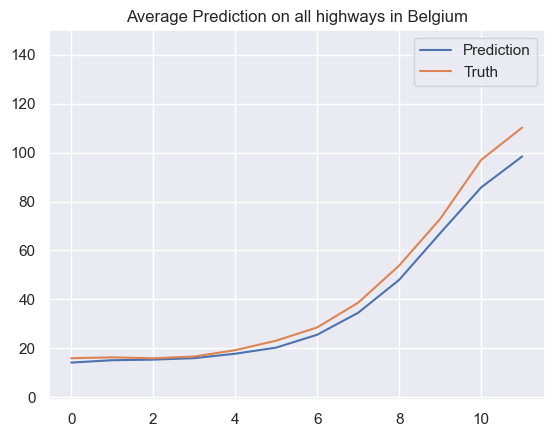

* Time step 611
* Prediction Accuracy (MAE) 6.300253045611373
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


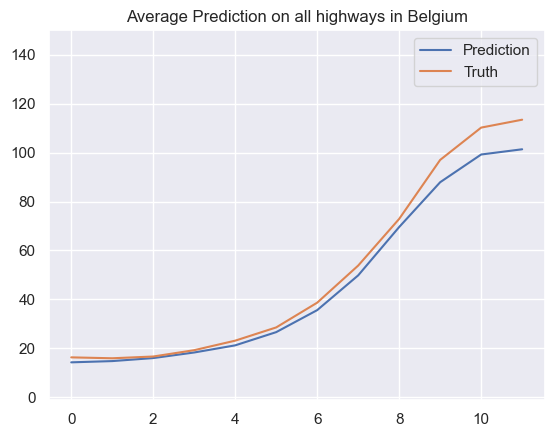

* Time step 612
* Prediction Accuracy (MAE) 6.874066266427063
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


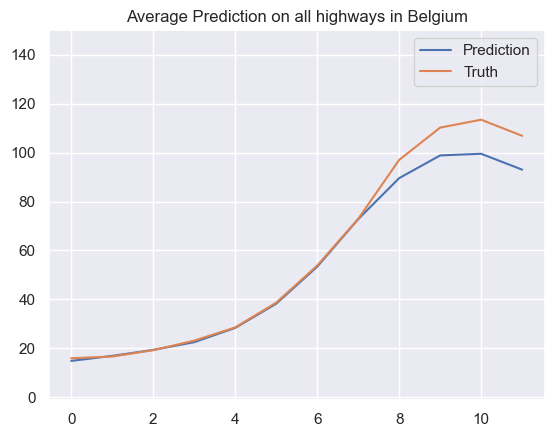

* Time step 613
* Prediction Accuracy (MAE) 7.951630789297642
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


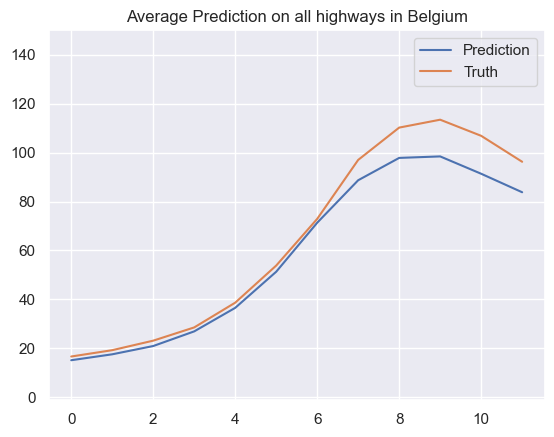

* Time step 614
* Prediction Accuracy (MAE) 9.510057281233026
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


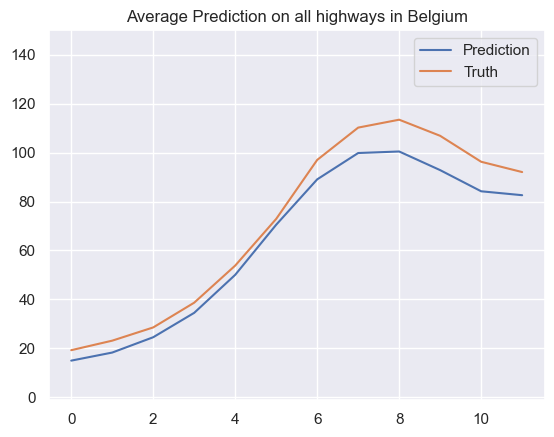

* Time step 615
* Prediction Accuracy (MAE) 10.34567516700538
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


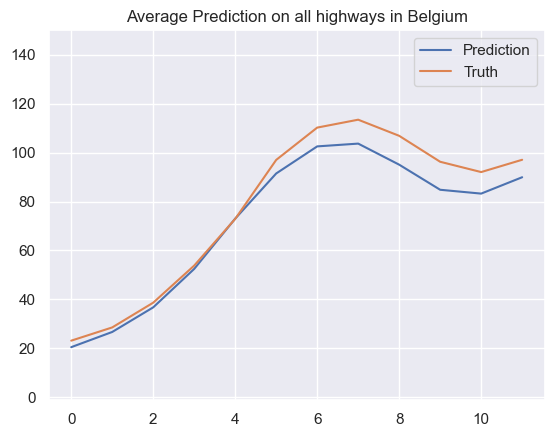

* Time step 616
* Prediction Accuracy (MAE) 9.988392897470797
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


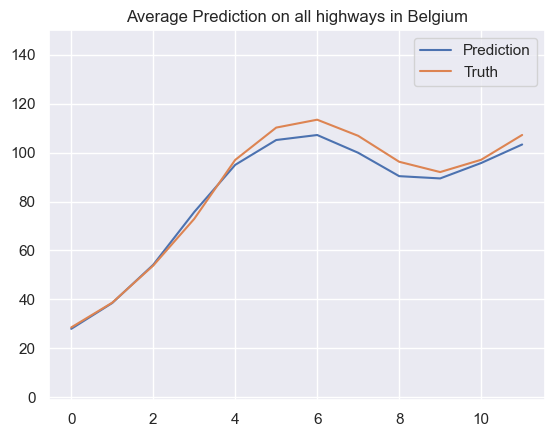

* Time step 617
* Prediction Accuracy (MAE) 9.286398237316764
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


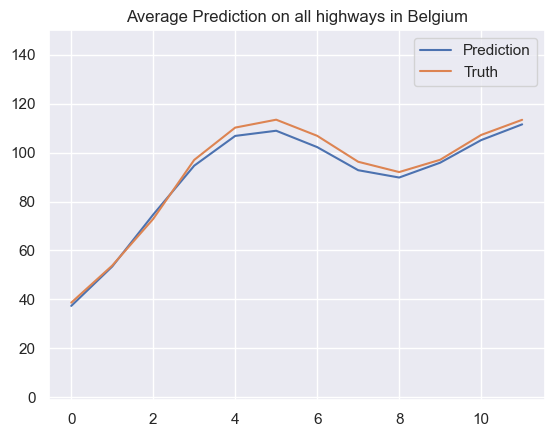

* Time step 618
* Prediction Accuracy (MAE) 9.299034620829863
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


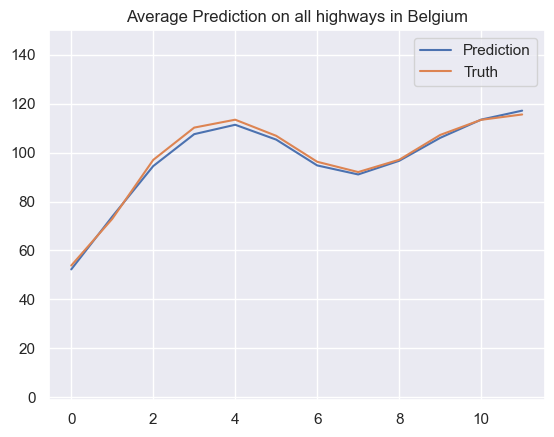

* Time step 619
* Prediction Accuracy (MAE) 9.633184613711425
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


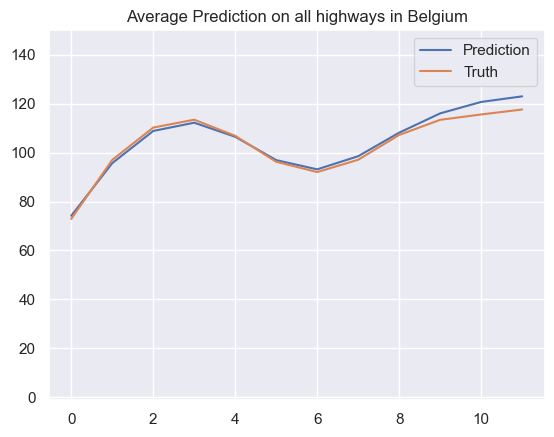

* Time step 620
* Prediction Accuracy (MAE) 10.280752591250067
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


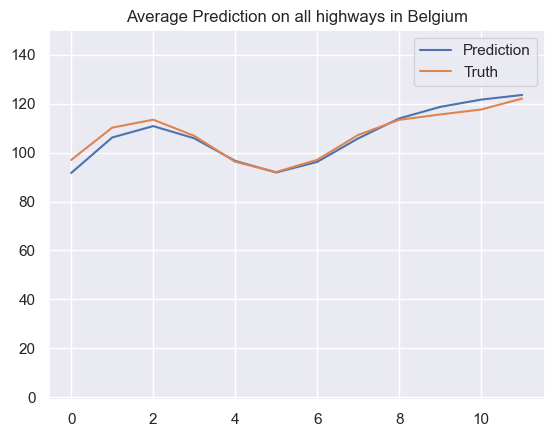

* Time step 621
* Prediction Accuracy (MAE) 10.773172474616002
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


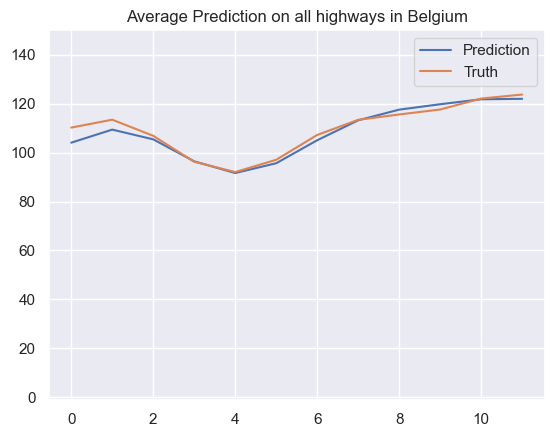

* Time step 622
* Prediction Accuracy (MAE) 10.706791176876184
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


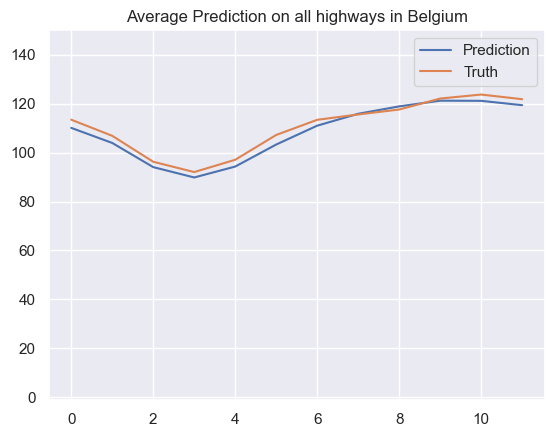

* Time step 623
* Prediction Accuracy (MAE) 10.946274062019393
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


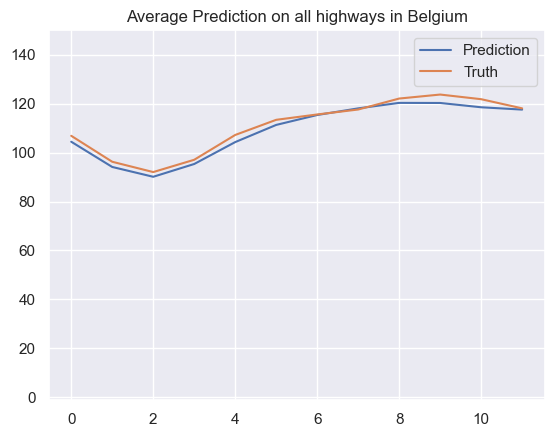

* Time step 624
* Prediction Accuracy (MAE) 10.836703665997236
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


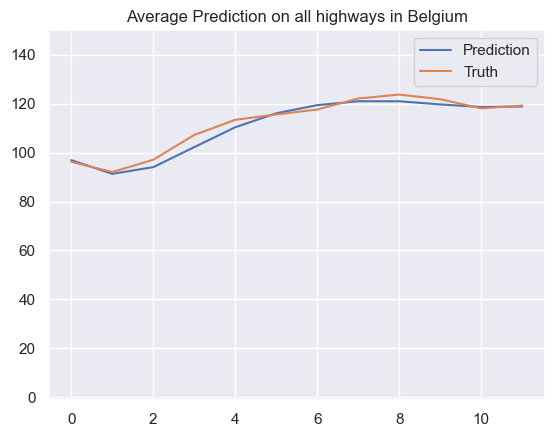

* Time step 625
* Prediction Accuracy (MAE) 10.983765360003959
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


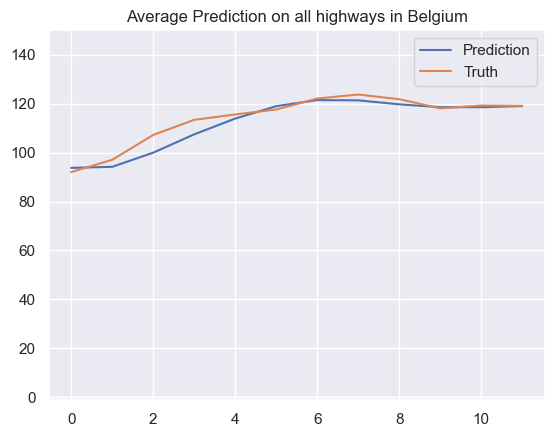

* Time step 626
* Prediction Accuracy (MAE) 11.346706045560268
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


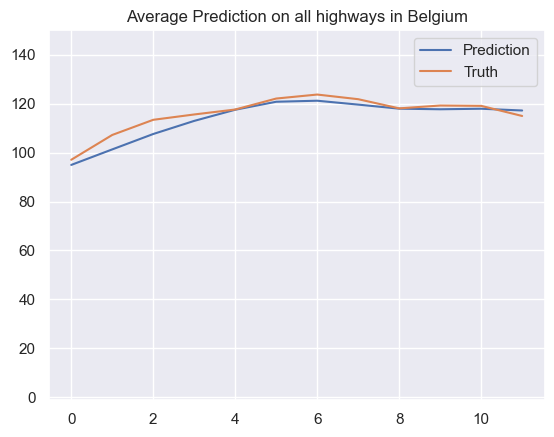

* Time step 627
* Prediction Accuracy (MAE) 11.4548434592634
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


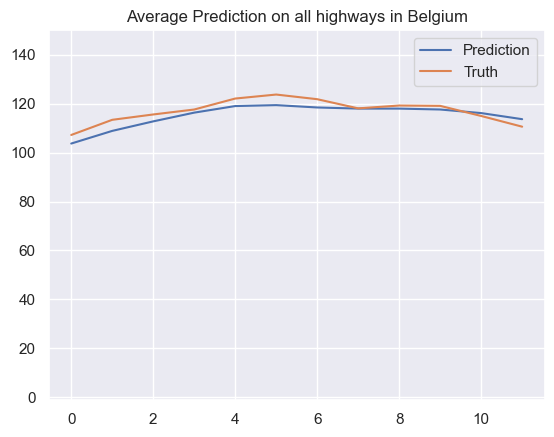

* Time step 628
* Prediction Accuracy (MAE) 11.658789291219719
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


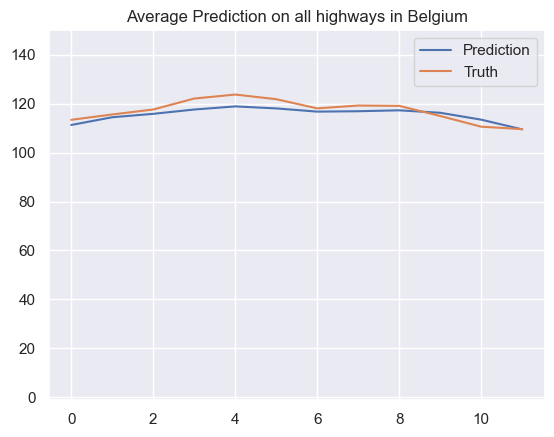

* Time step 629
* Prediction Accuracy (MAE) 11.810579748806097
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


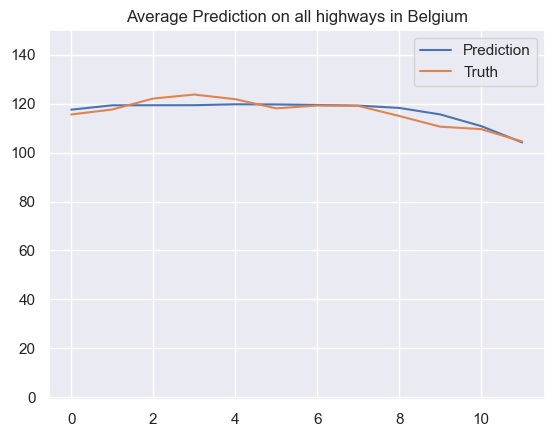

* Time step 630
* Prediction Accuracy (MAE) 11.73384215188287
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


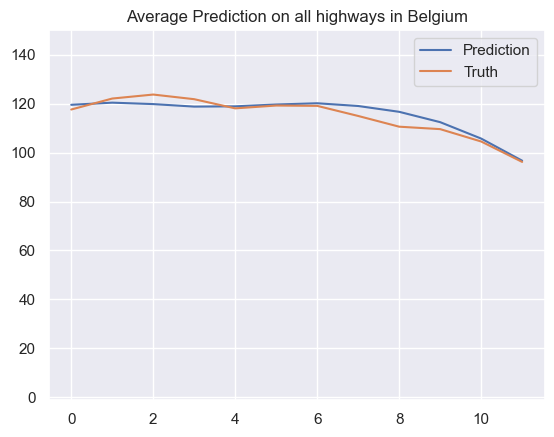

* Time step 631
* Prediction Accuracy (MAE) 11.568666848182508
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


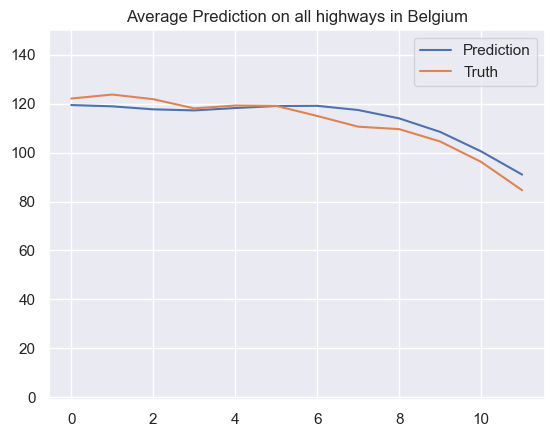

* Time step 632
* Prediction Accuracy (MAE) 11.775505001985023
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


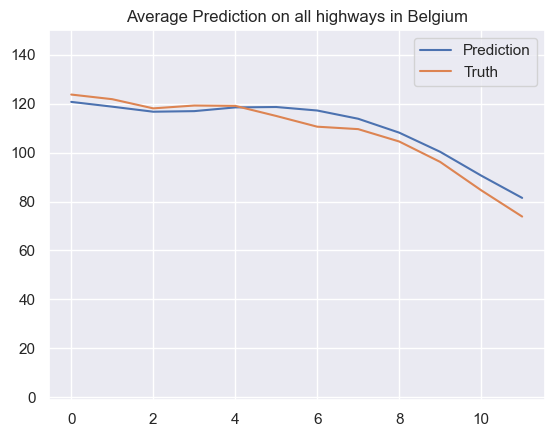

* Time step 633
* Prediction Accuracy (MAE) 11.576437979667723
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


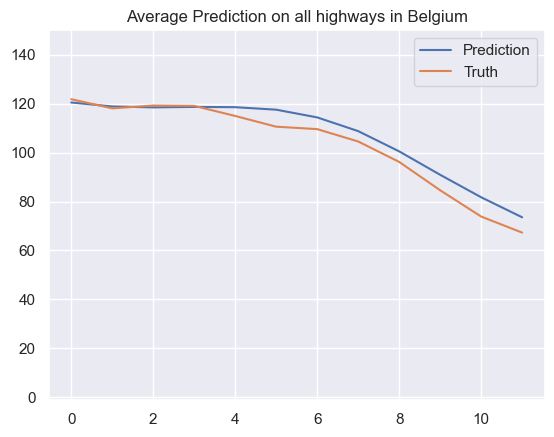

* Time step 634
* Prediction Accuracy (MAE) 11.452074765762104
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


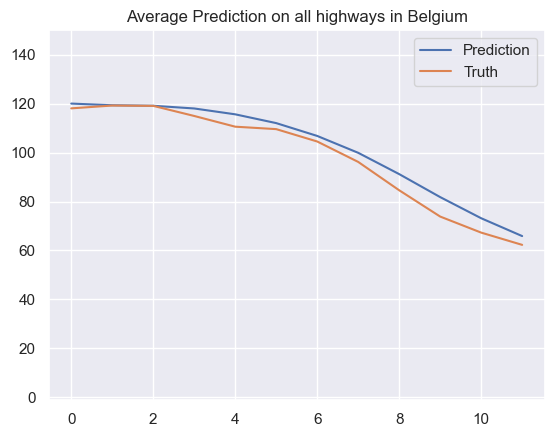

* Time step 635
* Prediction Accuracy (MAE) 11.251186198487105
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


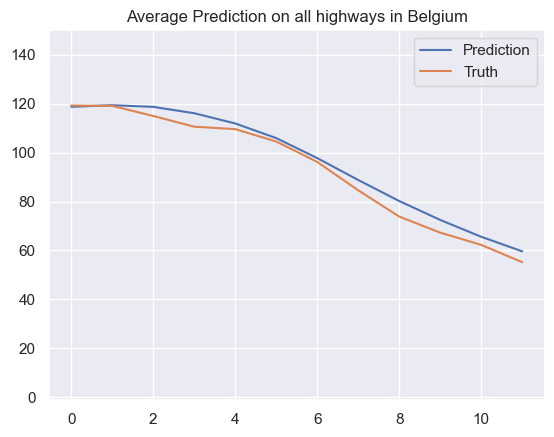

* Time step 636
* Prediction Accuracy (MAE) 10.846320430447472
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


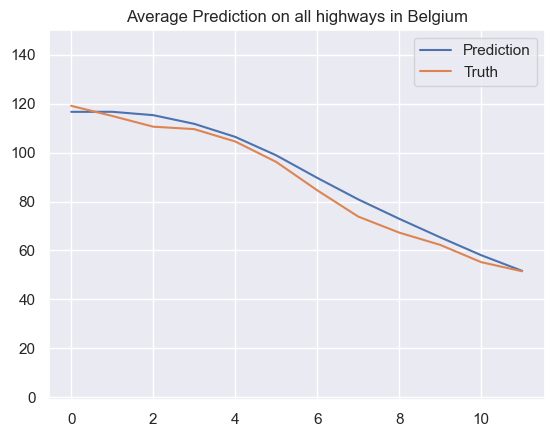

* Time step 637
* Prediction Accuracy (MAE) 10.817877636342804
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


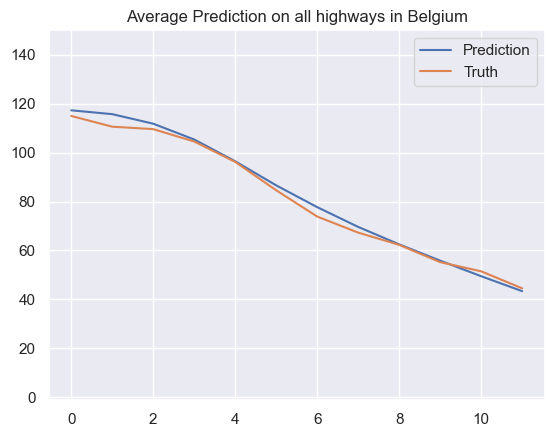

* Time step 638
* Prediction Accuracy (MAE) 10.042270074828648
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


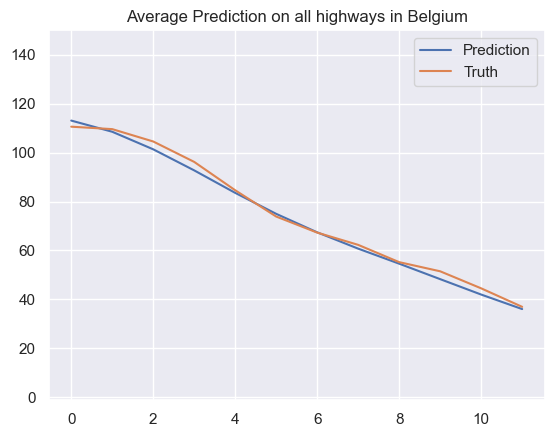

* Time step 639
* Prediction Accuracy (MAE) 9.296036017071556
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


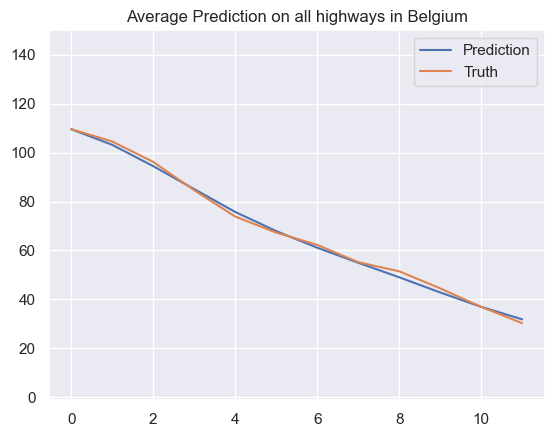

* Time step 640
* Prediction Accuracy (MAE) 8.42761768434888
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


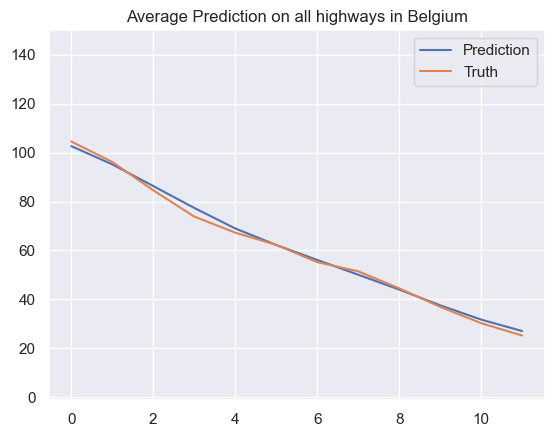

* Time step 641
* Prediction Accuracy (MAE) 7.7252784627011835
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


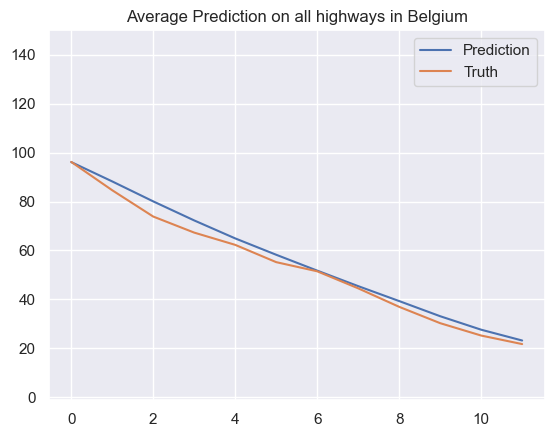

* Time step 642
* Prediction Accuracy (MAE) 7.657317605948574
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


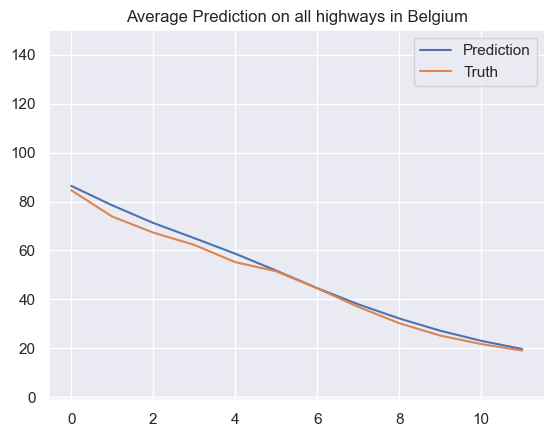

* Time step 643
* Prediction Accuracy (MAE) 6.998974309650496
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


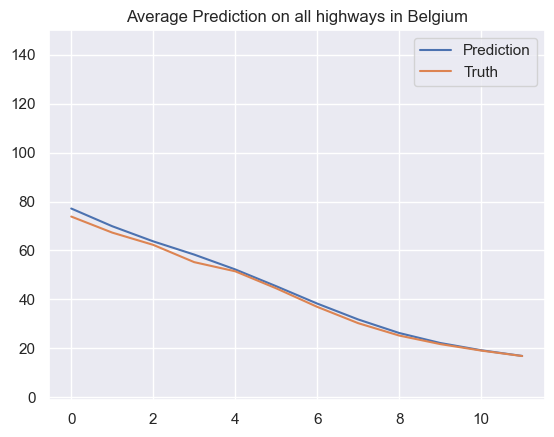

* Time step 644
* Prediction Accuracy (MAE) 6.307179833840673
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


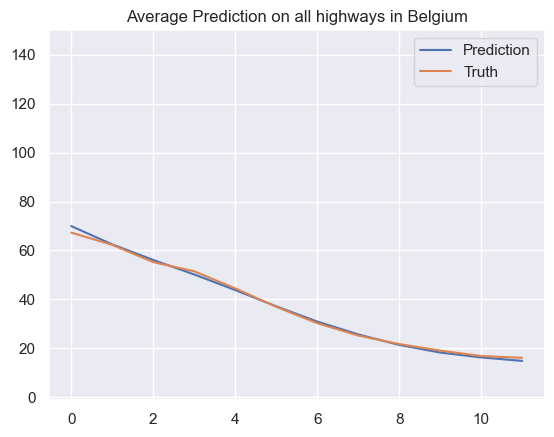

* Time step 645
* Prediction Accuracy (MAE) 5.8099470196736185
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


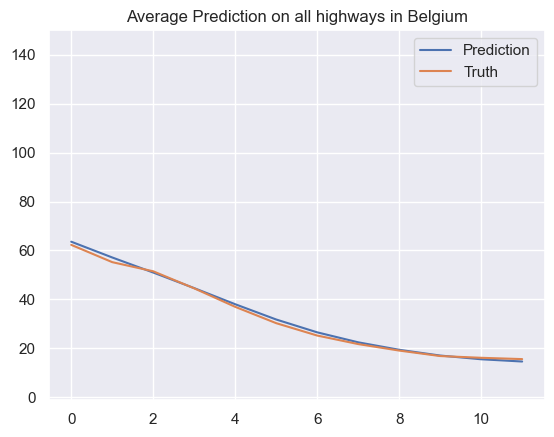

* Time step 646
* Prediction Accuracy (MAE) 5.392644086661953
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


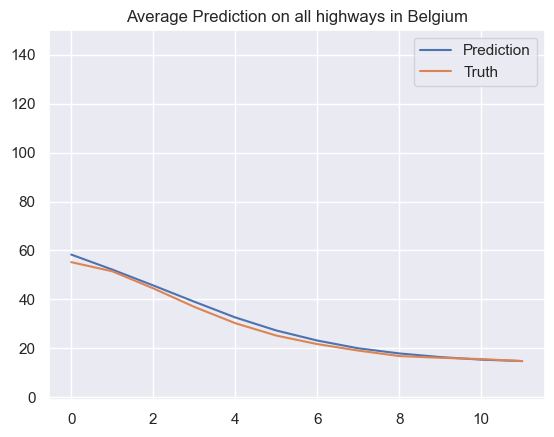

* Time step 647
* Prediction Accuracy (MAE) 5.057358840896269
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


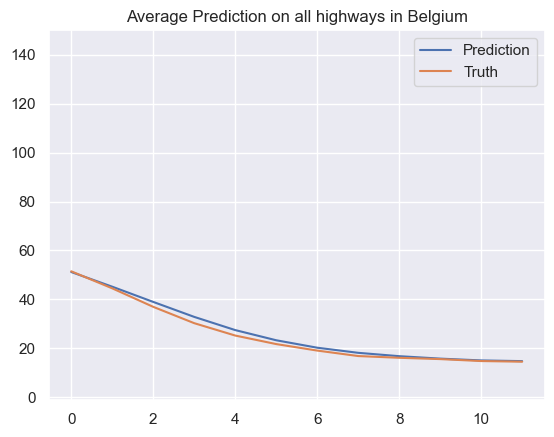

* Time step 648
* Prediction Accuracy (MAE) 4.5481893061715235
----
* After prediction UPDATE model with new streets observations
UPDATE - Epoch 0: Loss MAE: 0.037, Accuracy RMSE: 0.003


In [30]:
forecasts = []
targets = []

rmse_list = []
mae_list = []

    
for (step, (inp, targ)) in enumerate(windowed_test):

        pred  = lstm_pred(inp, training = False)
        
        truth = inverse_transform(targ[0][:,:-feat_time],  scaler)
        pred = inverse_transform(pred[0][:,:-feat_time],  scaler)
        
        forecasts.append(pred)
        targets.append(truth)
        
        rmse, mae = evaluate_forecasts(targets, forecasts, 12)
           
        rmse_list.append(rmse)
        mae_list.append(mae)
           
        plt.plot(np.mean(pred, axis=1), label='Prediction') 
        plt.plot(np.mean(truth, axis=1), label='Truth') 
        plt.ylim(-1, 150)
        plt.title('Average Prediction on all highways in Belgium')
        plt.legend()
        plt.show()
        
        print('* Time step '+str(step))
        print('* Prediction Accuracy (MAE) '+ str(np.absolute(truth - pred).mean()))
        print('----')
        print('* After prediction UPDATE model with new streets observations')
        
        new_instance = test_feat[step,:].reshape(1,-1)
    
        train_feat = np.vstack([train_feat, new_instance])
    
        windowed_new = prep_data(train_feat, size_input, batch_size) 

        update_steps_per_epoch = len(train_feat)//batch_size
        
        UPDATE = 2
        
        for epoch in range(UPDATE):
            
            for (batch, (inp_new, targ_new)) in enumerate(windowed_new.take(update_steps_per_epoch )):

                batch_loss = train_step(inp_new, targ_new)

                # Track progress
                epoch_loss_avg.update_state(batch_loss)  # Add current batch loss
                epoch_rmse.update_state(targ_new, lstm(inp_new))
                
            # End epoch
            train_loss_results.append(epoch_loss_avg.result())
            train_rmse_accuracy_results.append(epoch_rmse.result())


            if epoch % UPDATE == 0:
                print("UPDATE - Epoch {}: Loss MAE: {:.3f}, Accuracy RMSE: {:.3f}".format(epoch,
                                                                        epoch_loss_avg.result(),
                                                                        epoch_rmse.result()))
                
        for a, b in zip(lstm_pred.variables, lstm.variables):
            a.assign(b)  # copies the variables of model_b into model_a

In [31]:
RMSE_MEAN = np.mean(rmse_list,axis=0).mean(axis=1)
RMSE_STD =  np.std(rmse_list,axis=0).std(axis=1)

for i in range(len(RMSE_MEAN)):
    print('t+'+str(i+1)+' RMSE MEAN ' +str(np.round(RMSE_MEAN[i],3))+' +- '+str(np.round(RMSE_STD[i],3)))
    print('')

t+1 RMSE MEAN 11.11 +- 2.413

t+2 RMSE MEAN 11.633 +- 2.816

t+3 RMSE MEAN 11.74 +- 2.979

t+4 RMSE MEAN 11.883 +- 3.173

t+5 RMSE MEAN 11.978 +- 3.386

t+6 RMSE MEAN 12.004 +- 3.636

t+7 RMSE MEAN 12.132 +- 4.325

t+8 RMSE MEAN 10.263 +- 2.308

t+9 RMSE MEAN 9.618 +- 1.559

t+10 RMSE MEAN 9.588 +- 1.53

t+11 RMSE MEAN 9.585 +- 1.481

t+12 RMSE MEAN 9.666 +- 1.4



In [32]:
MAE_MEAN = np.mean(mae_list,axis=0).mean(axis=1)
MAE_STD =  np.std(mae_list,axis=0).std(axis=1)

for i in range(len(MAE_MEAN)):
    print('t+'+str(i+1)+' MAE MEAN ' +str(np.round(MAE_MEAN[i],3))+' +- '+str(np.round(MAE_STD[i],3)))
    print('')

t+1 MAE MEAN 6.677 +- 1.556

t+2 MAE MEAN 6.959 +- 1.88

t+3 MAE MEAN 7.026 +- 2.01

t+4 MAE MEAN 7.106 +- 2.165

t+5 MAE MEAN 7.178 +- 2.381

t+6 MAE MEAN 7.219 +- 2.69

t+7 MAE MEAN 7.327 +- 3.719

t+8 MAE MEAN 6.625 +- 2.063

t+9 MAE MEAN 6.32 +- 1.416

t+10 MAE MEAN 6.315 +- 1.387

t+11 MAE MEAN 6.341 +- 1.334

t+12 MAE MEAN 6.411 +- 1.24



In [33]:
import pickle

# Saving the objects:
with open('save_predictions_results.pkl', 'wb') as f:  # Python 3: open(..., 'wb')
    pickle.dump([rmse_list, mae_list], f)

In [35]:
lstm_pred.save_weights('./weights/wwLSTM')